## Libraries

In [542]:
# Standard libraries
import pandas as pd
import numpy as np
import datetime
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline 
import warnings
warnings.filterwarnings('ignore')

# For downloading and unzipping files
import urllib.request
import zipfile

# Create wrapper for StandardScaler
import typing

# Preprocessing
from sklearn.preprocessing import (
    LabelEncoder, 
    LabelBinarizer, 
    StandardScaler, 
    PolynomialFeatures
)
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn_pandas import DataFrameMapper
from sklearn.pipeline import make_pipeline

# Models
from sklearn.linear_model import (
    LinearRegression,
    HuberRegressor,
    Ridge,
    Lasso,
    ElasticNet
)
from sklearn.decomposition import PCA
from sklearn.cross_decomposition import PLSRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import (
    BaggingRegressor,
    RandomForestRegressor,
    ExtraTreesRegressor,
    AdaBoostRegressor
)
from xgboost import XGBRegressor 
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense
from tensorflow.keras.regularizers import l1, l2
from tensorflow.keras.layers import Dropout, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator

# Saving files
import os
import pickle

# Metrics
from sklearn.metrics import mean_squared_error, r2_score

# Load libraries
import requests
from bs4 import BeautifulSoup
import re

# Set viewing limits
pd.set_option('display.max_rows', 110)
pd.set_option('display.max_columns', 110)

In [460]:
# !pip install sklearn_pandas

## Data dictionary

In [461]:
# # Show 94 features from Green, Hand and Zhang (2017)
# url = '../data/green_hand_zhang_journal_article.html'
# soup = BeautifulSoup(open(url).read())

# # Extract features from html file
# df_factors = []
# for element in soup.find_all('table')[38].find('tbody').find_all('tr'):
#     factor = {}
#     factor['Feature acronym'] = element.select('td')[0].get_text(strip=True)
#     factor['Original author(s)'] = element.select('td')[1].get_text(strip=True)
#     factor['Date, journal'] = element.select('td')[2].get_text(strip=True)
#     factor['Description of feature'] = element.select('td')[3].get_text(strip=True)
#     df_factors.append(factor)

    
# # Show features
# pd.set_option('display.max_rows', None)
# df_factors = pd.DataFrame(df_factors)
# df_factors

## Load data

In [462]:
# Load Green, Hand and Zhang (2017)'s SAS output
# df_ghz = pd.read_csv("../data/GHZ_variables.csv")
# df_ghz = df_ghz.reindex(sorted(df_ghz.columns), axis=1)
# df_ghz

This data set is generated from the SAS code provided by Jeremiah Green. Updated his code to take in variables from `1975 through 2015` to `1972 through 2020`. We will not be using this data set in the modeling stage, as this was already performed by Gu, Kelly and Xiu (2020). Instead, this data set is used during the EDA stage to compare against the REIT database generated by me below.

In [463]:
%%time
# Load REIT output
df_reit = pd.read_csv("../data/REIT_variables.csv")
df_reit = df_reit.reindex(sorted(df_reit.columns), axis=1)
df_reit

CPU times: user 378 ms, sys: 26.5 ms, total: 405 ms
Wall time: 402 ms


,DATE,DLRET,DLSTCD,EXCHCD,RET,SHRCD,SHROUT,VOL,absacc,acc,age,agr,bm,bm_ia,cashdebt,cashpr,cf,cfp,cfp_ia,chadv,chato,chatoia,chcsho,chdrc,chempia,chinv,chobklg,chpm,chpmia,conv,convind,credrat,credrat_dwn,currat,depr,divi,divo,dy,egr,ep,fyear,gma,grGW,grcapx,grltnoa,gvkey,herf,hire,invest,lev,lgr,m1,m2,m3,m4,m5,m6,mve,mve_f,mve_ia,mve_m,obklg,operprof,orgcap,pchcapx,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,pps,prc,ps,quick,rd,rd_mve,rd_sale,rdbias,realestate,roe,roic,salecash,saleinv,salerec,secured,securedind,sgr,sic2,sin,sp,spi,spii,tang,tb,woGW
0,19731231,0.0,NaN,2,-0.103448,18,1216,130.0,NaN,NaN,1,NaN,0.982730,0.211526,0.092696,-3.571059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.694657,1,NaN,0,NaN,NaN,NaN,NaN,0.087263,NaN,0.106788,1972,NaN,NaN,NaN,NaN,8985,0.164591,NaN,NaN,2.193716,NaN,0,0,0,0,0,0,9.777471,20.84500,-77.464772,1.763200e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49904,2.674149,13.000000,NaN,NaN,NaN,0.0,0.0,-1.444933,NaN,NaN,0.068379,1.215332,NaN,NaN,NaN,0,NaN,67,0,0.270760,NaN,0,NaN,-0.470717,0
1,19740131,0.0,NaN,2,-0.038462,18,1216,90.0,NaN,NaN,1,NaN,0.982730,0.211526,0.092696,-3.571059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.694657,1,NaN,0,NaN,NaN,NaN,NaN,0.087263,NaN,0.106788,1972,NaN,NaN,NaN,NaN,8985,0.164591,NaN,NaN,2.193716,NaN,0,0,0,0,0,0,9.668271,20.84500,-77.464772,1.580800e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49904,2.564949,12.500000,NaN,NaN,NaN,0.0,0.0,-1.444933,NaN,NaN,0.068379,1.215332,NaN,NaN,NaN,0,NaN,67,0,0.270760,NaN,0,NaN,-0.470717,0
2,19740228,0.0,NaN,2,-0.056000,18,1216,201.0,NaN,NaN,1,NaN,0.982730,0.211526,0.092696,-3.571059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.694657,1,NaN,0,NaN,NaN,NaN,NaN,0.087263,NaN,0.106788,1972,NaN,NaN,NaN,NaN,8985,0.164591,NaN,NaN,2.193716,NaN,0,0,0,0,0,0,9.629051,20.84500,-77.464772,1.520000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49904,2.525729,11.375000,NaN,NaN,NaN,0.0,0.0,-1.444933,NaN,NaN,0.068379,1.215332,NaN,NaN,NaN,0,NaN,67,0,0.270760,NaN,0,NaN,-0.470717,0
3,19740329,0.0,NaN,2,-0.021978,18,1216,317.0,NaN,NaN,1,NaN,0.982730,0.211526,0.092696,-3.571059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.694657,1,NaN,0,NaN,NaN,NaN,NaN,0.087263,NaN,0.106788,1972,NaN,NaN,NaN,NaN,8985,0.164591,NaN,NaN,2.193716,NaN,0,0,0,0,0,0,9.534740,20.84500,-77.464772,1.383200e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49904,2.431418,11.125000,NaN,NaN,NaN,0.0,0.0,-1.444933,NaN,NaN,0.068379,1.215332,NaN,NaN,NaN,0,NaN,67,0,0.270760,NaN,0,NaN,-0.470717,0
4,19740430,0.0,NaN,2,-0.011236,18,1216,127.0,NaN,NaN,1,NaN,0.982730,0.211526,0.092696,-3.571059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.694657,1,NaN,0,NaN,NaN,NaN,NaN,0.087263,NaN,0.106788,1972,NaN,NaN,NaN,NaN,8985,0.164591,NaN,NaN,2.193716,NaN,0,0,0,0,0,0,9.512517,20.84500,-77.464772,1.352800e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49904,2.409195,11.000000,NaN,NaN,NaN,0.0,0.0,-1.444933,NaN,NaN,0.068379,1.215332,NaN,NaN,NaN,0,NaN,67,0,0.270760,NaN,0,NaN,-0.470717,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53574,20201231,0.0,100.0,1,0.068646,18,140297,279905.0,0.007220,-0.007220,10,0.351768,0.936513,31.221905,0.067258,-1.177669,0.045633,0.097370,-5.075222,NaN,-0.006569,0.180589,0.147048,0.00000,NaN,0.0,NaN,-0.072535,2.230838,0.158300,1,NaN,0,992.665126,NaN,0.0,0.0,0.105744,0.047935,0.081965,2019,0.079416,0.0,NaN,-0.001633,183606,0.009340,NaN,0.0,1.516416,0.646663,1,1,1,0,0,0,14.229209,2808.19173,-875.489957,1.512402e+06,NaN,0.094554,

Modified Green's code to take in REITs. The original SAS code takes in stocks with share codes (SHRCD) 10 and 11 only, i.e. ordinary common shares with no special status found. To take in REITs, i modified the SHRCD value to 18, i.e. ordinary common shares with REIT status. See below snapshot taken from [CRSP website](http://www.crsp.org/products/documentation/data-definitions-1).

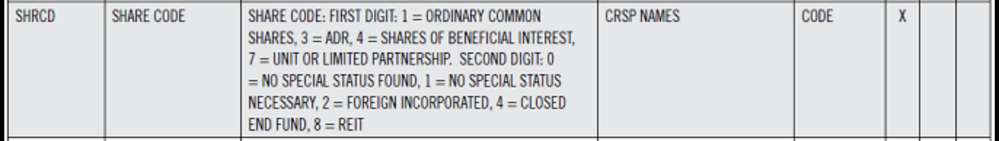

In [464]:
%%time
# Load Gu, Kelly and Xiu (2017)'s SAS output
df_gkx = pd.read_csv("../data/GKX_20201231.csv")
df_gkx = df_gkx.reindex(sorted(df_gkx.columns), axis=1)
df_gkx

CPU times: user 39.6 s, sys: 3.15 s, total: 42.8 s
Wall time: 43.1 s


,DATE,RET,SHROUT,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,mvel1,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,prc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sic2,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
0,19260130,0.032732,600,NaN,NaN,NaN,NaN,NaN,0.006857,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.615000e+04,NaN,6.540000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10006,110.250000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.562500e-05
1,19260130,0.017857,200,NaN,NaN,NaN,NaN,NaN,0.018018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.140000e+04,NaN,1.120000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10022,57.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.573529e-06
2,19260130,0.161667,156,NaN,NaN,NaN,NaN,NaN,0.004158,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.718300e+04,NaN,2.340000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10030,174.250000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.275000e-05
3,19260130,0.141892,250,NaN,NaN,NaN,NaN,NaN,0.006780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.087500e+04,NaN,1.850000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10049,83.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.187500e-05
4,19260130,-0.035714,500,NaN,NaN,NaN,NaN,NaN,0.071795,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.906250e+03,NaN,6.125000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10057,11.812500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.943182e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4345503,20201231,0.109665,84977,0.085746,-0.085746,0.285395,35.0,-0.145079,0.060029,1.921340,3.691548,NaN,NaN,0.008385,0.104231,19.464647,0.107541,0.013794,-0.013714,0.008004,-0.138167,0.001545,0.798194,0.335792,0.000957,0.010704,0.0,1.107461,0.079610,0.0,0.0,16.060575,0.072691,0.067934,0.113553,0.046902,0.294752,0.064296,0.129965,0.082893,-0.072610,0.061120,4.462048e-10,-0.149810,0.137410,0.803963,0.164791,0.176471,-0.492847,0.421369,-0.254458,-0.059182,6.0,2.897716e+06,-1391.533191,2.611343e+06,0.0,NaN,NaN,-0.312539,0.686215,-0.137329,-0.044025,0.825950,-0.069541,0.074647,-0.495939,-0.064346,-1.292871,93423,34.099998,0.06

This is the cleaned data set obtaind from Gu Kelly Xiu

In [465]:
df_gkx.dtypes

DATE                 int64
RET                float64
SHROUT               int64
absacc             float64
acc                float64
aeavol             float64
age                float64
agr                float64
baspread           float64
beta               float64
betasq             float64
bm                 float64
bm_ia              float64
cash               float64
cashdebt           float64
cashpr             float64
cfp                float64
cfp_ia             float64
chatoia            float64
chcsho             float64
chempia            float64
chinv              float64
chmom              float64
chpmia             float64
chtx               float64
cinvest            float64
convind            float64
currat             float64
depr               float64
divi               float64
divo               float64
dolvol             float64
dy                 float64
ear                float64
egr                float64
ep                 float64
gma                float64
g

In [466]:
# Extract REIT-only permnos
reit_permnos = df_reit['permno'].unique()
reit_permnos

array([49904, 50681, 50585, 27511, 49146, 56821, 51027, 57023, 54324,
       55634, 51246, 54623, 20707, 66210, 53372, 54930, 62981, 52361,
       64653, 53058, 60150, 52214, 56610, 64274, 35553, 42140, 59628,
       64696, 52257, 59300, 66309, 66990, 92690, 65947, 88373, 68187,
       90545, 91847, 10952, 22091, 67598, 67854, 68021, 88461, 10836,
       11967, 12033, 67862, 68064, 68080, 68101, 68312, 68515, 68646,
       68750, 69059, 69665, 69788, 70383, 75040, 10978, 64426, 69147,
       70818, 71300, 72274, 72661, 75037, 75096, 61938, 11297, 75269,
       75341, 49322, 70340, 75114, 75362, 75284, 75474, 75893, 12275,
       75342, 75351, 75360, 75363, 75410, 75419, 75595, 75892, 76249,
       76480, 89317, 55029, 76602, 76767, 76821, 76824, 76826, 76827,
       76833, 76834, 77196, 76599, 76600, 76601, 76603, 76765, 76822,
       76825, 77193, 77194, 77195, 77239, 77057, 77129, 77857, 69702,
       77166, 78089, 67264, 77878, 78819, 78927, 78947, 79129, 79238,
       79324, 79534,

In [467]:
# Create REIT-only dataframe based on REIT permnos
df_reit = df_gkx.loc[df_gkx['permno'].isin(reit_permnos), :]
df_reit

,DATE,RET,SHROUT,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,mvel1,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,prc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sic2,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
381204,19620831,0.016949,757,NaN,NaN,NaN,NaN,NaN,0.015531,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.503329e-06,-0.183002,NaN,NaN,NaN,0.032787,NaN,NaN,NaN,NaN,NaN,5.677500e+03,NaN,5.582875e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31974,7.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.018983,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,67.0,NaN,NaN,0.779156,0.616648,NaN,NaN,NaN,NaN,NaN,4.000000e+00
381527,19620831,0.019737,458,NaN,NaN,NaN,NaN,NaN,0.021066,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.208688e-06,-0.183002,NaN,NaN,NaN,0.027397,NaN,NaN,NaN,NaN,NaN,4.436875e+03,NaN,4.351000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35553,9.687500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.013696,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.972224,0.809979,NaN,NaN,NaN,NaN,NaN,1.200000e+01
381528,19620831,0.040000,229,NaN,NaN,NaN,NaN,NaN,0.012898,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.025040e-05,-0.183002,NaN,NaN,NaN,0.072464,NaN,NaN,NaN,NaN,NaN,2.232750e+03,NaN,2.146875e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35561,9.750000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.025368,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,67.0,NaN,NaN,0.876510,1.373324,NaN,NaN,NaN,NaN,NaN,4.000000e+00
383233,19620928,-0.133333,757,NaN,NaN,NaN,NaN,NaN,0.008614,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.984835e-06,-0.152025,NaN,NaN,NaN,0.034483,NaN,0.016949,NaN,NaN,NaN,4.920500e+03,NaN,5.677500e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31974,6.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.016647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,67.0,NaN,NaN,0.637503,0.217206,NaN,NaN,NaN,NaN,NaN,5.478261e+00
383553,19620928,-0.096774,458,NaN,NaN,NaN,NaN,NaN,0.018395,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.125300e-05,-0.152025,NaN,NaN,NaN,0.026667,NaN,0.019737,NaN,NaN,NaN,4.007500e+03,NaN,4.436875e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35553,8.750000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.012249,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.524247,0.245939,NaN,NaN,NaN,NaN,NaN,1.186957e+01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4345390,20201231,0.068646,140297,0.007220,-0.007220,-0.585031,10.0,-0.351768,0.046948,2.211210,4.889449,NaN,NaN,0.081143,0.067258,-1.177669,0.097370,0.045291,0.234142,0.147048,NaN,0.0,0.922582,2.451569,0.000000,0.0,1.0,248.969337,NaN,0.0,0.0,14.582497,0.105744,-0.001321,0.047935,0.081965,0.079416,NaN,-0.001633,0.010813,NaN,0.051283,2.404117e-09,-0.270473,0.0,1.516416,0.646663,0.158565,-0.446463,0.239080,0.195849,0.137353

In [468]:
# Create Non-REIT dataframe by exluding REIT permnos
df_nonreit = df_gkx.loc[df_gkx['permno'].isin(reit_permnos) == False, :]

## Describe differences between REITs and non-REITs

In [469]:
df_nonreit.describe()

,DATE,RET,SHROUT,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,mvel1,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,prc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sic2,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
count,4.270727e+06,4.270727e+06,4.270727e+06,2.474025e+06,2.474025e+06,2.366598e+06,2.976220e+06,2.739074e+06,4.270024e+06,3.870380e+06,3.870380e+06,2.837143e+06,2.837143e+06,2.291072e+06,2.859208e+06,2.929352e+06,2.660401e+06,2.660401e+06,2.492564e+06,2.735417e+06,2.708227e+06,2.653678e+06,3.932047e+06,2.689889e+06,2.202947e+06,2.204671e+06,2.976220e+06,2.866290e+06,2.817232e+06,2.739117e+06,2.739117e+06,3.916652e+06,2.963414e+06,2.394274e+06,2.711166e+06,2.973142e+06,2.732543e+06,2.399040e+06,2.067346e+06,2.976198e+06,2.708227e+06,3.870380e+06,3.960385e+06,4.264895e+06,2.624128e+06,2.959647e+06,2.723916e+06,4.269611e+06,3.932047e+06,4.239242e+06,3.281905e+06,4.114644e+06,2.331073e+06,4.250451e+06,2.973172e+06,4.266847e+06,2.396637e+06,2.618971e+06,2.071099e+06,2.629902e+06,2.629386e+06,2.581036e+06,2.694804e+06,2.599397e+06,2.147886e+06,2.603509e+06,2.249626e+06,2.123647e+06,2.473978e+06,4.270727e+06,4.250451e+06,3.870308e+06,2.739117e+06,2.837763e+06,2.739117e+06,1.387363e+06,1.363137e+06,1.052165e+06,4.266744e+06,2.312625e+06,1.987899e+06,2.373182e+06,2.830857e+06,2.332895e+06,2.938325e+06,2.325674e+06,2.852376e+06,1.521654e+06,2.976220e+06,2.695783e+06,3.721040e+06,2.976220e+06,2.965702e+06,3.950104e+06,3.965544e+06,1.572366e+06,1.572366e+06,2.822943e+06,2.624834e+06,3.921227e+06,3.959476e+06
mean,1.990450e+07,1.085487e-02,4.474366e+04,9.097046e-02,-2.372230e-02,8.300378e-01,1.179159e+01,-1.528150e-01,5.229295e-02,1.019612e+00,1.450420e+00,2.536741e+00,-5.955929e-01,1.633108e-01,-1.456725e-02,-2.635925e-01,7.239632e-02,-1.005219e-01,3.944800e-04,1.088300e-01,-1.142239e-01,1.226407e-02,1.988957e-03,6.213098e-02,9.326532e-04,1.881629e-01,1.365951e-01,3.544105e+00,2.686248e-01,3.102058e-02,2.991767e-02,1.071268e+01,1.962666e-02,2.891689e-03,1.363158e-01,-2.241129e-02,3.538603e-01,8.931375e-01,8.693950e-02,9.096751e-02,8.586656e-02,5.940490e-02,7.550616e-06,1.231516e-01,7.981164e-02,2.177475e+00,2.514642e-01,6.958564e-02,1.158338e-01,9.280335e-03,3.055123e-01,4.843534e-02,3.655219e+00,1.249441e+06,-1.887700e+02,1.237111e+06,1.000198e+00,1.493365e-01,1.330741e-02,2.084261e+00,7.547431e-02,1.079440e-01,-7.500332e-02,1.003770e-01,-5.726654e-02,-5.065262e-02,1.729765e-02,1.505222e-01,-7.934534e-01,5.301397e+04,3.126757e+01,1.433625e-01,4.188253e+00,2.854354e+00,1.319221e-01,6.308647e-02,7.017756e-01,2.638126e-01,3.039755e-02,-1.289092e-03,2.772227e-02,5.034580e-03,-1.019155e-01,1.782104e-02,4.880347e+01,2.806784e+01,1.156940e+01,5.529599e-01,4.037205e-01,1.875430e-01,4.721151e+01,9.065526e-03,2.173904e+00,8.460057e-01,4.246336e+00,7.469736e+00,1.656762e+01,5.367562e-01,-1.671160e-01,1.085836e+00,1.627328e+00
std,1.994738e+05,1.749501e-01,2.332333e+05,9.979843e-02,1.278025e-01,2.047607e+00,1.069843e+01,4.166629e-01,7.133177e-02,6.375267e-01,1.701123e+00,2.635517e+01,2.531545e+01,2.090053e-01,2.105697e+01,8.035956e+01,1.323962e+00,6.392760e+00,2.157301e-01,3.186683e-01,1.208016e+00,5.515537e-02,5.364944e-01,6.741418e+00,1.167508e-02,2.397743e+01,3.434194e-01,9.972395e+00,4.971048e-01,1.733733e-01,1.703602e-01,3.035417e+00,4.091928e-02,8.042885e-02,6.660319e-01,3.592650e-01,3.362738e-01,4.339280e+00,1.561544e-01,9.899215e-02,3.675658e-01,3.708086e-02,9.264638e-05,2.893826e-01,1.825412e-01,4.685608e+00,8.492020e-01,7.207327e-02,5.562465e-01,1.478551e-01,9.024611e-01,3.

In [470]:
df_reit.describe()

,DATE,RET,SHROUT,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,mvel1,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,prc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sic2,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
count,7.478100e+04,74781.000000,7.478100e+04,57265.000000,57265.000000,61696.000000,67223.000000,61994.000000,74775.000000,68660.000000,6.866000e+04,58417.000000,58417.000000,61151.000000,29791.000000,66997.000000,61652.000000,61652.000000,56853.000000,61948.000000,52688.000000,60783.000000,69422.000000,61945.000000,58663.000000,25475.000000,67223.000000,50701.000000,12491.000000,61994.000000,61994.000000,72857.000000,66122.000000,61746.000000,61948.000000,67201.000000,61994.000000,13664.000000,17190.000000,67223.000000,52688.000000,68660.000000,7.357900e+04,74781.000000,28879.000000,67201.000000,61994.000000,74775.000000,69422.000000,74293.000000,58187.000000,72344.000000,60172.000000,7.453900e+04,67201.000000,7.474400e+04,61754.000000,59183.000000,8645.000000,14484.000000,45530.000000,11255.000000,61970.000000,45446.000000,7827.000000,50953.000000,19342.000000,7326.000000,57265.000000,74781.000000,74539.000000,68660.000000,61994.000000,50629.000000,61994.000000,54304.000000,54277.000000,5244.000000,74725.000000,61233.000000,49868.000000,61546.000000,67177.000000,61466.000000,67019.000000,8309.000000,55979.000000,55420.000000,67223.000000,61970.000000,73946.000000,67223.000000,67201.000000,73499.000000,73618.000000,5797.000000,5797.000000,26690.000000,62536.000000,72719.000000,7.360000e+04
mean,2.002333e+07,0.009941,6.125439e+04,0.047013,-0.028291,0.401829,11.809039,-0.173693,0.030024,0.737187,8.175305e-01,0.951547,-1.299046,0.050437,0.325553,4.198636,0.098219,-0.041971,-0.008689,0.132547,-0.261462,0.001231,-0.000664,-0.299339,0.000118,0.504012,0.139134,18.867593,0.222803,0.022986,0.023438,12.155869,0.074453,0.001713,0.151442,-0.022351,0.082661,0.830984,0.045444,0.062357,0.104500,0.040546,2.266346e-06,0.105214,0.034222,2.846528,0.359070,0.045595,0.111154,0.009558,0.291922,0.047006,3.321545,1.858464e+06,276.920177,1.840533e+06,1.043414,0.080537,0.003867,0.644767,0.364934,0.080565,-0.073823,0.385362,0.019516,-0.147353,0.036799,0.244205,-2.856936,67053.708455,23.923121,0.157777,4.730635,18.558994,0.005436,0.000456,0.000255,0.359025,0.020878,0.006200,0.012119,0.014347,0.046383,-0.001736,28.593498,77.897967,13.967566,0.668784,0.765973,0.220421,65.697779,0.007483,0.636607,0.684319,3.770594,3.050421,3.232506,0.316217,-0.425057,1.079198,9.718369e-01
std,1.198275e+05,0.111506,1.109049e+05,0.058109,0.063172,1.487546,10.193850,0.436734,0.033938,0.522759,1.191031e+00,2.054816,10.341276,0.098241,2.402901,140.544527,0.243535,1.729680,0.198595,0.358868,1.015390,0.019663,0.358247,6.188281,0.004879,28.954788,0.346089,55.343542,0.597401,0.149860,0.151290,3.038996,0.075050,0.051432,0.622038,0.448711,0.095971,12.825185,0.139546,0.080807,0.496326,0.025713,1.813830e-05,0.210415,0.154035,5.840002,1.424223,0.050091,0.371357,0.101182,0.638787,0.231223,1.377572,4.887754e+06,4563.685974,4.840265e+06,1.415442,0.304424,0.008451,12.902218,2.162162,0.515215,1.273894,2.290677,0.842094,1.153480,0.370705,1.045984,8.504808,23903.920947,33.885697,1.135379,1.570762,55.694663,0.073529,0.016975,0.004844,0.304353,0.019177,0.020019,0.030917,0.095536,0.108142,0.155349,114.096865,213.853901,27.786044,0.407910,0.423392,0.654579,8.385200,0.086178,1.535380,0.359942,8.992324,33.556251,38.048759,0.248067,1.756456,1.545866,2.897188e+00
min,1.962083e+07,-1.000000,7.300000e+01,0.000005,-0.712788,-1.000000,1.000

### Plot boxplots of RET, bm, ep, mom1m, turn

In [471]:
df_reit.dtypes

DATE                 int64
RET                float64
SHROUT               int64
absacc             float64
acc                float64
aeavol             float64
age                float64
agr                float64
baspread           float64
beta               float64
betasq             float64
bm                 float64
bm_ia              float64
cash               float64
cashdebt           float64
cashpr             float64
cfp                float64
cfp_ia             float64
chatoia            float64
chcsho             float64
chempia            float64
chinv              float64
chmom              float64
chpmia             float64
chtx               float64
cinvest            float64
convind            float64
currat             float64
depr               float64
divi               float64
divo               float64
dolvol             float64
dy                 float64
ear                float64
egr                float64
ep                 float64
gma                float64
g

In [472]:
# Comparison of features missing values, non-REITs vs REITs
# in percentage, rounded to 2 decimal points
pd.DataFrame(
    zip(
        round(df_nonreit.isnull().sum()/len(df_nonreit)*100,2), 
        round(df_reit.isnull().sum()/len(df_reit)*100,2)
    ),
    columns = ['Non-REITs', 'REITs-only'],
    index = df_gkx.columns
).sort_values('REITs-only', ascending = False)

,Non-REITs,REITs-only
realestate,75.36,92.99
stdacc,63.18,92.25
stdcf,63.18,92.25
pchsaleinv,50.27,90.20
pchsale_pchinvt,49.71,89.53
saleinv,45.54,88.89
orgcap,51.50,88.44
pchdepr,39.56,84.95
depr,34.03,83.30
grcapx,43.83,81.73


Quite a bit of differences between REITs and non-REITS.  In general REITs are better than the regular stock market in producing accounting features, except for about 10 of them:
- realestate (93% missing)
- stdacc (92% missing)
- stdcf (92% missing)
- pchsaleinv (90% missing)
- pchsale_pchinvt (90%)
- saleinv (89%)
- orgcap (88%)
- pchdepr (85%)
- depr (83%)
- grcapx (82%)
- pchcapx_ia (80% missing)
- grltnoa (77%)
- pchsale_pchxsga (74%)
- cinvest (66%)
- tang (64%)
- invest (61%)
- cashdebt (60%)
- pchquick	(39%)
- pchcurrat	(39%)

In [473]:
df_gkx.sic2.nunique(), df_gkx.sic2.unique()

(74,
 array([nan, 38., 28., 37., 51., 34., 78., 20., 33., 45., 36., 22., 53.,
        65., 50., 24., 13., 35., 61., 99., 59., 31., 30., 56., 25., 23.,
        27., 48., 63., 42., 29., 21., 39., 73., 32., 47., 10., 67., 54.,
        16., 12., 14., 26.,  1., 52., 72., 58., 60., 62., 70., 49., 79.,
        40., 57., 44., 80., 87., 15., 75., 64., 55., 17.,  7., 82., 76.,
         8.,  2., 41., 84., 83., 46., 89., 81.,  9., 86.]))

In [474]:
df_reit.sic2.nunique(), df_reit.sic2.unique()

(18,
 array([67., nan, 24., 76., 79., 65., 70., 61., 60., 99., 38., 15., 30.,
        73., 80., 58., 62., 63., 28.]))

In [475]:
df_reit.DATE.nunique()

701

In [476]:
df_reit.permno.nunique()

473

- Import risk free rate
- ~Import Welch and Goyal~
- Create 18 SIC dummies
- Remove non-relevant features, e.g. gvkey, shrcd

## Download Fama French and risk-free rates

In [477]:
ff_url = "https://mba.tuck.dartmouth.edu/pages/faculty/ken.french/ftp/F-F_Research_Data_Factors_CSV.zip"
# Download the file and save it
# We will name it fama_french.zip file
urllib.request.urlretrieve(ff_url,'fama_french.zip')
zip_file = zipfile.ZipFile('fama_french.zip', 'r')
# Next we extact the file data
# We will call it ff_factors.csv
zip_file.extractall()
# Make sure you close the file after extraction
zip_file.close()
ff_factors = pd.read_csv('F-F_Research_Data_Factors.csv', skiprows = 3,)
print(ff_factors.head())

  Unnamed: 0    Mkt-RF       SMB       HML        RF
0     192607      2.96     -2.38     -2.73      0.22
1     192608      2.64     -1.47      4.14      0.25
2     192609      0.36     -1.39      0.12      0.23
3     192610     -3.24     -0.13      0.65      0.32
4     192611      2.53     -0.16     -0.38      0.31


In [478]:
ff_factors.tail(100)

,Unnamed: 0,Mkt-RF,SMB,HML,RF
1140,202107,1.27,-3.96,-1.75,0.00
1141,202108,2.90,-0.48,-0.13,0.00
1142,202109,-4.37,0.80,5.09,0.00
1143,Annual Factors:...,NaN,NaN,NaN,NaN
1144,NaN,Mkt-RF,SMB,HML,RF
1145,1927,29.47,-2.83,-3.40,3.12
1146,1928,35.39,4.51,-6.17,3.56
1147,1929,-19.54,-30.69,11.65,4.75
1148,1930,-31.23,-5.34,-11.76,2.41
1149,1931,-45.11,3.64,-14.56,1.07


Remove Rows 1143 onwards

In [479]:
# Remove rows after 1143
ff_factors = ff_factors[:1143]

In [480]:
# Check
ff_factors.tail()

,Unnamed: 0,Mkt-RF,SMB,HML,RF
1138,202105,0.29,-0.28,7.04,0.00
1139,202106,2.75,1.80,-7.76,0.00
1140,202107,1.27,-3.96,-1.75,0.00
1141,202108,2.90,-0.48,-0.13,0.00
1142,202109,-4.37,0.80,5.09,0.00


In [481]:
# Change column name
ff_factors.rename(columns={'Unnamed: 0':'date'}, inplace = True)
# Change ff_factors['date'] to datetime
ff_factors['date'] = pd.to_datetime(ff_factors['date'], format = "%Y%m")
# Check
ff_factors

,date,Mkt-RF,SMB,HML,RF
0,1926-07-01,2.96,-2.38,-2.73,0.22
1,1926-08-01,2.64,-1.47,4.14,0.25
2,1926-09-01,0.36,-1.39,0.12,0.23
3,1926-10-01,-3.24,-0.13,0.65,0.32
4,1926-11-01,2.53,-0.16,-0.38,0.31
...,...,...,...,...,...
1138,2021-05-01,0.29,-0.28,7.04,0.00
1139,2021-06-01,2.75,1.80,-7.76,0.00
1140,2021-07-01,1.27,-3.96,-1.75,0.00
1141,2021-08-01,2.90,-0.48,-0.13,0.00


Oops...dates are set to start of month, whereas df_reit and df_gkx are set to month-end.

In [482]:
# Set date to month-end
ff_factors['date'] = ff_factors['date'] + pd.offsets.MonthEnd(0)
ff_factors

,date,Mkt-RF,SMB,HML,RF
0,1926-07-31,2.96,-2.38,-2.73,0.22
1,1926-08-31,2.64,-1.47,4.14,0.25
2,1926-09-30,0.36,-1.39,0.12,0.23
3,1926-10-31,-3.24,-0.13,0.65,0.32
4,1926-11-30,2.53,-0.16,-0.38,0.31
...,...,...,...,...,...
1138,2021-05-31,0.29,-0.28,7.04,0.00
1139,2021-06-30,2.75,1.80,-7.76,0.00
1140,2021-07-31,1.27,-3.96,-1.75,0.00
1141,2021-08-31,2.90,-0.48,-0.13,0.00


In [483]:
ff_factors.dtypes

date      datetime64[ns]
Mkt-RF            object
SMB               object
HML               object
RF                object
dtype: object

In [484]:
# Convert variables to float, then divide by 100 to decimals
ff_factors['Mkt-RF'] = ff_factors['Mkt-RF'].astype(float) / 100
ff_factors['SMB'] = ff_factors['SMB'].astype(float)  / 100
ff_factors['HML'] = ff_factors['HML'].astype(float)  / 100
ff_factors['RF'] = ff_factors['RF'].astype(float)  / 100

# Check
ff_factors

,date,Mkt-RF,SMB,HML,RF
0,1926-07-31,0.0296,-0.0238,-0.0273,0.0022
1,1926-08-31,0.0264,-0.0147,0.0414,0.0025
2,1926-09-30,0.0036,-0.0139,0.0012,0.0023
3,1926-10-31,-0.0324,-0.0013,0.0065,0.0032
4,1926-11-30,0.0253,-0.0016,-0.0038,0.0031
...,...,...,...,...,...
1138,2021-05-31,0.0029,-0.0028,0.0704,0.0000
1139,2021-06-30,0.0275,0.0180,-0.0776,0.0000
1140,2021-07-31,0.0127,-0.0396,-0.0175,0.0000
1141,2021-08-31,0.0290,-0.0048,-0.0013,0.0000


In [485]:
# For pd.merge to work, reset date to month-end, as some months (say, 2020-10-30) end on 
#  the last business day instead of the last calendar day
df_reit['DATE'] = pd.to_datetime(df_reit["DATE"], format = "%Y%m%d") + pd.offsets.MonthEnd(0)
df_gkx['DATE'] = pd.to_datetime(df_gkx["DATE"], format = "%Y%m%d") + pd.offsets.MonthEnd(0)
display(df_reit, df_gkx)

,DATE,RET,SHROUT,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,mvel1,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,prc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sic2,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
381204,1962-08-31,0.016949,757,NaN,NaN,NaN,NaN,NaN,0.015531,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.503329e-06,-0.183002,NaN,NaN,NaN,0.032787,NaN,NaN,NaN,NaN,NaN,5.677500e+03,NaN,5.582875e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31974,7.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.018983,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,67.0,NaN,NaN,0.779156,0.616648,NaN,NaN,NaN,NaN,NaN,4.000000e+00
381527,1962-08-31,0.019737,458,NaN,NaN,NaN,NaN,NaN,0.021066,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.208688e-06,-0.183002,NaN,NaN,NaN,0.027397,NaN,NaN,NaN,NaN,NaN,4.436875e+03,NaN,4.351000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35553,9.687500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.013696,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.972224,0.809979,NaN,NaN,NaN,NaN,NaN,1.200000e+01
381528,1962-08-31,0.040000,229,NaN,NaN,NaN,NaN,NaN,0.012898,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.025040e-05,-0.183002,NaN,NaN,NaN,0.072464,NaN,NaN,NaN,NaN,NaN,2.232750e+03,NaN,2.146875e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35561,9.750000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.025368,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,67.0,NaN,NaN,0.876510,1.373324,NaN,NaN,NaN,NaN,NaN,4.000000e+00
383233,1962-09-30,-0.133333,757,NaN,NaN,NaN,NaN,NaN,0.008614,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.984835e-06,-0.152025,NaN,NaN,NaN,0.034483,NaN,0.016949,NaN,NaN,NaN,4.920500e+03,NaN,5.677500e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31974,6.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.016647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,67.0,NaN,NaN,0.637503,0.217206,NaN,NaN,NaN,NaN,NaN,5.478261e+00
383553,1962-09-30,-0.096774,458,NaN,NaN,NaN,NaN,NaN,0.018395,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.125300e-05,-0.152025,NaN,NaN,NaN,0.026667,NaN,0.019737,NaN,NaN,NaN,4.007500e+03,NaN,4.436875e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35553,8.750000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.012249,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.524247,0.245939,NaN,NaN,NaN,NaN,NaN,1.186957e+01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4345390,2020-12-31,0.068646,140297,0.007220,-0.007220,-0.585031,10.0,-0.351768,0.046948,2.211210,4.889449,NaN,NaN,0.081143,0.067258,-1.177669,0.097370,0.045291,0.234142,0.147048,NaN,0.0,0.922582,2.451569,0.000000,0.0,1.0,248.969337,NaN,0.0,0.0,14.582497,0.105744,-0.001321,0.047935,0.081965,0.079416,NaN,-0.001633,0.010813,NaN,0.051283,2.404117e-09,-0.270473,0.0,1.516416,0.646663,0.158565,-0.446463,0.239080,0.195

,DATE,RET,SHROUT,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,mvel1,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,prc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sic2,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
0,1926-01-31,0.032732,600,NaN,NaN,NaN,NaN,NaN,0.006857,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.615000e+04,NaN,6.540000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10006,110.250000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.562500e-05
1,1926-01-31,0.017857,200,NaN,NaN,NaN,NaN,NaN,0.018018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.140000e+04,NaN,1.120000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10022,57.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.573529e-06
2,1926-01-31,0.161667,156,NaN,NaN,NaN,NaN,NaN,0.004158,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.718300e+04,NaN,2.340000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10030,174.250000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.275000e-05
3,1926-01-31,0.141892,250,NaN,NaN,NaN,NaN,NaN,0.006780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.087500e+04,NaN,1.850000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10049,83.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.187500e-05
4,1926-01-31,-0.035714,500,NaN,NaN,NaN,NaN,NaN,0.071795,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.906250e+03,NaN,6.125000e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10057,11.812500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.943182e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4345503,2020-12-31,0.109665,84977,0.085746,-0.085746,0.285395,35.0,-0.145079,0.060029,1.921340,3.691548,NaN,NaN,0.008385,0.104231,19.464647,0.107541,0.013794,-0.013714,0.008004,-0.138167,0.001545,0.798194,0.335792,0.000957,0.010704,0.0,1.107461,0.079610,0.0,0.0,16.060575,0.072691,0.067934,0.113553,0.046902,0.294752,0.064296,0.129965,0.082893,-0.072610,0.061120,4.462048e-10,-0.149810,0.137410,0.803963,0.164791,0.176471,-0.492847,0.421369,-0.254458,-0.059182,6.0,2.897716e+06,-1391.533191,2.611343e+06,0.0,NaN,NaN,-0.312539,0.686215,-0.137329,-0.044025,0.825950,-0.069541,0.074647,-0.495939,-0.064346,-1.292871,93423,34

In [486]:
# Merge risk-free rate to df_reit and df_gkx
df_reit = pd.merge(
    left = df_reit,
    right = ff_factors[['date','RF']],
    how = 'left',
    left_on = 'DATE',
    right_on = 'date'
).drop(columns=('date'))

df_gkx = pd.merge(
    left = df_gkx,
    right = ff_factors[['date','RF']],
    how = 'left',
    left_on = 'DATE',
    right_on = 'date'
).drop(columns=('date'))

df_reit.shape, df_gkx.shape

((74781, 102), (4345508, 102))

## Create monthly returns excess of risk-free rate

In [487]:
# Minus risk free rate (RF) from returns (RET)
df_reit['RET'] = (df_reit['RET'] - df_reit['RF']) * 100
df_gkx['RET'] = (df_gkx['RET'] - df_gkx['RF']) *100

## Drop unnecessary columns

In [488]:
df_reit.dtypes

DATE               datetime64[ns]
RET                       float64
SHROUT                      int64
absacc                    float64
acc                       float64
aeavol                    float64
age                       float64
agr                       float64
baspread                  float64
beta                      float64
betasq                    float64
bm                        float64
bm_ia                     float64
cash                      float64
cashdebt                  float64
cashpr                    float64
cfp                       float64
cfp_ia                    float64
chatoia                   float64
chcsho                    float64
chempia                   float64
chinv                     float64
chmom                     float64
chpmia                    float64
chtx                      float64
cinvest                   float64
convind                   float64
currat                    float64
depr                      float64
divi          

In [489]:
# Drop unnecessary columns
to_drop = ['SHROUT', 'prc', 'mvel1', 'RF', 'permno', 'sic2']
# to_drop = ['SHROUT', 'prc', 'mvel1', 'RF', 'permno']
# to_drop = ['SHROUT', 'prc', 'mvel1', 'RF']
# to_drop_lstm = ['SHROUT', 'prc', 'mvel1', 'RF', 'sic2']



# Create REIT-only and full stock market dfs
df_reit = df_reit.drop(columns = to_drop)
df_gkx = df_gkx.drop(columns = to_drop)

# Deactivate if we don't need to run LSTM models
# df_lstm = df_reit.drop(columns = to_drop_lstm)

In [32]:
df_reit.columns

Index(['DATE', 'RET', 'absacc', 'acc', 'aeavol', 'age', 'agr', 'baspread',
       'beta', 'betasq', 'bm', 'bm_ia', 'cash', 'cashdebt', 'cashpr', 'cfp',
       'cfp_ia', 'chatoia', 'chcsho', 'chempia', 'chinv', 'chmom', 'chpmia',
       'chtx', 'cinvest', 'convind', 'currat', 'depr', 'divi', 'divo',
       'dolvol', 'dy', 'ear', 'egr', 'ep', 'gma', 'grcapx', 'grltnoa', 'herf',
       'hire', 'idiovol', 'ill', 'indmom', 'invest', 'lev', 'lgr', 'maxret',
       'mom12m', 'mom1m', 'mom36m', 'mom6m', 'ms', 'mve0', 'mve_ia', 'nincr',
       'operprof', 'orgcap', 'pchcapx_ia', 'pchcurrat', 'pchdepr',
       'pchgm_pchsale', 'pchquick', 'pchsale_pchinvt', 'pchsale_pchrect',
       'pchsale_pchxsga', 'pchsaleinv', 'pctacc', 'pricedelay', 'ps', 'quick',
       'rd', 'rd_mve', 'rd_sale', 'realestate', 'retvol', 'roaq', 'roavol',
       'roeq', 'roic', 'rsup', 'salecash', 'saleinv', 'salerec', 'secured',
       'securedind', 'sgr', 'sin', 'sp', 'std_dolvol', 'std_turn', 'stdacc',
       'stdcf', '

In [490]:
# To standard scale
cont_var = ['absacc', 'acc', 'aeavol', 'age', 'agr', 'baspread',
       'beta', 'betasq', 'bm', 'bm_ia', 'cash', 'cashdebt', 'cashpr', 'cfp',
       'cfp_ia', 'chatoia', 'chcsho', 'chempia', 'chinv', 'chmom', 'chpmia',
       'chtx', 'cinvest', 'currat', 'depr',
       'dolvol', 'dy', 'ear', 'egr', 'ep', 'gma', 'grcapx', 'grltnoa', 'herf',
       'hire', 'idiovol', 'ill', 'indmom', 'invest', 'lev', 'lgr', 'maxret',
       'mom12m', 'mom1m', 'mom36m', 'mom6m', 'ms', 'mve0', 'mve_ia',
       'nincr', 'operprof', 'orgcap', 'pchcapx_ia', 'pchcurrat', 'pchdepr',
       'pchgm_pchsale', 'pchquick', 'pchsale_pchinvt', 'pchsale_pchrect',
       'pchsale_pchxsga', 'pchsaleinv', 'pctacc', 'pricedelay',  'ps',
       'quick', 'rd_mve', 'rd_sale', 'realestate', 'retvol', 'roaq',
       'roavol', 'roeq', 'roic', 'rsup', 'salecash', 'saleinv', 'salerec',
       'secured', 'sgr', 'sp', 'std_dolvol',
       'std_turn', 'stdacc', 'stdcf', 'tang', 'tb', 'turn', 'zerotrade'] 

nom_var = ['convind', 'divi', 'divo', 'rd', 'securedind', 'sin']

# To dummify
# to_dummify = ['DATE', 'permno', 'sic2']

# To leave untouched - Goyal's macro variables
# untouch_var = ['convind', 'divi', 'divo', 'rd', 'securedind', 'sin', ## binary
#              'D12', 'E12', 'b/m', 'ntis', 'tbl', 'tms', 'dfy', 'svar'] ## macro

In [491]:
len(cont_var) + len(nom_var)

94

In [492]:
# Confirm binary indicators
df_reit.loc[:,df_reit.max() == 1]

,baspread,convind,divi,divo,herf,rd,securedind,sin
0,0.015531,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.021066,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.012898,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.008614,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.018395,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
74776,0.046948,1.0,0.0,0.0,0.010813,0.0,1.0,0.0
74777,0.039148,1.0,0.0,0.0,0.010813,0.0,1.0,0.0
74778,0.041868,0.0,0.0,0.0,0.010813,0.0,1.0,0.0
74779,0.029610,0.0,0.0,0.0,0.010813,0.0,1.0,0.0


## Data preprocessing

### Fill NAs
For missing features, I replace with the cross-sectional median at each month for each stock, respectively. 


In [493]:
%%time
# Group by date first, then fill NaN values with median
for i in cont_var:
    df_reit[i] = df_reit.groupby(['DATE'])[i].transform(lambda x: x.fillna(x.median()))
    df_gkx[i] = df_gkx.groupby(['DATE'])[i].transform(lambda x: x.fillna(x.median()))
   
    # To deactivate below line if not running LSTM model
#     df_lstm[i] = df_lstm.groupby(['DATE'])[i].transform(lambda x: x.fillna(x.median()))

CPU times: user 58.3 s, sys: 1.37 s, total: 59.7 s
Wall time: 1min


In [37]:
# Comparison of features missing values, non-REITs vs REITs
# in percentage, rounded to 2 decimal points
pd.DataFrame(
    zip(
        round(df_gkx.isnull().sum()/len(df_gkx)*100,2), 
        round(df_reit.isnull().sum()/len(df_reit)*100,2)
    ),
    columns = ['All', 'REITs-only'],
    index = df_gkx.columns
).sort_values('REITs-only', ascending = False)

,All,REITs-only
divo,35.54,17.10
rd,35.54,17.10
divi,35.54,17.10
securedind,29.96,10.11
sin,29.96,10.11
convind,29.96,10.11
realestate,32.39,8.31
secured,26.17,5.91
bm,11.12,4.88
bm_ia,11.12,4.88


Most features are fixed for NaN values, with the exception of indicators such as _divi, divo, rd, secureind, sin, convind_.

In [494]:
# Fill the remaining NaN with zeros
df_reit.fillna(0, inplace = True)
df_gkx.fillna(0, inplace = True)

# Deactivate if not running LSTM
# df_lstm.fillna(0, inplace = True)

### Groupby standard scale
Unlike the usual standard scaling across time, we need to standard scale continuous stock-level features period by period. Therefore, i need to create a wrapper and use groupby() to apply these functions.

In [495]:
# Create wrapper to apply StandardScaler() to multiple groups
#    Code is from https://stackoverflow.com/questions/55601928/apply-multiple-standardscalers-to-individual-groups

class SklearnWrapper:
    def __init__(self, transformation: typing.Callable):
        self.transformation = transformation
        self._group_transforms = []
        # Start with -1 and for each group up the pointer by one
        self._pointer = -1

    def _call_with_function(self, df: pd.DataFrame, function: str):
        # If pointer >= len we are making a new apply, reset _pointer
        if self._pointer >= len(self._group_transforms):
            self._pointer = -1
        self._pointer += 1
        return pd.DataFrame(
            getattr(self._group_transforms[self._pointer], function)(df.values),
            columns=df.columns,
            index=df.index,
        )

    def fit(self, df):
        self._group_transforms.append(self.transformation.fit(df.values))
        return self

    def transform(self, df):
        return self._call_with_function(df, "transform")

    def fit_transform(self, df):
        self.fit(df)
        return self.transform(df)

    def inverse_transform(self, df):
        return self._call_with_function(df, "inverse_transform")

In [40]:
display(df_reit.describe(), df_gkx.describe())

,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
count,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,7.478100e+04,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,7.478100e+04,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,74781.000000,7.478100e+04
mean,0.726296,0.045245,-0.022626,0.343785,11.431045,-0.158022,0.030024,0.725110,0.783183,0.868276,-1.096737,0.045681,0.158931,3.775345,0.089568,-0.195193,-0.007755,0.114188,-0.282486,0.001108,-0.002453,-0.372721,0.000095,0.171693,0.125072,13.584181,0.108449,0.019056,0.019430,12.092774,0.073008,0.001808,0.132097,-0.015285,0.082620,0.177809,0.023510,0.066284,0.078756,0.039882,2.253828e-06,0.105214,0.014394,2.657851,0.316957,0.045596,0.111788,0.009530,0.290470,0.047268,3.250471,1.854982e+06,214.075038,0.977681,0.079425,0.002035,1.222645,0.214037,0.020948,-0.061266,0.230448,0.045889,-0.102072,0.014231,0.055103,-2.228902,0.157699,4.676301,13.273990,0.004506,0.000331,0.000186,0.275002,0.020875,0.006455,0.010030,0.015078,0.047278,-0.000095,26.331949,24.492259,12.316506,0.670152,0.688557,0.201644,0.006726,0.604063,0.687156,3.722628,0.371063,0.419546,0.308460,-0.443263,1.060963,9.588036e-01
std,11.157775,0.051315,0.058448,1.360069,9.834448,0.401481,0.033936,0.506445,1.150392,1.832761,9.162720,0.089567,1.523307,133.042488,0.222773,2.894784,0.188945,0.329469,0.883318,0.017807,0.347570,5.781591,0.004327,16.901281,0.330803,46.212821,0.250529,0.136722,0.138032,3.043163,0.071117,0.046860,0.568538,0.425946,0.089010,5.500865,0.072157,0.084255,0.418921,0.024840,1.799293e-05,0.210415,0.098080,5.568357,1.301320,0.050090,0.360164,0.100888,0.577468,0.228063,1.299895,4.880356e+06,4333.000054,1.310267,0.271494,0.003505,10.721860,1.698735,0.209834,1.160049,1.797553,0.279679,0.958527,0.193649,0.338843,7.558751,1.088720,1.498774,46.464280,0.066979,0.014467,0.004128,0.213851,0.019171,0.018215,0.025446,0.086740,0.102689,0.140952,108.222404,74.720532,24.267448,0.403371,0.463086,0.598570,0.081738,1.460794,0.357788,8.930329,9.374769,10.624777,0.176340,1.687000,1.530274,2.876456e+00
min,-100.240000,0.000000,-0.712788,-1.000000,0.000000,-5.798628,0.000000,-0.752928,0.000000,-8.101332,-387.914746,0.000000,-27.977908,-3481.312227,-2.797329,-48.659188,-1.003966,-0.861255,-41.679126,-0.216083,-5.264719,-163.169022,-0.083959,-865.666667,0.000000,0.000000,0.000000,0.000000,0.000000,-2.212973,-0.408620,-0.432474,-4.175

,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
count,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06
mean,7.401264e-01,7.380736e-02,-1.108423e-02,5.214708e-01,1.003746e+01,-1.193909e-01,5.190780e-02,1.006183e+00,1.386868e+00,1.824865e+00,-4.282757e-01,1.068528e-01,2.875089e-02,-2.966742e-01,5.149752e-02,-7.930680e-02,7.883192e-04,7.386258e-02,-9.172132e-02,9.125972e-03,6.547904e-04,3.140787e-02,6.591537e-04,9.808710e-02,9.570573e-02,3.078043e+00,2.158497e-01,1.988122e-02,1.919246e-02,1.063031e+01,1.690503e-02,1.890128e-03,1.073436e-01,-2.525347e-03,3.107507e-01,5.527538e-01,6.751679e-02,8.535281e-02,6.072238e-02,5.824736e-02,6.980439e-06,1.226806e-01,6.402941e-02,1.688844e+00,1.842883e-01,6.916311e-02,1.096396e-01,9.220194e-03,2.706238e-01,4.717418e-02,3.078993e+00,1.254781e+06,-3.618028e+02,8.028023e-01,1.537143e-01,1.144829e-02,1.163164e+00,4.577931e-02,7.274702e-02,-4.814489e-02,6.037987e-02,-2.170356e-02,-3.259488e-02,8.364927e-03,7.939673e-02,-4.367089e-01,1.383553e-01,3.829510e+00,2.419824e+00,8.323239e-02,3.497416e-02,2.378213e-01,1.677231e-01,3.022595e-02,2.268022e-03,1.703396e-02,1.055199e-02,-4.751425e-02,1.840243e-02,3.634325e+01,1.822675e+01,9.335789e+00,4.052209e-01,2.883557e-01,1.460681e-01,6.324692e-03,1.790279e+00,8.428868e-01,3.995089e+00,2.765172e+00,6.062947e+00,4.964207e-01,-1.402271e-01,1.018621e+00,1.502563e+00
std,1.740921e+01,8.087085e-02,1.033138e-01,1.563667e+00,9.737534e+00,3.388445e-01,7.090897e-02,6.084091e-01,1.623496e+00,2.132043e+01,2.049221e+01,1.649799e-01,1.708175e+01,6.825956e+01,1.037242e+00,5.006912e+00,1.649761e-01,2.621874e-01,9.612110e-01,4.365364e-02,5.144838e-01,5.355410e+00,8.376052e-03,1.722226e+01,2.941873e-01,1.026679e+01,4.100627e-01,1.395921e-01,1.372010e-01,2.953571e+00,3.680463e-02,6.007084e-02,5.332416e-01,3.045937e-01,2.879650e-01,3.327196e+00,1.113842e-01,1.167601e-01,2.974194e-01,3.549052e-02,8.849747e-05,2.880599e-01,1.451150e-01,4.015252e+00,7.003892e-01,7.181490e-02,5.338095e-01,1.466733e-01,7.984867e-01,3.433689e-01,1.795165e+00,6.128141e+06,7.358737e+03,1.090749e+00,4.084769e-01,1.299384e-02,3.591074e+01,6.948629e-01,5.134924e-01,7.977128e-01,8.068966e-01,5.635692e-01,6.275725e-01,2.437504e-01,7.206922e-01,4.873917e+00

In [496]:
%%time
# Create custom fuction scaler 
scaler = SklearnWrapper(StandardScaler())

# Fit and transform data (holding state)
df_reit[cont_var] = df_reit.groupby("DATE")[cont_var].apply(scaler.fit_transform)
df_gkx[cont_var] = df_gkx.groupby("DATE")[cont_var].apply(scaler.fit_transform)

# Deactivate if not running LSTM
# df_lstm[cont_var] = df_lstm.groupby("DATE")[cont_var].apply(scaler.fit_transform)

CPU times: user 12 s, sys: 4.42 s, total: 16.4 s
Wall time: 16.5 s


In [42]:
display(df_reit.describe(), df_gkx.describe())

,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
count,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,74781.000000,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,74781.000000,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,74781.000000,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04,7.478100e+04
mean,0.726296,2.482621e-17,-7.311815e-18,-1.351016e-19,2.722816e-18,-6.475967e-18,5.562732e-18,8.895918e-18,-5.981584e-18,5.603745e-18,9.561033e-19,0.000281,2.791851e-18,1.101412e-18,-0.000415,2.940036e-19,-1.857943e-17,-5.573310e-18,3.130348e-18,-2.522391e-18,-3.773936e-18,-1.920558e-18,-2.751766e-18,2.642646e-19,0.125072,-1.184885e-17,-8.910393e-18,0.019056,0.019430,-1.289552e-17,-1.551144e-17,6.524960e-19,3.857075e-18,1.282722e-18,-1.752015e-17,0.000669,7.291772e-18,8.885377e-17,1.194387e-18,-1.653881e-17,2.300067e-18,0.000080,1.316127e-18,9.376939e-18,5.021862e-18,8.588599e-19,6.725385e-19,4.453897e-21,-7.111390e-18,-5.966738e-18,-1.266688e-17,-2.409930e-18,-4.641425e-18,-3.839260e-18,8.334727e-18,1.936451e-16,3.085604e-17,4.281272e-17,-2.107849e-17,-2.609984e-18,1.033712e-17,-1.739934e-17,-5.144252e-18,1.190601e-17,-3.976031e-18,-5.414455e-18,6.717962e-19,3.858560e-18,-5.459736e-18,0.004506,-6.858260e-18,7.726770e-18,-0.001819,-2.799831e-18,-0.000495,1.312118e-17,0.000254,-7.790609e-18,-2.637078e-18,-5.422991e-18,2.849307e-17,9.761459e-18,-1.185628e-17,0.688557,-5.152788e-18,0.006726,3.139998e-18,6.755078e-19,3.470328e-19,-0.000936,-3.867134e-17,-2.333805e-17,2.742859e-18,-1.445401e-17,-1.699162e-18
std,11.157775,9.973219e-01,9.973219e-01,9.949995e-01,9.985413e-01,9.982199e-01,1.000007e+00,9.997660e-01,9.997660e-01,9.752761e-01,9.752761e-01,0.991162,9.982199e-01,9.985413e-01,0.997731,9.975230e-01,9.978313e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.997860e-01,9.982199e-01,9.881688e-01,9.855332e-01,0.330803,9.985413e-01,9.985413e-01,0.136722,0.138032,9.999666e-01,9.985413e-01,9.949995e-01,9.982199e-01,9.985413e-01,9.982199e-01,0.998166,9.965640e-01,9.985413e-01,9.982199e-01,9.997660e-01,1.000007e+00,0.999585,9.982199e-01,9.985413e-01,9.982199e-01,1.000007e+00,9.997860e-01,9.999866e-01,9.991839e-01,9.999064e-01,9.949995e-01,1.000007e+00,9.985413e-01,9.949995e-01,9.982199e-01,9.749469e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.982199e-01,9.973219e-01,9.997660e-01,9.982199e-01,9.985413e-01,0.066979,9.960607e-01

,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
count,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06,4.345508e+06
mean,7.401264e-01,2.845467e-03,2.845467e-03,-1.205617e-17,-3.866040e-16,2.565868e-04,7.337470e-18,-1.221614e-19,-7.316543e-18,-1.198479e-03,1.224070e-18,7.831731e-17,-1.241742e-03,-2.471518e-04,-1.429810e-16,4.081416e-17,2.315241e-17,-6.920055e-18,2.565868e-04,1.921419e-17,1.509957e-18,2.565868e-04,6.105155e-04,-8.994576e-03,9.570573e-02,9.929794e-04,9.929794e-04,1.988122e-02,1.919246e-02,3.782595e-17,-1.245320e-17,-5.801393e-04,4.738226e-04,-4.979855e-04,4.220856e-17,2.623399e-04,-1.897131e-03,4.108727e-17,2.952637e-17,4.496046e-17,7.839666e-18,6.442796e-16,-1.799268e-17,-2.487626e-04,-2.565868e-04,2.034976e-17,3.603396e-18,-7.914697e-18,1.454039e-17,3.336258e-18,-3.595638e-17,3.764864e-19,-3.330423e-17,3.430014e-17,4.220210e-17,-7.296934e-17,2.565868e-04,4.697082e-17,2.438030e-17,2.565868e-04,-1.558642e-17,2.565868e-04,-2.565868e-04,2.565868e-04,9.264297e-19,-7.175035e-18,2.067022e-18,-1.315616e-16,9.929794e-04,8.323239e-02,2.301227e-07,-8.216123e-17,-6.425198e-18,8.143007e-18,-6.165124e-17,5.909551e-04,-5.801393e-04,-2.346791e-03,-8.640051e-18,-3.500722e-18,4.966048e-04,1.610859e-06,1.756196e-18,2.883557e-01,-2.565868e-04,6.324692e-03,1.241742e-03,-2.453255e-18,9.552732e-18,1.206649e-17,-2.036387e-17,-5.909648e-17,-1.137001e-17,-4.368939e-18,-2.546655e-17
std,1.740921e+01,9.525908e-01,9.525908e-01,9.246013e-01,9.578938e-01,9.578938e-01,1.000000e+00,9.992185e-01,9.992185e-01,9.419927e-01,9.413571e-01,9.242857e-01,9.602583e-01,9.597410e-01,9.525950e-01,9.525950e-01,9.540764e-01,9.577599e-01,9.578938e-01,9.577599e-01,9.993427e-01,9.578938e-01,9.213644e-01,9.198891e-01,2.941873e-01,9.601290e-01,9.601290e-01,1.395921e-01,1.372010e-01,9.999432e-01,9.596123e-01,9.249148e-01,9.518479e-01,9.598716e-01,9.577599e-01,9.562705e-01,9.520952e-01,9.594821e-01,9.577599e-01,9.992185e-01,9.999432e-01,9.993427e-01,9.577599e-01,9.597419e-01,9.578938e-01,9.999432e-01,9.993427e-01,9.999432e-01,9.977512e-01,9.997066e-01,9.246013e-01,1.000000e+00,9.594821e-01,9.246013e-01,9.540764e-01,9.486061e-01,9.578938e-01,9.577599e-01,9.577599e-01,9.578938e-01,9.577599e-01,9.578938e-01,9.578938e-01,9.578938e-01,

In [43]:
display(df_reit, df_gkx)

,DATE,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
0,1962-08-31,1.4649,0.000000,0.000000,0.000000,0.000000,0.000000,-0.284129,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.121002,-1.00000,0.000000,0.000000,0.000000,-0.568752,0.000000,0.000000,0.000000,0.000000,0.000000,1.096354,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-0.076768,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,-1.228199,-0.986548,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
1,1962-08-31,1.7437,0.000000,0.000000,0.000000,0.000000,0.000000,1.341836,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.159753,-1.00000,0.000000,0.000000,0.000000,-0.836959,0.000000,0.000000,0.000000,0.000000,0.000000,0.225454,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-1.184555,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,1.221261,-0.384247,0.00000,0.00000,0.000000,0.000000,0.000000,1.414214
2,1962-08-31,3.7700,0.000000,0.000000,0.000000,0.000000,0.000000,-1.057708,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.280755,-1.00000,0.000000,0.000000,0.000000,1.405710,0.000000,0.000000,0.000000,0.000000,0.000000,-1.321808,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.261323,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.006938,1.370795,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
3,1962-09-30,-13.5433,0.000000,0.000000,0.000000,0.000000,0.000000,-1.297331,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.319745,0.00000,0.000000,0.000000,0.000000,0.067992,0.000000,-0.838442,0.000000,0.000000,0.000000,1.047929,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.510953,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.289653,-0.764536,0.00000,0.00000,0.000000,0.000000,0.000000,-1.019049
4,1962-09-30,-9.8874,0.000000,0.000000,0.000000,0.000000,0.000000,1

,DATE,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
0,1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.509021,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.127031,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.375552
1,1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.243396,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.410921,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.512362
2,1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.573259,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.255843,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.228229
3,1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.510865,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.317823,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.240552
4,1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0

### ~Fixed effects for Panel data~

In addition, we need to create SIC2 dummies, gvkey dummies and date time dummies. This is effectively panel regression, to account for industry fixed effects, firm fixed effects and time fixed effects.

Macroeconomic variables will also be standard-scaled over time.

**Can't work. Dummyfying SIC make the simple regressions worse off, but NN a bit better**

**Dummifying GVKEY causes overfitting**

In [44]:
# To dummify
# to_dummify = ['DATE', 'permno', 'sic2']
# to_dummify = ['sic2']

In [497]:
# Set DATE as index
df_reit.set_index('DATE', inplace = True)
df_reit.sort_index(inplace = True)
df_gkx.set_index('DATE', inplace = True)
df_gkx.sort_index(inplace = True)

# Deactivate if not using LSTM
# df_lstm.set_index('DATE', inplace = True)
# df_lstm.sort_index(inplace = True)

# Check
display(df_reit, df_gkx)

,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1962-08-31,1.4649,0.000000,0.000000,0.000000,0.000000,0.000000,-0.284129,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.121002,-1.00000,0.000000,0.000000,0.000000,-0.568752,0.000000,0.000000,0.000000,0.000000,0.000000,1.096354,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-0.076768,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,-1.228199,-0.986548,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
1962-08-31,1.7437,0.000000,0.000000,0.000000,0.000000,0.000000,1.341836,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.159753,-1.00000,0.000000,0.000000,0.000000,-0.836959,0.000000,0.000000,0.000000,0.000000,0.000000,0.225454,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-1.184555,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,1.221261,-0.384247,0.00000,0.00000,0.000000,0.000000,0.000000,1.414214
1962-08-31,3.7700,0.000000,0.000000,0.000000,0.000000,0.000000,-1.057708,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.280755,-1.00000,0.000000,0.000000,0.000000,1.405710,0.000000,0.000000,0.000000,0.000000,0.000000,-1.321808,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.261323,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.006938,1.370795,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
1962-09-30,-13.5433,0.000000,0.000000,0.000000,0.000000,0.000000,-1.297331,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.319745,0.00000,0.000000,0.000000,0.000000,0.067992,0.000000,-0.838442,0.000000,0.000000,0.000000,1.047929,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.510953,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.289653,-0.764536,0.00000,0.00000,0.000000,0.000000

,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.509021,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.127031,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.375552
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.243396,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.410921,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.512362
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.573259,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.255843,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.228229
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.510865,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.317823,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000

In [46]:
%%time
# Start with REITs first
# df_reit = pd.get_dummies(df_reit, columns = to_dummify)
df_reit

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 5.01 µs


,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1962-08-31,1.4649,0.000000,0.000000,0.000000,0.000000,0.000000,-0.284129,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.121002,-1.00000,0.000000,0.000000,0.000000,-0.568752,0.000000,0.000000,0.000000,0.000000,0.000000,1.096354,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-0.076768,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,-1.228199,-0.986548,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
1962-08-31,1.7437,0.000000,0.000000,0.000000,0.000000,0.000000,1.341836,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.159753,-1.00000,0.000000,0.000000,0.000000,-0.836959,0.000000,0.000000,0.000000,0.000000,0.000000,0.225454,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-1.184555,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,1.221261,-0.384247,0.00000,0.00000,0.000000,0.000000,0.000000,1.414214
1962-08-31,3.7700,0.000000,0.000000,0.000000,0.000000,0.000000,-1.057708,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.280755,-1.00000,0.000000,0.000000,0.000000,1.405710,0.000000,0.000000,0.000000,0.000000,0.000000,-1.321808,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.261323,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.006938,1.370795,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
1962-09-30,-13.5433,0.000000,0.000000,0.000000,0.000000,0.000000,-1.297331,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.319745,0.00000,0.000000,0.000000,0.000000,0.067992,0.000000,-0.838442,0.000000,0.000000,0.000000,1.047929,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.510953,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.289653,-0.764536,0.00000,0.00000,0.000000,0.000000

In [47]:
%%time
# Next on ALL stocks
# df_gkx = pd.get_dummies(df_gkx, columns = to_dummify)
df_gkx

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 5.01 µs


,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.509021,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.127031,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.375552
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.243396,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.410921,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.512362
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.573259,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.255843,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.228229
1926-01-31,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.510865,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.317823,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000

## Model set up
### Create y and X

In [439]:
y_reit = df_reit['RET']
y_gkx = df_gkx['RET']

In [440]:
X_reit = df_reit.drop(columns = 'RET')
X_gkx = df_gkx.drop(columns = 'RET')

In [50]:
y_reit['1990':'2000']

DATE
1990-01-31     3.9755
1990-01-31    -1.0623
1990-01-31    -6.6924
1990-01-31     5.6800
1990-01-31    -3.4271
               ...   
2000-12-31    12.9328
2000-12-31     1.3750
2000-12-31   -39.2931
2000-12-31     2.7072
2000-12-31     9.6449
Name: RET, Length: 21360, dtype: float64

In [51]:
X_reit

,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1962-08-31,0.000000,0.000000,0.000000,0.000000,0.000000,-0.284129,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.121002,-1.00000,0.000000,0.000000,0.000000,-0.568752,0.000000,0.000000,0.000000,0.000000,0.000000,1.096354,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-0.076768,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,-1.228199,-0.986548,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
1962-08-31,0.000000,0.000000,0.000000,0.000000,0.000000,1.341836,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.159753,-1.00000,0.000000,0.000000,0.000000,-0.836959,0.000000,0.000000,0.000000,0.000000,0.000000,0.225454,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,-1.184555,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,1.221261,-0.384247,0.00000,0.00000,0.000000,0.000000,0.000000,1.414214
1962-08-31,0.000000,0.000000,0.000000,0.000000,0.000000,-1.057708,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.280755,-1.00000,0.000000,0.000000,0.000000,1.405710,0.000000,0.000000,0.000000,0.000000,0.000000,-1.321808,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.261323,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.006938,1.370795,0.00000,0.00000,0.000000,0.000000,0.000000,-0.707107
1962-09-30,0.000000,0.000000,0.000000,0.000000,0.000000,-1.297331,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.319745,0.00000,0.000000,0.000000,0.000000,0.067992,0.000000,-0.838442,0.000000,0.000000,0.000000,1.047929,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.510953,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.289653,-0.764536,0.00000,0.00000,0.000000,0.000000,0.000000,-1.019049
1962-09-30,0.00

### Custom train-validate function

In [52]:
# Split a dataset into train/validate sets
def train_validate_split(X, y, start_year, end_year, years_of_validation):
    return X[f'{start_year}' : f'{end_year - years_of_validation}'], \
           X[f'{end_year - years_of_validation + 1}' : f'{end_year}'], \
           y[f'{start_year}' : f'{end_year - years_of_validation}'], \
           y[f'{end_year - years_of_validation + 1}' : f'{end_year}']

In [53]:
# Set Train years to be 1990-2000, Validate years to be 2001-2005
#  note: In future, we can do an expanding window recursive hyperparameter optimization by 
#  changing start/end years

X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

In [54]:
display(X_train, X_validate, y_train, y_validate)

,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990-01-31,-0.301557,0.031368,-0.335058,-0.671830,0.507010,1.007749,-1.320972,-0.942515,0.061454,0.102232,-0.089156,0.035383,-0.254751,-0.174164,-0.297058,-0.061984,-0.250966,0.088537,-0.087407,0.143006,-0.202614,0.061778,-0.027393,0.0,-0.176686,-0.117039,0.0,0.0,-1.172060,-0.006802,-0.015319,-0.330245,-0.027162,-0.662322,-0.134515,-0.117733,0.062881,-0.253186,-0.689191,0.197593,-0.267533,-0.093312,-0.414484,-0.400149,-1.045337,-0.793340,-1.917570,-0.231151,0.089969,-0.783718,-0.303565,-0.276971,0.923812,-0.396322,-0.098817,-0.108227,-0.103300,-0.044400,-0.629303,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.179411,1.432487,0.864059,-0.175286,0.0,-0.101535,-0.101535,0.040685,-0.021964,-0.301137,-0.256245,-0.492956,-0.220016,0.191844,-0.011605,-0.100538,-0.324173,0.450735,1.0,-0.294308,0.0,-0.383119,1.349592,-0.677722,-0.091013,-0.098630,-1.458862,-0.158626,-1.407386,2.122662
1990-01-31,-0.287684,0.016430,0.144402,-0.830479,-2.960917,-0.127500,-0.339187,-0.491444,-0.158987,0.091290,0.358478,-0.206377,0.156295,-0.382437,-0.493337,-0.060734,5.330539,0.088537,-0.087407,-0.552160,-0.034121,0.061778,-0.027393,0.0,-0.059751,-0.117039,0.0,0.0,0.776842,-0.999527,0.787345,3.482637,-0.245666,-0.409618,-0.134515,-0.117733,0.062881,-0.253186,-0.667271,-0.346051,-0.267533,-0.093312,-0.364973,0.164761,-0.463282,0.426023,-0.402618,0.206621,-0.064699,-0.783718,-0.179389,-0.180902,0.923812,-0.573742,-0.098817,-0.108227,-0.103300,-0.044400,0.793625,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.010095,-0.384113,-0.018001,-0.058364,0.0,-0.101535,-0.101535,0.040685,-0.480541,-0.142251,-0.256245,-0.360121,-0.346160,0.186784,-0.246412,-0.100538,-0.299925,0.450735,0.0,0.835083,0.0,-0.429937,-0.118902,0.013197,-0.091013,-0.098630,-0.012776,-0.158626,1.787231,-0.456109
1990-01-31,-0.204958,0.019443,-0.449575,-0.989128,0.180809,-0.105442,1.241601,1.173683,-0.777008,0.060614,-0.582760,-0.295234,0.397110,0.186015,0.042378,-0.060734,-0.250966,0.088537,-0.087407,1.686838,0.085294,0.321828,-0.027393,0.0,-0.231128,-0.117039,0.0,0.0,-1.264997,-0.962475,0.031734,-0.278018,0.033120,-0.122299,-0.134515,-0.117733,0.062881,-0.253186,2.276356,0.994859,-0.267533,-0.093312,0.021437,-0.214547,0.284130,1.088219,1.244685,0.068070,1.667229,-0.783718,-0.296720,-0.273770,1.717965,-0.075388,-0.098817,-0.108227,-0.103300,-0.044400,0.166963,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.207302,-0.467082,-0.018001,-0.229722,0.0,-0.101535,-0.101535,0.040685,0.213381,-0.339811,-0.256245,0.609187,0.607930,0.220025,-0.066149,-0.100538,-0.324173,0.450735,0.0,-0.196122,0.0,-0.194435,0.288859,-0.574499,-0.091013,-0.098630,-1.635549,-0.099694,-1.296984,1.836132
1990-01-31,-0.492511,0.236992,-0.543881,-0.671830,-0.323205,0.554322,-0.464834,-0.574102,-0.624901,-9.836660,1.254404,-0.288977,0.131057,0.007921,0.902629,-0.053769,-0.250966,0.050963,-0.087407,1.143863,1.470326,0.061778,-0.029000,0.0,-0.198241,8.971925,0.0,0.0,-0.294996,-0.120919,0.899518,-0.367578,0.281434,0.148308,-0.546273,-0.117733,-4.043093,-0.253186,-0.075412,0.290795,-0.002320,-0.093182,0.218357,-0.127916,1.204531,-0.007111,2.269849,0.068070,0.232338,-0.783718,-0.291227,-0.559097,-0.664496,0.461590,-0.098817,-0.153662,-0.103300,-3.740175,0.173442,-0.102765,-0.031597,0.056306,-0.08460

,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2001-01-31,0.656506,-0.818201,-0.890218,0.569679,0.221892,0.922516,1.189854,0.511633,0.989363,0.212954,1.282441,-0.165706,0.249761,0.094008,0.079761,-0.113761,2.865655,-0.218900,-0.123401,-0.322727,0.080246,-0.072815,-0.033676,0.0,-0.151026,-0.127033,0.0,0.0,-2.911284,-0.830409,-0.072252,1.077993,-0.186440,-1.055623,-0.119009,-0.156050,-0.330974,-0.310173,2.976018,4.341559,0.480657,-0.159736,-0.581067,-0.286724,-0.161648,-1.275663,-3.100824,0.750612,-0.591812,0.509449,-0.601973,-0.208236,0.351341,-0.184500,-0.125329,-0.047422,0.164463,-0.127820,0.389902,0.160293,-0.076131,0.073618,-0.019563,-0.098501,-2.084592,-0.791533,0.540489,-0.141495,0.0,-0.101744,-0.124423,-0.085858,0.971939,-0.342162,-0.255605,-0.126871,0.650386,-0.135734,-0.351099,-0.090917,0.170741,0.713770,1.0,-0.604183,0.0,-0.227867,1.245661,-0.573231,-0.031675,-0.075745,-0.779021,-0.054982,-0.772858,4.803694
2001-01-31,-0.664427,0.874496,0.557247,0.446168,0.462332,0.021809,-0.348754,-0.287196,-1.600438,-12.444209,-0.332013,-0.093047,-0.061634,-0.249454,0.239791,0.133472,0.040466,0.029020,0.338313,-0.643620,1.467406,0.729311,1.668959,0.0,-0.275661,-0.353680,0.0,0.0,-0.971366,0.362633,1.868312,0.088477,0.683015,1.024151,6.811130,0.111215,0.883497,-0.086128,0.129506,-0.116071,-0.103530,0.099588,0.120695,-0.506857,-0.351188,-0.336192,-1.616099,0.368235,-0.344469,-0.300211,-0.585952,-0.417082,-0.726912,-0.013180,-0.125329,4.771860,-0.163866,1.479158,0.031987,-0.228238,-3.584599,-0.164867,0.053544,-1.182218,0.412539,0.333873,-0.274825,-0.267884,0.0,-0.101744,-0.124423,-1.490659,-0.208435,0.189794,-0.102723,0.473334,0.721908,0.544874,-0.208468,-0.099088,-0.092988,0.634577,1.0,-0.301445,0.0,0.518865,1.520400,-0.059241,3.209806,2.094497,-0.820647,-0.655495,-0.282904,0.024783
2001-01-31,-0.148639,-0.156218,0.138680,1.063725,0.200428,-0.478527,-0.364492,-0.290930,-0.199488,0.138879,-0.421967,-0.104580,-0.381778,-0.101772,-0.103312,-0.273825,-0.361667,0.087180,-0.123401,-0.224145,0.075419,-0.072815,-0.033676,0.0,-0.246153,-0.127033,0.0,0.0,0.354853,-0.260394,0.588575,-0.265988,0.182860,-0.237980,-0.119009,-0.109369,-0.330974,0.023698,-0.566971,-0.201788,-1.300499,-0.159736,-0.411160,0.053655,-0.353816,-0.162492,0.345788,0.283522,-0.353183,-0.300211,-0.379056,-0.073576,-0.726912,0.085576,-0.125329,-0.047422,-0.645958,-0.127820,0.080668,-0.659858,-0.076131,0.171658,-0.019563,-0.098501,0.243665,-0.368912,-1.090139,-0.236950,0.0,-0.101744,-0.124423,-0.085858,-0.278514,0.293944,0.086290,0.010182,0.106783,-0.102915,0.754285,-0.090917,0.275335,0.036629,1.0,-0.162813,0.0,-0.313578,0.095229,-0.232572,-0.031675,-0.075745,-0.142420,-0.054982,-0.017835,-0.342826
2001-01-31,-0.821774,0.397226,-0.176462,0.199145,-1.631358,-0.672693,0.044847,-0.164597,-0.199488,0.138879,0.464666,-0.417002,0.277942,-2.361544,-1.797664,0.957718,-0.095652,-1.129317,-0.123401,-0.099904,0.288729,-0.072815,-0.033676,0.0,-0.119944,-0.127033,0.0,0.0,-2.501177,-1.513436,-0.355937,-0.678293,-1.821110,-1.923225,-0.119009,-0.188977,0.589297,-0.310173,0.875256,0.922639,-4.180228,-0.159736,0.974414,2.387410,-0.565393,-1.111303,-1.057048,-0.234505,-0.760074,-1.109871,-0.597713,-1.216296,0.351341,-1.605812,-0.125329,-0.047422,-0.414454,-0.127820,-0.714011,-0.411644,-0.076131,0.491739,-0.019563,-0.09

DATE
1990-01-31     3.9755
1990-01-31    -1.0623
1990-01-31    -6.6924
1990-01-31     5.6800
1990-01-31    -3.4271
               ...   
2000-12-31    12.9328
2000-12-31     1.3750
2000-12-31   -39.2931
2000-12-31     2.7072
2000-12-31     9.6449
Name: RET, Length: 21360, dtype: float64

DATE
2001-01-31     1.7856
2001-01-31   -10.7252
2001-01-31    -1.6768
2001-01-31    -7.0974
2001-01-31    -3.7167
               ...   
2005-12-31     7.6800
2005-12-31     8.6515
2005-12-31     1.9087
2005-12-31     1.7512
2005-12-31     3.6695
Name: RET, Length: 10393, dtype: float64

### Custom metric function

In [55]:
# Create RMSE function
def measure_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

# Create custom out-of-sample R-squared function
#   where denominator is the sum of squared excess returns without de-meaning
def measure_r2(y_true, y_pred):
    numerator = (
        (y_true - y_pred) ** 2
    ).sum(axis=0)
    denominator = (
        (y_true) ** 2
    ).sum(axis=0)
    return (1 - numerator / denominator) * 100

### Custom grid search and walk-forward validation
These are generic custom functions that will be modified later on. Specifically, model_config() and model_fit() will be changed according to the type of model used.

In [56]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    # create configs
    configs = []
    print('Total configs (XXX): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    return None

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate)
    return y_pred

def evaluate(X_train, X_validate, y_train, y_validate, cfg):
    # convert config to a key for storing results later
    key = cfg

    # fit and evaluate model
    model = model_fit(X_train, y_train, cfg)
    
    # scores from validate set
    y_pred_validate = model_predict(model, X_validate)
    r2_validate = measure_r2(y_validate, y_pred_validate)
    rmse_validate = measure_rmse(y_validate, y_pred_validate)
    
    # scores from train set
    y_pred_train = model_predict(model, X_train)
    r2_train = measure_r2(y_train, y_pred_train)
    rmse_train = measure_rmse(y_train, y_pred_train)    
    
    # print results
    print(f'{key}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')
    return (key, r2_validate, rmse_validate, r2_train, rmse_train)

# Grid search list of configs
def grid_search(X_train, X_validate, y_train, y_validate, cfg_list):
    # evaluate configs
    scores = [evaluate(X_train, X_validate, y_train, y_validate, cfg) for cfg in cfg_list]
    # sort configs by score
    scores.sort(key = lambda tup: tup[1], reverse = True)
    # store results
    df_results.loc[df_results['Model Name'] == model_name, 'Selected Config'] = \
        f'{scores[0][0]}'
    df_results.loc[df_results['Model Name'] == model_name, 'Train (1990-2000)'] = \
        f'{scores[0][3]:.2f} ({scores[0][4]:.1f})'
    df_results.loc[df_results['Model Name'] == model_name, 'Validate (2001-2005)'] = \
        f'{scores[0][1]:.2f} ({scores[0][2]:.1f})'
    display(df_results)
    return scores

# Walk-forward testing, refit frequency is defined in number of years
def walk_forward(selected_cfg, X, y, start_year = 1990, end_year = 2020, years_to_test = 15, refit_frequency = 1):
    predictions = []
    counter = 1
    for i in range(years_to_test):
        # Create train-test sets
        X_train, X_test, y_train, y_test = train_validate_split(
            X, y, start_year, end_year - years_to_test + counter, refit_frequency
        )
        # Fit model
        model = model_fit(X_train, y_train, selected_cfg)
        # Pickle model
        filename = f'../pickle/{model_name}_{end_year - years_to_test + counter}.sav'
        pickle.dump(model, open(filename,'wb'))
        # Predicted values
        y_pred = model_predict(model, X_test)
        predictions.append(y_pred)
        print(f'Test year {end_year - years_to_test + counter} done, R2 score is {measure_r2(y_test, y_pred):.2f}')
        print(f'Test year {end_year - years_to_test + counter} done, RMSE score is {measure_rmse(y_test, y_pred):.1f}')
        # Store results
        df_results.loc[df_results['Model Name'] == model_name, f'Test ({end_year - years_to_test + counter})'] = \
            f'{measure_r2(y_test, y_pred):.2f} ({measure_rmse(y_test, y_pred):.1f})'
        display(df_results)
        # Set counter
        counter += 1
    y_true = y[f'{end_year - years_to_test + 1}' : f'{end_year}']
    # Flatten multiple years of arrays into one 
    predictions = [item for sublist in predictions for item in sublist]
    r2_oos = measure_r2(y_true, predictions)
    rmse_oos = measure_rmse(y_true, predictions)
    df_results.loc[df_results['Model Name'] == model_name, f'Test (2006-2020)'] = \
            f'{r2_oos:.2f} ({rmse_oos:.1f})'
    display(df_results)
    print()
    print(f'R2 for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {r2_oos:.2f}.')
    print(f'RMSE for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {rmse_oos:.1f}.')
    print()
    return r2_oos, rmse_oos

### Scoring table

In [57]:
# Create empty dataframe
df_results = pd.DataFrame(
    columns = [
        'Model Name',
        'Selected Config',
        'Train (1990-2000)',
        'Validate (2001-2005)',
        'Test (2006-2020)',
        'Test (2006)',
        'Test (2007)',
        'Test (2008)',
        'Test (2009)',
        'Test (2010)',
        'Test (2011)',
        'Test (2012)',
        'Test (2013)',
        'Test (2014)',
        'Test (2015)',
        'Test (2016)',
        'Test (2017)',
        'Test (2018)',
        'Test (2019)',
        'Test (2020)',
        'Remarks'
    ]
)

In [58]:
df_results

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks


### Feature of importance table

In [59]:
# Create empty dataframe
df_r2decrease = pd.DataFrame(index = X_train.columns)
df_featurerank = pd.DataFrame(index = X_train.columns)

display(df_r2decrease, df_featurerank)

""
absacc
acc
aeavol
age
agr
baspread
beta
betasq
bm
bm_ia


""
absacc
acc
aeavol
age
agr
baspread
beta
betasq
bm
bm_ia


### Custom feature of importance function

In [60]:
# Extract features from pickled models
model_name = ''


# Create custom function to calculate
def create_r2decrease(model_name, 
                      X = X_reit, y = y_reit,
                      start_year = 1990, end_year = 2020, 
                      years_to_test = 15,
                      refit_frequency = 1):
    
    # Inititate empty dataframe to store results
    df_temp = pd.DataFrame(index = X.columns)

    counter = 1
    for i in range(years_to_test):
        # Create train-test sets
        X_train, _, y_train, _ = train_validate_split(
            X, y, start_year, end_year - years_to_test + counter, refit_frequency
        )    
        
        # Load pickled model
        filename = f'../pickle/{model_name}_{end_year - years_to_test + counter}.sav'
        model = pickle.load(open(filename,'rb'))
        
        # Calculate R2 with all features present
        r2_full = measure_r2(y_train, model_predict(model, X_train))
        
        # Calculate R2 by setting individual features to zero
        col =[]
        for feature in X.columns:
            X_train_minus = X_train.copy()
            X_train_minus[feature] = 0
            r2_minus = measure_r2(y_train, model_predict(model, X_train_minus))
            r2decrease = r2_full - r2_minus
            col.append(r2decrease)
        df_temp[end_year - years_to_test + counter] = col
        
        # Set counter
        counter += 1
        
    # Sum across all years, then normalize to sum of 1
    df_temp[model_name] = df_temp.sum(axis=1)
    df_temp[model_name] = df_temp[model_name] / df_temp[model_name].sum()
    
    return df_temp

## Baseline model: 0% return

### REIT (1990-2020, test 2006-2020)

In [61]:
y_test = y_reit['2006':'2020']
y_pred_test = [0] * len(y_test)

In [62]:
# Stdev of actual returns
np.std(y_test)

12.107898436474404

In [63]:
# Mean of actual returns
np.mean(y_test)

0.6951881568749013

In [64]:
# RMSE
measure_rmse(y_test, y_pred_test)

12.12783950757264

In [65]:
# Custom R2 score
measure_r2(y_test, y_pred_test)

0.0

In [66]:
# Typical R2 scoring with de-meaning in the denominator
r2_score(y_test, y_pred_test)

-0.003296607111443972

In [67]:
# Store results
y_train = y_reit['1990':'2000']
y_pred_train = [0] * len(y_train)

y_validate = y_reit['2001':'2005']
y_pred_validate = [0] * len(y_validate)

y_test = y_reit['2006':'2020']
y_pred_test = [0] * len(y_test)

# Save model name
model_name = 'naive'

new_results = [{
    'Model Name' : model_name,
    'Selected Config' : 'N.A.',
    'Train (1990-2000)' : f'{measure_r2(y_train, y_pred_train):.2f} ({measure_rmse(y_train, y_pred_train):.1f})',
    'Validate (2001-2005)': f'{measure_r2(y_validate, y_pred_validate):.2f} ({measure_rmse(y_validate, y_pred_validate):.1f})',
    'Test (2006-2020)': f'{measure_r2(y_test, y_pred_test):.2f} ({measure_rmse(y_test, y_pred_test):.1f})'
}]

df_results = pd.concat([df_results, pd.DataFrame(new_results)], axis = 0)

display(df_results)


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks


In [68]:
# Populate RMSE year by year
for i in range(2006, 2021):
    y_test = y_reit[f'{i}']
    y_pred = [0] * len(y_test)
    df_results.loc[df_results['Model Name'] == model_name, f'Test ({i})'] = \
            f'{measure_r2(y_test, y_pred):.2f} ({measure_rmse(y_test, y_pred):.1f})'
display(df_results)

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks


### GKX (all stocks, 2006-2020)

In [69]:
y_test = y_gkx['2006':'2020']
y_pred = [0] * len(y_test)

In [70]:
# Stdev of actual returns
np.std(y_test)

16.804076796125198

In [71]:
# Mean of actual returns
np.mean(y_test)

0.6749030865987253

In [72]:
# RMSE
measure_rmse(y_test, y_pred)

16.817624420422153

In [73]:
# Custom R2 score
measure_r2(y_test, y_pred)

0.0

In [74]:
# Typical R2 scoring with de-meaning in the denominator
r2_score(y_test, y_pred)

-0.001613071111273845

## Linear regression

### REIT

In [75]:
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

In [76]:
# Fit OLS on 1990-2000
lr = LinearRegression()
lr.fit(X_train, y_train)
y_pred_train = lr.predict(X_train)
measure_r2(y_train, y_pred_train)

1.9948916900873304

In [77]:
# Validate on 2001-2005
y_pred_validate = lr.predict(X_validate)
measure_r2(y_validate, y_pred_validate)

0.6862633671647522

OLS is over-fitted

In [78]:
# Set column width
pd.set_option('display.max_colwidth', 20)

# Save model name
model_name = 'lr'

new_results = [{
    'Model Name' : model_name,
    'Selected Config' : 'N.A.',
    'Train (1990-2000)' : f'{measure_r2(y_train, y_pred_train):.2f} ({measure_rmse(y_train, y_pred_train):.1f})',
    'Validate (2001-2005)': f'{measure_r2(y_validate, y_pred_validate):.2f} ({measure_rmse(y_validate, y_pred_validate):.1f})'
}]

df_results = pd.concat([df_results, pd.DataFrame(new_results)], axis = 0)

display(df_results)

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [79]:
%%time
# Chosen configuration for model
selected_cfg = [-1]

def model_fit(X_train, y_train, cfg):
    # unpack config
    n = cfg
    model = LinearRegression(n_jobs = n)
    model.fit(X_train, y_train)
    return model

# Save model name
model_name = 'lr'

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)


# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.17
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -3.50
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -0.55
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is -0.02
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 1.79
Test year 2010 done, RMSE score is 12.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -2.03
Test year 2011 done, RMSE score is 10.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 3.18
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.38
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 1.59
Test year 2014 done, RMSE score is 7.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -2.95
Test year 2015 done, RMSE score is 7.6


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 2.22
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is -1.00
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -5.43
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),NaN,NaN,NaN


Test year 2019 done, R2 score is 3.70
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.21
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),NaN,4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is -0.03.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

CPU times: user 10.1 s, sys: 3.1 s, total: 13.2 s
Wall time: 3.11 s


R2 for entire pooled test set, from 2006 to 2020, is -0.03.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

CPU times: user 10.2 s, sys: 2.83 s, total: 13 s

Wall time: 2.92 s

### Features of importance

In [80]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'lr'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

CPU times: user 2min 23s, sys: 1min 3s, total: 3min 26s
Wall time: 41 s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,lr
absacc,0.000438,5.087570e-04,8.554205e-03,1.428657e-02,0.002356,0.001875,0.000523,0.000362,0.000819,0.002174,1.159549e-03,0.001212,0.000545,2.643551e-04,0.000007,0.000334
acc,0.007107,7.732094e-03,3.558390e-03,2.598314e-04,0.003302,0.004062,0.005284,0.008478,0.010775,0.012139,1.084996e-02,0.012091,0.013478,1.205195e-02,0.025389,0.001302
aeavol,0.005277,5.495247e-03,9.735142e-03,1.615630e-02,0.013186,0.007403,0.003672,0.004032,0.004610,0.004065,3.625226e-03,0.005672,0.007557,6.498010e-03,0.006214,0.000984
age,0.005470,3.126711e-03,2.933487e-03,3.860897e-04,0.000162,0.000026,0.000009,0.000370,0.000356,0.000458,1.071833e-03,0.001077,0.000602,2.098141e-04,0.000524,0.000160
agr,0.000319,1.500957e-05,5.379461e-04,7.559175e-04,0.000049,0.000165,0.000819,0.000016,0.000753,0.003338,1.607978e-03,0.002328,0.003871,1.897316e-03,0.003951,0.000195
baspread,0.073595,9.554875e-02,5.830638e-02,3.210595e-02,0.074458,0.079967,0.070473,0.066826,0.070068,0.058088,5.182501e-02,0.044601,0.042078,3.183333e-02,0.035506,0.008438
beta,0.046605,6.785063e-02,9.091583e-02,1.971088e-01,0.122043,0.126926,0.119556,0.083038,0.067556,0.061210,5.163575e-02,0.083396,0.069270,6.168735e-02,0.059116,0.012467
betasq,0.087151,1.075907e-01,1.191725e-01,2.304636e-01,0.107831,0.083485,0.086910,0.057760,0.035318,0.035112,3.176654e-02,0.041451,0.041295,4.422291e-02,0.038103,0.010939
bm,0.019903,1.437118e-02,2.868968e-03,8.534199e-03,0.004409,0.004104,0.004467,0.001564,0.004609,0.002859,2.078328e-03,0.001456,0.001131,7.853039e-03,0.006995,0.000831
bm_ia,0.033982,3.267344e-02,4.282901e-02,2.531705e-02,0.007487,0.005974,0.008155,0.008836,0.008482,0.007784,6.547368e-03,0.005871,0.006937,5.858336e-03,0.005274,0.002021


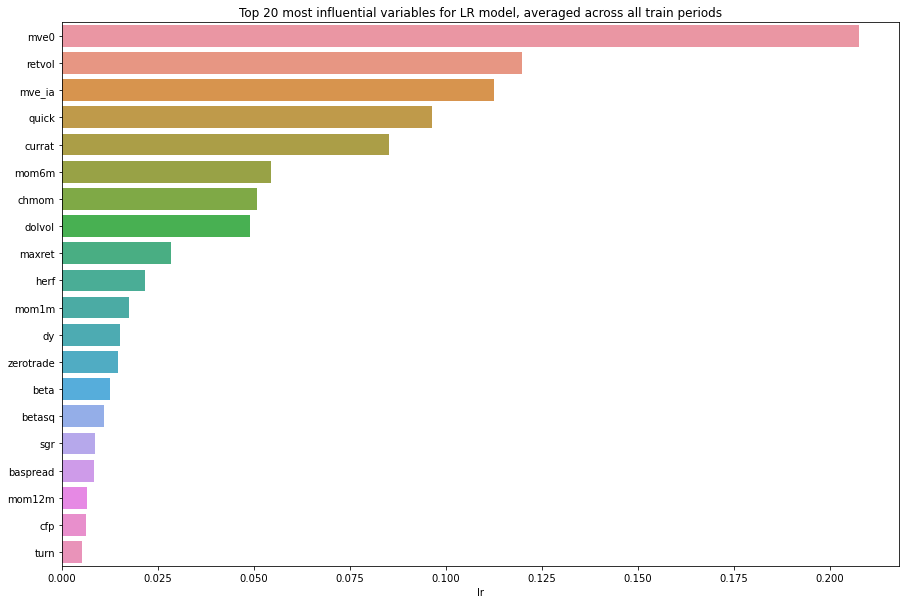

In [81]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [82]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr
absacc,0.000334
acc,0.001302
aeavol,0.000984
age,0.000160
agr,0.000195
baspread,0.008438
beta,0.012467
betasq,0.010939
bm,0.000831
bm_ia,0.002021


,lr,all_models
mve0,94.0,94.0
retvol,93.0,93.0
mve_ia,92.0,92.0
quick,91.0,91.0
currat,90.0,90.0
mom6m,89.0,89.0
chmom,88.0,88.0
dolvol,87.0,87.0
maxret,86.0,86.0
herf,85.0,85.0


## Fama-French 
Only using value and size features

### REIT

In [83]:
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

In [84]:
# Fit OLS on 1990-2000
lr = LinearRegression()
lr.fit(X_train[['bm','mve0']], y_train)
y_pred_train = lr.predict(X_train[['bm','mve0']])
measure_r2(y_train, y_pred_train)

0.3649674043108675

In [85]:
# Validate on 2001-2005
y_pred_validate = lr.predict(X_validate[['bm','mve0']])
measure_r2(y_validate, y_pred_validate)

1.5185913129441508

In [86]:
# Store results
model_name = 'fama-french'

new_results = [{
    'Model Name' : model_name,
    'Selected Config' : 'bm, mve0',
    'Train (1990-2000)' : f'{measure_r2(y_train, y_pred_train):.2f} ({measure_rmse(y_train, y_pred_train):.1f})',
    'Validate (2001-2005)': f'{measure_r2(y_validate, y_pred_validate):.2f} ({measure_rmse(y_validate, y_pred_validate):.1f})'
}]

df_results = pd.concat([df_results, pd.DataFrame(new_results)], axis = 0)

display(df_results)


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [87]:
%%time
# Chosen configuration for model
selected_cfg = [-1]

def model_fit(X_train, y_train, cfg):
    # unpack config
    n = cfg
    model = LinearRegression(n_jobs = n)
    model.fit(X_train[['bm','mve0']], y_train)
    return model

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate[['bm','mve0']])
    return y_pred

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)


# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 3.84
Test year 2006 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -4.46
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -1.84
Test year 2008 done, RMSE score is 20.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is 0.64
Test year 2009 done, RMSE score is 25.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 2.03
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -0.68
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 3.28
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.25
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 3.36
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -1.87
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 2.06
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is 1.06
Test year 2017 done, RMSE score is 7.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -2.57
Test year 2018 done, RMSE score is 8.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),NaN,NaN,NaN


Test year 2019 done, R2 score is 3.50
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.05
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),NaN,3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is 0.17.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

CPU times: user 680 ms, sys: 1.07 s, total: 1.75 s
Wall time: 417 ms


R2 for entire pooled test set, from 2006 to 2020, is 0.17.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

CPU times: user 739 ms, sys: 1.06 s, total: 1.8 s

Wall time: 412 ms

### Features of importance

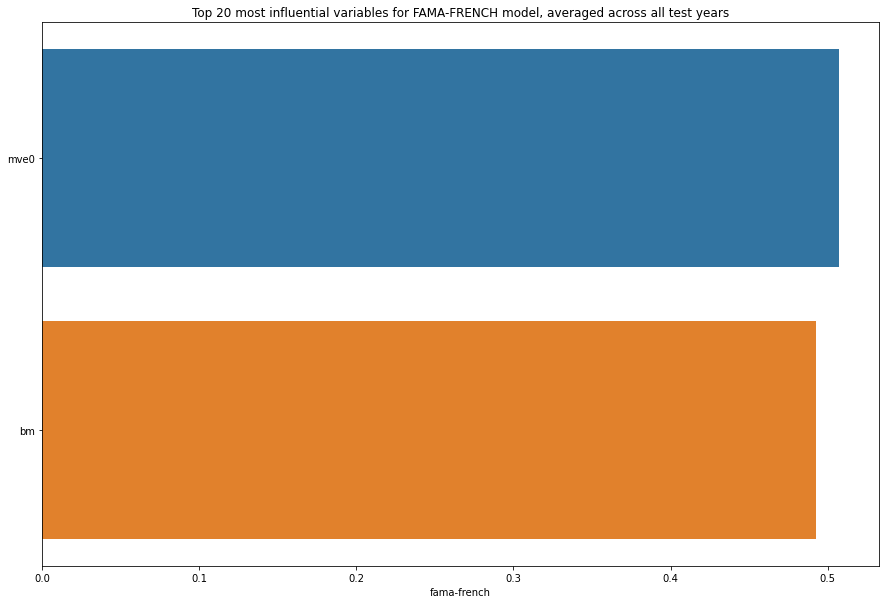

In [88]:
# Extract features from pickled models
model_name = 'fama-french'

model_coef = pd.DataFrame(index = X_train[['bm','mve0']].columns)
for year in range(2006, 2021):
    filename = f'../pickle/{model_name}_{year}.sav'
    model = pickle.load(open(filename,'rb'))
    model_coef[f'coef_{year}'] = np.abs(model.coef_)
    model_coef[f'coef_{year}'] = model_coef[f'coef_{year}'] / model_coef[f'coef_{year}'].sum()

# Average across all years
model_coef[model_name] = model_coef.sum(axis=1)
model_coef[model_name] = model_coef[model_name] / model_coef[model_name].sum()

# Plot graph
model_top20 = model_coef.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all test years')
sns.barplot(data = model_top20, x = model_name, y = model_top20.index);

## Carhart model

### REIT

In [89]:
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

In [90]:
# Fit OLS on 1990-2000
lr = LinearRegression()
lr.fit(X_train[['bm','mve0','mom12m']], y_train)
y_pred_train = lr.predict(X_train[['bm','mve0','mom12m']])
measure_r2(y_train, y_pred_train)

0.5170120026452563

In [91]:
# Validate on 2001-2005
y_pred_validate = lr.predict(X_validate[['bm','mve0','mom12m']])
measure_r2(y_validate, y_pred_validate)

1.6823616745811232

In [92]:
# Store results
model_name = 'carhart'

new_results = [{
    'Model Name' : model_name,
    'Selected Config' : 'bm, mve0, mom12m',
    'Train (1990-2000)' : f'{measure_r2(y_train, y_pred_train):.2f} ({measure_rmse(y_train, y_pred_train):.1f})',
    'Validate (2001-2005)': f'{measure_r2(y_validate, y_pred_validate):.2f} ({measure_rmse(y_validate, y_pred_validate):.1f})'
}]

df_results = pd.concat([df_results, pd.DataFrame(new_results)], axis = 0)

display(df_results)


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [93]:
%%time
# Chosen configuration for model
selected_cfg = [-1]

def model_fit(X_train, y_train, cfg):
    # unpack config
    n = cfg
    model = LinearRegression(n_jobs = n)
    model.fit(X_train[['bm','mve0','mom12m']], y_train)
    return model

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate[['bm','mve0','mom12m']])
    return y_pred

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.37
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -3.46
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -1.33
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is 0.15
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 2.04
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -0.71
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 2.65
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.65
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 3.06
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -1.88
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 1.71
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is 0.85
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -2.06
Test year 2018 done, RMSE score is 8.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),NaN,NaN,NaN


Test year 2019 done, R2 score is 3.34
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.13
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),NaN,4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is 0.16.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

CPU times: user 751 ms, sys: 1.18 s, total: 1.93 s
Wall time: 444 ms


R2 for entire pooled test set, from 2006 to 2020, is 0.16.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

CPU times: user 763 ms, sys: 1.09 s, total: 1.85 s

Wall time: 427 ms

### Features of importance

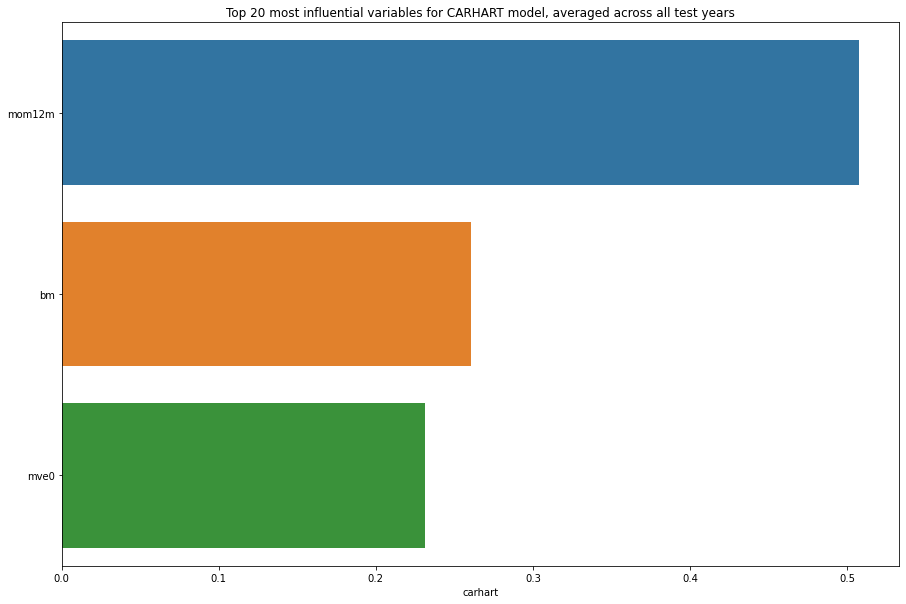

In [94]:
# Extract features from pickled models
model_name = 'carhart'

model_coef = pd.DataFrame(index = X_train[['bm','mve0','mom12m']].columns)
for year in range(2006, 2021):
    filename = f'../pickle/{model_name}_{year}.sav'
    model = pickle.load(open(filename,'rb'))
    model_coef[f'coef_{year}'] = np.abs(model.coef_)
    model_coef[f'coef_{year}'] = model_coef[f'coef_{year}'] / model_coef[f'coef_{year}'].sum()

# Average across all years
model_coef[model_name] = model_coef.sum(axis=1)
model_coef[model_name] = model_coef[model_name] / model_coef[model_name].sum()

# Plot graph
model_top20 = model_coef.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all test years')
sns.barplot(data = model_top20, x = model_name, y = model_top20.index);

## Huber regression
A linear regression model that is robust to outliers to deal with heavy tails commonly found in financial data.
The Huber Regressor optimizes the squared loss for the samples where `|(y - X'w) / sigma| < epsilon` and the absolute loss for the samples where `|(y - X'w) / sigma| > epsilon`, where `w` and `sigma` are parameters to be optimized.

### REIT

In [95]:
df_results = df_results[:3]

In [96]:
def model_configs():
    # define scope of configs
    n_epsilon = [1.1, 1.35, 1.5, 2.0, 2.5, 3.0, 3.5]
    n_alpha = np.logspace(-4, -1, 4)
    # create configs
    configs = []
    for i in n_epsilon:
        for j in n_alpha:
            cfg = [i,j]
            configs.append(cfg)
    print('Total configs (n_epsilon, n_alpha): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_epsilon, n_alpha = cfg
    model = HuberRegressor(
        epsilon = n_epsilon,
        alpha = n_alpha,
        max_iter = 2_000
    )
    model.fit(X_train, y_train)
    return model

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate)
    return y_pred

In [97]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_epsilon, n_alpha): 28


In [98]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'huber'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[1.1, 0.0001], 0.41, 10.2, 0.96, 10.4
[1.1, 0.001], 0.41, 10.2, 0.96, 10.4
[1.1, 0.01], 0.41, 10.2, 0.96, 10.4
[1.1, 0.1], 0.41, 10.2, 0.96, 10.4
[1.35, 0.0001], 0.54, 10.2, 1.07, 10.4
[1.35, 0.001], 0.54, 10.2, 1.07, 10.4
[1.35, 0.01], 0.54, 10.2, 1.07, 10.4
[1.35, 0.1], 0.54, 10.2, 1.07, 10.4
[1.5, 0.0001], 0.61, 10.2, 1.12, 10.4
[1.5, 0.001], 0.61, 10.2, 1.12, 10.4
[1.5, 0.01], 0.61, 10.2, 1.12, 10.4
[1.5, 0.1], 0.61, 10.2, 1.12, 10.4
[2.0, 0.0001], 0.83, 10.2, 1.28, 10.4
[2.0, 0.001], 0.83, 10.2, 1.28, 10.4
[2.0, 0.01], 0.83, 10.2, 1.28, 10.4
[2.0, 0.1], 0.83, 10.2, 1.28, 10.4
[2.5, 0.0001], 0.88, 10.2, 1.43, 10.4
[2.5, 0.001], 0.88, 10.2, 1.43, 10.4
[2.5, 0.01], 0.88, 10.2, 1.43, 10.4
[2.5, 0.1], 0.88, 10.2, 1.43, 10.4
[3.0, 0.0001], 0.90, 10.2, 1.58, 10.4
[3.0, 0.001], 0.90, 10.2, 1.58, 10.4
[3.0, 0.01], 0.90, 10.2, 1.58, 10.4
[3.0, 0.1], 0.91, 10.2, 1.58, 10.4
[3.5, 0.0001], 0.90, 10.2, 1.68, 10.4
[3.5, 0.001], 0.90, 10.2, 1.68, 10.4
[3.5, 0.01], 0.90, 10.2, 1.68, 10.4
[3.5, 0.1

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[3.0, 0.1], 0.91, 10.2, 1.58, 10.4
[3.0, 0.0001], 0.90, 10.2, 1.58, 10.4
[3.0, 0.001], 0.90, 10.2, 1.58, 10.4
[3.0, 0.01], 0.90, 10.2, 1.58, 10.4
[3.5, 0.1], 0.90, 10.2, 1.68, 10.4
[3.5, 0.0001], 0.90, 10.2, 1.68, 10.4
[3.5, 0.001], 0.90, 10.2, 1.68, 10.4
[3.5, 0.01], 0.90, 10.2, 1.68, 10.4
CPU times: user 2min 26s, sys: 52.1 s, total: 3min 18s
Wall time: 37.6 s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[3.0, 0.1], 0.91, 10.2, 1.58, 10.4

[3.0, 0.0001], 0.90, 10.2, 1.58, 10.4

[3.0, 0.001], 0.90, 10.2, 1.58, 10.4

[3.0, 0.01], 0.90, 10.2, 1.58, 10.4

[3.5, 0.1], 0.90, 10.2, 1.68, 10.4

[3.5, 0.0001], 0.90, 10.2, 1.68, 10.4

[3.5, 0.001], 0.90, 10.2, 1.68, 10.4

[3.5, 0.01], 0.90, 10.2, 1.68, 10.4

CPU times: user 2min 4s, sys: 44.4 s, total: 2min 48s

Wall time: 32.1 s

In [99]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 3.50
Test year 2006 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -2.04
Test year 2007 done, RMSE score is 11.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -0.24
Test year 2008 done, RMSE score is 19.8


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is -0.24
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 0.25
Test year 2010 done, RMSE score is 12.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -0.65
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 1.10
Test year 2012 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 0.70
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 2.17
Test year 2014 done, RMSE score is 7.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -2.61
Test year 2015 done, RMSE score is 7.6


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 1.41
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is -0.62
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -2.98
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),NaN,NaN,NaN


Test year 2019 done, R2 score is 2.99
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.31
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),NaN,3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is -0.07.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [3.0, 0.1]
CPU times: user 1min 43s, sys: 41.9 s, total: 2min 25s
Wall time: 28.5 s


R2 for entire pooled test set, from 2006 to 2020, is -0.07.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [3.0, 0.1]

CPU times: user 1min 52s, sys: 39.3 s, total: 2min 32s

Wall time: 28.5 s

## Ridge

### REIT

In [103]:
df_results = df_results[:4]

In [104]:
def model_configs():
    # define scope of configs
    n_alpha = np.logspace(-5, 5, 1000)
    # create configs
    configs = []
    for i in n_alpha:
        cfg = [i]
        configs.append(cfg)
    print('Total configs (n_alpha): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_alpha = cfg
    model = Ridge(
        alpha = n_alpha,
        max_iter = 2_000,
        random_state = 42
    )
    model.fit(X_train, y_train)
    return model

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate)
    return y_pred

In [105]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_alpha): 1000


In [106]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'ridge'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[1e-05], 0.69, 10.2, 1.99, 10.3
[1.0233165783302449e-05], 0.69, 10.2, 1.99, 10.3
[1.0471768194855202e-05], 0.69, 10.2, 1.99, 10.3
[1.0715933998226711e-05], 0.69, 10.2, 1.99, 10.3
[1.09657929126781e-05], 0.69, 10.2, 1.99, 10.3
[1.1221477682079803e-05], 0.69, 10.2, 1.99, 10.3
[1.148312414543511e-05], 0.69, 10.2, 1.99, 10.3
[1.1750871309048075e-05], 0.69, 10.2, 1.99, 10.3
[1.2024861420374123e-05], 0.69, 10.2, 1.99, 10.3
[1.2305240043592616e-05], 0.69, 10.2, 1.99, 10.3
[1.259215613694151e-05], 0.69, 10.2, 1.99, 10.3
[1.288576213185518e-05], 0.69, 10.2, 1.99, 10.3
[1.3186214013947486e-05], 0.69, 10.2, 1.99, 10.3
[1.3493671405883065e-05], 0.69, 10.2, 1.99, 10.3
[1.3808297652180924e-05], 0.69, 10.2, 1.99, 10.3
[1.4130259905995336e-05], 0.69, 10.2, 1.99, 10.3
[1.4459729217920196e-05], 0.69, 10.2, 1.99, 10.3
[1.4796880626863964e-05], 0.69, 10.2, 1.99, 10.3
[1.514189325304352e-05], 0.69, 10.2, 1.99, 10.3
[1.5494950393146317e-05], 0.69, 10.2, 1.99, 10.3
[1.5856239617711373e-05], 0.69, 10.2, 1.99,

[0.0005517492376129129], 0.69, 10.2, 1.99, 10.3
[0.0005646141419303673], 0.69, 10.2, 1.99, 10.3
[0.0005777790117970507], 0.69, 10.2, 1.99, 10.3
[0.0005912508413831881], 0.69, 10.2, 1.99, 10.3
[0.0006050367879391225], 0.69, 10.2, 1.99, 10.3
[0.0006191441755977848], 0.69, 10.2, 1.99, 10.3
[0.0006335804992658254], 0.69, 10.2, 1.99, 10.3
[0.0006483534286054727], 0.69, 10.2, 1.99, 10.3
[0.0006634708121092351], 0.69, 10.2, 1.99, 10.3
[0.0006789406812696112], 0.69, 10.2, 1.99, 10.3
[0.000694771254846024], 0.69, 10.2, 1.99, 10.3
[0.0007109709432312439], 0.69, 10.2, 1.99, 10.3
[0.0007275483529196233], 0.69, 10.2, 1.99, 10.3
[0.0007445122910795143], 0.69, 10.2, 1.99, 10.3
[0.0007618717702322999], 0.69, 10.2, 1.99, 10.3
[0.0007796360130405237], 0.69, 10.2, 1.99, 10.3
[0.0007978144572076629], 0.69, 10.2, 1.99, 10.3
[0.0008164167604921472], 0.69, 10.2, 1.99, 10.3
[0.0008354528058382871], 0.69, 10.2, 1.99, 10.3
[0.0008549327066268385], 0.69, 10.2, 1.99, 10.3
[0.0008748668120479914], 0.69, 10.2, 1.99

[0.0326222200971167], 0.69, 10.2, 1.99, 10.3
[0.03338285864731761], 0.69, 10.2, 1.99, 10.3
[0.03416123268585528], 0.69, 10.2, 1.99, 10.3
[0.03495775574363275], 0.69, 10.2, 1.99, 10.3
[0.03577285099367873], 0.69, 10.2, 1.99, 10.3
[0.03660695147596903], 0.69, 10.2, 1.99, 10.3
[0.03746050032748993], 0.69, 10.2, 1.99, 10.3
[0.03833395101766601], 0.69, 10.2, 1.99, 10.3
[0.03922776758927719], 0.69, 10.2, 1.99, 10.3
[0.04014242490499322], 0.69, 10.2, 1.99, 10.3
[0.04107840889965647], 0.69, 10.2, 1.99, 10.3
[0.04203621683844714], 0.69, 10.2, 1.99, 10.3
[0.04301635758106795], 0.69, 10.2, 1.99, 10.3
[0.044019351852088745], 0.69, 10.2, 1.99, 10.3
[0.04504573251759458], 0.69, 10.2, 1.99, 10.3
[0.046096044868284336], 0.69, 10.2, 1.99, 10.3
[0.04717084690917017], 0.69, 10.2, 1.99, 10.3
[0.04827070965603183], 0.69, 10.2, 1.99, 10.3
[0.04939621743878321], 0.69, 10.2, 1.99, 10.3
[0.0505479682119124], 0.69, 10.2, 1.99, 10.3
[0.05172657387216019], 0.69, 10.2, 1.99, 10.3
[0.052932660583605615], 0.69, 10.2

[2.1643890860640203], 0.70, 10.2, 1.99, 10.3
[2.214855233726359], 0.70, 10.2, 1.99, 10.3
[2.266498079273693], 0.70, 10.2, 1.99, 10.3
[2.3193450592744274], 0.70, 10.2, 1.99, 10.3
[2.373424250023866], 0.70, 10.2, 1.99, 10.3
[2.4287643824604506], 0.70, 10.2, 1.99, 10.3
[2.4853948574297986], 0.70, 10.2, 1.99, 10.3
[2.543345761304648], 0.70, 10.2, 1.99, 10.3
[2.6026478819690047], 0.70, 10.2, 1.99, 10.3
[2.6633327251749805], 0.70, 10.2, 1.99, 10.3
[2.7254325312810277], 0.70, 10.2, 1.99, 10.3
[2.7889802923804394], 0.70, 10.2, 1.99, 10.3
[2.8540097698292373], 0.70, 10.2, 1.99, 10.3
[2.920555512182745], 0.70, 10.2, 1.99, 10.3
[2.988652873550383], 0.70, 10.2, 1.99, 10.3
[3.0583380323784315], 0.70, 10.2, 1.99, 10.3
[3.1296480106707505], 0.70, 10.2, 1.99, 10.3
[3.20262069365765], 0.70, 10.2, 1.99, 10.3
[3.277294849923382], 0.70, 10.2, 1.99, 10.3
[3.353710152002929], 0.70, 10.2, 1.99, 10.3
[3.4319071974590427], 0.70, 10.2, 1.99, 10.3
[3.511927530450728], 0.70, 10.2, 1.99, 10.3
[3.593813663804626], 

[161.14142772530198], 0.99, 10.2, 1.97, 10.3
[164.8986944471065], 1.00, 10.2, 1.97, 10.3
[168.74356777273758], 1.00, 10.2, 1.97, 10.3
[172.6780903884356], 1.00, 10.2, 1.97, 10.3
[176.70435260889465], 1.01, 10.2, 1.97, 10.3
[180.82449348779517], 1.01, 10.2, 1.97, 10.3
[185.0407019542302], 1.02, 10.2, 1.97, 10.3
[189.35521797562953], 1.02, 10.2, 1.97, 10.3
[193.7703337477989], 1.03, 10.2, 1.96, 10.3
[198.28839491270713], 1.03, 10.2, 1.96, 10.3
[202.91180180466782], 1.03, 10.2, 1.96, 10.3
[207.64301072557748], 1.04, 10.2, 1.96, 10.3
[212.4845352498883], 1.04, 10.2, 1.96, 10.3
[217.438947560008], 1.05, 10.2, 1.96, 10.3
[222.50887981283694], 1.05, 10.2, 1.96, 10.3
[227.697025538168], 1.06, 10.2, 1.96, 10.3
[233.00614106969246], 1.06, 10.2, 1.96, 10.3
[238.43904700937205], 1.07, 10.2, 1.96, 10.3
[243.99862972595503], 1.07, 10.2, 1.96, 10.3
[249.68784288843267], 1.08, 10.2, 1.96, 10.3
[255.5097090352507], 1.08, 10.2, 1.96, 10.3
[261.4673211801092], 1.08, 10.2, 1.96, 10.3
[267.5638444552045], 

[11997.177354358855], 1.79, 10.2, 1.34, 10.4
[12276.910479883603], 1.80, 10.2, 1.33, 10.4
[12563.166024741215], 1.80, 10.2, 1.32, 10.4
[12856.096069432964], 1.80, 10.2, 1.32, 10.4
[13155.856240457053], 1.80, 10.2, 1.31, 10.4
[13462.60579298911], 1.80, 10.2, 1.30, 10.4
[13776.507695490549], 1.80, 10.2, 1.30, 10.4
[14097.728716289677], 1.81, 10.2, 1.29, 10.4
[14426.439512181589], 1.81, 10.2, 1.28, 10.4
[14762.81471909391], 1.81, 10.2, 1.28, 10.4
[15107.033044866555], 1.81, 10.2, 1.27, 10.4
[15459.277364194786], 1.81, 10.2, 1.26, 10.4
[15819.734815786014], 1.81, 10.2, 1.26, 10.4
[16188.596901781992], 1.81, 10.2, 1.25, 10.4
[16566.059589499153], 1.81, 10.2, 1.24, 10.4
[16952.323415541214], 1.81, 10.2, 1.24, 10.4
[17347.593592339326], 1.81, 10.2, 1.23, 10.4
[17752.08011717636], 1.81, 10.2, 1.22, 10.4
[18165.997883753287], 1.81, 10.2, 1.21, 10.4
[18589.56679635688], 1.81, 10.2, 1.21, 10.4
[19023.01188668946], 1.82, 10.2, 1.20, 10.4
[19466.563433422634], 1.82, 10.2, 1.19, 10.4
[19920.45708453

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[19920.457084538713], 1.82, 10.2, 1.19, 10.4
[20384.933982524642], 1.82, 10.2, 1.18, 10.4
[19466.563433422634], 1.82, 10.2, 1.19, 10.4
[20860.24089248505], 1.82, 10.2, 1.17, 10.4
[19023.01188668946], 1.82, 10.2, 1.20, 10.4
[21346.630333242454], 1.82, 10.2, 1.16, 10.4
[18589.56679635688], 1.81, 10.2, 1.21, 10.4
[21844.360711494282], 1.81, 10.2, 1.16, 10.4
CPU times: user 1min 16s, sys: 48.8 s, total: 2min 5s
Wall time: 26.9 s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[19920.457084538713], 1.82, 10.2, 1.19, 10.4

[20384.933982524642], 1.82, 10.2, 1.18, 10.4

[19466.563433422634], 1.82, 10.2, 1.19, 10.4

[20860.24089248505], 1.82, 10.2, 1.17, 10.4

[19023.01188668946], 1.82, 10.2, 1.20, 10.4

[21346.630333242454], 1.82, 10.2, 1.16, 10.4

[18589.56679635688], 1.81, 10.2, 1.21, 10.4

[21844.360711494282], 1.81, 10.2, 1.16, 10.4

CPU times: user 1min 34s, sys: 43.8 s, total: 2min 18s

Wall time: 27.8 s

In [107]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.43
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -3.65
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -1.12
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is 0.16
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 1.98
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -1.29
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 3.80
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.91
Test year 2013 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 2.74
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -1.82
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 2.31
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is 0.49
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -4.39
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),NaN,NaN,NaN


Test year 2019 done, R2 score is 4.05
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.13
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),NaN,4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is 0.18.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [19920.457084538713]
CPU times: user 1.61 s, sys: 2.52 s, total: 4.13 s
Wall time: 925 ms


R2 for entire pooled test set, from 2006 to 2020, is 0.18.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [19920.457084538713]

CPU times: user 1.57 s, sys: 2.47 s, total: 4.04 s

Wall time: 955 ms

### Features of importance

In [108]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'ridge'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

CPU times: user 2min 21s, sys: 1min 4s, total: 3min 26s
Wall time: 41.6 s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,ridge
absacc,0.000132,0.000114,1.697211e-03,0.002516,1.737480e-04,0.000219,5.618443e-06,4.426166e-06,1.660469e-04,8.787436e-04,5.360613e-04,6.565045e-04,2.869578e-04,1.340664e-04,7.306461e-07,0.000622
acc,0.005238,0.004227,5.736912e-04,0.000004,1.508598e-04,0.000387,1.637066e-04,5.055037e-04,9.692878e-04,1.297584e-03,1.277859e-03,1.673896e-03,1.829191e-03,1.970992e-03,5.305563e-03,0.002116
aeavol,0.004114,0.004209,7.973546e-03,0.014194,1.116961e-02,0.006156,2.868448e-03,2.969223e-03,3.358837e-03,3.035947e-03,2.756990e-03,4.734095e-03,6.278910e-03,5.534833e-03,5.497772e-03,0.007019
age,0.004049,0.003047,2.495719e-03,0.000086,8.001490e-04,0.000123,3.103288e-04,7.843510e-04,4.651630e-04,8.030210e-04,8.803552e-04,7.850381e-04,5.483342e-04,3.552452e-04,6.237575e-04,0.001337
agr,0.002054,0.002801,1.852968e-03,0.003947,2.058324e-03,0.001246,2.412740e-03,1.437477e-03,2.260370e-03,2.966977e-03,2.383547e-03,2.620647e-03,3.210830e-03,2.205203e-03,3.342313e-03,0.003044
baspread,0.002734,0.004305,3.384904e-05,0.000718,1.344620e-03,0.003092,1.979320e-03,2.225401e-03,3.708205e-03,3.045566e-03,2.402235e-03,2.123172e-03,2.619237e-03,1.358503e-03,2.573570e-03,0.002834
beta,0.000005,0.000072,1.526270e-04,0.000235,1.665021e-03,0.003892,3.698897e-03,2.798587e-03,3.733748e-03,3.326279e-03,2.517403e-03,4.951965e-03,3.367550e-03,2.226654e-03,2.767456e-03,0.002929
betasq,0.002004,0.002269,2.835920e-03,0.008907,1.713209e-03,0.000336,6.190737e-04,3.501398e-04,8.694907e-07,1.852641e-05,8.833258e-05,4.186171e-05,2.410522e-04,7.841577e-04,4.582856e-04,0.001710
bm,0.035556,0.028091,1.393151e-02,0.019931,1.143107e-02,0.010927,1.158409e-02,7.999364e-03,1.221159e-02,9.566133e-03,8.078531e-03,7.160382e-03,6.490478e-03,1.593206e-02,1.458892e-02,0.017660
bm_ia,0.014896,0.013519,2.057591e-02,0.011877,1.798314e-03,0.001247,2.375964e-03,2.741079e-03,2.815169e-03,2.103193e-03,1.597701e-03,1.207895e-03,1.577406e-03,1.758360e-03,1.406373e-03,0.006742


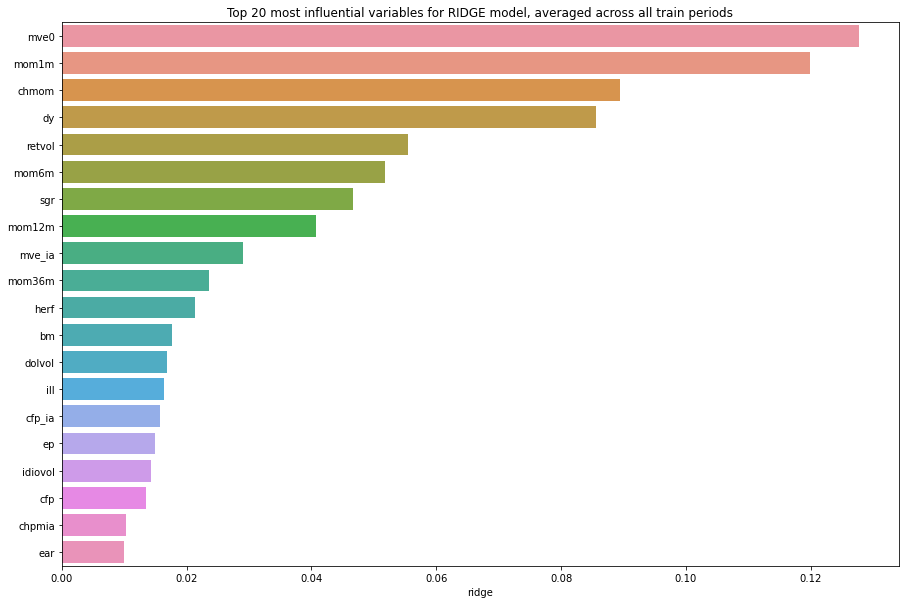

In [109]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [110]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,huber,ridge
absacc,0.000334,-0.001204,0.000622
acc,0.001302,-0.000261,0.002116
aeavol,0.000984,0.000828,0.007019
age,0.000160,0.000057,0.001337
agr,0.000195,0.005173,0.003044
baspread,0.008438,0.008050,0.002834
beta,0.012467,0.063625,0.002929
betasq,0.010939,0.007942,0.001710
bm,0.000831,0.000825,0.017660
bm_ia,0.002021,0.003463,0.006742


,lr,huber,ridge,all_models
mve0,94.0,94.0,94.0,282.0
mve_ia,92.0,93.0,86.0,271.0
retvol,93.0,86.0,90.0,269.0
chmom,88.0,88.0,92.0,268.0
mom6m,89.0,85.0,89.0,263.0
mom1m,84.0,84.0,93.0,261.0
dolvol,87.0,92.0,82.0,261.0
dy,83.0,81.0,91.0,255.0
herf,85.0,83.0,84.0,252.0
sgr,79.0,79.0,88.0,246.0


## Lasso

### REIT

In [111]:
df_results = df_results[:5]

In [112]:
def model_configs():
    # define scope of configs
    n_alpha = np.logspace(-4, 0, 50)
    # create configs
    configs = []
    for i in n_alpha:
        cfg = [i]
        configs.append(cfg)
    print('Total configs (n_alpha): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_alpha = cfg
    model = Lasso(
        alpha = n_alpha,
        max_iter = 2_000,
        random_state = 42
    )
    model.fit(X_train, y_train)
    return model

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate)
    return y_pred

In [113]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_alpha): 50


In [114]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'lasso'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[0.0001], 0.70, 10.2, 1.99, 10.3
[0.00012067926406393288], 0.70, 10.2, 1.99, 10.3
[0.00014563484775012445], 0.70, 10.2, 1.99, 10.3
[0.00017575106248547912], 0.70, 10.2, 1.99, 10.3
[0.00021209508879201905], 0.71, 10.2, 1.99, 10.3
[0.0002559547922699536], 0.71, 10.2, 1.99, 10.3
[0.00030888435964774815], 0.72, 10.2, 1.99, 10.3
[0.0003727593720314938], 0.72, 10.2, 1.99, 10.3
[0.0004498432668969444], 0.73, 10.2, 1.99, 10.3
[0.0005428675439323859], 0.74, 10.2, 1.99, 10.3
[0.0006551285568595509], 0.75, 10.2, 1.99, 10.3
[0.0007906043210907702], 0.76, 10.2, 1.99, 10.3
[0.0009540954763499944], 0.78, 10.2, 1.99, 10.3
[0.0011513953993264468], 0.79, 10.2, 1.99, 10.3
[0.0013894954943731374], 0.81, 10.2, 1.99, 10.3
[0.0016768329368110067], 0.83, 10.2, 1.99, 10.3
[0.0020235896477251557], 0.85, 10.2, 1.99, 10.3
[0.0024420530945486497], 0.88, 10.2, 1.98, 10.3
[0.0029470517025518097], 0.91, 10.2, 1.98, 10.3
[0.0035564803062231283], 0.95, 10.2, 1.97, 10.3
[0.004291934260128779], 0.99, 10.2, 1.96, 10.3
[0.

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[0.07196856730011514], 1.93, 10.2, 1.28, 10.4
[0.05963623316594643], 1.91, 10.2, 1.43, 10.4
[0.08685113737513521], 1.88, 10.2, 1.13, 10.4
[0.04941713361323833], 1.87, 10.2, 1.56, 10.4
[0.10481131341546852], 1.83, 10.2, 0.98, 10.4
[0.12648552168552957], 1.81, 10.2, 0.87, 10.4
[0.040949150623804234], 1.80, 10.2, 1.66, 10.4
[0.15264179671752318], 1.76, 10.2, 0.77, 10.4
CPU times: user 2min 37s, sys: 47.3 s, total: 3min 25s
Wall time: 39 s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[0.07196856730011514], 1.93, 10.2, 1.28, 10.4

[0.05963623316594643], 1.91, 10.2, 1.43, 10.4

[0.08685113737513521], 1.88, 10.2, 1.13, 10.4

[0.04941713361323833], 1.87, 10.2, 1.56, 10.4

[0.10481131341546852], 1.83, 10.2, 0.98, 10.4

[0.12648552168552957], 1.81, 10.2, 0.87, 10.4

[0.040949150623804234], 1.80, 10.2, 1.66, 10.4

[0.15264179671752318], 1.76, 10.2, 0.77, 10.4

CPU times: user 2min 38s, sys: 47.1 s, total: 3min 25s

Wall time: 38.5 s

In [115]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.37
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -3.54
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -1.09
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is 0.26
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 2.08
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -1.03
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 3.42
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.89
Test year 2013 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 3.51
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -1.64
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 1.70
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is 0.50
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -4.16
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),NaN,NaN,NaN


Test year 2019 done, R2 score is 4.21
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.07
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is 0.23.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [0.07196856730011514]
CPU times: user 6.47 s, sys: 6.46 s, total: 12.9 s
Wall time: 3.02 s


R2 for entire pooled test set, from 2006 to 2020, is 0.23.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [0.07196856730011514]

CPU times: user 6.56 s, sys: 6.59 s, total: 13.1 s

Wall time: 3.11 s

### Features of importance

In [116]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'lasso'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

CPU times: user 2min 36s, sys: 59.6 s, total: 3min 36s
Wall time: 40.5 s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,lasso
absacc,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
acc,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
aeavol,0.000000,0.000000,0.003911,0.012655,0.009638,0.003356,0.000000,0.000000,0.000000,0.000000,0.000000,0.001219,0.002539,0.001580,0.001750,0.002913
age,0.000339,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000027
agr,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
baspread,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
beta,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
betasq,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
bm,0.048123,0.039077,0.016078,0.025237,0.013510,0.012061,0.012171,0.007742,0.013461,0.009804,0.006903,0.005014,0.004814,0.017331,0.015904,0.019649
bm_ia,0.014908,0.013160,0.025297,0.014245,0.000150,0.000000,0.000555,0.001278,0.000846,0.000128,0.000000,0.000000,0.000000,0.000000,0.000000,0.005609


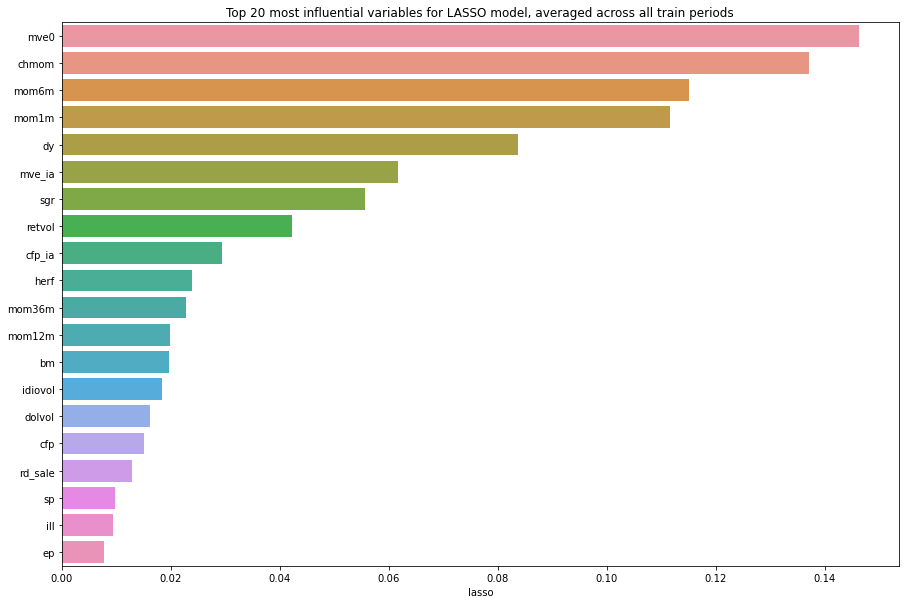

In [117]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [118]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,huber,ridge,lasso
absacc,0.000334,-0.001204,0.000622,0.000000
acc,0.001302,-0.000261,0.002116,0.000000
aeavol,0.000984,0.000828,0.007019,0.002913
age,0.000160,0.000057,0.001337,0.000027
agr,0.000195,0.005173,0.003044,0.000000
baspread,0.008438,0.008050,0.002834,0.000000
beta,0.012467,0.063625,0.002929,0.000000
betasq,0.010939,0.007942,0.001710,0.000000
bm,0.000831,0.000825,0.017660,0.019649
bm_ia,0.002021,0.003463,0.006742,0.005609


,lr,huber,ridge,lasso,all_models
mve0,94.0,94.0,94.0,94.0,376.0
chmom,88.0,88.0,92.0,93.0,361.0
mve_ia,92.0,93.0,86.0,89.0,360.0
retvol,93.0,86.0,90.0,87.0,356.0
mom6m,89.0,85.0,89.0,92.0,355.0
mom1m,84.0,84.0,93.0,91.0,352.0
dy,83.0,81.0,91.0,90.0,345.0
dolvol,87.0,92.0,82.0,80.0,341.0
herf,85.0,83.0,84.0,85.0,337.0
sgr,79.0,79.0,88.0,88.0,334.0


## Elastic net regression

### REIT

In [119]:
df_results = df_results[:6]

In [120]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    enet_ratio = [0.3, 0.5, 0.7, 0.9]
    enet_alpha = np.logspace(-4, 0, 30) # np.logspace(-4, 0, 50)
    # create configs
    configs = []
    for i in enet_ratio:
        for j in enet_alpha:
            cfg = [i,j]
            configs.append(cfg)
    print('Total configs (enet_ratio, enet_alpha): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    enet_ratio, enet_alpha = cfg
    model = ElasticNet(
        l1_ratio = enet_ratio,
        alpha = enet_alpha,
        random_state = 42,
        max_iter = 2_000, 
    )
    model.fit(X_train, y_train)
    return model

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate)
    return y_pred

In [121]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (enet_ratio, enet_alpha): 120


In [122]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'enet'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[0.3, 0.0001], 0.70, 10.2, 1.99, 10.3
[0.3, 0.00013738237958832623], 0.70, 10.2, 1.99, 10.3
[0.3, 0.00018873918221350977], 0.71, 10.2, 1.99, 10.3
[0.3, 0.0002592943797404667], 0.71, 10.2, 1.99, 10.3
[0.3, 0.0003562247890262444], 0.72, 10.2, 1.99, 10.3
[0.3, 0.0004893900918477494], 0.73, 10.2, 1.99, 10.3
[0.3, 0.0006723357536499335], 0.75, 10.2, 1.99, 10.3
[0.3, 0.0009236708571873865], 0.77, 10.2, 1.99, 10.3
[0.3, 0.0012689610031679222], 0.79, 10.2, 1.99, 10.3
[0.3, 0.0017433288221999873], 0.82, 10.2, 1.99, 10.3
[0.3, 0.002395026619987486], 0.85, 10.2, 1.99, 10.3
[0.3, 0.0032903445623126675], 0.89, 10.2, 1.98, 10.3
[0.3, 0.004520353656360241], 0.94, 10.2, 1.98, 10.3
[0.3, 0.006210169418915616], 1.00, 10.2, 1.97, 10.3
[0.3, 0.008531678524172805], 1.07, 10.2, 1.96, 10.3
[0.3, 0.011721022975334805], 1.15, 10.2, 1.95, 10.3
[0.3, 0.01610262027560939], 1.24, 10.2, 1.93, 10.3
[0.3, 0.02212216291070448], 1.34, 10.2, 1.90, 10.3
[0.3, 0.03039195382313198], 1.44, 10.2, 1.87, 10.3
[0.3, 0.041753189

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[0.9, 0.07880462815669913], 1.93, 10.2, 1.28, 10.4
[0.7, 0.1082636733874054], 1.90, 10.2, 1.19, 10.4
[0.7, 0.07880462815669913], 1.90, 10.2, 1.42, 10.4
[0.5, 0.1082636733874054], 1.89, 10.2, 1.38, 10.4
[0.3, 0.20433597178569418], 1.89, 10.2, 1.21, 10.4
[0.9, 0.05736152510448681], 1.88, 10.2, 1.52, 10.4
[0.5, 0.14873521072935117], 1.88, 10.2, 1.16, 10.4
[0.3, 0.14873521072935117], 1.86, 10.2, 1.40, 10.4
CPU times: user 6min 27s, sys: 1min 57s, total: 8min 25s
Wall time: 1min 36s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[0.9, 0.07880462815669913], 1.93, 10.2, 1.28, 10.4

[0.7, 0.1082636733874054], 1.90, 10.2, 1.19, 10.4

[0.7, 0.07880462815669913], 1.90, 10.2, 1.42, 10.4

[0.5, 0.1082636733874054], 1.89, 10.2, 1.38, 10.4

[0.3, 0.20433597178569418], 1.89, 10.2, 1.21, 10.4

[0.9, 0.05736152510448681], 1.88, 10.2, 1.52, 10.4

[0.5, 0.14873521072935117], 1.88, 10.2, 1.16, 10.4

[0.3, 0.14873521072935117], 1.86, 10.2, 1.40, 10.4

CPU times: user 6min 28s, sys: 1min 58s, total: 8min 26s

Wall time: 1min 35s

In [123]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.37
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -3.54
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -1.09
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is 0.26
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 2.08
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -1.03
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 3.43
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.90
Test year 2013 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 3.52
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -1.63
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 1.71
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is 0.52
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -4.17
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),NaN,NaN,NaN


Test year 2019 done, R2 score is 4.20
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.07
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),NaN,4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is 0.23.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [0.9, 0.07880462815669913]
CPU times: user 6.3 s, sys: 6.58 s, total: 12.9 s
Wall time: 2.81 s


R2 for entire pooled test set, from 2006 to 2020, is 0.23.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [0.9, 0.07880462815669913]

CPU times: user 6.03 s, sys: 6.38 s, total: 12.4 s

Wall time: 2.89 s

### Features of importance

In [124]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'enet'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

CPU times: user 2min 34s, sys: 59.2 s, total: 3min 33s
Wall time: 40.6 s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,enet
absacc,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
acc,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
aeavol,0.000000,0.000000,0.004016,0.012708,0.009692,0.003435,0.000000,0.000000,0.000000,0.000000,0.000000,0.001318,0.002631,0.001692,0.001855,0.003030
age,0.000558,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000045
agr,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000109,0.000009
baspread,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
beta,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
betasq,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
bm,0.048046,0.038973,0.016035,0.025240,0.013625,0.012154,0.012255,0.007818,0.013485,0.009841,0.006949,0.005125,0.004915,0.017368,0.015906,0.020096
bm_ia,0.014749,0.013033,0.025000,0.014014,0.000139,0.000000,0.000538,0.001266,0.000878,0.000153,0.000000,0.000000,0.000000,0.000000,0.000000,0.005660


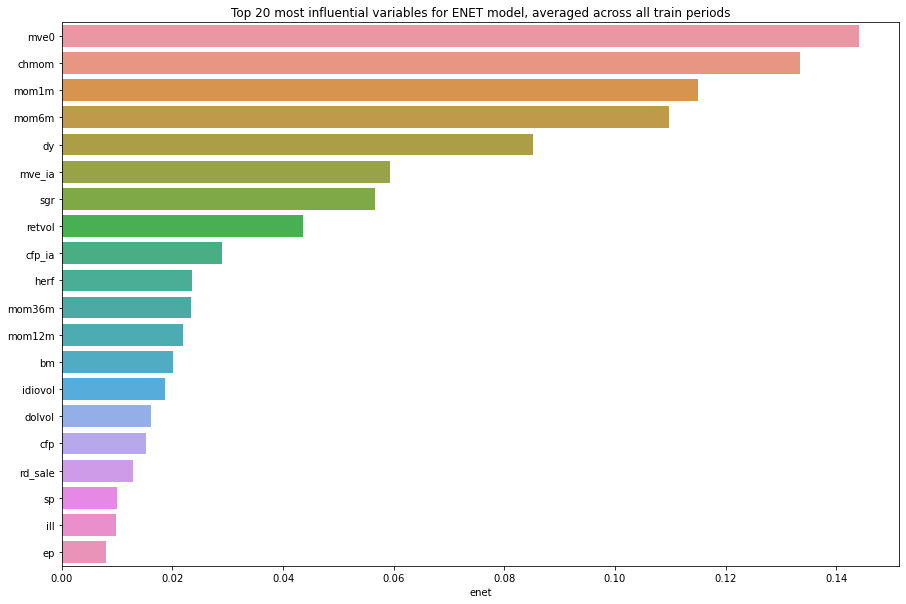

In [125]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [126]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,huber,ridge,lasso,enet
absacc,0.000334,-0.001204,0.000622,0.000000,0.000000
acc,0.001302,-0.000261,0.002116,0.000000,0.000000
aeavol,0.000984,0.000828,0.007019,0.002913,0.003030
age,0.000160,0.000057,0.001337,0.000027,0.000045
agr,0.000195,0.005173,0.003044,0.000000,0.000009
baspread,0.008438,0.008050,0.002834,0.000000,0.000000
beta,0.012467,0.063625,0.002929,0.000000,0.000000
betasq,0.010939,0.007942,0.001710,0.000000,0.000000
bm,0.000831,0.000825,0.017660,0.019649,0.020096
bm_ia,0.002021,0.003463,0.006742,0.005609,0.005660


,lr,huber,ridge,lasso,enet,all_models
mve0,94.0,94.0,94.0,94.0,94.0,470.0
chmom,88.0,88.0,92.0,93.0,93.0,454.0
mve_ia,92.0,93.0,86.0,89.0,89.0,449.0
mom6m,89.0,85.0,89.0,92.0,91.0,446.0
mom1m,84.0,84.0,93.0,91.0,92.0,444.0
retvol,93.0,86.0,90.0,87.0,87.0,443.0
dy,83.0,81.0,91.0,90.0,90.0,435.0
herf,85.0,83.0,84.0,85.0,85.0,422.0
sgr,79.0,79.0,88.0,88.0,88.0,422.0
dolvol,87.0,92.0,82.0,80.0,80.0,421.0


## Principal component regression

### REIT

In [127]:
df_results = df_results[:7]

In [128]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    configs = [1, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 75]
    print('Total configs (K_components): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    K = cfg
    model = make_pipeline(
        PCA(n_components = K),
        LinearRegression()
    )
    model.fit(X_train, y_train)
    return model


In [129]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (K_components): 12


In [130]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'pcr'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

1, 1.43, 10.2, 0.30, 10.4
5, 1.44, 10.2, 0.31, 10.4
10, 1.62, 10.2, 0.39, 10.4
15, 1.70, 10.2, 0.41, 10.4
20, 1.70, 10.2, 0.64, 10.4
25, 1.85, 10.2, 0.92, 10.4
30, 1.74, 10.2, 0.96, 10.4
35, 1.70, 10.2, 0.97, 10.4
40, 1.70, 10.2, 1.01, 10.4
45, 1.75, 10.2, 1.07, 10.4
50, 1.61, 10.2, 1.12, 10.4
75, 1.17, 10.2, 1.40, 10.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
25, 1.85, 10.2, 0.92, 10.4
45, 1.75, 10.2, 1.07, 10.4
30, 1.74, 10.2, 0.96, 10.4
35, 1.70, 10.2, 0.97, 10.4
40, 1.70, 10.2, 1.01, 10.4
15, 1.70, 10.2, 0.41, 10.4
20, 1.70, 10.2, 0.64, 10.4
10, 1.62, 10.2, 0.39, 10.4
CPU times: user 5.3 s, sys: 5.22 s, total: 10.5 s
Wall time: 2.32 s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

25, 1.90, 10.2, 0.94, 10.4

30, 1.71, 10.2, 0.91, 10.4

40, 1.71, 10.2, 1.02, 10.4

35, 1.70, 10.2, 0.97, 10.4

20, 1.68, 10.2, 0.72, 10.4

45, 1.68, 10.2, 1.09, 10.4

10, 1.68, 10.2, 0.40, 10.4

50, 1.67, 10.2, 1.10, 10.4

CPU times: user 4.85 s, sys: 3.95 s, total: 8.8 s

Wall time: 1.89 s

In [131]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 3.74
Test year 2006 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -3.98
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -1.22
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is 0.20
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 2.05
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -1.10
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 3.43
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.63
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 2.83
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -1.99
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 1.85
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is -0.09
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -4.05
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),NaN,NaN,NaN


Test year 2019 done, R2 score is 4.02
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.18
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),NaN,3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN



R2 for entire pooled test set, from 2006 to 2020, is 0.08.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: 25
CPU times: user 13.5 s, sys: 10.6 s, total: 24.1 s
Wall time: 5.33 s


R2 for entire pooled test set, from 2006 to 2020, is 0.07.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: 25

CPU times: user 13.5 s, sys: 9.71 s, total: 23.2 s

Wall time: 5.49 s

### Features of importance

In [132]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'pcr'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

CPU times: user 4min 46s, sys: 1min 19s, total: 6min 5s
Wall time: 1min 8s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,pcr
absacc,-0.001699,-2.653966e-04,-0.002614,-1.445274e-03,-0.002144,-0.003637,-0.000169,-6.521947e-04,0.000150,0.000981,-7.395270e-04,7.529318e-04,3.344528e-04,5.518878e-04,2.878665e-04,-0.002456
acc,0.002224,1.431198e-03,-0.001195,-2.302298e-03,-0.002442,-0.002487,-0.001212,-2.874765e-03,-0.002032,-0.001514,-3.881032e-03,-4.829554e-03,-4.507153e-03,-3.129680e-03,-4.246124e-03,-0.007864
aeavol,0.001590,-3.803190e-04,0.008663,8.200323e-03,0.007584,0.003539,0.002863,-4.777250e-03,-0.001935,0.000989,2.411078e-03,3.140520e-03,-2.707890e-03,9.461217e-04,1.959293e-03,0.007646
age,-0.000038,-2.865698e-03,-0.005882,-4.262468e-03,-0.007092,-0.003170,-0.003446,-1.134631e-03,-0.004825,-0.005534,-3.881771e-03,-1.980466e-03,-6.598003e-03,-3.573633e-03,-3.093571e-03,-0.013675
agr,0.001263,1.947527e-03,0.000403,2.032247e-03,0.000391,0.000942,0.000793,-4.411260e-04,0.000369,0.000377,8.267257e-04,1.129429e-03,1.330218e-03,3.357609e-04,1.380793e-03,0.003117
baspread,0.000405,-6.997022e-04,0.000999,2.034026e-03,-0.000810,-0.000871,-0.001118,-1.424836e-03,-0.000936,-0.001699,-1.097223e-03,-4.156033e-04,-1.352403e-03,-1.845372e-04,-5.522948e-04,-0.001840
beta,-0.003969,-7.063023e-04,-0.000140,-5.118733e-05,0.000363,0.001203,0.001351,-1.249423e-04,0.001571,0.001579,9.979356e-04,1.144904e-03,9.022814e-04,5.768567e-04,6.775813e-04,0.001281
betasq,-0.007026,-2.652427e-03,-0.001128,-7.602539e-04,-0.000674,-0.000146,-0.000720,2.153089e-05,-0.000004,-0.000275,1.508102e-04,3.706925e-04,-1.237721e-03,-6.403549e-04,-3.837505e-04,-0.003600
bm,0.023673,1.808718e-02,0.009853,6.425007e-03,0.004130,0.003776,0.005839,5.983095e-03,0.008200,0.006419,2.893979e-03,6.413782e-04,2.882177e-03,4.183278e-03,2.147559e-03,0.025056
bm_ia,0.010861,9.695865e-03,0.016487,1.052652e-02,0.001769,0.001510,0.002139,2.336190e-03,0.002857,0.000594,1.551674e-03,1.328765e-03,1.748474e-03,2.402871e-03,2.035850e-03,0.016169


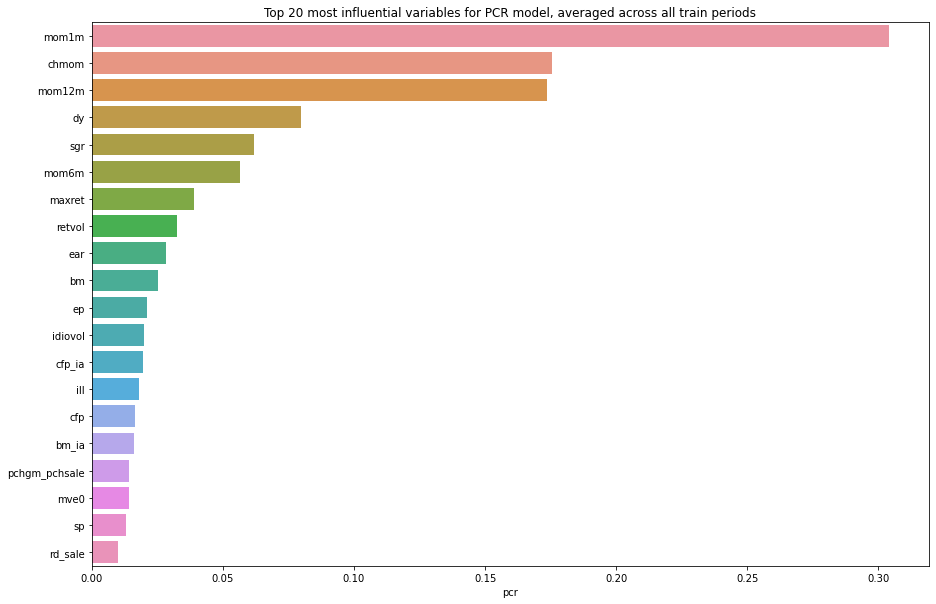

In [133]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [134]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,huber,ridge,lasso,enet,pcr
absacc,0.000334,-0.001204,0.000622,0.000000,0.000000,-0.002456
acc,0.001302,-0.000261,0.002116,0.000000,0.000000,-0.007864
aeavol,0.000984,0.000828,0.007019,0.002913,0.003030,0.007646
age,0.000160,0.000057,0.001337,0.000027,0.000045,-0.013675
agr,0.000195,0.005173,0.003044,0.000000,0.000009,0.003117
baspread,0.008438,0.008050,0.002834,0.000000,0.000000,-0.001840
beta,0.012467,0.063625,0.002929,0.000000,0.000000,0.001281
betasq,0.010939,0.007942,0.001710,0.000000,0.000000,-0.003600
bm,0.000831,0.000825,0.017660,0.019649,0.020096,0.025056
bm_ia,0.002021,0.003463,0.006742,0.005609,0.005660,0.016169


,lr,huber,ridge,lasso,enet,pcr,all_models
mve0,94.0,94.0,94.0,94.0,94.0,77.0,547.0
chmom,88.0,88.0,92.0,93.0,93.0,93.0,547.0
mom1m,84.0,84.0,93.0,91.0,92.0,94.0,538.0
mom6m,89.0,85.0,89.0,92.0,91.0,89.0,535.0
retvol,93.0,86.0,90.0,87.0,87.0,87.0,530.0
dy,83.0,81.0,91.0,90.0,90.0,91.0,526.0
sgr,79.0,79.0,88.0,88.0,88.0,90.0,512.0
mom12m,77.0,65.0,87.0,83.0,83.0,92.0,487.0
cfp_ia,74.0,74.0,80.0,86.0,86.0,82.0,482.0
herf,85.0,83.0,84.0,85.0,85.0,59.0,481.0


## Partial least squares regression

### REIT

In [219]:
df_results = df_results[:8]

In [220]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    configs = [1, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 75]
    print('Total configs (K_components): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    K = cfg
    model = PLSRegression(n_components = K)
    model.fit(X_train, y_train)
    return model

# For some reason, PLS does not return an array of predictions,
#   but an array of arrays. So flattening of y_pred is necessary

def evaluate(X_train, X_validate, y_train, y_validate, cfg):
    # convert config to a key for storing results later
    key = cfg

    # fit and evaluate model
    model = model_fit(X_train, y_train, cfg)
    
    # scores from validate set
    y_pred_validate = model_predict(model, X_validate)
    # Flatten multiple arrays into one (for PLSRegression)
    y_pred_validate = [item for sublist in y_pred_validate for item in sublist]
    r2_validate = measure_r2(y_validate, y_pred_validate)
    rmse_validate = measure_rmse(y_validate, y_pred_validate)
    
    # scores from train set
    y_pred_train = model_predict(model, X_train)
    # Flatten multiple arrays into one (for PLSRegression)
    y_pred_train = [item for sublist in y_pred_train for item in sublist]
    r2_train = measure_r2(y_train, y_pred_train)
    rmse_train = measure_rmse(y_train, y_pred_train)    
    
    # print results
    print(f'{key}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')
    return (key, r2_validate, rmse_validate, r2_train, rmse_train)

In [221]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (K_components): 12


In [222]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'pls'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

1, 1.71, 10.2, 1.03, 10.4
5, 0.83, 10.2, 1.67, 10.4
10, 0.87, 10.2, 1.96, 10.3
15, 0.83, 10.2, 1.97, 10.3
20, 0.80, 10.2, 1.98, 10.3
25, 0.73, 10.2, 1.99, 10.3
30, 0.67, 10.2, 1.99, 10.3
35, 0.68, 10.2, 1.99, 10.3
40, 0.68, 10.2, 1.99, 10.3
45, 0.67, 10.2, 1.99, 10.3
50, 0.69, 10.2, 1.99, 10.3
75, 0.69, 10.2, 1.99, 10.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
1, 1.71, 10.2, 1.03, 10.4
10, 0.87, 10.2, 1.96, 10.3
15, 0.83, 10.2, 1.97, 10.3
5, 0.83, 10.2, 1.67, 10.4
20, 0.80, 10.2, 1.98, 10.3
25, 0.73, 10.2, 1.99, 10.3
75, 0.69, 10.2, 1.99, 10.3
50, 0.69, 10.2, 1.99, 10.3
CPU times: user 17 s, sys: 7.42 s, total: 24.4 s
Wall time: 4.57 s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

1, 1.71, 10.2, 1.03, 10.4

10, 0.87, 10.2, 1.96, 10.3

15, 0.83, 10.2, 1.97, 10.3

5, 0.83, 10.2, 1.67, 10.4

20, 0.80, 10.2, 1.98, 10.3

25, 0.73, 10.2, 1.99, 10.3

75, 0.69, 10.2, 1.99, 10.3

50, 0.69, 10.2, 1.99, 10.3

CPU times: user 17.4 s, sys: 6.16 s, total: 23.6 s

Wall time: 4.45 s

In [223]:
# For some reason, PLS does not return an array of predictions,
#   but an array of arrays. So flattening of y_pred is necessary

# Walk-forward testing, refit frequency is defined in number of years
def walk_forward(selected_cfg, X, y, start_year = 1990, end_year = 2020, years_to_test = 15, refit_frequency = 1):
    predictions = []
    counter = 1
    for i in range(years_to_test):
        # Create train-test sets
        X_train, X_test, y_train, y_test = train_validate_split(
            X, y, start_year, end_year - years_to_test + counter, refit_frequency
        )
        # Fit model
        model = model_fit(X_train, y_train, selected_cfg)
        # Pickle model
        filename = f'../pickle/{model_name}_{end_year - years_to_test + counter}.sav'
        pickle.dump(model, open(filename,'wb'))
        # Predicted values
        y_pred = model_predict(model, X_test)
        # Flatten multiple arrays into one (for PLSRegression)
        y_pred = [item for sublist in y_pred for item in sublist]
        predictions.append(y_pred)
        print(f'Test year {end_year - years_to_test + counter} done, R2 score is {measure_r2(y_test, y_pred):.2f}')
        print(f'Test year {end_year - years_to_test + counter} done, RMSE score is {measure_rmse(y_test, y_pred):.1f}')
        # Store results
        df_results.loc[df_results['Model Name'] == model_name, f'Test ({end_year - years_to_test + counter})'] = \
            f'{measure_r2(y_test, y_pred):.2f} ({measure_rmse(y_test, y_pred):.1f})'
        display(df_results)
        # Set counter
        counter += 1
    y_true = y[f'{end_year - years_to_test + 1}' : f'{end_year}']
    # Flatten multiple years of arrays into one 
    predictions = [item for sublist in predictions for item in sublist]
    r2_oos = measure_r2(y_true, predictions)
    rmse_oos = measure_rmse(y_true, predictions)
    df_results.loc[df_results['Model Name'] == model_name, f'Test (2006-2020)'] = \
            f'{r2_oos:.2f} ({rmse_oos:.1f})'
    display(df_results)
    print()
    print(f'R2 for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {r2_oos:.2f}.')
    print(f'RMSE for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {rmse_oos:.1f}.')
    print()
    return r2_oos, rmse_oos

In [224]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.19
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -4.17
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is -1.10
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is -0.15
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 1.75
Test year 2010 done, RMSE score is 12.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -1.84
Test year 2011 done, RMSE score is 10.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 3.68
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.99
Test year 2013 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 2.32
Test year 2014 done, RMSE score is 7.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -2.06
Test year 2015 done, RMSE score is 7.6


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 2.14
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is 0.18
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -4.79
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),NaN,NaN,NaN


Test year 2019 done, R2 score is 3.94
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),NaN,NaN


Test year 2020 done, R2 score is -0.42
Test year 2020 done, RMSE score is 18.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),NaN,4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -0.06.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: 1
CPU times: user 2.43 s, sys: 3.82 s, total: 6.25 s
Wall time: 1.41 s


R2 for entire pooled test set, from 2006 to 2020, is -0.06.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: 1

CPU times: user 2.31 s, sys: 3.44 s, total: 5.75 s

Wall time: 1.36 s

## Reset all custom functions, after PLS

In [252]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    # create configs
    configs = []
    print('Total configs (XXX): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    return None

def model_predict(model, X_validate):
    # make predictions
    y_pred = model.predict(X_validate)
    return y_pred

def evaluate(X_train, X_validate, y_train, y_validate, cfg):
    # convert config to a key for storing results later
    key = cfg

    # fit and evaluate model
    model = model_fit(X_train, y_train, cfg)
    
    # scores from validate set
    y_pred_validate = model_predict(model, X_validate)
    r2_validate = measure_r2(y_validate, y_pred_validate)
    rmse_validate = measure_rmse(y_validate, y_pred_validate)
    
    # scores from train set
    y_pred_train = model_predict(model, X_train)
    r2_train = measure_r2(y_train, y_pred_train)
    rmse_train = measure_rmse(y_train, y_pred_train)    
    
    # print results
    print(f'{key}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')
    return (key, r2_validate, rmse_validate, r2_train, rmse_train)

# Grid search list of configs
def grid_search(X_train, X_validate, y_train, y_validate, cfg_list):
    # evaluate configs
    scores = [evaluate(X_train, X_validate, y_train, y_validate, cfg) for cfg in cfg_list]
    # sort configs by score
    scores.sort(key = lambda tup: tup[1], reverse = True)
    # store results
    df_results.loc[df_results['Model Name'] == model_name, 'Selected Config'] = \
        f'{scores[0][0]}'
    df_results.loc[df_results['Model Name'] == model_name, 'Train (1990-2000)'] = \
        f'{scores[0][3]:.2f} ({scores[0][4]:.1f})'
    df_results.loc[df_results['Model Name'] == model_name, 'Validate (2001-2005)'] = \
        f'{scores[0][1]:.2f} ({scores[0][2]:.1f})'
    display(df_results)
    return scores

# Walk-forward testing, refit frequency is defined in number of years
def walk_forward(selected_cfg, X, y, start_year = 1990, end_year = 2020, years_to_test = 15, refit_frequency = 1):
    predictions = []
    counter = 1
    for i in range(years_to_test):
        # Create train-test sets
        X_train, X_test, y_train, y_test = train_validate_split(
            X, y, start_year, end_year - years_to_test + counter, refit_frequency
        )
        # Fit model
        model = model_fit(X_train, y_train, selected_cfg)
        # Pickle model
        filename = f'../pickle/{model_name}_{end_year - years_to_test + counter}.sav'
        pickle.dump(model, open(filename,'wb'))
        # Predicted values
        y_pred = model_predict(model, X_test)
        predictions.append(y_pred)
        print(f'Test year {end_year - years_to_test + counter} done, R2 score is {measure_r2(y_test, y_pred):.2f}')
        print(f'Test year {end_year - years_to_test + counter} done, RMSE score is {measure_rmse(y_test, y_pred):.1f}')
        # Store results
        df_results.loc[df_results['Model Name'] == model_name, f'Test ({end_year - years_to_test + counter})'] = \
            f'{measure_r2(y_test, y_pred):.2f} ({measure_rmse(y_test, y_pred):.1f})'
        display(df_results)
        # Set counter
        counter += 1
    y_true = y[f'{end_year - years_to_test + 1}' : f'{end_year}']
    # Flatten multiple years of arrays into one 
    predictions = [item for sublist in predictions for item in sublist]
    r2_oos = measure_r2(y_true, predictions)
    rmse_oos = measure_rmse(y_true, predictions)
    df_results.loc[df_results['Model Name'] == model_name, f'Test (2006-2020)'] = \
            f'{r2_oos:.2f} ({rmse_oos:.1f})'
    display(df_results)
    print()
    print(f'R2 for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {r2_oos:.2f}.')
    print(f'RMSE for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {rmse_oos:.1f}.')
    print()
    return r2_oos, rmse_oos

def create_r2decrease(model_name, 
                      X = X_reit, y = y_reit,
                      start_year = 1990, end_year = 2020, 
                      years_to_test = 15,
                      refit_frequency = 1):
    
    # Inititate empty dataframe to store results
    df_temp = pd.DataFrame(index = X.columns)

    counter = 1
    for i in range(years_to_test):
        # Create train-test sets
        X_train, _, y_train, _ = train_validate_split(
            X, y, start_year, end_year - years_to_test + counter, refit_frequency
        )    
        
        # Load pickled model
        filename = f'../pickle/{model_name}_{end_year - years_to_test + counter}.sav'
        model = pickle.load(open(filename,'rb'))
        
        # Calculate R2 with all features present
        r2_full = measure_r2(y_train, model_predict(model, X_train))
        
        # Calculate R2 by setting individual features to zero
        col =[]
        for feature in X.columns:
            X_train_minus = X_train.copy()
            X_train_minus[feature] = 0
            r2_minus = measure_r2(y_train, model_predict(model, X_train_minus))
            r2decrease = r2_full - r2_minus
            col.append(r2decrease)
        df_temp[end_year - years_to_test + counter] = col
        print(f'{end_year - years_to_test + counter} done')
        # Set counter
        counter += 1
        
    # Sum across all years, then normalize to sum of 1
    df_temp[model_name] = df_temp.sum(axis=1)
    df_temp[model_name] = df_temp[model_name] / df_temp[model_name].sum()
    
    return df_temp

## Bagging

### REIT

In [230]:
df_results = df_results[:9]

In [231]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    n_trees = [100, 200, 300]
    n_max_features = [None, 'sqrt', 0.2] # last value means 20% of features are considered at each split
    n_max_depth = [1, 3, 5, 10]
    n_min_samples_leaf = [1, 30, 50, 70]
    # create configs
    configs = []
    for i in n_trees:
        for j in n_max_features:
            for k in n_max_depth:
                for l in n_min_samples_leaf:
                    cfg = [i,j,k,l]
                    configs.append(cfg)
    print('Total configs (n_trees, n_max_features, n_max_depth, n_min_samples_leaf): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_trees, n_max_features, n_max_depth, n_min_samples_leaf = cfg
    model = BaggingRegressor(
        base_estimator = DecisionTreeRegressor(
            max_features = n_max_features,
            max_depth = n_max_depth,
            min_samples_leaf = n_min_samples_leaf,
            random_state = 42,
        ),
        n_estimators = n_trees,
        n_jobs = -1,
        verbose = 0
    )
    model.fit(X_train, y_train)
    return model



In [232]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_trees, n_max_features, n_max_depth, n_min_samples_leaf): 144


In [214]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'bag'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[100, None, 1, 1], 1.75, 10.2, 1.03, 10.4
[100, None, 1, 30], 1.62, 10.2, 1.06, 10.4
[100, None, 1, 50], 1.76, 10.2, 1.06, 10.4
[100, None, 1, 70], 1.82, 10.2, 1.07, 10.4
[100, None, 3, 1], -0.03, 10.3, 4.93, 10.2
[100, None, 3, 30], 1.24, 10.2, 4.65, 10.2
[100, None, 3, 50], 1.27, 10.2, 4.74, 10.2
[100, None, 3, 70], 1.22, 10.2, 4.71, 10.2
[100, None, 5, 1], 0.25, 10.2, 11.07, 9.9
[100, None, 5, 30], 1.46, 10.2, 9.55, 9.9
[100, None, 5, 50], 1.52, 10.2, 9.21, 10.0
[100, None, 5, 70], 1.76, 10.2, 8.90, 10.0
[100, None, 10, 1], -1.51, 10.3, 30.69, 8.7
[100, None, 10, 30], 1.50, 10.2, 19.35, 9.4
[100, None, 10, 50], 1.90, 10.2, 17.12, 9.5
[100, None, 10, 70], 1.58, 10.2, 15.51, 9.6
[100, 'sqrt', 1, 1], 1.51, 10.2, 0.90, 10.4
[100, 'sqrt', 1, 30], 1.32, 10.2, 0.84, 10.4
[100, 'sqrt', 1, 50], 1.49, 10.2, 0.92, 10.4
[100, 'sqrt', 1, 70], 1.26, 10.2, 0.89, 10.4
[100, 'sqrt', 3, 1], 1.48, 10.2, 3.64, 10.3
[100, 'sqrt', 3, 30], 1.65, 10.2, 3.21, 10.3
[100, 'sqrt', 3, 50], 1.95, 10.2, 3.15, 10.

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[300, 0.2, 10, 70], 2.42, 10.1, 14.01, 9.7
[100, 'sqrt', 10, 30], 2.33, 10.1, 16.09, 9.6
[200, 'sqrt', 10, 70], 2.29, 10.1, 12.65, 9.8
[300, 0.2, 10, 30], 2.26, 10.1, 17.86, 9.5
[100, 'sqrt', 5, 50], 2.25, 10.1, 6.10, 10.1
[200, 'sqrt', 10, 1], 2.23, 10.1, 30.52, 8.7
[100, 0.2, 5, 70], 2.23, 10.1, 7.39, 10.1
[200, 0.2, 5, 30], 2.23, 10.1, 7.85, 10.0
CPU times: user 29.2 s, sys: 4.14 s, total: 33.3 s
Wall time: 17min 19s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[300, 0.2, 10, 70], 2.42, 10.1, 14.01, 9.7

[100, 'sqrt', 10, 30], 2.33, 10.1, 16.09, 9.6

[200, 'sqrt', 10, 70], 2.29, 10.1, 12.65, 9.8

[300, 0.2, 10, 30], 2.26, 10.1, 17.86, 9.5

[100, 'sqrt', 5, 50], 2.25, 10.1, 6.10, 10.1

[200, 'sqrt', 10, 1], 2.23, 10.1, 30.52, 8.7

[100, 0.2, 5, 70], 2.23, 10.1, 7.39, 10.1

[200, 0.2, 5, 30], 2.23, 10.1, 7.85, 10.0

CPU times: user 29.2 s, sys: 4.14 s, total: 33.3 s

Wall time: 17min 19s


In [215]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.46
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -11.27
Test year 2007 done, RMSE score is 11.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is 0.62
Test year 2008 done, RMSE score is 19.8


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is -0.36
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 3.23
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -3.06
Test year 2011 done, RMSE score is 10.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 1.28
Test year 2012 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.11
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 2.47
Test year 2014 done, RMSE score is 7.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -2.82
Test year 2015 done, RMSE score is 7.6


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),-2.82 (7.6),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 1.19
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),-2.82 (7.6),1.19 (9.0),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is -0.47
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),-2.82 (7.6),1.19 (9.0),-0.47 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -2.65
Test year 2018 done, RMSE score is 8.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),-2.82 (7.6),1.19 (9.0),-0.47 (7.1),-2.65 (8.1),NaN,NaN,NaN


Test year 2019 done, R2 score is -10.00
Test year 2019 done, RMSE score is 8.8


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),-2.82 (7.6),1.19 (9.0),-0.47 (7.1),-2.65 (8.1),-10.00 (8.8),NaN,NaN


Test year 2020 done, R2 score is -1.22
Test year 2020 done, RMSE score is 18.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),NaN,4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),-2.82 (7.6),1.19 (9.0),-0.47 (7.1),-2.65 (8.1),-10.00 (8.8),-1.22 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
0,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
0,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
0,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
0,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
0,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
0,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
0,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
0,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,bag,"[300, 0.2, 10, 70]",14.01 (9.7),2.42 (10.1),-0.91 (12.2),4.46 (7.4),-11.27 (11.9),0.62 (19.8),-0.36 (25.2),3.23 (12.3),-3.06 (10.2),1.28 (9.4),1.11 (9.4),2.47 (7.0),-2.82 (7.6),1.19 (9.0),-0.47 (7.1),-2.65 (8.1),-10.00 (8.8),-1.22 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -0.91.
RMSE for entire pooled test set, from 2006 to 2020, is 12.2.

On best performing config: [300, 0.2, 10, 70]
CPU times: user 2.84 s, sys: 450 ms, total: 3.29 s
Wall time: 4min 36s


R2 for entire pooled test set, from 2006 to 2020, is -0.91.

RMSE for entire pooled test set, from 2006 to 2020, is 12.2.

On best performing config: [300, 0.2, 10, 70]

CPU times: user 2.84 s, sys: 450 ms, total: 3.29 s

Wall time: 4min 36s


## Random forest

### REIT

In [259]:
df_results = df_results[:10]

In [260]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    n_trees = [100, 200, 300]
    n_max_features = [None, 'sqrt', 0.2] # last value means 20% of features are considered at each split
    n_max_depth = [1, 3, 5, 10]
    n_min_samples_leaf = [1, 30, 50, 70]
    # create configs
    configs = []
    for i in n_trees:
        for j in n_max_features:
            for k in n_max_depth:
                for l in n_min_samples_leaf:
                    cfg = [i,j,k,l]
                    configs.append(cfg)
    print('Total configs (n_trees, n_max_features, n_max_depth, n_min_samples_leaf): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_trees, n_max_features, n_max_depth, n_min_samples_leaf = cfg
    model = RandomForestRegressor(
        n_estimators = n_trees,
        max_features = n_max_features,
        max_depth = n_max_depth,
        min_samples_leaf = n_min_samples_leaf,
        random_state = 42,
        n_jobs = -1,
        verbose = 0
    )
    model.fit(X_train, y_train)
    return model

In [261]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_trees, n_max_features, n_max_depth, n_min_samples_leaf): 144


In [263]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'rf'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[100, None, 1, 1], 1.49, 10.2, 1.05, 10.4
[100, None, 1, 30], 1.47, 10.2, 1.07, 10.4
[100, None, 1, 50], 1.47, 10.2, 1.07, 10.4
[100, None, 1, 70], 1.47, 10.2, 1.07, 10.4
[100, None, 3, 1], -0.23, 10.3, 5.10, 10.2
[100, None, 3, 30], 0.70, 10.2, 4.82, 10.2
[100, None, 3, 50], 1.21, 10.2, 4.68, 10.2
[100, None, 3, 70], 1.13, 10.2, 4.65, 10.2
[100, None, 5, 1], -0.35, 10.3, 11.62, 9.8
[100, None, 5, 30], 1.34, 10.2, 9.69, 9.9
[100, None, 5, 50], 1.64, 10.2, 9.19, 10.0
[100, None, 5, 70], 1.37, 10.2, 8.76, 10.0
[100, None, 10, 1], -0.78, 10.3, 30.66, 8.7
[100, None, 10, 30], 1.50, 10.2, 19.74, 9.4
[100, None, 10, 50], 1.67, 10.2, 17.09, 9.5
[100, None, 10, 70], 1.36, 10.2, 15.41, 9.6
[100, 'sqrt', 1, 1], 1.33, 10.2, 0.88, 10.4
[100, 'sqrt', 1, 30], 1.34, 10.2, 0.91, 10.4
[100, 'sqrt', 1, 50], 1.37, 10.2, 0.91, 10.4
[100, 'sqrt', 1, 70], 1.37, 10.2, 0.92, 10.4
[100, 'sqrt', 3, 1], 1.74, 10.2, 3.74, 10.2
[100, 'sqrt', 3, 30], 1.70, 10.2, 3.18, 10.3
[100, 'sqrt', 3, 50], 1.62, 10.2, 3.22, 10

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[300, 0.2, 10, 70], 2.31, 10.1, 13.97, 9.7
[200, 0.2, 10, 70], 2.27, 10.1, 13.96, 9.7
[300, 0.2, 10, 30], 2.17, 10.1, 17.96, 9.5
[300, 'sqrt', 5, 1], 2.16, 10.1, 9.51, 9.9
[200, 'sqrt', 5, 1], 2.12, 10.1, 9.66, 9.9
[100, 0.2, 10, 70], 2.08, 10.2, 13.89, 9.7
[100, 0.2, 5, 30], 2.07, 10.2, 8.02, 10.0
[300, 0.2, 5, 30], 2.07, 10.2, 7.87, 10.0
CPU times: user 1h 3min 25s, sys: 13.1 s, total: 1h 3min 38s
Wall time: 12min 13s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[300, 0.2, 10, 70], 2.31, 10.1, 13.97, 9.7

[200, 0.2, 10, 70], 2.27, 10.1, 13.96, 9.7

[300, 0.2, 10, 30], 2.17, 10.1, 17.96, 9.5

[300, 'sqrt', 5, 1], 2.16, 10.1, 9.51, 9.9

[200, 'sqrt', 5, 1], 2.12, 10.1, 9.66, 9.9

[100, 0.2, 10, 70], 2.08, 10.2, 13.89, 9.7

[100, 0.2, 5, 30], 2.07, 10.2, 8.02, 10.0

[300, 0.2, 5, 30], 2.07, 10.2, 7.87, 10.0

CPU times: user 1h 3min 25s, sys: 13.1 s, total: 1h 3min 38s

Wall time: 12min 13s

In [264]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.65
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2007 done, R2 score is -11.55
Test year 2007 done, RMSE score is 11.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2008 done, R2 score is 0.56
Test year 2008 done, RMSE score is 19.8


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2009 done, R2 score is 0.03
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2010 done, R2 score is 3.62
Test year 2010 done, RMSE score is 12.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2011 done, R2 score is -2.18
Test year 2011 done, RMSE score is 10.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2012 done, R2 score is 1.80
Test year 2012 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2013 done, R2 score is 1.17
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2014 done, R2 score is 2.26
Test year 2014 done, RMSE score is 7.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),NaN,NaN,NaN,NaN,NaN,NaN,NaN


Test year 2015 done, R2 score is -2.85
Test year 2015 done, RMSE score is 7.6


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),NaN,NaN,NaN,NaN,NaN,NaN


Test year 2016 done, R2 score is 0.57
Test year 2016 done, RMSE score is 9.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),NaN,NaN,NaN,NaN,NaN


Test year 2017 done, R2 score is -0.40
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),NaN,NaN,NaN,NaN


Test year 2018 done, R2 score is -1.76
Test year 2018 done, RMSE score is 8.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),NaN,NaN,NaN


Test year 2019 done, R2 score is -8.94
Test year 2019 done, RMSE score is 8.7


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),NaN,NaN


Test year 2020 done, R2 score is -1.38
Test year 2020 done, RMSE score is 18.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),NaN,4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -0.75.
RMSE for entire pooled test set, from 2006 to 2020, is 12.2.

On best performing config: [300, 0.2, 10, 70]
CPU times: user 21min 16s, sys: 5.36 s, total: 21min 21s
Wall time: 4min 5s


R2 for entire pooled test set, from 2006 to 2020, is -0.75.

RMSE for entire pooled test set, from 2006 to 2020, is 12.2.

On best performing config: [300, 0.2, 10, 70]

CPU times: user 21min 16s, sys: 5.36 s, total: 21min 21s

Wall time: 4min 5s

## ExtraTrees

### REIT

In [259]:
df_results = df_results[:11]

In [266]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    n_trees = [100, 200, 300]
    n_max_features = [None, 'sqrt', 0.2] # last value means 20% of features are considered at each split
    n_max_depth = [1, 3, 5, 10]
    n_min_samples_leaf = [1, 30, 50, 70]
    # create configs
    configs = []
    for i in n_trees:
        for j in n_max_features:
            for k in n_max_depth:
                for l in n_min_samples_leaf:
                    cfg = [i,j,k,l]
                    configs.append(cfg)
    print('Total configs (n_trees, n_max_features, n_max_depth, n_min_samples_leaf): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_trees, n_max_features, n_max_depth, n_min_samples_leaf = cfg
    model = ExtraTreesRegressor(
        n_estimators = n_trees,
        max_features = n_max_features,
        max_depth = n_max_depth,
        min_samples_leaf = n_min_samples_leaf,
        random_state = 42,
        n_jobs = -1,
        verbose = 0
    )
    model.fit(X_train, y_train)
    return model

In [267]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_trees, n_max_features, n_max_depth, n_min_samples_leaf): 144


In [268]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'extra'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[100, None, 1, 1], 1.39, 10.2, 0.49, 10.4
[100, None, 1, 30], 1.44, 10.2, 0.48, 10.4
[100, None, 1, 50], 1.45, 10.2, 0.48, 10.4
[100, None, 1, 70], 1.44, 10.2, 0.48, 10.4
[100, None, 3, 1], 1.43, 10.2, 2.23, 10.3
[100, None, 3, 30], 1.45, 10.2, 1.51, 10.4
[100, None, 3, 50], 1.48, 10.2, 1.36, 10.4
[100, None, 3, 70], 1.48, 10.2, 1.29, 10.4
[100, None, 5, 1], 0.86, 10.2, 7.02, 10.1
[100, None, 5, 30], 1.40, 10.2, 3.16, 10.3
[100, None, 5, 50], 1.52, 10.2, 2.66, 10.3
[100, None, 5, 70], 1.50, 10.2, 2.44, 10.3
[100, None, 10, 1], -0.15, 10.3, 23.24, 9.2
[100, None, 10, 30], 1.18, 10.2, 7.82, 10.0
[100, None, 10, 50], 1.45, 10.2, 6.11, 10.1
[100, None, 10, 70], 1.48, 10.2, 5.17, 10.2
[100, 'sqrt', 1, 1], 1.37, 10.2, 0.36, 10.4
[100, 'sqrt', 1, 30], 1.38, 10.2, 0.35, 10.4
[100, 'sqrt', 1, 50], 1.38, 10.2, 0.35, 10.4
[100, 'sqrt', 1, 70], 1.39, 10.2, 0.35, 10.4
[100, 'sqrt', 3, 1], 1.30, 10.2, 1.03, 10.4
[100, 'sqrt', 3, 30], 1.38, 10.2, 0.65, 10.4
[100, 'sqrt', 3, 50], 1.39, 10.2, 0.62, 10.

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[100, 0.2, 10, 70], 1.57, 10.2, 2.50, 10.3
[300, None, 10, 70], 1.56, 10.2, 5.12, 10.2
[200, None, 10, 70], 1.53, 10.2, 5.10, 10.2
[200, None, 5, 70], 1.53, 10.2, 2.37, 10.3
[300, None, 5, 70], 1.53, 10.2, 2.38, 10.3
[200, None, 5, 50], 1.53, 10.2, 2.66, 10.3
[300, None, 10, 50], 1.52, 10.2, 6.05, 10.1
[100, None, 5, 50], 1.52, 10.2, 2.66, 10.3
CPU times: user 6min 50s, sys: 6.59 s, total: 6min 57s
Wall time: 2min 3s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[100, 0.2, 10, 70], 1.57, 10.2, 2.50, 10.3

[300, None, 10, 70], 1.56, 10.2, 5.12, 10.2

[200, None, 10, 70], 1.53, 10.2, 5.10, 10.2

[200, None, 5, 70], 1.53, 10.2, 2.37, 10.3

[300, None, 5, 70], 1.53, 10.2, 2.38, 10.3

[200, None, 5, 50], 1.53, 10.2, 2.66, 10.3

[300, None, 10, 50], 1.52, 10.2, 6.05, 10.1

[100, None, 5, 50], 1.52, 10.2, 2.66, 10.3

CPU times: user 6min 50s, sys: 6.59 s, total: 6min 57s

Wall time: 2min 3s

In [269]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 4.49
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2007 done, R2 score is -3.97
Test year 2007 done, RMSE score is 11.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2008 done, R2 score is -0.97
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2009 done, R2 score is -0.14
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2010 done, R2 score is 2.19
Test year 2010 done, RMSE score is 12.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2011 done, R2 score is -0.82
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2012 done, R2 score is 3.55
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2013 done, R2 score is 1.62
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2014 done, R2 score is 3.66
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2015 done, R2 score is -1.82
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2016 done, R2 score is 2.05
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2017 done, R2 score is 0.41
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2018 done, R2 score is -3.65
Test year 2018 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2019 done, R2 score is 3.67
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2020 done, R2 score is -0.17
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is 0.14.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [100, 0.2, 10, 70]
CPU times: user 53.6 s, sys: 400 ms, total: 54 s
Wall time: 14.9 s


R2 for entire pooled test set, from 2006 to 2020, is 0.14.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [100, 0.2, 10, 70]

CPU times: user 53.6 s, sys: 400 ms, total: 54 s

Wall time: 14.9 s

### Features of importance

In [270]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'extra'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

2006 done
2007 done
2008 done
2009 done
2010 done
2011 done
2012 done
2013 done
2014 done
2015 done
2016 done
2017 done
2018 done
2019 done
2020 done
CPU times: user 5min 6s, sys: 11.4 s, total: 5min 17s
Wall time: 3min 12s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,extra
absacc,0.016409,0.023581,0.015374,0.016514,0.021763,0.024402,0.024281,0.030931,0.021200,0.013881,0.014549,0.026016,0.012360,0.016481,0.009321,0.005258
acc,0.016142,0.009874,0.015283,0.019777,0.018917,0.024449,0.017784,0.011313,0.009675,0.010686,0.021988,0.025183,0.021595,0.020965,0.022952,0.004883
aeavol,0.019037,0.015298,0.015021,0.020471,0.030816,0.017431,0.019718,0.014406,0.025509,0.009743,0.014100,0.017770,0.016843,0.007881,0.009201,0.004639
age,0.037156,0.050750,0.041866,0.102697,0.069840,0.052742,0.049262,0.044810,0.029303,0.038844,0.043727,0.034143,0.029091,0.030279,0.034061,0.012613
agr,0.044175,0.043808,0.043981,0.025789,0.041358,0.031472,0.032687,0.036715,0.031186,0.019668,0.032119,0.035364,0.039996,0.040144,0.038407,0.009834
baspread,0.094622,0.079587,0.086122,0.087843,0.080621,0.108881,0.070889,0.111819,0.097911,0.108996,0.095799,0.085245,0.105250,0.107745,0.104773,0.026122
beta,0.054750,0.038164,0.083594,0.156578,0.095512,0.082061,0.101654,0.095524,0.079983,0.081098,0.071169,0.064823,0.066045,0.078976,0.045360,0.021894
betasq,0.048595,0.051173,0.091687,0.228707,0.093475,0.095628,0.082615,0.079721,0.082037,0.067865,0.085879,0.076028,0.066883,0.054068,0.048150,0.022942
bm,0.040791,0.063736,0.048655,0.053395,0.042829,0.048150,0.037726,0.035634,0.051528,0.041633,0.040598,0.029103,0.034364,0.036756,0.035640,0.011733
bm_ia,0.032405,0.027902,0.030564,0.025287,0.024115,0.028339,0.023091,0.034600,0.038482,0.032190,0.018839,0.021197,0.019024,0.017243,0.019311,0.007191


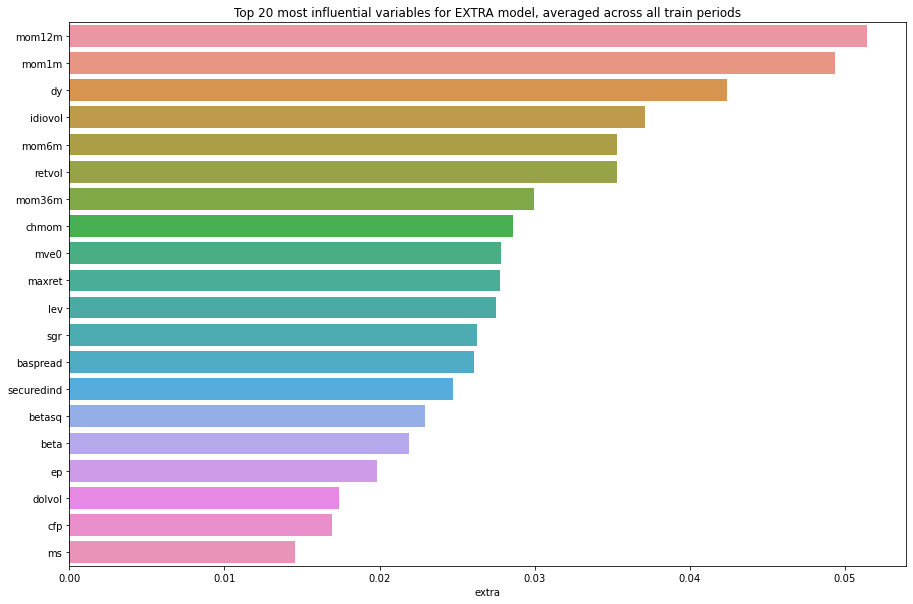

In [271]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [272]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,ridge,lasso,enet,pcr,extra
absacc,0.000334,0.000622,0.000000,0.000000,-0.002456,0.005258
acc,0.001302,0.002116,0.000000,0.000000,-0.007864,0.004883
aeavol,0.000984,0.007019,0.002913,0.003030,0.007646,0.004639
age,0.000160,0.001337,0.000027,0.000045,-0.013675,0.012613
agr,0.000195,0.003044,0.000000,0.000009,0.003117,0.009834
baspread,0.008438,0.002834,0.000000,0.000000,-0.001840,0.026122
beta,0.012467,0.002929,0.000000,0.000000,0.001281,0.021894
betasq,0.010939,0.001710,0.000000,0.000000,-0.003600,0.022942
bm,0.000831,0.017660,0.019649,0.020096,0.025056,0.011733
bm_ia,0.002021,0.006742,0.005609,0.005660,0.016169,0.007191


,lr,ridge,lasso,enet,pcr,extra,all_models
mom1m,84.0,93.0,91.0,92.0,94.0,93.0,547.0
chmom,88.0,92.0,93.0,93.0,93.0,87.0,546.0
mom6m,89.0,89.0,92.0,91.0,89.0,90.0,540.0
mve0,94.0,94.0,94.0,94.0,77.0,86.0,539.0
dy,83.0,91.0,90.0,90.0,91.0,92.0,537.0
retvol,93.0,90.0,87.0,87.0,87.0,89.0,533.0
mom12m,77.0,87.0,83.0,83.0,92.0,94.0,516.0
sgr,79.0,88.0,88.0,88.0,90.0,83.0,516.0
mom36m,72.0,85.0,84.0,84.0,74.0,88.0,487.0
cfp_ia,74.0,80.0,86.0,86.0,82.0,73.0,481.0


## AdaBoost

### REIT

In [283]:
df_results = df_results[:12]

In [284]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    n_trees = [100, 200, 300]
    n_max_features = [None, 'sqrt', 0.2] # last value means 20% of features are considered at each split
    n_max_depth = [1, 2, 3]
    n_learning_rate = [.1, .05, .01, .005]
    # create configs
    configs = []
    for i in n_trees:
        for j in n_max_features:
            for k in n_max_depth:
                for l in n_learning_rate:
                    cfg = [i,j,k,l]
                    configs.append(cfg)
    print('Total configs (n_trees, n_max_features, n_max_depth, n_learning_rate): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_trees, n_max_features, n_max_depth, n_learning_rate = cfg
    model = AdaBoostRegressor(
        base_estimator = DecisionTreeRegressor(
            max_features = n_max_features,
            max_depth = n_max_depth,
            random_state = 42,
        ),
        n_estimators = n_trees,
        learning_rate = n_learning_rate,
        random_state = 42
    )
    model.fit(X_train, y_train)
    return model




In [285]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_trees, n_max_features, n_max_depth, n_learning_rate): 108


In [286]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'ada'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[100, None, 1, 0.1], 1.28, 10.2, -3.33, 10.6
[100, None, 1, 0.05], 2.33, 10.1, -0.72, 10.5
[100, None, 1, 0.01], 1.67, 10.2, 0.40, 10.4
[100, None, 1, 0.005], 1.47, 10.2, 0.34, 10.4
[100, None, 2, 0.1], 1.11, 10.2, 4.13, 10.2
[100, None, 2, 0.05], 1.82, 10.2, 3.90, 10.2
[100, None, 2, 0.01], 1.62, 10.2, 0.73, 10.4
[100, None, 2, 0.005], 1.39, 10.2, 1.26, 10.4
[100, None, 3, 0.1], 1.51, 10.2, 7.63, 10.0
[100, None, 3, 0.05], 1.57, 10.2, 6.12, 10.1
[100, None, 3, 0.01], 1.53, 10.2, 1.55, 10.4
[100, None, 3, 0.005], 1.02, 10.2, 1.51, 10.4
[100, 'sqrt', 1, 0.1], -0.29, 10.3, -5.69, 10.7
[100, 'sqrt', 1, 0.05], 2.15, 10.1, -1.40, 10.5
[100, 'sqrt', 1, 0.01], 1.65, 10.2, 0.40, 10.4
[100, 'sqrt', 1, 0.005], 1.44, 10.2, 0.35, 10.4
[100, 'sqrt', 2, 0.1], 1.94, 10.2, 3.75, 10.2
[100, 'sqrt', 2, 0.05], 2.10, 10.1, 2.62, 10.3
[100, 'sqrt', 2, 0.01], 1.60, 10.2, 0.73, 10.4
[100, 'sqrt', 2, 0.005], 1.41, 10.2, 0.70, 10.4
[100, 'sqrt', 3, 0.1], 1.81, 10.2, 6.69, 10.1
[100, 'sqrt', 3, 0.05], 1.66, 10.

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[300, None, 1, 0.01], 2.44, 10.1, -0.12, 10.5
[300, 'sqrt', 1, 0.01], 2.34, 10.1, 0.35, 10.4
[100, None, 1, 0.05], 2.33, 10.1, -0.72, 10.5
[300, 0.2, 1, 0.01], 2.31, 10.1, 0.52, 10.4
[100, 0.2, 1, 0.05], 2.30, 10.1, -0.60, 10.5
[100, 'sqrt', 1, 0.05], 2.15, 10.1, -1.40, 10.5
[100, 0.2, 2, 0.05], 2.13, 10.1, 2.87, 10.3
[100, 0.2, 2, 0.1], 2.12, 10.1, 3.63, 10.3
CPU times: user 40min 8s, sys: 1min 28s, total: 41min 37s
Wall time: 41min 39s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[300, None, 1, 0.01], 2.44, 10.1, -0.12, 10.5

[300, 'sqrt', 1, 0.01], 2.34, 10.1, 0.35, 10.4

[100, None, 1, 0.05], 2.33, 10.1, -0.72, 10.5

[300, 0.2, 1, 0.01], 2.31, 10.1, 0.52, 10.4

[100, 0.2, 1, 0.05], 2.30, 10.1, -0.60, 10.5

[100, 'sqrt', 1, 0.05], 2.15, 10.1, -1.40, 10.5

[100, 0.2, 2, 0.05], 2.13, 10.1, 2.87, 10.3

[100, 0.2, 2, 0.1], 2.12, 10.1, 3.63, 10.3

CPU times: user 40min 8s, sys: 1min 28s, total: 41min 37s

Wall time: 41min 39s

In [287]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 5.13
Test year 2006 done, RMSE score is 7.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2007 done, R2 score is -9.73
Test year 2007 done, RMSE score is 11.8


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2008 done, R2 score is -4.05
Test year 2008 done, RMSE score is 20.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2009 done, R2 score is 1.36
Test year 2009 done, RMSE score is 25.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2010 done, R2 score is 3.98
Test year 2010 done, RMSE score is 12.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2011 done, R2 score is -4.24
Test year 2011 done, RMSE score is 10.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2012 done, R2 score is 6.72
Test year 2012 done, RMSE score is 9.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2013 done, R2 score is -0.91
Test year 2013 done, RMSE score is 9.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2014 done, R2 score is 3.67
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2015 done, R2 score is -7.36
Test year 2015 done, RMSE score is 7.7


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2016 done, R2 score is 2.59
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2017 done, R2 score is -1.00
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2018 done, R2 score is -10.44
Test year 2018 done, RMSE score is 8.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2019 done, R2 score is 5.49
Test year 2019 done, RMSE score is 8.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2020 done, R2 score is -0.84
Test year 2020 done, RMSE score is 18.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -0.73.
RMSE for entire pooled test set, from 2006 to 2020, is 12.2.

On best performing config: [300, None, 1, 0.01]
CPU times: user 25min 52s, sys: 16.8 s, total: 26min 9s
Wall time: 26min 16s


R2 for entire pooled test set, from 2006 to 2020, is -0.73.

RMSE for entire pooled test set, from 2006 to 2020, is 12.2.

On best performing config: [300, None, 1, 0.01]

CPU times: user 25min 52s, sys: 16.8 s, total: 26min 9s

Wall time: 26min 16s

## XGBoost

### REIT

In [304]:
df_results = df_results[:13]

In [309]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    n_trees = [100, 200, 300, 400, 500]
    n_max_depth = [1]
    n_learning_rate = [0.100, 0.050, 0.010, 0.008, 0.005, 0.003, 0.001]
    # create configs
    configs = []
    for i in n_trees:
        for j in n_max_depth:
            for k in n_learning_rate:
                cfg = [i,j,k]
                configs.append(cfg)
    print('Total configs (n_trees, n_max_depth, n_learning_rate): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_trees, n_max_depth, n_learning_rate = cfg
    model = XGBRegressor(
        n_estimators = n_trees,
        max_depth = n_max_depth,
        learning_rate = n_learning_rate,
        random_state = 42,
        n_jobs = -1
    )
    model.fit(X_train, y_train)
    return model

In [310]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_trees, n_max_depth, n_learning_rate): 35


In [311]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'xg'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

[100, 1, 0.1], 1.21, 10.2, 3.56, 10.3
[100, 1, 0.05], 1.50, 10.2, 2.42, 10.3
[100, 1, 0.01], 1.78, 10.2, 1.00, 10.4
[100, 1, 0.008], 1.75, 10.2, 0.88, 10.4
[100, 1, 0.005], 1.64, 10.2, 0.69, 10.4
[100, 1, 0.003], 1.53, 10.2, 0.55, 10.4
[100, 1, 0.001], 1.29, 10.2, 0.38, 10.4
[200, 1, 0.1], 1.45, 10.2, 5.17, 10.2
[200, 1, 0.05], 1.40, 10.2, 3.52, 10.3
[200, 1, 0.01], 1.62, 10.2, 1.46, 10.4
[200, 1, 0.008], 1.67, 10.2, 1.29, 10.4
[200, 1, 0.005], 1.77, 10.2, 0.99, 10.4
[200, 1, 0.003], 1.67, 10.2, 0.76, 10.4
[200, 1, 0.001], 1.43, 10.2, 0.47, 10.4
[300, 1, 0.1], 1.18, 10.2, 6.37, 10.1
[300, 1, 0.05], 1.15, 10.2, 4.39, 10.2
[300, 1, 0.01], 1.54, 10.2, 1.82, 10.4
[300, 1, 0.008], 1.56, 10.2, 1.62, 10.4
[300, 1, 0.005], 1.69, 10.2, 1.25, 10.4
[300, 1, 0.003], 1.78, 10.2, 0.94, 10.4
[300, 1, 0.001], 1.52, 10.2, 0.55, 10.4
[400, 1, 0.1], 1.49, 10.2, 7.35, 10.1
[400, 1, 0.05], 1.15, 10.2, 5.11, 10.2
[400, 1, 0.01], 1.49, 10.2, 2.13, 10.3
[400, 1, 0.008], 1.52, 10.2, 1.89, 10.3
[400, 1, 0.005],

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[100, 1, 0.01], 1.78, 10.2, 1.00, 10.4
[300, 1, 0.003], 1.78, 10.2, 0.94, 10.4
[200, 1, 0.005], 1.77, 10.2, 0.99, 10.4
[100, 1, 0.008], 1.75, 10.2, 0.88, 10.4
[400, 1, 0.003], 1.75, 10.2, 1.10, 10.4
[300, 1, 0.005], 1.69, 10.2, 1.25, 10.4
[500, 1, 0.003], 1.69, 10.2, 1.25, 10.4
[200, 1, 0.003], 1.67, 10.2, 0.76, 10.4
CPU times: user 7min 43s, sys: 4.97 s, total: 7min 48s
Wall time: 1min 29s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[100, 1, 0.01], 1.78, 10.2, 1.00, 10.4

[300, 1, 0.003], 1.78, 10.2, 0.94, 10.4

[200, 1, 0.005], 1.77, 10.2, 0.99, 10.4

[100, 1, 0.008], 1.75, 10.2, 0.88, 10.4

[400, 1, 0.003], 1.75, 10.2, 1.10, 10.4

[300, 1, 0.005], 1.69, 10.2, 1.25, 10.4

[500, 1, 0.003], 1.69, 10.2, 1.25, 10.4

[200, 1, 0.003], 1.67, 10.2, 0.76, 10.4

CPU times: user 7min 43s, sys: 4.97 s, total: 7min 48s

Wall time: 1min 29s

In [313]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Test year 2006 done, R2 score is 3.56
Test year 2006 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2007 done, R2 score is -5.21
Test year 2007 done, RMSE score is 11.6


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2008 done, R2 score is -0.73
Test year 2008 done, RMSE score is 19.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2009 done, R2 score is -0.39
Test year 2009 done, RMSE score is 25.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2010 done, R2 score is 1.00
Test year 2010 done, RMSE score is 12.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2011 done, R2 score is -0.66
Test year 2011 done, RMSE score is 10.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2012 done, R2 score is 2.77
Test year 2012 done, RMSE score is 9.3


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2013 done, R2 score is 0.96
Test year 2013 done, RMSE score is 9.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2014 done, R2 score is 2.62
Test year 2014 done, RMSE score is 6.9


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2015 done, R2 score is -1.37
Test year 2015 done, RMSE score is 7.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2016 done, R2 score is 1.43
Test year 2016 done, RMSE score is 9.0


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2017 done, R2 score is 0.89
Test year 2017 done, RMSE score is 7.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2018 done, R2 score is -1.98
Test year 2018 done, RMSE score is 8.1


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2019 done, R2 score is 2.82
Test year 2019 done, RMSE score is 8.2


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Test year 2020 done, R2 score is -0.14
Test year 2020 done, RMSE score is 18.4


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -0.09.
RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [100, 1, 0.01]
CPU times: user 7min 25s, sys: 4.68 s, total: 7min 30s
Wall time: 1min 28s


R2 for entire pooled test set, from 2006 to 2020, is -0.11.

RMSE for entire pooled test set, from 2006 to 2020, is 12.1.

On best performing config: [100, 1, 0.01]

CPU times: user 2min 34s, sys: 2.11 s, total: 2min 37s

Wall time: 33.4 s


## NN1
For neural networks, given the same model configuration and the same training dataset, a different internal set of weights will result each time the model is trained that will, in turn, have a different performance.
I adopt an ensemble approach to train our model, where I use multiple random seeds to initialise neural network estimtion and construct predictions by averaging forecasts from all networks. This reduces prediction variance.

--> Create custom function to repeat evaluations


### REIT

In [366]:
df_results = df_results[:14]

In [399]:
# Create list of configs to test on 
def model_configs():
    # define scope of configs
    n_penalty_type = [l1, l2]
    n_penalty_amount = np.logspace(-5, -3, 5)
    n_learning_rate = [0.001, 0.01]
    # create configs
    configs = []
    for i in n_penalty_type:
        for j in n_penalty_amount:
            for k in n_learning_rate:
                cfg = [i,j,k]
                configs.append(cfg)
    print('Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_penalty_type, n_penalty_amount, n_learning_rate = cfg
    
    # Instantiate a Sequential model
    model = Sequential()
    
    # Add an input layer
    model.add(Dense(32, activation = 'relu', 
                    input_dim = X_train.shape[1], 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an output layer
    model.add(Dense(1, activation = None, 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Set learning rate
    opt = Adam(learning_rate = n_learning_rate)
    
    # Compile model
    model.compile(loss = 'mse',optimizer = opt)

    # Early stop
    early_stop = EarlyStopping(
        monitor = 'loss',
        min_delta = 0,
        patience = 5
    )    
    
    # Convert to np.array before calling model.fit()
    #  to avoid error message "tensorflow:Falling back from v2 loop because 
    #  of error: Failed to find data adapter that can handle input
    X_train = np.asarray(X_train)
    y_train = np.asarray(y_train)    
    
    # Fit model
    model.fit(X_train, y_train,
#               validation_data = (X_validate, y_validate),
              epochs = 1000,
              batch_size = 2 ** 13,
              callbacks = [early_stop]
             )
    return model

def model_predict(model, X_validate):
    # Convert to np.array before calling model.fit()
    #  to avoid error message "tensorflow:Falling back from v2 loop because 
    #  of error: Failed to find data adapter that can handle input
    X_validate = np.asarray(X_validate)    
    
    # make predictions
    y_pred = model.predict(X_validate)
    return y_pred

def evaluate(X_train, X_validate, y_train, y_validate, cfg):
    # fit and evaluate model
    model = model_fit(X_train, y_train, cfg)
    
    # scores from validate set
    y_pred_validate = model_predict(model, X_validate)
    # Flatten multiple arrays into one (for Neural Network)
    y_pred_validate = [item for sublist in y_pred_validate for item in sublist]
    r2_validate = measure_r2(y_validate, y_pred_validate)
    rmse_validate = measure_rmse(y_validate, y_pred_validate)

    # scores from train set
    y_pred_train = model_predict(model, X_train)
    # Flatten multiple arrays into one (for Neural Network)
    y_pred_train = [item for sublist in y_pred_train for item in sublist]
    r2_train = measure_r2(y_train, y_pred_train)
    rmse_train = measure_rmse(y_train, y_pred_train)
    print(cfg, r2_validate, rmse_validate, r2_train, rmse_train)
    return [r2_validate, rmse_validate, r2_train, rmse_train]


# Create repetitions of evaluations as an ensemble approach
def repeat_evaluate(X_train, X_validate, y_train, y_validate, cfg, n_repeats = 5):
    # convert config to a key for storing results later
    key = cfg
    # fit and evaluate n times
    scores = [evaluate(X_train, X_validate, y_train, y_validate, cfg) for _ in range(n_repeats)]
    # average the scores
    avg_result = np.average(scores, axis = 0)
    print()
    print(f'Ensemble results from Model {key}: {avg_result}')
    return (key, avg_result[0], avg_result[1], avg_result[2], avg_result[3])
    
    
# Grid search list of configs
def grid_search(X_train, X_validate, y_train, y_validate, cfg_list):
    # evaluate configs
    scores = [repeat_evaluate(X_train, X_validate, y_train, y_validate, cfg) for cfg in cfg_list]
    # sort configs by score
    scores.sort(key = lambda tup: tup[1], reverse = True)
    # store results
    df_results.loc[df_results['Model Name'] == model_name, 'Selected Config'] = \
        f'{scores[0][0]}'
    df_results.loc[df_results['Model Name'] == model_name, 'Train (1990-2000)'] = \
        f'{scores[0][3]:.2f} ({scores[0][4]:.1f})'
    df_results.loc[df_results['Model Name'] == model_name, 'Validate (2001-2005)'] = \
        f'{scores[0][1]:.2f} ({scores[0][2]:.1f})'
    display(df_results)
    return scores

# For some reason, NN does not return an array of predictions,
#   but an array of arrays. So flattening of y_pred is necessary
# Walk-forward testing, refit frequency is defined in number of years
def walk_forward(selected_cfg, X, y, start_year = 1990, end_year = 2020, years_to_test = 15, refit_frequency = 1):
    predictions = []
    counter = 1
    for i in range(years_to_test):
        # Create train-test sets
        X_train, X_test, y_train, y_test = train_validate_split(
            X, y, start_year, end_year - years_to_test + counter, refit_frequency
        )
        # Fit model
        model = model_fit(X_train, y_train, selected_cfg)
        # Save Keras model
        folder = f'../pickle/{model_name}_{end_year - years_to_test + counter}'
        model.save(folder)
        # Predicted values
        y_pred = model_predict(model, X_test)
        # Flatten multiple arrays into one (for Neural Network)
        y_pred = [item for sublist in y_pred for item in sublist]
        predictions.append(y_pred)
        print(f'Test year {end_year - years_to_test + counter} done, R2 score is {measure_r2(y_test, y_pred):.2f}')
        print(f'Test year {end_year - years_to_test + counter} done, RMSE score is {measure_rmse(y_test, y_pred):.1f}')
        # Store results
        df_results.loc[df_results['Model Name'] == model_name, f'Test ({end_year - years_to_test + counter})'] = \
            f'{measure_r2(y_test, y_pred):.2f} ({measure_rmse(y_test, y_pred):.1f})'
        display(df_results)
        # Set counter
        counter += 1
        
    y_true = y[f'{end_year - years_to_test + 1}' : f'{end_year}']
    # Flatten multiple years of arrays into one 
    predictions = [item for sublist in predictions for item in sublist]
    r2_oos = measure_r2(y_true, predictions)
    rmse_oos = measure_rmse(y_true, predictions)
    df_results.loc[df_results['Model Name'] == model_name, f'Test (2006-2020)'] = \
            f'{r2_oos:.2f} ({rmse_oos:.1f})'
    display(df_results)
    print()
    print(f'R2 for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {r2_oos:.2f}.')
    print(f'RMSE for entire pooled test set, from {end_year - years_to_test + 1} to {end_year}, is {rmse_oos:.1f}.')
    print()
    return r2_oos, rmse_oos

def create_r2decrease(model_name, 
                      X = X_reit, y = y_reit,
                      start_year = 1990, end_year = 2020, 
                      years_to_test = 15,
                      refit_frequency = 1):
    
    # Inititate empty dataframe to store results
    df_temp = pd.DataFrame(index = X.columns)

    counter = 1
    for i in range(years_to_test):
        # Create train-test sets
        X_train, _, y_train, _ = train_validate_split(
            X, y, start_year, end_year - years_to_test + counter, refit_frequency
        )    
        
        # Load Keras model
        folder = f'../pickle/{model_name}_{end_year - years_to_test + counter}'
        model = load_model(folder)
        
        # Calculate R2 with all features present
        y_pred_train = model_predict(model, X_train)
        # Flatten multiple arrays into one (for Neural Network)
        y_pred_train = [item for sublist in y_pred_train for item in sublist]
        r2_full = measure_r2(y_train, y_pred_train)
        
        # Calculate R2 by setting individual features to zero
        col =[]
        for feature in X.columns:
            X_train_minus = X_train.copy()
            X_train_minus[feature] = 0
            y_pred_train_minus = model_predict(model, X_train_minus)
            # Flatten multiple arrays into one (for Neural Network)
            y_pred_train_minus = [item for sublist in y_pred_train_minus for item in sublist]
            r2_minus = measure_r2(y_train, y_pred_train_minus)
            r2decrease = r2_full - r2_minus
            col.append(r2decrease)
        df_temp[end_year - years_to_test + counter] = col
        print(f'{end_year - years_to_test + counter} done')
        # Set counter
        counter += 1
        
    # Sum across all years, then normalize to sum of 1
    df_temp[model_name] = df_temp.sum(axis=1)
    df_temp[model_name] = df_temp[model_name] / df_temp[model_name].sum()
    
    return df_temp


In [400]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): 20


In [401]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'nn1'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 43us/sample - loss: 110.6075
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 110.2107
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.8609
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.5599
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.2888
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.0472
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.8264
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.6266
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.4586
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.2982
Epoch 11/1000
21360/21360 [==============================] - 0s 2

21360/21360 [==============================] - 0s 2us/sample - loss: 90.6828
Epoch 179/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.5244
Epoch 180/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.4442
Epoch 181/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.3155
Epoch 182/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.3152
Epoch 183/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.1329
Epoch 184/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0380
Epoch 185/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.9341
Epoch 186/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.9047
Epoch 187/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.7850
Epoch 188/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6580
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.8712
Epoch 357/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9584
Epoch 358/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8880
Epoch 359/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7979
Epoch 360/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7845
Epoch 361/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6958
Epoch 362/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8091
Epoch 363/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7080
Epoch 364/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7036
Epoch 365/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6100
Epoch 366/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6002
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 106.9610
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.8458
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7570
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.6534
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.5495
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4548
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3610
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.2798
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.1898
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.1098
Epoch 30/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0084
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 90.1895
Epoch 199/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0988
Epoch 200/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0548
Epoch 201/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.9513
Epoch 202/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.8782
Epoch 203/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.8138
Epoch 204/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6761
Epoch 205/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6730
Epoch 206/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.5627
Epoch 207/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.4594
Epoch 208/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.4237
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 79.7805
Epoch 377/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6712
Epoch 378/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6943
Epoch 379/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6027
Epoch 380/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.5785
Epoch 381/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6231
Epoch 382/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.4828
Epoch 383/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.5578
Epoch 384/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3366
Epoch 385/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.4131
Epoch 386/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3430
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 106.0091
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.9300
Epoch 37/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.8460
Epoch 38/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.7637
Epoch 39/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.6826
Epoch 40/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.5986
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.5164
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.4387
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.3500
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2681
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.1742
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 88.1515
Epoch 214/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.1217
Epoch 215/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.0272
Epoch 216/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.9620
Epoch 217/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.8606
Epoch 218/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.7905
Epoch 219/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.6538
Epoch 220/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.5808
Epoch 221/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.5255
Epoch 222/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.3596
Epoch 223/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.2846
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 77.4778
Epoch 392/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.4268
Epoch 393/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.4269
Epoch 394/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4797
Epoch 395/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3346
Epoch 396/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.2665
Epoch 397/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3033
Epoch 398/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.2451
Epoch 399/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1996
Epoch 400/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1910
Epoch 401/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.0760
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 94.3750
Epoch 144/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2450
Epoch 145/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.1244
Epoch 146/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.9827
Epoch 147/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.9166
Epoch 148/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.8023
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6845
Epoch 150/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.5588
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.4849
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.3369
Epoch 153/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.2394
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 79.4809
Epoch 322/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.4522
Epoch 323/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3500
Epoch 324/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3762
Epoch 325/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2678
Epoch 326/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3176
Epoch 327/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2117
Epoch 328/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2152
Epoch 329/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0612
Epoch 330/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.1333
Epoch 331/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0396
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 102.7321
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.6496
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5220
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.4178
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3181
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.1995
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.0824
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.9686
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.8545
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.7477
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6443
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 85.4068
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.3714
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.2540
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.1843
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.1152
Epoch 246/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0212
Epoch 247/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0740
Epoch 248/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.9590
Epoch 249/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.8508
Epoch 250/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.7147
Epoch 251/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.7293
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 77.6399
Epoch 420/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7426
Epoch 421/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4838
Epoch 422/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.5974
Epoch 423/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.5446
Epoch 424/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4587
Epoch 425/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4357
Epoch 426/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3458
Epoch 427/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.5040
Epoch 428/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3537
Epoch 429/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3578
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 105.1728
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.6610
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.1234
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.5771
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.9764
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3763
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6546
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.9289
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.2632
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.5008
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.8115
Epoch 

21360/21360 [==============================] - 0s 2us/sample - loss: 73.6820
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0169
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.8211
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6839
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.6598
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.2494
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.2166
Epoch 104/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.9900
Epoch 105/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.2000
Epoch 106/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.0991
Epoch 107/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.9917
Epoch

21360/21360 [==============================] - 0s 2us/sample - loss: 87.9587
Epoch 40/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.3379
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.8620
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1994
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9484
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.4873
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0662
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5665
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5828
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.4392
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5398
Epoch 50/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 80.5771
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.6594
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.0292
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.0083
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6579
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3048
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.1615
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.1575
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6523
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4429
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.5084
Epoch 72/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 95.6135
Epoch 127/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.4914
Epoch 128/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.3890
Epoch 129/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.2691
Epoch 130/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.1398
Epoch 131/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.0406
Epoch 132/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.9208
Epoch 133/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.8285
Epoch 134/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.7459
Epoch 135/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.6142
Epoch 136/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.5449
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 81.5816
Epoch 305/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.5587
Epoch 306/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4999
Epoch 307/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4568
Epoch 308/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.3458
Epoch 309/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4097
Epoch 310/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.3250
Epoch 311/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.3112
Epoch 312/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2331
Epoch 313/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1452
Epoch 314/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2671
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 105.4967
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.4201
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.3376
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.2438
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.1740
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.0943
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.9938
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9325
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8564
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.7545
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.6632
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 88.3130
Epoch 222/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.2352
Epoch 223/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.1800
Epoch 224/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.1104
Epoch 225/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.0257
Epoch 226/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.9166
Epoch 227/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.9025
Epoch 228/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.7759
Epoch 229/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.7211
Epoch 230/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.7021
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.5361
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.8216
Epoch 400/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8919
Epoch 401/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8145
Epoch 402/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8263
Epoch 403/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6842
Epoch 404/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6890
Epoch 405/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6157
Epoch 406/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.5689
Epoch 407/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6157
Epoch 408/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.5457
Epoch 409/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4766
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 73.7418
Epoch 578/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.7785
Epoch 579/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.7583
Epoch 580/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6514
Epoch 581/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6736
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.001] -56.1922330556365 12.819749311403662 32.655364726102974 8.572538290842614
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 45us/sample - loss: 111.0076
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 110.5991
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 110.2500
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.9255
Epoch 5/1000
21360/21360 [==

21360/21360 [==============================] - 0s 2us/sample - loss: 91.4044
Epoch 173/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.2991
Epoch 174/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.1685
Epoch 175/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.0922
Epoch 176/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.9474
Epoch 177/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.9187
Epoch 178/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.7992
Epoch 179/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.6919
Epoch 180/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.7276
Epoch 181/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.5377
Epoch 182/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.4081
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 79.2672
Epoch 351/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.0117
Epoch 352/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0973
Epoch 353/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0144
Epoch 354/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0689
Epoch 355/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9596
Epoch 356/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9469
Epoch 357/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8517
Epoch 358/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8408
Epoch 359/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7230
Epoch 360/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8124
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 103.2051
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.1017
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.9887
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.8845
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7689
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.6671
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5552
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.4412
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3418
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2551
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.1324
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 85.6242
Epoch 241/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.5149
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.4367
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.3543
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.3224
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.2135
Epoch 246/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.2292
Epoch 247/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0823
Epoch 248/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.9751
Epoch 249/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.9062
Epoch 250/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.8513
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.2541
Epoch 419/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2092
Epoch 420/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2634
Epoch 421/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1832
Epoch 422/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0432
Epoch 423/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1244
Epoch 424/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0707
Epoch 425/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0879
Epoch 426/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0204
Epoch 427/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9830
Epoch 428/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9511
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 106.7242
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.6371
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.5708
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4830
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4019
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3147
Epoch 30/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.2380
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.1763
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0882
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0221
Epoch 34/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.9377
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 87.5478
Epoch 203/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.4834
Epoch 204/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.4149
Epoch 205/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.3032
Epoch 206/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.2839
Epoch 207/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.1612
Epoch 208/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.1209
Epoch 209/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.9337
Epoch 210/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.8812
Epoch 211/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.8613
Epoch 212/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7146
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.9437
Epoch 381/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.8817
Epoch 382/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.9054
Epoch 383/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7558
Epoch 384/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7418
Epoch 385/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6683
Epoch 386/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6644
Epoch 387/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5642
Epoch 388/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5228
Epoch 389/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6575
Epoch 390/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5671
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 71.5121
Epoch 559/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.5849
Epoch 560/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.5052
Epoch 561/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.5885
Epoch 562/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4720
Epoch 563/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.5071
Epoch 564/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4783
Epoch 565/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.5708
Epoch 566/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4579
Epoch 567/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.3432
Epoch 568/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.3381
Epo

Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.1744
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.7822
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.1909
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6374
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.0510
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.3878
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.6670
Epoch 30/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.1926
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.8472
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0460
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.5657

21360/21360 [==============================] - 0s 2us/sample - loss: 107.2831
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.6893
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.2705
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.7947
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.3734
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.8772
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.3572
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.8395
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.2820
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.6317
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.0163
Epoch 14

21360/21360 [==============================] - 0s 2us/sample - loss: 75.4818
Epoch 94/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3405
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4069
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5865
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2037
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4446
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.6605
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1732
Epoch 101/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.6870
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2087
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2832
Epoch 104

21360/21360 [==============================] - 0s 2us/sample - loss: 79.0791
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.5398
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6225
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6201
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4118
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.3000
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7854
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7704
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.5644
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3176
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3970
Epoch 77/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 108.4876
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.3324
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.1765
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.0377
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.9058
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.7708
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.6558
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.5451
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.4340
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3255
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2276
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 90.3904
Epoch 188/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.2255
Epoch 189/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.1878
Epoch 190/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.1978
Epoch 191/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0365
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.9020
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.8044
Epoch 194/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.7578
Epoch 195/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6973
Epoch 196/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6208
Epoch 197/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.5299
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 80.0248
Epoch 366/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9797
Epoch 367/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9138
Epoch 368/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8995
Epoch 369/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8470
Epoch 370/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7801
Epoch 371/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8208
Epoch 372/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7192
Epoch 373/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7238
Epoch 374/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6300
Epoch 375/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.6975
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.6427
Epoch 544/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.6961
Epoch 545/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.6340
Epoch 546/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5355
Epoch 547/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.6396
Epoch 548/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5229
Epoch 549/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5638
Epoch 550/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.4305
Epoch 551/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5688
Epoch 552/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3345
Epoch 553/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3391
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 97.9471
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.8375
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.7467
Epoch 118/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.6299
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5208
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.4432
Epoch 121/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3025
Epoch 122/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.1898
Epoch 123/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.0731
Epoch 124/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.9969
Epoch 125/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.8690
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 82.1391
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.1526
Epoch 295/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.0914
Epoch 296/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.0839
Epoch 297/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.0242
Epoch 298/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.9770
Epoch 299/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.8784
Epoch 300/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7986
Epoch 301/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7424
Epoch 302/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7486
Epoch 303/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.6045
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.5987
Epoch 472/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4796
Epoch 473/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5091
Epoch 474/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4337
Epoch 475/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3878
Epoch 476/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5017
Epoch 477/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4001
Epoch 478/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2994
Epoch 479/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3491
Epoch 480/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2307
Epoch 481/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2568
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 97.9736
Epoch 108/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.8333
Epoch 109/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.7157
Epoch 110/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5998
Epoch 111/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5067
Epoch 112/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3473
Epoch 113/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.2501
Epoch 114/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.1036
Epoch 115/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.9759
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.9018
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.7650
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 82.5920
Epoch 286/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4576
Epoch 287/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.5765
Epoch 288/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4598
Epoch 289/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.3239
Epoch 290/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.3061
Epoch 291/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.1593
Epoch 292/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.1342
Epoch 293/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.0518
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.0247
Epoch 295/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.9674
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.2819
Epoch 464/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3997
Epoch 465/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3299
Epoch 466/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2171
Epoch 467/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2344
Epoch 468/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1814
Epoch 469/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2654
Epoch 470/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1660
Epoch 471/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2017
Epoch 472/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1247
Epoch 473/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1422
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 98.0128
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.8949
Epoch 121/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.7844
Epoch 122/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.6830
Epoch 123/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5859
Epoch 124/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.4522
Epoch 125/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3659
Epoch 126/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.2501
Epoch 127/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.1734
Epoch 128/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.0073
Epoch 129/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.9558
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 83.2323
Epoch 298/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.1710
Epoch 299/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.1292
Epoch 300/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.1487
Epoch 301/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.0238
Epoch 302/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.9378
Epoch 303/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.9981
Epoch 304/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.8124
Epoch 305/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.7830
Epoch 306/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.7250
Epoch 307/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.7094
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 104.8231
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.7246
Epoch 54/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.6408
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.5534
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.4582
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.3690
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.2880
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.2061
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.1132
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.0493
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.9354
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 87.4657
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.3201
Epoch 232/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.2194
Epoch 233/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.1667
Epoch 234/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.0934
Epoch 235/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.0231
Epoch 236/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.0065
Epoch 237/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.8440
Epoch 238/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.9121
Epoch 239/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7316
Epoch 240/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7377
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.3628
Epoch 409/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.5774
Epoch 410/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.2584
Epoch 411/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.2420
Epoch 412/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.2531
Epoch 413/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.3491
Epoch 414/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.2023
Epoch 415/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.1352
Epoch 416/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.1198
Epoch 417/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.0407
Epoch 418/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9599
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 105.1380
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.6535
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.1720
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.6059
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.0189
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.4016
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6832
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.0810
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.3034
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.6083
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.8751
Epoch

21360/21360 [==============================] - 0s 2us/sample - loss: 74.1503
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1241
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.8836
Epoch 101/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.8286
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.5795
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6114
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6555
Epoch 105/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2537
Epoch 106/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2900
Epoch 107/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.8474
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01] -55.42260090217428 12.78812585831265 32.69776008

21360/21360 [==============================] - 0s 2us/sample - loss: 81.8708
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.8792
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.5722
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2407
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0287
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.8478
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.6403
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4187
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.6233
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2289
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8661
Epoch 66/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 108.3388
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.1976
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.0580
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.9259
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.8057
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.6878
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.5752
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.4766
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3736
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2878
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.1832
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 89.7070
Epoch 189/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6502
Epoch 190/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.5735
Epoch 191/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.4121
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.3618
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.2868
Epoch 194/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.2051
Epoch 195/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.1329
Epoch 196/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.9824
Epoch 197/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.9046
Epoch 198/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.8241
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 79.1392
Epoch 367/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0928
Epoch 368/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9645
Epoch 369/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9389
Epoch 370/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9801
Epoch 371/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8707
Epoch 372/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8388
Epoch 373/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8219
Epoch 374/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8450
Epoch 375/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8083
Epoch 376/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7830
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 102.1880
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.0923
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.9885
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.8646
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.7869
Epoch 82/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6627
Epoch 83/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.5511
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.4382
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.3306
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.2250
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.1134
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 85.6340
Epoch 256/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.5088
Epoch 257/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.4266
Epoch 258/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.2898
Epoch 259/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.2710
Epoch 260/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.2028
Epoch 261/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.1150
Epoch 262/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0870
Epoch 263/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0619
Epoch 264/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.9089
Epoch 265/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.8226
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.7017
Epoch 434/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7536
Epoch 435/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7273
Epoch 436/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6622
Epoch 437/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4409
Epoch 438/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6387
Epoch 439/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4953
Epoch 440/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6654
Epoch 441/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4358
Epoch 442/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4585
Epoch 443/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3222
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 94.8417
Epoch 143/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.7273
Epoch 144/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.6325
Epoch 145/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.5057
Epoch 146/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.4084
Epoch 147/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.3042
Epoch 148/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2295
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.0582
Epoch 150/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.0314
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.9164
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.7795
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 80.6903
Epoch 321/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6668
Epoch 322/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5959
Epoch 323/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.6257
Epoch 324/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5562
Epoch 325/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5808
Epoch 326/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4293
Epoch 327/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3075
Epoch 328/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2365
Epoch 329/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3171
Epoch 330/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2208
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.7089
Epoch 499/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.7148
Epoch 500/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.7146
Epoch 501/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.6857
Epoch 502/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.4759
Epoch 503/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5950
Epoch 504/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.6136
Epoch 505/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.6320
Epoch 506/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5197
Epoch 507/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.4733
Epoch 508/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.4226
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 96.2630
Epoch 133/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.1792
Epoch 134/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.0548
Epoch 135/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.9545
Epoch 136/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.8187
Epoch 137/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.7160
Epoch 138/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.6314
Epoch 139/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.5475
Epoch 140/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.4165
Epoch 141/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.3384
Epoch 142/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.2097
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 82.9546
Epoch 311/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.9561
Epoch 312/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.8315
Epoch 313/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.8273
Epoch 314/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.8139
Epoch 315/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.7197
Epoch 316/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.7053
Epoch 317/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.7720
Epoch 318/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6230
Epoch 319/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.5894
Epoch 320/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4663
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 105.1546
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.0617
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.9826
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.9076
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.8266
Epoch 54/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.7361
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.6394
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.5600
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.4797
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.3741
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.2887
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 86.8890
Epoch 228/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.8910
Epoch 229/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7826
Epoch 230/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7030
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.6135
Epoch 232/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.5234
Epoch 233/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.4683
Epoch 234/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.3535
Epoch 235/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.2449
Epoch 236/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1355
Epoch 237/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1069
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.5599
Epoch 406/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.4755
Epoch 407/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.3415
Epoch 408/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.3476
Epoch 409/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.2587
Epoch 410/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1960
Epoch 411/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1875
Epoch 412/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.1910
Epoch 413/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2406
Epoch 414/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0822
Epoch 415/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.9266
Epo

Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.5334
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.8163
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.1754
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.5371
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.9972
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.4574
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.1371
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.3525
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.8883
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.4024
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.9560

21360/21360 [==============================] - 0s 2us/sample - loss: 71.6923
Epoch 124/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4423
Epoch 125/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4091
Epoch 126/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4841
Epoch 127/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.0835
Epoch 128/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.7905
Epoch 129/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.0784
Epoch 130/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.6557
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.9957
Epoch 132/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.7660
Epoch 133/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.6165
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 79.7143
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6603
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9551
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7892
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.3985
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.2467
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9746
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.6476
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4912
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.2469
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4354
Epoch 81/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 109.5672
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.3226
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.0742
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.8597
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.6597
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.4661
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.3060
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.1440
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.0027
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.8645
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.7408
Epoch 

21360/21360 [==============================] - 0s 2us/sample - loss: 90.8149
Epoch 184/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.7674
Epoch 185/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.7127
Epoch 186/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.5942
Epoch 187/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.4630
Epoch 188/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.4137
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.3180
Epoch 190/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.1973
Epoch 191/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.1618
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0340
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.9215
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 79.1242
Epoch 362/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0802
Epoch 363/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9979
Epoch 364/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9793
Epoch 365/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8329
Epoch 366/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9180
Epoch 367/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9504
Epoch 368/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7860
Epoch 369/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7939
Epoch 370/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7613
Epoch 371/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7517
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 94.5612
Epoch 145/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.4280
Epoch 146/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.3256
Epoch 147/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2082
Epoch 148/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.1278
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.0006
Epoch 150/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.8881
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.8305
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.7117
Epoch 153/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6537
Epoch 154/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.4392
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 81.1520
Epoch 323/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0501
Epoch 324/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9538
Epoch 325/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9413
Epoch 326/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9326
Epoch 327/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9086
Epoch 328/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.7397
Epoch 329/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.7959
Epoch 330/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5927
Epoch 331/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5746
Epoch 332/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5436
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 106.5116
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4279
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3246
Epoch 34/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.2651
Epoch 35/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.1742
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0857
Epoch 37/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0069
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9217
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.8376
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7452
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.6638
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 87.9661
Epoch 210/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.8430
Epoch 211/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.7740
Epoch 212/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.6958
Epoch 213/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.5541
Epoch 214/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.4692
Epoch 215/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.4286
Epoch 216/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.3998
Epoch 217/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.2708
Epoch 218/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.1437
Epoch 219/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.1247
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 77.9847
Epoch 388/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9656
Epoch 389/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9855
Epoch 390/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9290
Epoch 391/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8849
Epoch 392/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8921
Epoch 393/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7089
Epoch 394/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7786
Epoch 395/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8136
Epoch 396/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7033
Epoch 397/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.6531
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 101.1760
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.0678
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.9808
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.8702
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.7760
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.6712
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.5742
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.5025
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.3761
Epoch 105/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.2688
Epoch 106/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.

21360/21360 [==============================] - 0s 2us/sample - loss: 92.0165
Epoch 186/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.9160
Epoch 187/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.7728
Epoch 188/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.6565
Epoch 189/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.5838
Epoch 190/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.5489
Epoch 191/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.3633
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.2870
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.1658
Epoch 194/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.0848
Epoch 195/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.9829
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 80.4064
Epoch 364/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3392
Epoch 365/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3091
Epoch 366/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1812
Epoch 367/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1535
Epoch 368/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2033
Epoch 369/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2640
Epoch 370/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0605
Epoch 371/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9450
Epoch 372/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9581
Epoch 373/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0142
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 97.5646
Epoch 111/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.4365
Epoch 112/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3314
Epoch 113/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.2064
Epoch 114/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.1061
Epoch 115/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.9760
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.8504
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.7767
Epoch 118/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.6545
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.4972
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.4175
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 81.9699
Epoch 289/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.9395
Epoch 290/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.8568
Epoch 291/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.8296
Epoch 292/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7783
Epoch 293/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7157
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.6795
Epoch 295/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.6568
Epoch 296/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.5087
Epoch 297/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.5596
Epoch 298/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4702
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.4103
Epoch 467/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3181
Epoch 468/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3207
Epoch 469/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1993
Epoch 470/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1882
Epoch 471/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1837
Epoch 472/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0963
Epoch 473/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1063
Epoch 474/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0666
Epoch 475/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0585
Epoch 476/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0341
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 81.2316
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0296
Epoch 54/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.7913
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3429
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0388
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9719
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0855
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3259
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2297
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3340
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7128
Epoch 63/1000

Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.3198
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.0555
Epoch 121/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.5370
Epoch 122/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.4141
Epoch 123/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.2917
Epoch 124/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.5998
Epoch 125/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.2074
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01] -63.872923628310254 13.131169782256881 33.55866276887453 8.514852189672895
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 43us/sample - loss: 110.3373
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.3905
Epoch 3/1000
21360/21360 [==

21360/21360 [==============================] - 0s 2us/sample - loss: 86.6951
Epoch 40/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.5970
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1673
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.6306
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7335
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.3999
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.9966
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.6121
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.9396
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.6847
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.4758
Epoch 50/1000

Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.6897
Epoch 19/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.5749
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.4611
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3466
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2422
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.1565
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.0376
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.9503
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.8591
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7689
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - los

21360/21360 [==============================] - 0s 2us/sample - loss: 99.0383
Epoch 108/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.8917
Epoch 109/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.7896
Epoch 110/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.6919
Epoch 111/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.5741
Epoch 112/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.4496
Epoch 113/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.3649
Epoch 114/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.2622
Epoch 115/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.1568
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.0398
Epoch 117/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.9702
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 83.5674
Epoch 286/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.4735
Epoch 287/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.4170
Epoch 288/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.4053
Epoch 289/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.3680
Epoch 290/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.1669
Epoch 291/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.1832
Epoch 292/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.2409
Epoch 293/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.1268
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.9680
Epoch 295/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.9428
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.2852
Epoch 464/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4165
Epoch 465/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3429
Epoch 466/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2293
Epoch 467/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2547
Epoch 468/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2223
Epoch 469/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1178
Epoch 470/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1143
Epoch 471/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0729
Epoch 472/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1585
Epoch 473/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0635
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 96.4150
Epoch 126/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.2952
Epoch 127/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.2262
Epoch 128/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.0695
Epoch 129/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.9640
Epoch 130/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.8655
Epoch 131/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.7177
Epoch 132/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.6606
Epoch 133/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.5118
Epoch 134/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.4021
Epoch 135/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.3012
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 81.9797
Epoch 304/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.9115
Epoch 305/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.9293
Epoch 306/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7739
Epoch 307/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7007
Epoch 308/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.6810
Epoch 309/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.6881
Epoch 310/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.6990
Epoch 311/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.6045
Epoch 312/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4773
Epoch 313/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4545
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.5056
Epoch 482/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3612
Epoch 483/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4399
Epoch 484/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4395
Epoch 485/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.3842
Epoch 486/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.4901
Epoch 487/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3022
Epoch 488/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.2368
Epoch 489/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2083
Epoch 490/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2331
Epoch 491/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.3556
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 98.8390
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.7308
Epoch 98/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.5917
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.4776
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.3403
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.2348
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.1156
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.0016
Epoch 104/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.8803
Epoch 105/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.7690
Epoch 106/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.6426
Epoch 

21360/21360 [==============================] - 0s 2us/sample - loss: 82.3298
Epoch 275/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2735
Epoch 276/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2650
Epoch 277/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2373
Epoch 278/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.1285
Epoch 279/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.1094
Epoch 280/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.9812
Epoch 281/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.0396
Epoch 282/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.8542
Epoch 283/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.8368
Epoch 284/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7849
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.4569
Epoch 453/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4652
Epoch 454/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3505
Epoch 455/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3542
Epoch 456/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4133
Epoch 457/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3214
Epoch 458/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3014
Epoch 459/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2449
Epoch 460/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2242
Epoch 461/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1753
Epoch 462/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2320
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 96.2551
Epoch 128/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.1281
Epoch 129/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.0339
Epoch 130/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.9299
Epoch 131/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.8011
Epoch 132/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.6771
Epoch 133/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.5739
Epoch 134/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.4794
Epoch 135/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.3546
Epoch 136/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.2806
Epoch 137/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.2011
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 81.6000
Epoch 306/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4727
Epoch 307/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.4450
Epoch 308/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.3477
Epoch 309/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2840
Epoch 310/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2498
Epoch 311/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2577
Epoch 312/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1340
Epoch 313/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0450
Epoch 314/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1281
Epoch 315/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.8413
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.4827
Epoch 484/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.4067
Epoch 485/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3568
Epoch 486/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5385
Epoch 487/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3667
Epoch 488/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3499
Epoch 489/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3944
Epoch 490/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3231
Epoch 491/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3232
Epoch 492/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3256
Epoch 493/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2822
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 102.7133
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.6199
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5062
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.4180
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2994
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.1979
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.1114
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.9940
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.9025
Epoch 82/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.7911
Epoch 83/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6837
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 85.1707
Epoch 252/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0104
Epoch 253/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.9567
Epoch 254/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.7965
Epoch 255/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.7960
Epoch 256/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.7129
Epoch 257/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.6843
Epoch 258/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5554
Epoch 259/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5433
Epoch 260/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5309
Epoch 261/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.4329
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.5478
Epoch 430/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3718
Epoch 431/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4204
Epoch 432/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3874
Epoch 433/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3402
Epoch 434/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2589
Epoch 435/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3872
Epoch 436/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3187
Epoch 437/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2056
Epoch 438/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1860
Epoch 439/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2646
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 74.9400
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01] -67.69334449433893 13.283353455834352 32.09952611631407 8.607842929946985
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 45us/sample - loss: 111.2111
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.8411
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.7471
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.1245
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7285
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3713
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0116
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.5932
Epoch 9/1000
21360/21360 [========================

21360/21360 [==============================] - 0s 2us/sample - loss: 81.7189
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0340
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0124
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9265
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.6765
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2643
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1246
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7896
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9679
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8752
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2853
Epoch 66/1000

Epoch 118/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.9887
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.0860
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.0883
Epoch 121/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.3845
Epoch 122/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9837
Epoch 123/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0986
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01] -89.72167529027895 14.128898042233976 32.91247287240484 8.556158536777541
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 47us/sample - loss: 110.1178
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.6676
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7812
Epoch 4/1000
21360/21360 [====

21360/21360 [==============================] - 0s 3us/sample - loss: 103.4366
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.3262
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.2567
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.1143
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.0258
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.9046
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.8112
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7099
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5942
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.4707
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3686
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 86.0519
Epoch 238/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9575
Epoch 239/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9590
Epoch 240/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8336
Epoch 241/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8106
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7050
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.6105
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.5802
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.4103
Epoch 246/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.3888
Epoch 247/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.3635
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 77.8211
Epoch 416/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7279
Epoch 417/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7548
Epoch 418/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7149
Epoch 419/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.6568
Epoch 420/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.6351
Epoch 421/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7207
Epoch 422/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7351
Epoch 423/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.5803
Epoch 424/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.6070
Epoch 425/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.5000
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 108.6436
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.4480
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.2795
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.1269
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.9780
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.8437
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.7096
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.5844
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.4660
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3504
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2500
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 90.3480
Epoch 188/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.2289
Epoch 189/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.1688
Epoch 190/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.1316
Epoch 191/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0126
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.8671
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.8250
Epoch 194/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.7243
Epoch 195/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6268
Epoch 196/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.5658
Epoch 197/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.3967
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 79.3569
Epoch 366/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.3108
Epoch 367/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2205
Epoch 368/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2014
Epoch 369/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.1623
Epoch 370/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.1193
Epoch 371/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0502
Epoch 372/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.0389
Epoch 373/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.1535
Epoch 374/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9409
Epoch 375/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9520
Epo

21360/21360 [==============================] - 1s 45us/sample - loss: 111.2136
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 110.7018
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 110.2892
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.9210
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.5995
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.3091
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.0385
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.8079
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.6019
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.4013
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.2234
Epoch 12/

21360/21360 [==============================] - 0s 2us/sample - loss: 91.7709
Epoch 180/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.6520
Epoch 181/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.5774
Epoch 182/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.4870
Epoch 183/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.3652
Epoch 184/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.3332
Epoch 185/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.2060
Epoch 186/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.1202
Epoch 187/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.0659
Epoch 188/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.9365
Epoch 189/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.8948
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 80.1797
Epoch 358/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2959
Epoch 359/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1134
Epoch 360/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0331
Epoch 361/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0818
Epoch 362/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9681
Epoch 363/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9526
Epoch 364/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9835
Epoch 365/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8436
Epoch 366/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7772
Epoch 367/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7985
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 104.5346
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.4713
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.3793
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.2964
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.2040
Epoch 50/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.1066
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.0137
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.9087
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.8197
Epoch 54/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.7232
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.6291
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 86.9384
Epoch 224/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.8648
Epoch 225/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7762
Epoch 226/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.6724
Epoch 227/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.6514
Epoch 228/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.5559
Epoch 229/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.5160
Epoch 230/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.4205
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.3734
Epoch 232/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.2553
Epoch 233/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.2541
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 77.2398
Epoch 402/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.2381
Epoch 403/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1486
Epoch 404/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4305
Epoch 405/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1514
Epoch 406/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.0845
Epoch 407/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.0816
Epoch 408/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.0880
Epoch 409/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1191
Epoch 410/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.9922
Epoch 411/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.8404
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 94.0199
Epoch 147/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.9145
Epoch 148/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.7818
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.7085
Epoch 150/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6552
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.5103
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.3993
Epoch 153/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.2460
Epoch 154/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.1791
Epoch 155/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.0533
Epoch 156/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.9769
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 80.5071
Epoch 325/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5300
Epoch 326/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4963
Epoch 327/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4190
Epoch 328/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3511
Epoch 329/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4363
Epoch 330/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2370
Epoch 331/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2700
Epoch 332/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1389
Epoch 333/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1520
Epoch 334/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0765
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.2086
Epoch 503/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2581
Epoch 504/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1881
Epoch 505/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2208
Epoch 506/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1220
Epoch 507/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1672
Epoch 508/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1171
Epoch 509/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0952
Epoch 510/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0083
Epoch 511/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9775
Epoch 512/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9028
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.1434
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.8274
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.9118
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0512
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.7219
Epoch 101/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3173
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3494
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0372
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9806
Epoch 105/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9103
Epoch 106/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.5584
Epoch 

21360/21360 [==============================] - 0s 2us/sample - loss: 86.7891
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.2986
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8518
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.6016
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.2838
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.8762
Epoch 49/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.1987
Epoch 50/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0036
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.4130
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.7890
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.4633
Epoch 54/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 80.2454
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3510
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2038
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2393
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.3210
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0952
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8162
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.6725
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7385
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2892
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.1418
Epoch 82/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 107.0376
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.9309
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.8465
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7500
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.6640
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.5847
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.4792
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3957
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3169
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.2259
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.1656
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 88.8620
Epoch 200/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.8152
Epoch 201/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.6581
Epoch 202/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.6769
Epoch 203/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.5046
Epoch 204/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.3804
Epoch 205/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.3524
Epoch 206/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.2063
Epoch 207/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.1538
Epoch 208/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.0619
Epoch 209/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.9356
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.1540
Epoch 378/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.0463
Epoch 379/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9708
Epoch 380/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9925
Epoch 381/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8985
Epoch 382/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8997
Epoch 383/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9347
Epoch 384/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8340
Epoch 385/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.0004
Epoch 386/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7279
Epoch 387/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8240
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 103.5112
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.4054
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.3203
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.2174
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.1348
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.0180
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.9251
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.8168
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7179
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.6302
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5404
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 86.2447
Epoch 235/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1510
Epoch 236/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0894
Epoch 237/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9816
Epoch 238/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9713
Epoch 239/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8537
Epoch 240/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7860
Epoch 241/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.6886
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.6846
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.5698
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.5674
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.4313
Epoch 413/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2815
Epoch 414/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2855
Epoch 415/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1812
Epoch 416/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.1905
Epoch 417/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.1088
Epoch 418/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.0537
Epoch 419/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0203
Epoch 420/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9712
Epoch 421/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9248
Epoch 422/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0318
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 102.8025
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7113
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.6278
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5217
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.4025
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3045
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2271
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.1134
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.0121
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.9188
Epoch 82/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.7844
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 86.3117
Epoch 251/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1776
Epoch 252/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1160
Epoch 253/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0542
Epoch 254/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0573
Epoch 255/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8867
Epoch 256/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8346
Epoch 257/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7585
Epoch 258/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7547
Epoch 259/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.6301
Epoch 260/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.5836
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.0522
Epoch 429/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.0765
Epoch 430/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.0454
Epoch 431/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9177
Epoch 432/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9453
Epoch 433/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8487
Epoch 434/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8443
Epoch 435/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8077
Epoch 436/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7472
Epoch 437/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8295
Epoch 438/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.6935
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 100.9626
Epoch 93/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.8381
Epoch 94/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.7440
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.6275
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.5148
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.3943
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.2923
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.1845
Epoch 100/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.0621
Epoch 101/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.9399
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.8128
E

21360/21360 [==============================] - 0s 2us/sample - loss: 84.3319
Epoch 271/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.3192
Epoch 272/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.2981
Epoch 273/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.2775
Epoch 274/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.1467
Epoch 275/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.0075
Epoch 276/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.9753
Epoch 277/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.9071
Epoch 278/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.8822
Epoch 279/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.8209
Epoch 280/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.8282
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.6766
Epoch 449/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7590
Epoch 450/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6526
Epoch 451/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7635
Epoch 452/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7891
Epoch 453/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7409
Epoch 454/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5671
Epoch 455/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6254
Epoch 456/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6550
Epoch 457/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.5054
Epoch 458/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5126
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 94.6595
Epoch 146/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.5425
Epoch 147/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.4638
Epoch 148/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.3388
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2197
Epoch 150/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.1004
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.0101
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.8943
Epoch 153/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.7570
Epoch 154/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6863
Epoch 155/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.5920
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 81.4389
Epoch 324/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.3790
Epoch 325/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.3373
Epoch 326/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2851
Epoch 327/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2230
Epoch 328/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1964
Epoch 329/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1739
Epoch 330/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1697
Epoch 331/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0850
Epoch 332/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9862
Epoch 333/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9426
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.1495
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.001] -46.969374069744305 12.435499602975547 31.280579769861895 8.659596863205495

Ensemble results from Model [<function l2 at 0x7feecc1a7f80>, 0.0001, 0.001]: [-57.17576072  12.85766362  31.42161837   8.65054099]
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 98us/sample - loss: 110.1858
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.1785
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3816
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7673
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4161
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0871
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.7580
Epoc

Epoch 87/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5962
Epoch 88/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5719
Epoch 89/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5127
Epoch 90/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1308
Epoch 91/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1748
Epoch 92/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1903
Epoch 93/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6091
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.8107
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3830
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.8146
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3159

21360/21360 [==============================] - 0s 2us/sample - loss: 82.1335
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.4016
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1586
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0783
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.0838
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.5402
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.2474
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1407
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.7487
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01] -29.548385226766992 11.675240023803468 24.665592989504525 9.06681215356029
Train on 21360 samples
Epoch 1/1000
21360/21360 [=======================

21360/21360 [==============================] - 0s 2us/sample - loss: 76.8876
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1025
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5979
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2029
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1305
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9906
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5727
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5756
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5154
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2788
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.9726
Epoch 82/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 94.7370
Epoch 154/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.6154
Epoch 155/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.4822
Epoch 156/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.3836
Epoch 157/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.3166
Epoch 158/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.1786
Epoch 159/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.0437
Epoch 160/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.9189
Epoch 161/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.8419
Epoch 162/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.7371
Epoch 163/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6192
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 80.6407
Epoch 332/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5109
Epoch 333/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.5152
Epoch 334/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4436
Epoch 335/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4846
Epoch 336/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3728
Epoch 337/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2969
Epoch 338/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2580
Epoch 339/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2836
Epoch 340/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1621
Epoch 341/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0948
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 98.6085
Epoch 111/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.4982
Epoch 112/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.3939
Epoch 113/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.2772
Epoch 114/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.2102
Epoch 115/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.0993
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.0105
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.9437
Epoch 118/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.7763
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.7014
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5772
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 82.6969
Epoch 289/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6009
Epoch 290/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6203
Epoch 291/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.5517
Epoch 292/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4936
Epoch 293/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4827
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4695
Epoch 295/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.3794
Epoch 296/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.3350
Epoch 297/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.3515
Epoch 298/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2512
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 75.9295
Epoch 467/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9345
Epoch 468/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.8796
Epoch 469/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.8820
Epoch 470/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.8103
Epoch 471/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.8586
Epoch 472/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.7149
Epoch 473/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.7643
Epoch 474/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.7340
Epoch 475/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.5797
Epoch 476/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.6754
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 96.6806
Epoch 123/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.6003
Epoch 124/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.4521
Epoch 125/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.3658
Epoch 126/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.2288
Epoch 127/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.1471
Epoch 128/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.0153
Epoch 129/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.9288
Epoch 130/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.7952
Epoch 131/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.6833
Epoch 132/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.5927
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 82.5054
Epoch 301/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4034
Epoch 302/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2939
Epoch 303/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4323
Epoch 304/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2106
Epoch 305/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2388
Epoch 306/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.1216
Epoch 307/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.1105
Epoch 308/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.0567
Epoch 309/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.0590
Epoch 310/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.9727
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.2752
Epoch 479/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2125
Epoch 480/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1297
Epoch 481/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2275
Epoch 482/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2313
Epoch 483/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0619
Epoch 484/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0947
Epoch 485/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0234
Epoch 486/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0692
Epoch 487/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.1004
Epoch 488/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0262
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 97.4355
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3199
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.2335
Epoch 118/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.0710
Epoch 119/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.9632
Epoch 120/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.8885
Epoch 121/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.7545
Epoch 122/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.6560
Epoch 123/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.5211
Epoch 124/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.4135
Epoch 125/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.3439
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 82.7882
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.7298
Epoch 295/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6283
Epoch 296/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6329
Epoch 297/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.5770
Epoch 298/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4917
Epoch 299/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.5024
Epoch 300/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.3953
Epoch 301/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.3336
Epoch 302/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2785
Epoch 303/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2285
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 101.7420
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6522
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.5653
Epoch 82/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.4425
Epoch 83/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.3464
Epoch 84/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.2326
Epoch 85/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.1526
Epoch 86/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.0360
Epoch 87/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.9323
Epoch 88/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.8314
Epoch 89/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.7415
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 86.2726
Epoch 258/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1746
Epoch 259/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.2000
Epoch 260/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1309
Epoch 261/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0881
Epoch 262/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9914
Epoch 263/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9146
Epoch 264/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8370
Epoch 265/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8401
Epoch 266/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7638
Epoch 267/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.6930
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.6798
Epoch 436/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7212
Epoch 437/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6774
Epoch 438/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7058
Epoch 439/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6317
Epoch 440/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4328
Epoch 441/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.5345
Epoch 442/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4999
Epoch 443/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.3957
Epoch 444/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4717
Epoch 445/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4593
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 88.0736
Epoch 40/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.8352
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.3374
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.0282
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.0227
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7260
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.4446
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9211
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7341
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0797
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.8704
Epoch 50/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 97.2205
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.4398
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.6706
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.3612
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.7207
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.0063
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.0970
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.1170
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.1752
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.4257
Epoch 30/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.1269
Epoch 31/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 72.9632
Epoch 111/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.9605
Epoch 112/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.2095
Epoch 113/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.0496
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01] -60.92640561175906 13.012581760388981 32.94493158587643 8.554088438872036
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 41us/sample - loss: 109.6535
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.0083
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3472
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7609
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3142
Epoch 6/1000
21360/21360 [====

21360/21360 [==============================] - 0s 2us/sample - loss: 103.4083
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.8772
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2380
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6045
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.9673
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.2650
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.4643
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.7418
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.1423
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.2972
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.6714
Epoch 2

21360/21360 [==============================] - 0s 2us/sample - loss: 100.8303
Epoch 91/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.7114
Epoch 92/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.6173
Epoch 93/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.5181
Epoch 94/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.4037
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.2799
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.1722
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.0735
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.9605
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.8480
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.7400
Epoc

21360/21360 [==============================] - 0s 2us/sample - loss: 84.8731
Epoch 269/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.8035
Epoch 270/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.6098
Epoch 271/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5636
Epoch 272/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.4930
Epoch 273/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.5446
Epoch 274/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.3802
Epoch 275/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.3421
Epoch 276/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.1938
Epoch 277/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.2150
Epoch 278/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.1229
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 104.0645
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.9538
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.8659
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.7635
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.6598
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.5567
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.4564
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.3491
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.2435
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.1285
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.0253
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 86.5055
Epoch 234/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.4263
Epoch 235/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.4026
Epoch 236/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.2927
Epoch 237/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.2168
Epoch 238/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0937
Epoch 239/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0671
Epoch 240/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0061
Epoch 241/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.9128
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8095
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.7781
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 107.0988
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.0100
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.9018
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.8183
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7355
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.6380
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.5501
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4652
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3816
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3068
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.2211
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 89.6649
Epoch 198/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.5204
Epoch 199/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.4933
Epoch 200/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.3490
Epoch 201/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.3503
Epoch 202/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.1327
Epoch 203/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.1569
Epoch 204/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.0560
Epoch 205/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.9198
Epoch 206/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.8077
Epoch 207/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.7181
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.9806
Epoch 376/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9050
Epoch 377/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8812
Epoch 378/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8988
Epoch 379/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7143
Epoch 380/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8764
Epoch 381/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.6665
Epoch 382/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.8116
Epoch 383/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7351
Epoch 384/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7220
Epoch 385/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7631
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.1144
Epoch 554/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9297
Epoch 555/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9325
Epoch 556/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9516
Epoch 557/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.9902
Epoch 558/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.8737
Epoch 559/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9309
Epoch 560/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7596
Epoch 561/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7568
Epoch 562/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.7887
Epoch 563/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.9042
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 92.9608
Epoch 159/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.8509
Epoch 160/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.7541
Epoch 161/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.6369
Epoch 162/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.5300
Epoch 163/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.5014
Epoch 164/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.3478
Epoch 165/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.2863
Epoch 166/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.1828
Epoch 167/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.0948
Epoch 168/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.9516
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 80.0999
Epoch 337/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.1080
Epoch 338/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0039
Epoch 339/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.0593
Epoch 340/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9380
Epoch 341/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8267
Epoch 342/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8082
Epoch 343/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.9091
Epoch 344/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7325
Epoch 345/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7063
Epoch 346/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.7594
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.4182
Epoch 515/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3387
Epoch 516/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5509
Epoch 517/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3832
Epoch 518/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3528
Epoch 519/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.2573
Epoch 520/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2889
Epoch 521/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2908
Epoch 522/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1898
Epoch 523/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0710
Epoch 524/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0810
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 98.3176
Epoch 112/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.2110
Epoch 113/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.1036
Epoch 114/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.0040
Epoch 115/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.8979
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.7937
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.6688
Epoch 118/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5550
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.4716
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3317
Epoch 121/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.2660
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 84.0422
Epoch 290/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.9054
Epoch 291/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.8699
Epoch 292/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.7645
Epoch 293/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.8729
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.7961
Epoch 295/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.6713
Epoch 296/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.6773
Epoch 297/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.6060
Epoch 298/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.6315
Epoch 299/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.5374
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 106.9966
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.5663
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.1574
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.8080
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.3275
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.9000
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.4633
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.9330
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.3762
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.8171
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.1899
Epoch 1

21360/21360 [==============================] - 0s 2us/sample - loss: 75.9139
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.6250
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9776
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4487
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.6425
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.8850
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1743
Epoch 101/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1838
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1881
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2344
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5135
Epoch 10

21360/21360 [==============================] - 0s 2us/sample - loss: 94.9203
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2551
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6375
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.2355
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.4420
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.8239
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.0075
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.5321
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0681
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.4847
Epoch 34/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.9273
Epoch 35/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 73.1994
Epoch 115/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.4270
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.3092
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.2279
Epoch 118/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.3191
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.3029
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01] -62.886523066921725 13.091589895497352 32.59850398955234 8.576156530017686
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 41us/sample - loss: 110.1798
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.9520
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.0948
Epoch 4/1000
21360/21360 [==================

21360/21360 [==============================] - 0s 2us/sample - loss: 77.3483
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.2929
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1179
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1458
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.0725
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3930
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6579
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.3044
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9386
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0852
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0426
Epoch 80/1000

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -53.41, 12.7, 29.46, 8.8
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.001], -54.52, 12.7, 29.79, 8.8
[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.01], -55.19, 12.7, 27.83, 8.9
[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.001], -55.21, 12.8, 30.85, 8.7
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.001], -55.48, 12.8, 30.15, 8.7
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.001], -56.84, 12.8, 30.10, 8.7
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.001], -57.18, 12.9, 31.42, 8.7
[<function l2 at 0x7feecc1a7f80>, 3.1622776601683795e-05, 0.001], -58.65, 12.9, 31.83, 8.6
CPU times: user 1h 24min 5s, sys: 26min 9s, total: 1h 50min 15s
Wall time: 27min 34s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -53.41, 12.7, 29.46, 8.8

[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.001], -54.52, 12.7, 29.79, 8.8

[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.01], -55.19, 12.7, 27.83, 8.9

[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.001], -55.21, 12.8, 30.85, 8.7

[<function l1 at 0x7feecc18a5f0>, 0.001, 0.001], -55.48, 12.8, 30.15, 8.7

[<function l2 at 0x7feecc1a7f80>, 0.001, 0.001], -56.84, 12.8, 30.10, 8.7

[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.001], -57.18, 12.9, 31.42, 8.7

[<function l2 at 0x7feecc1a7f80>, 3.1622776601683795e-05, 0.001], -58.65, 12.9, 31.83, 8.6

CPU times: user 1h 24min 5s, sys: 26min 9s, total: 1h 50min 15s

Wall time: 27min 34s

In [402]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Train on 31753 samples
Epoch 1/1000
31753/31753 [==============================] - 1s 28us/sample - loss: 108.2233
Epoch 2/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 106.3203
Epoch 3/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 105.4976
Epoch 4/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 104.9680
Epoch 5/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 104.5514
Epoch 6/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 104.2147
Epoch 7/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 103.6835
Epoch 8/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 103.1429
Epoch 9/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 102.5628
Epoch 10/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 101.9257
Epoch 11/1000
31753/31753 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 33962 samples
Epoch 1/1000
33962/33962 [==============================] - 1s 26us/sample - loss: 105.6665
Epoch 2/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 103.0155
Epoch 3/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 102.1439
Epoch 4/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 101.7536
Epoch 5/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 101.4127
Epoch 6/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 101.1185
Epoch 7/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 100.7583
Epoch 8/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 100.3664
Epoch 9/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 100.0270
Epoch 10/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 99.6500
Epoch 11/1000
33962/33962 [==============================] - 0s 2u

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 35928 samples
Epoch 1/1000
35928/35928 [==============================] - 1s 25us/sample - loss: 106.3624
Epoch 2/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 104.3408
Epoch 3/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 103.4492
Epoch 4/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 103.0393
Epoch 5/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 102.5753
Epoch 6/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 102.1925
Epoch 7/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 101.6735
Epoch 8/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 101.2123
Epoch 9/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 100.4966
Epoch 10/1000
35928/35928 [==============================] - 0s 2us/sample - loss: 99.9442
Epoch 11/1000
35928/35928 [==============================] - 0s 2u

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 37784 samples
Epoch 1/1000
37784/37784 [==============================] - 1s 24us/sample - loss: 120.8153
Epoch 2/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 118.4964
Epoch 3/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 117.8652
Epoch 4/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 117.3033
Epoch 5/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 116.8986
Epoch 6/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 116.4225
Epoch 7/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 115.8914
Epoch 8/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 115.3083
Epoch 9/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 114.6930
Epoch 10/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 114.0851
Epoch 11/1000
37784/37784 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 39556 samples
Epoch 1/1000
39556/39556 [==============================] - 1s 23us/sample - loss: 143.5376
Epoch 2/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 141.3985
Epoch 3/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 140.6712
Epoch 4/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 140.2128
Epoch 5/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 139.7409
Epoch 6/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 139.2567
Epoch 7/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 138.7257
Epoch 8/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 138.1262
Epoch 9/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 137.5076
Epoch 10/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 136.7056
Epoch 11/1000
39556/39556 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 41396 samples
Epoch 1/1000
41396/41396 [==============================] - 1s 22us/sample - loss: 144.0446
Epoch 2/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 141.6094
Epoch 3/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 141.0857
Epoch 4/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 140.8175
Epoch 5/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 140.3302
Epoch 6/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 140.0348
Epoch 7/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 139.7585
Epoch 8/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 139.3637
Epoch 9/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 139.0149
Epoch 10/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 138.5995
Epoch 11/1000
41396/41396 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 43327 samples
Epoch 1/1000
43327/43327 [==============================] - 1s 22us/sample - loss: 142.8336
Epoch 2/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 140.2652
Epoch 3/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 139.5339
Epoch 4/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 139.0211
Epoch 5/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 138.5045
Epoch 6/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 137.9979
Epoch 7/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 137.4246
Epoch 8/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 136.7479
Epoch 9/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 136.0621
Epoch 10/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 135.3412
Epoch 11/1000
43327/43327 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 45304 samples
Epoch 1/1000
45304/45304 [==============================] - 1s 20us/sample - loss: 140.3327
Epoch 2/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 137.8976
Epoch 3/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 137.0954
Epoch 4/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 136.5328
Epoch 5/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 136.0945
Epoch 6/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 135.5234
Epoch 7/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 134.9626
Epoch 8/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 134.4232
Epoch 9/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 133.6760
Epoch 10/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 133.0542
Epoch 11/1000
45304/45304 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 47453 samples
Epoch 1/1000
47453/47453 [==============================] - 1s 20us/sample - loss: 137.8333
Epoch 2/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 135.6254
Epoch 3/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 134.9603
Epoch 4/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 134.4820
Epoch 5/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 134.0334
Epoch 6/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 133.5435
Epoch 7/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 132.9483
Epoch 8/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 132.2827
Epoch 9/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 131.4672
Epoch 10/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 130.7217
Epoch 11/1000
47453/47453 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 49786 samples
Epoch 1/1000
49786/49786 [==============================] - 1s 18us/sample - loss: 133.3854
Epoch 2/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 131.0752
Epoch 3/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 130.5433
Epoch 4/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 130.1517
Epoch 5/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 129.7794
Epoch 6/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 129.4027
Epoch 7/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 129.0100
Epoch 8/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 128.6759
Epoch 9/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 128.1940
Epoch 10/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 127.8975
Epoch 11/1000
49786/49786 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 52259 samples
Epoch 1/1000
52259/52259 [==============================] - 1s 18us/sample - loss: 129.8905
Epoch 2/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 127.9030
Epoch 3/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 127.2953
Epoch 4/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 126.8202
Epoch 5/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 126.3589
Epoch 6/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 125.8152
Epoch 7/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 125.3100
Epoch 8/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 124.6519
Epoch 9/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 123.9715
Epoch 10/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 123.2661
Epoch 11/1000
52259/52259 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 54667 samples
Epoch 1/1000
54667/54667 [==============================] - 1s 17us/sample - loss: 127.9590
Epoch 2/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 125.8722
Epoch 3/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 125.1630
Epoch 4/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 124.6829
Epoch 5/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 124.1368
Epoch 6/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 123.5155
Epoch 7/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 122.9445
Epoch 8/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 122.2513
Epoch 9/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 121.6961
Epoch 10/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 120.8798
Epoch 11/1000
54667/54667 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 57037 samples
Epoch 1/1000
57037/57037 [==============================] - 1s 16us/sample - loss: 124.5289
Epoch 2/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 122.4687
Epoch 3/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 121.9218
Epoch 4/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 121.4674
Epoch 5/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 121.0362
Epoch 6/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 120.6657
Epoch 7/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 120.1473
Epoch 8/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 119.5263
Epoch 9/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 119.0607
Epoch 10/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 118.4342
Epoch 11/1000
57037/57037 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 59411 samples
Epoch 1/1000
59411/59411 [==============================] - 1s 16us/sample - loss: 122.2689
Epoch 2/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 120.0200
Epoch 3/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 119.5450
Epoch 4/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 119.2161
Epoch 5/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 118.7728
Epoch 6/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 118.4596
Epoch 7/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 117.9338
Epoch 8/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 117.3737
Epoch 9/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 116.8781
Epoch 10/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 116.3894
Epoch 11/1000
59411/59411 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 61718 samples
Epoch 1/1000
61718/61718 [==============================] - 1s 15us/sample - loss: 120.0630
Epoch 2/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 118.1509
Epoch 3/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 117.6416
Epoch 4/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 117.2368
Epoch 5/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 116.8045
Epoch 6/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 116.3017
Epoch 7/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 115.7607
Epoch 8/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 115.2198
Epoch 9/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 114.4955
Epoch 10/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 114.0182
Epoch 11/1000
61718/61718 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -16.87.
RMSE for entire pooled test set, from 2006 to 2020, is 13.1.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01]
CPU times: user 7min 27s, sys: 2min 22s, total: 9min 49s
Wall time: 2min 24s


R2 for entire pooled test set, from 2006 to 2020, is -16.87.

RMSE for entire pooled test set, from 2006 to 2020, is 13.1.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01]

CPU times: user 7min 27s, sys: 2min 22s, total: 9min 49s

Wall time: 2min 24s

### Features of importance

In [403]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'nn1'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

2006 done
2007 done
2008 done
2009 done
2010 done
2011 done
2012 done
2013 done
2014 done
2015 done
2016 done
2017 done
2018 done
2019 done
2020 done
CPU times: user 39min 25s, sys: 5min 22s, total: 44min 47s
Wall time: 25min 27s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,nn1
absacc,1.758218,1.620423,0.813475,2.904919,0.914206,0.131456,1.317419,1.161902,0.655657,1.069966,1.032451,1.519960,0.768490,0.737513,0.828999,0.006452
acc,2.751055,1.012289,2.023370,4.286441,1.840443,0.432527,1.188578,1.595759,1.052484,0.508747,0.743909,1.142976,0.793224,0.986509,1.069765,0.008022
aeavol,0.933873,0.741004,0.794675,0.965763,0.595335,0.293773,0.644568,0.912550,0.432385,0.309078,0.441791,0.508916,0.407395,0.644984,0.396579,0.003378
age,2.439315,1.428837,1.141195,1.057657,1.158268,0.180165,1.878625,1.096008,1.132249,0.648414,0.647944,0.984014,0.800886,0.787657,0.880181,0.006088
agr,2.199196,1.589526,1.429264,2.078063,1.832347,0.180187,1.244389,1.891860,0.840850,0.740136,0.795760,1.003501,0.573612,0.862731,0.922950,0.006807
baspread,8.029028,2.828548,6.567072,5.189287,4.781245,1.141359,5.191110,3.736452,4.120811,2.040867,5.210354,4.440241,3.264447,4.761981,6.135656,0.025246
beta,1.876817,2.106949,4.134802,5.529169,4.554373,0.273415,2.681011,1.988097,1.507099,1.485890,1.521333,2.326489,1.408412,1.165002,1.996889,0.012936
betasq,3.261981,2.718553,3.849713,7.695531,4.783446,0.603839,2.991286,4.884203,2.796471,1.507441,2.358854,3.434596,1.902592,1.750673,3.363987,0.017933
bm,2.062154,1.117201,2.639940,2.373864,1.802589,0.667944,1.357816,1.451187,0.939655,0.743590,1.111602,1.766277,1.085720,1.225613,1.166034,0.008053
bm_ia,1.665783,0.928565,1.151625,1.506560,1.323516,0.384999,1.110160,1.007902,0.757408,0.925974,0.745910,1.054034,0.553142,0.764164,0.753602,0.005478


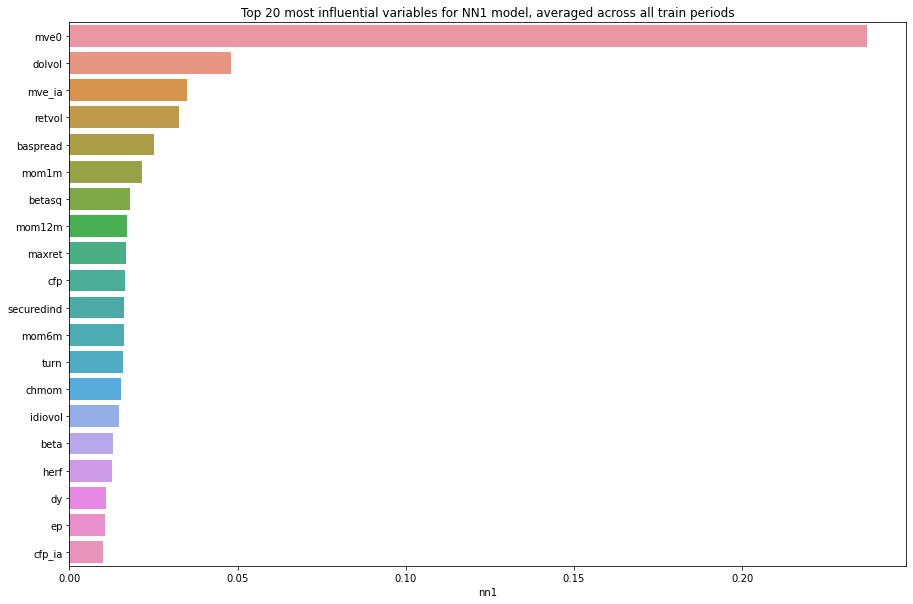

In [404]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [405]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,ridge,lasso,enet,pcr,extra,nn1
absacc,0.000334,0.000622,0.000000,0.000000,-0.002456,0.005258,0.006452
acc,0.001302,0.002116,0.000000,0.000000,-0.007864,0.004883,0.008022
aeavol,0.000984,0.007019,0.002913,0.003030,0.007646,0.004639,0.003378
age,0.000160,0.001337,0.000027,0.000045,-0.013675,0.012613,0.006088
agr,0.000195,0.003044,0.000000,0.000009,0.003117,0.009834,0.006807
baspread,0.008438,0.002834,0.000000,0.000000,-0.001840,0.026122,0.025246
beta,0.012467,0.002929,0.000000,0.000000,0.001281,0.021894,0.012936
betasq,0.010939,0.001710,0.000000,0.000000,-0.003600,0.022942,0.017933
bm,0.000831,0.017660,0.019649,0.020096,0.025056,0.011733,0.008053
bm_ia,0.002021,0.006742,0.005609,0.005660,0.016169,0.007191,0.005478


,lr,ridge,lasso,enet,pcr,extra,nn1,all_models
mom1m,84.0,93.0,91.0,92.0,94.0,93.0,89.0,636.0
mve0,94.0,94.0,94.0,94.0,77.0,86.0,94.0,633.0
chmom,88.0,92.0,93.0,93.0,93.0,87.0,81.0,627.0
retvol,93.0,90.0,87.0,87.0,87.0,89.0,91.0,624.0
mom6m,89.0,89.0,92.0,91.0,89.0,90.0,83.0,623.0
dy,83.0,91.0,90.0,90.0,91.0,92.0,77.0,614.0
mom12m,77.0,87.0,83.0,83.0,92.0,94.0,87.0,603.0
sgr,79.0,88.0,88.0,88.0,90.0,83.0,63.0,579.0
mom36m,72.0,85.0,84.0,84.0,74.0,88.0,74.0,561.0
dolvol,87.0,82.0,80.0,80.0,58.0,77.0,93.0,557.0


## NN2


### REIT

In [ ]:
df_results = df_results[:15]

In [406]:
def model_configs():
    # define scope of configs
    n_penalty_type = [l1, l2]
    n_penalty_amount = np.logspace(-5, -3, 5)
    n_learning_rate = [0.001, 0.01]
    # create configs
    configs = []
    for i in n_penalty_type:
        for j in n_penalty_amount:
            for k in n_learning_rate:
                cfg = [i,j,k]
                configs.append(cfg)
    print('Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): %d' %len(configs))
    return configs


def model_fit(X_train, y_train, cfg):
    # unpack config
    n_penalty_type, n_penalty_amount, n_learning_rate = cfg
    
    # Instantiate a Sequential model
    model = Sequential()
    
    # Add an input layer
    model.add(Dense(32, activation = 'relu', 
                    input_dim = X_train.shape[1], 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an input layer #2
    model.add(Dense(16, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an output layer
    model.add(Dense(1, activation = None, 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Set learning rate
    opt = Adam(learning_rate = n_learning_rate)
    
    # Compile model
    model.compile(loss = 'mse',optimizer = opt)

    # Early stop
    early_stop = EarlyStopping(
        monitor = 'loss',
        min_delta = 0,
        patience = 5
    )    
    
    # Convert to np.array before calling model.fit()
    #  to avoid error message "tensorflow:Falling back from v2 loop because 
    #  of error: Failed to find data adapter that can handle input
    X_train = np.asarray(X_train)
    y_train = np.asarray(y_train)    
    
    # Fit model
    model.fit(X_train, y_train,
              epochs = 1000,
              batch_size = 2 ** 13,
              callbacks = [early_stop]
             )
    return model


In [407]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): 20


In [408]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'nn2'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 65us/sample - loss: 110.9776
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 110.4297
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.9699
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.5986
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.2875
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.9985
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.7491
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.5561
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.3442
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.1623
Epoch 11/1000
21360/21360 [==============================] - 0s 3

21360/21360 [==============================] - 0s 2us/sample - loss: 66.9766
Epoch 180/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.9765
Epoch 181/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.5620
Epoch 182/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.4531
Epoch 183/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.6009
Epoch 184/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7105
Epoch 185/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.2280
Epoch 186/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.9868
Epoch 187/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.1996
Epoch 188/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.9602
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.6985
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 99.6015
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.3541
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.9906
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.7068
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.4055
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.0437
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.6797
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3562
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.8973
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.4970
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.1398
Epoch 71/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 63.4592
Epoch 239/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.3744
Epoch 240/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.2829
Epoch 241/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4176
Epoch 242/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.4378
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.3590
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.1984
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4361
Epoch 246/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.2628
Epoch 247/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0781
Epoch 248/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.9466
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 73.0354
Epoch 141/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0116
Epoch 142/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.8341
Epoch 143/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4443
Epoch 144/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4221
Epoch 145/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.2233
Epoch 146/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.9948
Epoch 147/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.7745
Epoch 148/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.7920
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4983
Epoch 150/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.2758
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 102.9345
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7596
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5728
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3883
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2094
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.0165
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.8269
Epoch 50/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6346
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.4134
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.2047
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.9902
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 65.7285
Epoch 222/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.4464
Epoch 223/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.3412
Epoch 224/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.4234
Epoch 225/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.4297
Epoch 226/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2278
Epoch 227/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.3066
Epoch 228/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.3562
Epoch 229/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1905
Epoch 230/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.9517
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.7870
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 103.4384
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.2625
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.0882
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.9235
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7918
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5990
Epoch 50/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3724
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2057
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.0311
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.8648
Epoch 54/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.6226
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 62.5605
Epoch 223/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.4327
Epoch 224/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.1807
Epoch 225/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.4254
Epoch 226/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.2918
Epoch 227/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.1888
Epoch 228/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.2465
Epoch 229/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.8780
Epoch 230/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.0469
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.0989
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.8367
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 77.7077
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.3735
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.7821
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9483
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.1989
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2565
Epoch 35/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.0097
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.0997
Epoch 37/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.3745
Epoch 38/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.6477
Epoch 39/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.9416
Epoch 40/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 81.1273
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.7286
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.4052
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.2386
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9374
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.3633
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7630
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0630
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.2239
Epoch 34/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1218
Epoch 35/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.3162
Epoch 36/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 108.3517
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.1566
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.9942
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.8348
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.6827
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5280
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3906
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2699
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.1261
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.9818
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.8473
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 67.7733
Epoch 188/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.4508
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.4982
Epoch 190/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.6763
Epoch 191/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.2174
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.3699
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.0335
Epoch 194/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.9825
Epoch 195/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.0160
Epoch 196/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.8355
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.4913
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 56.2109
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.001] -299.81111881601925 20.5105473193213 48.768248875938944 7.477002593763922
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 62us/sample - loss: 109.9750
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.6094
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.3130
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.0667
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.8440
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.6427
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.4606
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.2996
Epoch 9/1000
21360/21360 [======

21360/21360 [==============================] - 0s 3us/sample - loss: 67.4713
Epoch 177/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.3882
Epoch 178/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.1202
Epoch 179/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0810
Epoch 180/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.9915
Epoch 181/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0000
Epoch 182/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.9658
Epoch 183/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.6009
Epoch 184/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7710
Epoch 185/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.4259
Epoch 186/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.4807
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.1783
Epoch 135/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.8569
Epoch 136/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.6439
Epoch 137/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.6627
Epoch 138/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.3132
Epoch 139/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.2800
Epoch 140/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.8964
Epoch 141/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.7834
Epoch 142/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.7193
Epoch 143/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.6176
Epoch 144/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.4032
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 61.0320
Epoch 313/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.9565
Epoch 314/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.7755
Epoch 315/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.7642
Epoch 316/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.9695
Epoch 317/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.1268
Epoch 318/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.0468
Epoch 319/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.9486
Epoch 320/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.8529
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.001] -188.48238237087344 17.42245950075503 44.28770381003141 7.7971063916408845
Train on 21360 samples
Epoch 1/1000
21360/21360

21360/21360 [==============================] - 0s 3us/sample - loss: 72.0686
Epoch 169/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3281
Epoch 170/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3210
Epoch 171/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3336
Epoch 172/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.0237
Epoch 173/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.4441
Epoch 174/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.3342
Epoch 175/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.0289
Epoch 176/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.0103
Epoch 177/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.6632
Epoch 178/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.6652
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 88.9851
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.5796
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.2065
Epoch 95/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.8230
Epoch 96/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.3935
Epoch 97/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.8991
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.7455
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.3464
Epoch 100/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.9611
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.5258
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.2919
Epoch 103/

21360/21360 [==============================] - 0s 2us/sample - loss: 60.9028
Epoch 271/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.6870
Epoch 272/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.6667
Epoch 273/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.7338
Epoch 274/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.7033
Epoch 275/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.7976
Epoch 276/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.4969
Epoch 277/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.5106
Epoch 278/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.4455
Epoch 279/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.5817
Epoch 280/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.4201
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 105.0322
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.2454
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.5069
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5813
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.4490
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.2562
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.9694
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3412
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.5472
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2057
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.2690
Epoch 17/1

21360/21360 [==============================] - 0s 2us/sample - loss: 98.7735
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.4168
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.9344
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2360
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.5869
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.0301
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.9661
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.4005
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.1336
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.4584
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.8315
Epoch 25/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 57.9590
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.4173
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.7106
Epoch 97/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.0306
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.2804
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01] -24.174238507129743 11.430508959215853 30.79715050610008 8.690002866534977

Ensemble results from Model [<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01]: [-23.60759404  11.40190187  27.16308233   8.91364864]
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 63us/sample - loss: 109.6837
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.3311
Epoch 3/1000
21360/21360 [==============================] - 0s 2us

21360/21360 [==============================] - 0s 2us/sample - loss: 68.7400
Epoch 172/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.4580
Epoch 173/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.1826
Epoch 174/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.4108
Epoch 175/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.0777
Epoch 176/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.8713
Epoch 177/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.6186
Epoch 178/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.6596
Epoch 179/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.2868
Epoch 180/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.2601
Epoch 181/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.9944
Epo

Epoch 87/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.3496
Epoch 88/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.0998
Epoch 89/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.8387
Epoch 90/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.5373
Epoch 91/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.3477
Epoch 92/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.0332
Epoch 93/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.7196
Epoch 94/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.4342
Epoch 95/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.1897
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.9165
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.6627

21360/21360 [==============================] - 0s 2us/sample - loss: 60.0178
Epoch 266/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.9958
Epoch 267/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.6603
Epoch 268/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.9539
Epoch 269/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.0520
Epoch 270/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.7263
Epoch 271/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.4145
Epoch 272/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.3781
Epoch 273/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.6033
Epoch 274/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.5825
Epoch 275/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.0615
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 99.4030
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.1347
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.8761
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.5440
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.2446
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.8989
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.6357
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3274
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.0193
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.6670
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.3236
Epoch 71/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 61.7334
Epoch 239/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.5924
Epoch 240/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.6063
Epoch 241/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.1403
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.3388
Epoch 243/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.0739
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.8602
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.0200
Epoch 246/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.9908
Epoch 247/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.6889
Epoch 248/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.7677
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 71.9820
Epoch 163/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.5987
Epoch 164/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.5221
Epoch 165/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.2335
Epoch 166/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.9893
Epoch 167/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.0382
Epoch 168/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.7727
Epoch 169/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.6381
Epoch 170/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.7205
Epoch 171/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.3215
Epoch 172/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.2295
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 101.8971
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.7140
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.5060
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.2635
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.0733
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.8197
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.6110
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.3560
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.1160
Epoch 54/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.8567
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.6130
Epoc

21360/21360 [==============================] - 0s 3us/sample - loss: 64.3177
Epoch 224/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.1672
Epoch 225/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.2873
Epoch 226/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.3519
Epoch 227/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.9971
Epoch 228/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.0193
Epoch 229/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.9093
Epoch 230/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.9117
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.5757
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.7876
Epoch 233/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.5266
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 62.9268
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.5201
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.3342
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.4926
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.7546
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.5477
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.4782
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.7423
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01] -9.307059989496413 10.72442267827637 18.021377008633632 9.458194498485959
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 62us/sample - loss: 110.4688
Epoch 2/1000
21360/21360 [=======================

Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.9098
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.9240
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.2938
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.6104
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.8238
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.0155
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.2096
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2808
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.2510
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.0609
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.17

21360/21360 [==============================] - 0s 2us/sample - loss: 103.6752
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.4955
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.3429
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.1490
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.9870
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7917
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.6381
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.4471
Epoch 50/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2424
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.0589
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.8496
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 66.1489
Epoch 221/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.8123
Epoch 222/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.7510
Epoch 223/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.6212
Epoch 224/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.5775
Epoch 225/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.5973
Epoch 226/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.4299
Epoch 227/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.5124
Epoch 228/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.4251
Epoch 229/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1036
Epoch 230/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1688
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 102.6496
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.4445
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.2177
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.0117
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.8064
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.6258
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.3641
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.1350
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.9394
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.6788
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.4575
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 65.5999
Epoch 228/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.7567
Epoch 229/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1442
Epoch 230/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.0971
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2055
Epoch 232/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.8546
Epoch 233/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.8955
Epoch 234/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.8058
Epoch 235/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.7840
Epoch 236/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.3762
Epoch 237/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.3736
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 78.6848
Epoch 118/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.3649
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.0854
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.7834
Epoch 121/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.7515
Epoch 122/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4125
Epoch 123/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.0274
Epoch 124/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.8124
Epoch 125/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.8907
Epoch 126/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2588
Epoch 127/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.2325
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 94.3965
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.9896
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.6770
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 93.2726
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.8386
Epoch 82/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.4944
Epoch 83/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.2890
Epoch 84/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.8177
Epoch 85/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.4811
Epoch 86/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.1655
Epoch 87/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.8430
Epoch 88/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 65.0016
Epoch 256/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.8027
Epoch 257/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.7174
Epoch 258/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.7316
Epoch 259/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.4713
Epoch 260/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.4328
Epoch 261/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.2066
Epoch 262/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.2324
Epoch 263/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.0414
Epoch 264/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.0715
Epoch 265/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8572
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.0661
Epoch 148/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.7801
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.4548
Epoch 150/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.1700
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.1716
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.6209
Epoch 153/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.6637
Epoch 154/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.3457
Epoch 155/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.1226
Epoch 156/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.1423
Epoch 157/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.0428
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 59.7310
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.2576
Epoch 73/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 58.7231
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.4303
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.1431
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.8133
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.5606
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.5055
Epoch 79/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.2705
Epoch 80/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.8628
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.8031
Epoch 82/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 97.4989
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.9898
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2875
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.5486
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.5350
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6241
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.1571
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.8093
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0721
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.7088
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.3625
Epoch 24/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 106.5392
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4310
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3009
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.1513
Epoch 30/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0296
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.8895
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.7474
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6123
Epoch 34/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.4557
Epoch 35/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.3265
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.1715
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 64.6460
Epoch 205/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.7622
Epoch 206/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.2308
Epoch 207/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.2443
Epoch 208/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.1097
Epoch 209/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.0694
Epoch 210/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.3840
Epoch 211/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1568
Epoch 212/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.6446
Epoch 213/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.8068
Epoch 214/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.8335
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 98.5979
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.3160
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.9939
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.6172
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.3699
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.0001
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.7392
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.3926
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.1414
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.6784
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.3402
Epoch 68/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 62.3389
Epoch 236/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.3222
Epoch 237/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.4276
Epoch 238/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.3974
Epoch 239/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.1461
Epoch 240/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.3985
Epoch 241/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.1614
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.1485
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.8401
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.0328
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.1041
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 85.5299
Epoch 110/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.2107
Epoch 111/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.9658
Epoch 112/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.6094
Epoch 113/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.3411
Epoch 114/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.1406
Epoch 115/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.6204
Epoch 116/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.3777
Epoch 117/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.0031
Epoch 118/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6290
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6009
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 57.5980
Epoch 288/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.3821
Epoch 289/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.4468
Epoch 290/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.4995
Epoch 291/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.3650
Epoch 292/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.5083
Epoch 293/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.2384
Epoch 294/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.1956
Epoch 295/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.2682
Epoch 296/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 56.9753
Epoch 297/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.1874
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 72.8317
Epoch 160/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.8102
Epoch 161/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4599
Epoch 162/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2636
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.3036
Epoch 164/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2416
Epoch 165/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.8495
Epoch 166/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.7389
Epoch 167/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.7809
Epoch 168/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.3979
Epoch 169/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.4809
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 104.9759
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.7803
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.5888
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.4216
Epoch 38/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.2285
Epoch 39/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.0203
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.8436
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.6761
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.4409
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.2347
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.0533
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 63.3587
Epoch 213/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.2786
Epoch 214/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.2267
Epoch 215/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.0072
Epoch 216/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.8602
Epoch 217/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 63.0090
Epoch 218/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0761
Epoch 219/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0978
Epoch 220/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.7474
Epoch 221/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.6739
Epoch 222/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.3966
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 69.1048
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.8834
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.5304
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.6245
Epoch 50/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.6045
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.2177
Epoch 52/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.8583
Epoch 53/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.6260
Epoch 54/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1504
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.4488
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1490
Epoch 57/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 59.1165
Epoch 82/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.8794
Epoch 83/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.6892
Epoch 84/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.7293
Epoch 85/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.5014
Epoch 86/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.1161
Epoch 87/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.8768
Epoch 88/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.5255
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.6544
Epoch 90/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.8241
Epoch 91/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.2711
Epoch 92/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 98.9793
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.6525
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.4096
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.1543
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.8439
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5550
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.2718
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.9547
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.5978
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.3021
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.9599
Epoch 74/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 63.7403
Epoch 242/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.6247
Epoch 243/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.5967
Epoch 244/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.5118
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.6325
Epoch 246/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4336
Epoch 247/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4099
Epoch 248/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3055
Epoch 249/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4111
Epoch 250/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.1653
Epoch 251/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4279
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 77.7505
Epoch 132/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.8094
Epoch 133/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3814
Epoch 134/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.3216
Epoch 135/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1248
Epoch 136/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.6013
Epoch 137/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4175
Epoch 138/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.2924
Epoch 139/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.0515
Epoch 140/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.7863
Epoch 141/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4953
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 105.7761
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6602
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.5063
Epoch 30/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.3731
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.2255
Epoch 32/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.1008
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9690
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8256
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.6839
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.5422
Epoch 37/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.3784
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 66.8625
Epoch 206/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.9003
Epoch 207/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.8011
Epoch 208/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.8398
Epoch 209/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.8102
Epoch 210/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.3845
Epoch 211/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.3971
Epoch 212/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.2275
Epoch 213/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.1594
Epoch 214/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.2811
Epoch 215/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.9605
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 92.3431
Epoch 86/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 92.0483
Epoch 87/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.8609
Epoch 88/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.6955
Epoch 89/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.2456
Epoch 90/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 91.0094
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.7628
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.5481
Epoch 93/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.3706
Epoch 94/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.9410
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.7334
Epoch 96/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 59.4372
Epoch 264/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.6895
Epoch 265/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.3231
Epoch 266/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.2545
Epoch 267/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.4838
Epoch 268/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.0968
Epoch 269/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.3145
Epoch 270/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.9114
Epoch 271/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.0188
Epoch 272/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.9279
Epoch 273/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.7958
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 78.3826
Epoch 135/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.0338
Epoch 136/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9557
Epoch 137/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.2990
Epoch 138/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.2361
Epoch 139/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.9225
Epoch 140/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4046
Epoch 141/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.4641
Epoch 142/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.9426
Epoch 143/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5974
Epoch 144/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.0069
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 59.8014
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.5553
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.7659
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.2142
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.2832
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.2173
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.7292
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.2993
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.9336
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.9311
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.5567
Epoch 77/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 71.7697
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5441
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.6703
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.2289
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.1867
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.2424
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.9390
Epoch 48/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.9193
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.5148
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.0342
Epoch 51/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.4671
Epoch 52/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 60.2638
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.4077
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.4862
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.5821
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.2395
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.4775
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.0333
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.8803
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.4516
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.4453
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.3173
Epoch 79/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 74.2893
Epoch 156/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.1014
Epoch 157/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6662
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7259
Epoch 159/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.3639
Epoch 160/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.2065
Epoch 161/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.1499
Epoch 162/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.7825
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4977
Epoch 164/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.3868
Epoch 165/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.0491
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 107.4805
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.3377
Epoch 15/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.1853
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.0564
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.9066
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.7675
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.6400
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.5136
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3708
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.2388
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0835
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 67.3203
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.1641
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.0125
Epoch 194/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.0282
Epoch 195/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.0036
Epoch 196/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.8437
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.8023
Epoch 198/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.4967
Epoch 199/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.7960
Epoch 200/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.2882
Epoch 201/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.3373
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 80.5389
Epoch 119/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.3581
Epoch 120/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8874
Epoch 121/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.4306
Epoch 122/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.5137
Epoch 123/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.9549
Epoch 124/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.7527
Epoch 125/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.4172
Epoch 126/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9390
Epoch 127/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.6937
Epoch 128/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.4660
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 57.7087
Epoch 297/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.7689
Epoch 298/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.2209
Epoch 299/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.4691
Epoch 300/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.3749
Epoch 301/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.3389
Epoch 302/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.1134
Epoch 303/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.1356
Epoch 304/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.1073
Epoch 305/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 56.7629
Epoch 306/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.1910
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 74.5836
Epoch 143/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3314
Epoch 144/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9779
Epoch 145/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9388
Epoch 146/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6652
Epoch 147/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6276
Epoch 148/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1174
Epoch 149/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.1583
Epoch 150/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.9575
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.7527
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.4591
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 103.7303
Epoch 38/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.5541
Epoch 39/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.3230
Epoch 40/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.1556
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.9246
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.7505
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.5285
Epoch 44/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.3221
Epoch 45/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 102.1327
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 101.9256
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.7367
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 64.7453
Epoch 216/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.6728
Epoch 217/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.5771
Epoch 218/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.4302
Epoch 219/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.2224
Epoch 220/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.3062
Epoch 221/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.1212
Epoch 222/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.9494
Epoch 223/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.0744
Epoch 224/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.9040
Epoch 225/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.6963
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 76.4911
Epoch 34/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.5776
Epoch 35/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.7502
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.1840
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2150
Epoch 38/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.9660
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.1122
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.9934
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.6875
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.2561
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.9670
Epoch 44/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 62.5968
Epoch 55/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.5288
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.7317
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.8877
Epoch 58/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.9421
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.8841
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.3366
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.6750
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.3664
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.5478
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.1077
Epoch 65/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 57.5736
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.7493
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.8211
Epoch 83/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.7101
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.4532
Epoch 85/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.6690
[<function l2 at 0x7feecc1a7f80>, 3.1622776601683795e-05, 0.01] -13.418986643785846 10.924276831763402 25.192015892077556 9.035078015120256
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 1s 65us/sample - loss: 111.0618
Epoch 2/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.2334
Epoch 3/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2984
Epoch 4/1000
21360/21360 [=====

21360/21360 [==============================] - 0s 3us/sample - loss: 98.3852
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.1200
Epoch 69/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.8666
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.5484
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.3326
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.0460
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.7475
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.4742
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.1480
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.8768
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.5719
Epoch 78/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 63.8312
Epoch 246/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.7960
Epoch 247/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.5512
Epoch 248/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.8183
Epoch 249/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4734
Epoch 250/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4364
Epoch 251/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4570
Epoch 252/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0802
Epoch 253/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.1229
Epoch 254/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.1746
Epoch 255/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.1852
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 69.1165
Epoch 165/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.0851
Epoch 166/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.5993
Epoch 167/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.6746
Epoch 168/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.2592
Epoch 169/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.1412
Epoch 170/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.1741
Epoch 171/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.8021
Epoch 172/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.8626
Epoch 173/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.5242
Epoch 174/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.4388
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 109.3389
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 109.0511
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.7802
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.5382
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.3212
Epoch 9/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 108.1177
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.9378
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.7606
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.5980
Epoch 13/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.4450
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2878
Epoch 1

21360/21360 [==============================] - 0s 3us/sample - loss: 66.9525
Epoch 183/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.0943
Epoch 184/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.6510
Epoch 185/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.5615
Epoch 186/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.8755
Epoch 187/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.4409
Epoch 188/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.5273
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.6701
Epoch 190/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.1889
Epoch 191/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.3567
Epoch 192/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.0585
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 97.0708
Epoch 77/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.8157
Epoch 78/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 96.5888
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.3091
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.1186
Epoch 81/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.8208
Epoch 82/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.6305
Epoch 83/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.4137
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.0689
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.8865
Epoch 86/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.6437
Epoch 87/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 65.3311
Epoch 255/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.2305
Epoch 256/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.5528
Epoch 257/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2630
Epoch 258/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.9057
Epoch 259/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.0818
Epoch 260/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.9504
Epoch 261/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.8912
Epoch 262/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.7090
Epoch 263/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.7772
Epoch 264/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.6391
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 74.0445
Epoch 151/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.9947
Epoch 152/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.5343
Epoch 153/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.4620
Epoch 154/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.9343
Epoch 155/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.7333
Epoch 156/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.6072
Epoch 157/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.5636
Epoch 158/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.5269
Epoch 159/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.0832
Epoch 160/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.9478
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 61.8441
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.6798
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.8665
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.5914
Epoch 70/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.2226
Epoch 71/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.9866
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.8619
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.3039
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.9481
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01] -8.725696654118643 10.695865060946634 19.801837305524884 9.354921348002101
Train on 21360 samples
Epoch 1/1000
21360/21360 [=======================

21360/21360 [==============================] - 0s 2us/sample - loss: 87.6546
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.4021
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.0663
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.5751
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 83.4572
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.8838
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.8834
Epoch 26/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 78.2982
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.5405
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.5496
Epoch 29/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.4430
Epoch 30/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 97.8273
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.4586
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.1768
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.7976
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.4815
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.0914
Epoch 72/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.8000
Epoch 73/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.4477
Epoch 74/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 95.0536
Epoch 75/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.6063
Epoch 76/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 94.2363
Epoch 77/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 60.4283
Epoch 245/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.3108
Epoch 246/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.2549
Epoch 247/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.3664
Epoch 248/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.9201
Epoch 249/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.8994
Epoch 250/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.9626
Epoch 251/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.9105
Epoch 252/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.6156
Epoch 253/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.5371
Epoch 254/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.7405
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 70.1897
Epoch 161/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.9217
Epoch 162/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.1029
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.7254
Epoch 164/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.3828
Epoch 165/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.2319
Epoch 166/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.1882
Epoch 167/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.2249
Epoch 168/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.2719
Epoch 169/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.1031
Epoch 170/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.5900
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 100.7676
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.4950
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.2175
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.9121
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.6808
Epoch 56/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.3667
Epoch 57/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.0587
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.7505
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.4764
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.1208
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 97.8362
Epoch 62/1

21360/21360 [==============================] - 0s 3us/sample - loss: 65.5307
Epoch 230/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.7153
Epoch 231/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2309
Epoch 232/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2063
Epoch 233/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.3471
Epoch 234/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2901
Epoch 235/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1498
Epoch 236/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2213
Epoch 237/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.1312
Epoch 238/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.7857
Epoch 239/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.8210
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 90.9387
Epoch 95/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.7402
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.3833
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 90.0482
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.6600
Epoch 99/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.4008
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 89.0587
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.7754
Epoch 102/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.4107
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.9547
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.7546
Epoch 10

21360/21360 [==============================] - 0s 2us/sample - loss: 64.0487
Epoch 273/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.7471
Epoch 274/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.6426
Epoch 275/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.4348
Epoch 276/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4844
Epoch 277/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.6685
Epoch 278/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.3896
Epoch 279/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4442
Epoch 280/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.6244
Epoch 281/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.6274
Epoch 282/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.4970
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 72.3911
Epoch 166/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.3832
Epoch 167/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.3165
Epoch 168/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.0593
Epoch 169/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.9971
Epoch 170/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.6866
Epoch 171/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.6008
Epoch 172/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3953
Epoch 173/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.3500
Epoch 174/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.1301
Epoch 175/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.0817
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 57.7349
Epoch 344/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.6129
Epoch 345/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.5418
Epoch 346/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.3845
Epoch 347/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.5931
Epoch 348/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.6849
Epoch 349/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.4406
Epoch 350/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.5128
Epoch 351/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.3625
Epoch 352/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.2932
Epoch 353/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 57.4537
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 62.9833
Epoch 59/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 63.1832
Epoch 60/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.7730
Epoch 61/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.5588
Epoch 62/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 62.1697
Epoch 63/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.0024
Epoch 64/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.3029
Epoch 65/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.4214
Epoch 66/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.1097
Epoch 67/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 60.0473
Epoch 68/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.6709
Epoch 69/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 70.1779
Epoch 40/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.0694
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.1822
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.6185
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.7234
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.1346
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.3801
Epoch 46/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.8433
Epoch 47/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 67.1733
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.6391
Epoch 49/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.7544
Epoch 50/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 107.2346
Epoch 4/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4762
Epoch 5/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.7517
Epoch 6/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.9299
Epoch 7/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 104.0351
Epoch 8/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 103.1044
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.9547
Epoch 10/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 100.7813
Epoch 11/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 99.4924
Epoch 12/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 98.2756
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.4559
Epoch 14/10

21360/21360 [==============================] - 0s 2us/sample - loss: 82.8827
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6388
Epoch 101/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.3794
Epoch 102/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.0124
Epoch 103/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.7607
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.5439
Epoch 105/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1101
Epoch 106/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 81.1660
Epoch 107/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6219
Epoch 108/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.4483
Epoch 109/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.2632
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 61.5915
Epoch 278/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.5642
Epoch 279/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.5100
Epoch 280/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.4426
Epoch 281/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.1571
Epoch 282/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.2480
Epoch 283/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.1253
Epoch 284/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.4800
Epoch 285/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 61.1828
Epoch 286/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.1949
Epoch 287/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.1349
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 85.9716
Epoch 96/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.6063
Epoch 97/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.2636
Epoch 98/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.7149
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.5686
Epoch 100/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.2949
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.6283
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.5129
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.9561
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.6071
Epoch 105/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.4321
Epoch 1

21360/21360 [==============================] - 0s 2us/sample - loss: 107.3959
Epoch 14/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 107.2358
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0794
Epoch 16/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.9331
Epoch 17/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.7853
Epoch 18/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.6273
Epoch 19/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.4868
Epoch 20/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.3411
Epoch 21/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.1826
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 106.0422
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 105.8990
Ep

21360/21360 [==============================] - 0s 2us/sample - loss: 66.0881
Epoch 192/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.9980
Epoch 193/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 66.0120
Epoch 194/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.7752
Epoch 195/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.8680
Epoch 196/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.5125
Epoch 197/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.3651
Epoch 198/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.2355
Epoch 199/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.3936
Epoch 200/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 65.0933
Epoch 201/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 64.9918
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 88.4954
Epoch 96/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 88.1634
Epoch 97/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.6483
Epoch 98/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 87.2821
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.9782
Epoch 100/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.3597
Epoch 101/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 86.0452
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.5643
Epoch 103/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 85.2629
Epoch 104/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.8419
Epoch 105/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 84.3374
Epoch 1

21360/21360 [==============================] - 0s 2us/sample - loss: 59.1054
Epoch 274/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.2889
Epoch 275/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.7940
Epoch 276/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.9575
Epoch 277/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.9963
Epoch 278/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.7579
Epoch 279/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 59.0022
Epoch 280/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.4830
Epoch 281/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.7744
Epoch 282/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.4967
Epoch 283/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 58.5505
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 70.1914
Epoch 161/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 70.0081
Epoch 162/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.7601
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.6189
Epoch 164/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.5643
Epoch 165/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.1084
Epoch 166/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.9027
Epoch 167/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.8132
Epoch 168/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.6912
Epoch 169/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.2757
Epoch 170/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.3081
Epo

21360/21360 [==============================] - 0s 2us/sample - loss: 84.1998
Epoch 22/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.5267
Epoch 23/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 82.2677
Epoch 24/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 80.9097
Epoch 25/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 79.5667
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.3044
Epoch 27/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.5320
Epoch 28/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 76.7291
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.7657
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.5782
Epoch 31/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.4247
Epoch 32/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 79.0178
Epoch 34/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.9791
Epoch 35/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 77.1280
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.9940
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.2730
Epoch 38/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 75.1069
Epoch 39/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.0307
Epoch 40/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.5795
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 74.3867
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.6153
Epoch 43/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.4026
Epoch 44/1000

21360/21360 [==============================] - 0s 2us/sample - loss: 74.0921
Epoch 33/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.9526
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1845
Epoch 35/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.7024
Epoch 36/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 73.5469
Epoch 37/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.5875
Epoch 38/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 72.0880
Epoch 39/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 71.9653
Epoch 40/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.9294
Epoch 41/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 69.4816
Epoch 42/1000
21360/21360 [==============================] - 0s 2us/sample - loss: 68.9687
Epoch 43/1000

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -8.92, 10.7, 18.01, 9.5
[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.01], -16.38, 11.1, 20.99, 9.3
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -19.05, 11.2, 25.72, 9.0
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01], -19.12, 11.2, 20.82, 9.3
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01], -22.31, 11.3, 23.44, 9.1
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -23.61, 11.4, 27.16, 8.9
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -25.45, 11.5, 25.57, 9.0
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -25.69, 11.5, 27.47, 8.9
CPU times: user 1h 13min 6s, sys: 28min 54s, total: 1h 42min 1s
Wall time: 21min 16s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -8.92, 10.7, 18.01, 9.5

[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.01], -16.38, 11.1, 20.99, 9.3

[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -19.05, 11.2, 25.72, 9.0

[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01], -19.12, 11.2, 20.82, 9.3

[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01], -22.31, 11.3, 23.44, 9.1

[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -23.61, 11.4, 27.16, 8.9

[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -25.45, 11.5, 25.57, 9.0

[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -25.69, 11.5, 27.47, 8.9

CPU times: user 1h 13min 6s, sys: 28min 54s, total: 1h 42min 1s

Wall time: 21min 16s

In [409]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Train on 31753 samples
Epoch 1/1000
31753/31753 [==============================] - 1s 43us/sample - loss: 108.4310
Epoch 2/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 106.2471
Epoch 3/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 105.3633
Epoch 4/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 104.5944
Epoch 5/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 103.8556
Epoch 6/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 103.1643
Epoch 7/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 102.4085
Epoch 8/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 101.4862
Epoch 9/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 100.4754
Epoch 10/1000
31753/31753 [==============================] - 0s 2us/sample - loss: 99.2013
Epoch 11/1000
31753/31753 [==============================] - 0s 2u

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 33962 samples
Epoch 1/1000
33962/33962 [==============================] - 1s 40us/sample - loss: 105.6007
Epoch 2/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 103.0899
Epoch 3/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 102.2348
Epoch 4/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 101.6540
Epoch 5/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 101.0811
Epoch 6/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 100.5383
Epoch 7/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 99.9792
Epoch 8/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 99.4088
Epoch 9/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 98.5861
Epoch 10/1000
33962/33962 [==============================] - 0s 2us/sample - loss: 97.8365
Epoch 11/1000
33962/33962 [==============================] - 0s 2us/s

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 35928 samples
Epoch 1/1000
35928/35928 [==============================] - 1s 39us/sample - loss: 106.4581
Epoch 2/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 104.2059
Epoch 3/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 103.4111
Epoch 4/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 102.6995
Epoch 5/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 102.0513
Epoch 6/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 101.3805
Epoch 7/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 100.6562
Epoch 8/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 99.6355
Epoch 9/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 98.6612
Epoch 10/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 97.5099
Epoch 11/1000
35928/35928 [==============================] - 0s 3us/

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 37784 samples
Epoch 1/1000
37784/37784 [==============================] - 1s 38us/sample - loss: 120.5679
Epoch 2/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 118.2948
Epoch 3/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 117.4566
Epoch 4/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 116.8241
Epoch 5/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 116.0027
Epoch 6/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 115.0852
Epoch 7/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 113.9948
Epoch 8/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 112.7523
Epoch 9/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 111.3213
Epoch 10/1000
37784/37784 [==============================] - 0s 2us/sample - loss: 109.9889
Epoch 11/1000
37784/37784 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 39556 samples
Epoch 1/1000
39556/39556 [==============================] - 1s 35us/sample - loss: 143.3033
Epoch 2/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 141.0720
Epoch 3/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 140.2750
Epoch 4/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 139.5387
Epoch 5/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 138.7495
Epoch 6/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 137.7118
Epoch 7/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 136.5339
Epoch 8/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 135.1182
Epoch 9/1000
39556/39556 [==============================] - 0s 2us/sample - loss: 133.4801
Epoch 10/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 131.8533
Epoch 11/1000
39556/39556 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 41396 samples
Epoch 1/1000
41396/41396 [==============================] - 1s 33us/sample - loss: 145.6753
Epoch 2/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 142.1712
Epoch 3/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 141.4542
Epoch 4/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 140.9382
Epoch 5/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 140.4272
Epoch 6/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 139.7973
Epoch 7/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 139.4004
Epoch 8/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 138.9315
Epoch 9/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 138.4374
Epoch 10/1000
41396/41396 [==============================] - 0s 2us/sample - loss: 138.0004
Epoch 11/1000
41396/41396 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 43327 samples
Epoch 1/1000
43327/43327 [==============================] - 1s 32us/sample - loss: 142.6333
Epoch 2/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 139.9294
Epoch 3/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 139.1195
Epoch 4/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 138.3983
Epoch 5/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 137.6151
Epoch 6/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 136.7414
Epoch 7/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 135.8038
Epoch 8/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 134.6846
Epoch 9/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 133.4712
Epoch 10/1000
43327/43327 [==============================] - 0s 2us/sample - loss: 132.1653
Epoch 11/1000
43327/43327 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 45304 samples
Epoch 1/1000
45304/45304 [==============================] - 1s 30us/sample - loss: 140.1776
Epoch 2/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 137.6644
Epoch 3/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 136.7452
Epoch 4/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 135.9684
Epoch 5/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 135.0634
Epoch 6/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 134.0216
Epoch 7/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 132.8384
Epoch 8/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 131.5109
Epoch 9/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 130.2614
Epoch 10/1000
45304/45304 [==============================] - 0s 2us/sample - loss: 128.5872
Epoch 11/1000
45304/45304 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 47453 samples
Epoch 1/1000
47453/47453 [==============================] - 1s 29us/sample - loss: 137.8541
Epoch 2/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 135.4628
Epoch 3/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 134.4970
Epoch 4/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 133.7342
Epoch 5/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 133.0452
Epoch 6/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 132.1976
Epoch 7/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 131.2594
Epoch 8/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 130.0169
Epoch 9/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 128.7687
Epoch 10/1000
47453/47453 [==============================] - 0s 2us/sample - loss: 127.2869
Epoch 11/1000
47453/47453 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 49786 samples
Epoch 1/1000
49786/49786 [==============================] - 4s 74us/sample - loss: 133.2634
Epoch 2/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 131.3380
Epoch 3/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 130.5982
Epoch 4/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 130.2099
Epoch 5/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 129.6204
Epoch 6/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 128.9959
Epoch 7/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 128.3585
Epoch 8/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 127.6774
Epoch 9/1000
49786/49786 [==============================] - 0s 2us/sample - loss: 127.0677
Epoch 10/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 126.5188
Epoch 11/1000
49786/49786 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 52259 samples
Epoch 1/1000
52259/52259 [==============================] - 1s 28us/sample - loss: 129.7122
Epoch 2/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 127.5451
Epoch 3/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 126.6229
Epoch 4/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 125.9567
Epoch 5/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 125.1511
Epoch 6/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 124.3647
Epoch 7/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 123.2028
Epoch 8/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 122.1811
Epoch 9/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 121.3127
Epoch 10/1000
52259/52259 [==============================] - 0s 2us/sample - loss: 120.3834
Epoch 11/1000
52259/52259 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 54667 samples
Epoch 1/1000
54667/54667 [==============================] - 1s 27us/sample - loss: 127.6274
Epoch 2/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 125.8091
Epoch 3/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 124.9782
Epoch 4/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 124.2871
Epoch 5/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 123.5551
Epoch 6/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 122.7429
Epoch 7/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 121.6437
Epoch 8/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 120.5057
Epoch 9/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 119.3653
Epoch 10/1000
54667/54667 [==============================] - 0s 2us/sample - loss: 118.8337
Epoch 11/1000
54667/54667 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 57037 samples
Epoch 1/1000
57037/57037 [==============================] - 1s 25us/sample - loss: 124.5705
Epoch 2/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 122.6969
Epoch 3/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 121.9946
Epoch 4/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 121.4004
Epoch 5/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 120.7400
Epoch 6/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 119.9271
Epoch 7/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 119.1355
Epoch 8/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 118.0591
Epoch 9/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 116.8873
Epoch 10/1000
57037/57037 [==============================] - 0s 2us/sample - loss: 115.7859
Epoch 11/1000
57037/57037 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 59411 samples
Epoch 1/1000
59411/59411 [==============================] - 1s 25us/sample - loss: 121.7216
Epoch 2/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 120.1388
Epoch 3/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 119.4067
Epoch 4/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 118.8613
Epoch 5/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 118.2183
Epoch 6/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 117.5957
Epoch 7/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 116.7521
Epoch 8/1000
59411/59411 [==============================] - 0s 2us/sample - loss: 115.7860
Epoch 9/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 115.0622
Epoch 10/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 113.9285
Epoch 11/1000
59411/59411 [==============================] - 0s 2

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 61718 samples
Epoch 1/1000
61718/61718 [==============================] - 1s 23us/sample - loss: 120.3153
Epoch 2/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 118.3552
Epoch 3/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 117.6582
Epoch 4/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 116.9671
Epoch 5/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 116.2781
Epoch 6/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 115.2987
Epoch 7/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 114.3006
Epoch 8/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 113.2581
Epoch 9/1000
61718/61718 [==============================] - 0s 2us/sample - loss: 112.2273
Epoch 10/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 110.9778
Epoch 11/1000
61718/61718 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -11.26.
RMSE for entire pooled test set, from 2006 to 2020, is 12.8.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01]
CPU times: user 7min 23s, sys: 2min 40s, total: 10min 3s
Wall time: 2min 23s


R2 for entire pooled test set, from 2006 to 2020, is -11.26.

RMSE for entire pooled test set, from 2006 to 2020, is 12.8.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01]

CPU times: user 7min 23s, sys: 2min 40s, total: 10min 3s

Wall time: 2min 23s

### Features of importance

In [410]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'nn2'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

2006 done
2007 done
2008 done
2009 done
2010 done
2011 done
2012 done
2013 done
2014 done
2015 done
2016 done
2017 done
2018 done
2019 done
2020 done
CPU times: user 47min 56s, sys: 5min 49s, total: 53min 46s
Wall time: 30min 2s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,nn2
absacc,1.041110,2.260306,0.689823,1.496069,0.527718,0.314443,0.296447,1.289093,0.487239,0.389556,0.745926,0.925504,1.354533,2.447686,0.518204,0.006821
acc,0.821271,1.568856,0.781099,1.493762,0.637756,0.830933,0.605784,1.690058,0.893292,0.277920,0.684284,0.714643,1.102139,3.139436,0.431550,0.007231
aeavol,0.999207,1.046279,0.693742,1.251546,0.562681,0.421401,0.383837,1.196077,1.786760,0.409097,0.722082,1.029164,0.778854,1.960552,0.600890,0.006386
age,0.903999,1.137977,0.847657,1.440200,0.500790,0.856584,0.414190,1.732823,0.677075,0.312513,0.432712,0.706971,0.554880,1.853292,0.590502,0.005980
agr,0.743639,1.043818,0.401801,0.793214,0.355202,0.297945,0.449232,0.702387,0.873421,0.140923,0.666494,0.685047,0.459970,1.686646,0.270680,0.004415
baspread,5.897292,7.647319,4.357670,4.754397,4.058304,6.585278,4.664640,9.237547,7.584205,1.460659,7.678053,6.979044,7.221000,13.499126,5.496359,0.044808
beta,3.080400,3.778378,2.412304,1.739520,1.457809,1.402425,1.231576,3.184723,3.335688,0.591157,1.972283,1.309283,2.414106,4.392224,1.353539,0.015527
betasq,2.213224,3.178951,1.124310,2.927492,1.884446,1.536772,0.990596,2.504349,3.578461,0.884293,1.655358,1.734174,2.053581,5.618683,1.603760,0.015450
bm,1.761445,3.185052,2.212537,1.880070,0.810229,1.050910,1.093028,2.012704,1.601932,0.306703,1.157510,1.772759,1.192899,3.407145,0.723907,0.011151
bm_ia,1.533529,1.380388,0.847159,0.484966,0.789071,0.746120,0.546620,1.477945,1.332050,0.418049,0.605716,1.416558,0.941563,1.595352,0.771750,0.006868


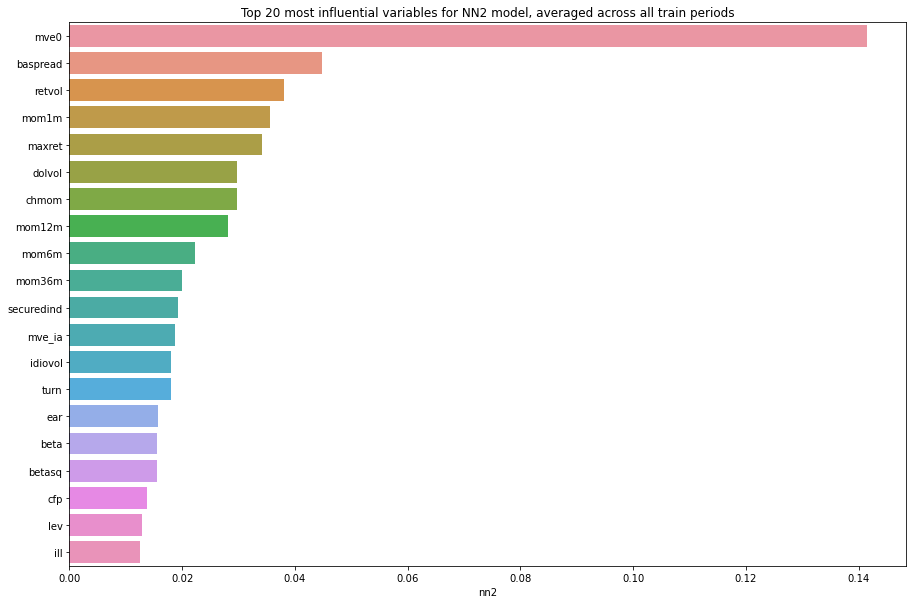

In [411]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [412]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,ridge,lasso,enet,pcr,extra,nn1,nn2
absacc,0.000334,0.000622,0.000000,0.000000,-0.002456,0.005258,0.006452,0.006821
acc,0.001302,0.002116,0.000000,0.000000,-0.007864,0.004883,0.008022,0.007231
aeavol,0.000984,0.007019,0.002913,0.003030,0.007646,0.004639,0.003378,0.006386
age,0.000160,0.001337,0.000027,0.000045,-0.013675,0.012613,0.006088,0.005980
agr,0.000195,0.003044,0.000000,0.000009,0.003117,0.009834,0.006807,0.004415
baspread,0.008438,0.002834,0.000000,0.000000,-0.001840,0.026122,0.025246,0.044808
beta,0.012467,0.002929,0.000000,0.000000,0.001281,0.021894,0.012936,0.015527
betasq,0.010939,0.001710,0.000000,0.000000,-0.003600,0.022942,0.017933,0.015450
bm,0.000831,0.017660,0.019649,0.020096,0.025056,0.011733,0.008053,0.011151
bm_ia,0.002021,0.006742,0.005609,0.005660,0.016169,0.007191,0.005478,0.006868


,lr,ridge,lasso,enet,pcr,extra,nn1,nn2,all_models
mom1m,84.0,93.0,91.0,92.0,94.0,93.0,89.0,91.0,727.0
mve0,94.0,94.0,94.0,94.0,77.0,86.0,94.0,94.0,727.0
retvol,93.0,90.0,87.0,87.0,87.0,89.0,91.0,92.0,716.0
chmom,88.0,92.0,93.0,93.0,93.0,87.0,81.0,88.0,715.0
mom6m,89.0,89.0,92.0,91.0,89.0,90.0,83.0,86.0,709.0
mom12m,77.0,87.0,83.0,83.0,92.0,94.0,87.0,87.0,690.0
dy,83.0,91.0,90.0,90.0,91.0,92.0,77.0,74.0,688.0
dolvol,87.0,82.0,80.0,80.0,58.0,77.0,93.0,89.0,646.0
mom36m,72.0,85.0,84.0,84.0,74.0,88.0,74.0,85.0,646.0
sgr,79.0,88.0,88.0,88.0,90.0,83.0,63.0,62.0,641.0


## NN3

### REIT

In [ ]:
df_results = df_results[:16]

In [413]:
def model_configs():
    # define scope of configs
    n_penalty_type = [l1, l2]
    n_penalty_amount = np.logspace(-5, -3, 5)
    n_learning_rate = [0.001, 0.01]
    # create configs
    configs = []
    for i in n_penalty_type:
        for j in n_penalty_amount:
            for k in n_learning_rate:
                cfg = [i,j,k]
                configs.append(cfg)
    print('Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_penalty_type, n_penalty_amount, n_learning_rate = cfg
    
    # Instantiate a Sequential model
    model = Sequential()
    
    # Add an input layer
    model.add(Dense(32, activation = 'relu', 
                    input_dim = X_train.shape[1], 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an input layer #2
    model.add(Dense(16, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())

    # Add an input layer #3
    model.add(Dense(8, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an output layer
    model.add(Dense(1, activation = None, 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Set learning rate
    opt = Adam(learning_rate = n_learning_rate)
    
    # Compile model
    model.compile(loss = 'mse',optimizer = opt)

    # Early stop
    early_stop = EarlyStopping(
        monitor = 'loss',
        min_delta = 0,
        patience = 5
    )    
    
    # Convert to np.array before calling model.fit()
    #  to avoid error message "tensorflow:Falling back from v2 loop because 
    #  of error: Failed to find data adapter that can handle input
    X_train = np.asarray(X_train)
    y_train = np.asarray(y_train)    
    
    # Fit model
    model.fit(X_train, y_train,
              epochs = 1000,
              batch_size = 2 ** 13,
              callbacks = [early_stop]
             )
    return model

In [414]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): 20


In [415]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'nn3'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 85us/sample - loss: 110.4425
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.9498
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.6275
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.3002
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.0342
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.7715
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.5666
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.3593
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.1664
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.9845
Epoch 11/1000
21360/21360 [==============================] - 0s 3

21360/21360 [==============================] - 0s 3us/sample - loss: 66.6144
Epoch 180/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7255
Epoch 181/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3048
Epoch 182/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.9949
Epoch 183/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.4471
Epoch 184/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.9309
Epoch 185/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.2085
Epoch 186/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.0543
Epoch 187/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5584
Epoch 188/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.2569
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.4875
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 73.7512
Epoch 130/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7125
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.5455
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.3932
Epoch 133/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.5192
Epoch 134/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0049
Epoch 135/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.7820
Epoch 136/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.8331
Epoch 137/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4701
Epoch 138/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.3233
Epoch 139/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.1431
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 101.6136
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.3375
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.0494
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.8009
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.5290
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.2263
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.9666
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.7361
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.3712
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.0662
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.7940
Epoch 5

21360/21360 [==============================] - 0s 3us/sample - loss: 61.6590
Epoch 224/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.2073
Epoch 225/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.1190
Epoch 226/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.3805
Epoch 227/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.1493
Epoch 228/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.1033
Epoch 229/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.2330
Epoch 230/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.9472
Epoch 231/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.9232
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.6856
Epoch 233/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.8135
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 76.0651
Epoch 125/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.8728
Epoch 126/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.7351
Epoch 127/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.5860
Epoch 128/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.2964
Epoch 129/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.1518
Epoch 130/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.9725
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.6188
Epoch 132/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.5393
Epoch 133/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.4340
Epoch 134/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.4336
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 103.2203
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.0057
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.7812
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.5490
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.3456
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.1052
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.8792
Epoch 43/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.6387
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.4216
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.1627
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.9436
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 59.8358
Epoch 215/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.7990
Epoch 216/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.7807
Epoch 217/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.8892
[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.001] -52.46095464118048 12.665698133174581 39.32934220185808 8.136680871288096

Ensemble results from Model [<function l1 at 0x7feecc18a5f0>, 1e-05, 0.001]: [-93.97835165  14.2535382   41.68612816   7.97528957]
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 82us/sample - loss: 110.7112
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.3064
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5884
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0637
Epoch

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 81us/sample - loss: 110.2890
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.8399
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0456
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.2688
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.4922
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.6576
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.6707
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.6782
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.3463
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.9136
Epoch 11/1000
21360/21360 [==============================] - 0s 3u

21360/21360 [==============================] - 2s 82us/sample - loss: 110.3153
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.9939
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.2576
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.6869
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9005
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9189
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.9685
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.7577
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.6447
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.2814
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.6460
Epoch 12/1

21360/21360 [==============================] - 0s 3us/sample - loss: 57.3798
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.5810
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 57.2683
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 56.9445
[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.01] -17.762976691172682 11.131513134515107 26.560385255229978 8.952062920616017
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 82us/sample - loss: 110.6826
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.0169
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.1762
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.4894
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7858
Epoch 6/1000
21360/21360 [======================

21360/21360 [==============================] - 0s 3us/sample - loss: 90.4460
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.1246
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.7429
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.3788
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.0016
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.6877
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.0317
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.8031
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.3227
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.9113
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.5520
Epoch 84/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 106.7501
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.5492
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.3859
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.2008
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9944
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.8166
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6308
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.4340
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2306
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.0252
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8298
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 64.8336
Epoch 193/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.4620
Epoch 194/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.5138
Epoch 195/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.6460
Epoch 196/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.6771
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1924
Epoch 198/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.0144
Epoch 199/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1647
Epoch 200/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1657
Epoch 201/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.4404
Epoch 202/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8319
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 73.7547
Epoch 149/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.5106
Epoch 150/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1523
Epoch 151/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.9585
Epoch 152/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.7138
Epoch 153/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.3139
Epoch 154/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4531
Epoch 155/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.0479
Epoch 156/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.5011
Epoch 157/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.6655
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5245
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 100.6494
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.4065
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.2268
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.9595
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.6870
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.4675
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.2236
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.9762
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.7429
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.4697
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.2609
Epoch 61/1

21360/21360 [==============================] - 0s 3us/sample - loss: 63.7223
Epoch 229/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5354
Epoch 230/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.6929
Epoch 231/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.0134
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5074
Epoch 233/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3177
Epoch 234/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.9852
Epoch 235/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.2694
Epoch 236/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.8446
Epoch 237/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0769
Epoch 238/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0579
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 73.5523
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.6186
Epoch 159/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.4984
Epoch 160/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0676
Epoch 161/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0181
Epoch 162/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.6902
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4719
Epoch 164/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.1844
Epoch 165/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.0425
Epoch 166/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.8544
Epoch 167/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3182
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 95.1906
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.3281
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.1647
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.4393
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.8105
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.0626
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.2956
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.5921
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.2005
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.1113
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.2026
Epoch 23/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 108.2415
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5145
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.8061
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.1980
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.5185
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8929
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.1138
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.2721
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.4577
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.4919
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.1857
Epoch 13/

21360/21360 [==============================] - 0s 3us/sample - loss: 58.5730
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.0927
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.7032
Epoch 95/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 58.7528
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01] -30.592570687403754 11.722197956429927 29.4383360759241 8.774903270461628

Ensemble results from Model [<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01]: [-10.13277016  10.75208052  16.34446399   9.54545456]
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 81us/sample - loss: 112.2735
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 111.4958
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 110.8306
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/

21360/21360 [==============================] - 0s 3us/sample - loss: 70.9877
Epoch 173/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.8379
Epoch 174/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.6899
Epoch 175/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.3891
Epoch 176/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.3357
Epoch 177/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.3778
Epoch 178/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.0022
Epoch 179/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.9930
Epoch 180/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.7228
Epoch 181/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.6562
Epoch 182/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.5464
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 97.3283
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.0530
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.8459
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.6269
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.4379
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.2081
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.0412
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.7947
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.5100
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.3134
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.0592
Epoch 79/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 66.7242
Epoch 247/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.8439
Epoch 248/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.6217
Epoch 249/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3678
Epoch 250/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.6129
Epoch 251/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.5291
Epoch 252/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3032
Epoch 253/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.1552
Epoch 254/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.8855
Epoch 255/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.8537
Epoch 256/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5462
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 65.3503
Epoch 156/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.9731
Epoch 157/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.0834
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.6253
Epoch 159/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.4556
Epoch 160/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.4211
Epoch 161/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.2004
Epoch 162/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1471
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8283
Epoch 164/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8215
Epoch 165/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.7522
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 83.1118
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.7474
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.3482
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.2798
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.7064
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.3803
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.3739
Epoch 95/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.8965
Epoch 96/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.7490
Epoch 97/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.3581
Epoch 98/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.9629
Epoch 99/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 94.6553
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.3785
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.1856
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.6694
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.4164
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.1101
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.7670
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.3212
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.1313
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.7603
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.4376
Epoch 76/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 88.8725
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.8937
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.4943
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.9476
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.3242
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.9716
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.0842
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.2080
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.7879
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.9064
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.7844
Epoch 28/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 78.3294
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.7366
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6007
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.0513
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.8770
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.3410
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.9403
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.8764
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01] -3.37625445529508 10.429421318170597 5.564172324975736 10.151409016657263
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 81us/sample - loss: 109.7194
Epoch 2/1000
21360/21360 [=======================

21360/21360 [==============================] - 0s 3us/sample - loss: 61.3551
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.0350
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.0838
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.2519
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.8378
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.9659
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.3621
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.2403
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.1679
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.6172
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 59.7735
Epoch 81/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 68.1801
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.7912
Epoch 159/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.8528
Epoch 160/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.7765
Epoch 161/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.5894
Epoch 162/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.2870
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0727
Epoch 164/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.1579
Epoch 165/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0362
Epoch 166/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7161
Epoch 167/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.5233
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 78.5561
Epoch 123/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.1276
Epoch 124/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.8476
Epoch 125/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.5669
Epoch 126/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1687
Epoch 127/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1862
Epoch 128/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1807
Epoch 129/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6241
Epoch 130/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.2704
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.1396
Epoch 132/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.8457
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 92.0279
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6820
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.2535
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.9251
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.5447
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.0692
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.6671
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.3355
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.9041
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.5849
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.2222
Epoch 83/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 106.2423
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.0629
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9071
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7360
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.5410
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.3735
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2076
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.0372
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8568
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.6440
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.4944
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 66.1880
Epoch 199/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.6336
Epoch 200/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.0054
Epoch 201/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5742
Epoch 202/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.6017
Epoch 203/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.6573
Epoch 204/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.3958
Epoch 205/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5655
Epoch 206/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.2082
Epoch 207/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5519
Epoch 208/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.3818
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 72.5711
Epoch 130/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4939
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4900
Epoch 132/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.9850
Epoch 133/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.8292
Epoch 134/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.1618
Epoch 135/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3010
Epoch 136/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.1454
Epoch 137/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3203
Epoch 138/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.8838
Epoch 139/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.6968
Epo

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 81us/sample - loss: 110.9531
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.7140
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.8843
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.2865
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.6765
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.0293
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2999
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.5412
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.7288
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.6985
Epoch 11/1000
21360/21360 [==============================] - 0s 3

Epoch 10/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 99.3060
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.5496
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.8534
Epoch 13/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 94.1070
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.3389
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.0219
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.2860
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.6060
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.2662
Epoch 19/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.7853
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.2216

21360/21360 [==============================] - 0s 3us/sample - loss: 72.2226
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.6992
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3234
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.7598
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.7636
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.1376
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.9037
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.4217
Epoch 43/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.8829
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0160
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.9166
Epoch 46/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 94.0055
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.5748
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.3042
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.9960
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.6690
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.3201
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.0582
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.7625
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.5293
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.1700
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.8862
Epoch 74/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 63.8757
Epoch 242/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.7904
Epoch 243/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.2408
Epoch 244/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.1926
Epoch 245/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.1359
Epoch 246/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.2399
Epoch 247/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.9942
Epoch 248/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.2133
Epoch 249/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.7402
Epoch 250/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0035
Epoch 251/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.2113
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 79.3141
Epoch 151/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.2959
Epoch 152/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.9303
Epoch 153/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.9941
Epoch 154/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6033
Epoch 155/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.3702
Epoch 156/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.4291
Epoch 157/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.3132
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.0979
Epoch 159/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.0297
Epoch 160/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.7012
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 103.4993
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.2777
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.0571
Epoch 43/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.8377
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.6322
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.4022
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.1574
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.8924
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.6350
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.3604
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.1212
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 62.5656
Epoch 219/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.7008
Epoch 220/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.9929
Epoch 221/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.5824
Epoch 222/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.6083
Epoch 223/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.5360
Epoch 224/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.0693
Epoch 225/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.3531
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.001] -50.07940829426802 12.566385257413437 39.798424597866635 8.105164978632851
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 80us/sample - loss: 114.0414
Epoch 2/1000
21360/21360 [===============

21360/21360 [==============================] - 0s 3us/sample - loss: 89.7653
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.1035
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.8654
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.2794
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.0187
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.6957
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.6291
Epoch 88/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.8095
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.4893
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.1534
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.7675
Epoch 92/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 100.9966
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.6815
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.3873
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.0735
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.7558
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.4721
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.1853
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.8073
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.4358
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.1551
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.7379
Epoch 55/

21360/21360 [==============================] - 0s 3us/sample - loss: 64.4615
Epoch 223/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.3145
Epoch 224/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.6685
Epoch 225/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.8041
Epoch 226/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.2464
Epoch 227/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1616
Epoch 228/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.2684
Epoch 229/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.3512
Epoch 230/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.9763
Epoch 231/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.7409
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.9098
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 73.3505
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.1725
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.6221
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.1934
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.2893
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.3100
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.9689
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.9038
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.2779
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.6820
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.2483
Epoch 41/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 64.3199
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8995
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5205
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3432
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3736
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.8965
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.7826
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.4818
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.8961
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.7369
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.4304
Epoch 71/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 93.9728
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.5468
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.3616
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.9008
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.6058
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.0795
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6666
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.4744
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.0319
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.7179
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.3663
Epoch 71/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 66.9242
Epoch 239/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.3813
Epoch 240/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0514
Epoch 241/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0187
Epoch 242/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.3402
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.001] -130.40274325590556 15.570180187634369 36.70939189234404 8.310507873412627
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 81us/sample - loss: 111.7311
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 111.1292
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 110.6329
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 110.1431
Epoch 5/1000
21360/21360 [==================

21360/21360 [==============================] - 0s 3us/sample - loss: 87.1719
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.0838
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.6161
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.2736
Epoch 88/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.2097
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.0373
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.6432
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.4726
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.1712
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.0433
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.6952
Epoch 95/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 98.2365
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.0038
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.4901
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.1609
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.7630
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.3008
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.8660
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.4149
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.9017
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.4865
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.8622
Epoch 64/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 62.1928
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.1739
Epoch 233/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.1460
Epoch 234/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.1622
Epoch 235/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.4625
Epoch 236/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.8273
Epoch 237/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.2714
Epoch 238/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.8762
Epoch 239/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.0054
Epoch 240/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.2300
Epoch 241/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.8177
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 69.1524
Epoch 152/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.7628
Epoch 153/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.7250
Epoch 154/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.6012
Epoch 155/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.6370
Epoch 156/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.2695
Epoch 157/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.1082
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.0784
Epoch 159/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.8088
Epoch 160/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.0773
Epoch 161/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.7537
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 82.6209
Epoch 105/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.2163
Epoch 106/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.9678
Epoch 107/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.6120
Epoch 108/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.2454
Epoch 109/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.1290
Epoch 110/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.5354
Epoch 111/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.1901
Epoch 112/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.9135
Epoch 113/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.8277
Epoch 114/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.3240
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 83.7391
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.0219
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.7290
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.1577
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.8952
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6988
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.0440
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.9938
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.0875
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.3855
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1997
Epoch 32/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 65.6641
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.6061
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.7786
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1303
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.7422
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.4000
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.5742
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5714
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.4912
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01] -3.593252516040213 10.440361827672797 13.696948224171134 9.70445180664139
Train on 21360 samples
Epoch 1/1000
21360/21360 [=========================

Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6381
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6279
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.7443
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.8348
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.9817
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.9561
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.6293
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7830
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0101
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.8165
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.9841

21360/21360 [==============================] - 0s 3us/sample - loss: 71.7916
Epoch 141/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.4894
Epoch 142/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.6139
Epoch 143/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.9896
Epoch 144/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.0034
Epoch 145/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.4994
Epoch 146/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.4484
Epoch 147/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.2289
Epoch 148/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.0552
Epoch 149/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.7543
Epoch 150/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.5732
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 84.6524
Epoch 98/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.5234
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.9383
Epoch 100/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.6395
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.3983
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.8444
Epoch 103/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.5496
Epoch 104/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.0786
Epoch 105/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.8051
Epoch 106/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.7851
Epoch 107/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.2999
Epoch

21360/21360 [==============================] - 0s 3us/sample - loss: 103.5661
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.3929
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.1491
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.9136
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.6785
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.4869
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.2145
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.9708
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.7279
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.4700
Epoch 43/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.1891
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 63.8919
Epoch 212/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.2219
Epoch 213/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5657
Epoch 214/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.7058
Epoch 215/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.4007
Epoch 216/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3930
Epoch 217/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.6150
Epoch 218/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.4227
Epoch 219/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.1265
Epoch 220/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3057
Epoch 221/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.1132
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 75.0113
Epoch 113/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.6934
Epoch 114/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.6039
Epoch 115/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.1188
Epoch 116/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.1551
Epoch 117/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7548
Epoch 118/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.3733
Epoch 119/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.3236
Epoch 120/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1142
Epoch 121/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1409
Epoch 122/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.6916
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 81.2517
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.2903
Epoch 100/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.5463
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6099
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.7604
Epoch 103/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.0415
Epoch 104/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.2893
Epoch 105/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.9295
Epoch 106/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6176
Epoch 107/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.1800
Epoch 108/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6548
Epoc

21360/21360 [==============================] - 0s 3us/sample - loss: 64.2316
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.2422
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.6206
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5803
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3049
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.6705
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.8567
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.5553
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.1908
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.9357
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.3078
Epoch 75/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 101.7718
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.3120
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.5157
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.7919
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.8134
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.9913
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.0993
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.2455
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.4099
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.7840
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.3973
Epoch 20/10

21360/21360 [==============================] - 0s 3us/sample - loss: 101.1282
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.7958
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.5207
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.1994
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.9480
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.5971
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.2838
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.9473
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.5914
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.2758
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.9539
Epoch 56/

21360/21360 [==============================] - 0s 3us/sample - loss: 66.5234
Epoch 224/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7651
Epoch 225/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3820
Epoch 226/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.5840
Epoch 227/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.5476
Epoch 228/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.8122
Epoch 229/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3133
Epoch 230/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.0130
Epoch 231/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.1010
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.1462
Epoch 233/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.1330
Epo

Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6165
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.2062
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.1354
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.5975
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.3785
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.0690
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.7841
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.4779
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.0766
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.8566
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.5191

21360/21360 [==============================] - 0s 3us/sample - loss: 105.1653
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9666
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.7483
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.5862
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.3947
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.1846
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.9919
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.8034
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.6060
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.4479
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.2050
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 64.6788
Epoch 205/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.8112
Epoch 206/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.3087
Epoch 207/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.0303
Epoch 208/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1515
Epoch 209/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8749
Epoch 210/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.1504
Epoch 211/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8422
Epoch 212/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.9644
Epoch 213/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5747
Epoch 214/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8129
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 81.0468
Epoch 98/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6975
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.4289
Epoch 100/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.2990
Epoch 101/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.8857
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.5628
Epoch 103/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.0710
Epoch 104/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.2787
Epoch 105/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.7668
Epoch 106/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6911
Epoch 107/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.1065
Epoch

21360/21360 [==============================] - 0s 3us/sample - loss: 108.3857
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.1947
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.0147
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.8456
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.6941
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5448
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.3800
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.2394
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0759
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.9116
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.7608
Epoch

21360/21360 [==============================] - 0s 3us/sample - loss: 66.8215
Epoch 185/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3772
Epoch 186/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.5661
Epoch 187/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3471
Epoch 188/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.2925
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7310
Epoch 190/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0166
Epoch 191/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7970
Epoch 192/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7120
Epoch 193/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.4031
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.001] -38.505594027594285 12.072118027164567 33.0524

Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 56.3338
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 56.2467
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 55.4897
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 55.4347
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 55.1751
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 56.2299
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 55.8972
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 55.8930
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 55.9023
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 56.0381
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01] -7.244527913118559 10.622760416474584 23.1

Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.1766
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.5630
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.2464
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.0205
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.4631
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.2863
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.5163
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.8329
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.9502
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.2995
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.3337

21360/21360 [==============================] - 0s 3us/sample - loss: 92.2036
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.8745
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6322
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.0807
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.8479
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.4844
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.0636
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.0045
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.5477
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.1076
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.8216
Epoch 82/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 97.9682
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.6574
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.2344
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.9589
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.5820
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.2998
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.8592
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.5857
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.1762
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.8327
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.4692
Epoch 65/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 109.6282
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.3085
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.0405
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.8295
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.6275
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.4415
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.2768
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.1240
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.9720
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.8409
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.6971
Epoch 1

21360/21360 [==============================] - 0s 3us/sample - loss: 65.8973
Epoch 183/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.7917
Epoch 184/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.3672
Epoch 185/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.2056
Epoch 186/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5048
Epoch 187/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.0085
Epoch 188/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5621
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.0960
Epoch 190/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.9830
Epoch 191/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.2160
Epoch 192/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.2221
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 72.8257
Epoch 136/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.5562
Epoch 137/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4263
Epoch 138/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4226
Epoch 139/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.0675
Epoch 140/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.3318
Epoch 141/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5989
Epoch 142/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2309
Epoch 143/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5309
Epoch 144/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.2128
Epoch 145/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.9879
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 96.3076
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.8873
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.5300
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.1771
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.9991
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.4915
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.1700
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.7642
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.5100
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.9863
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.6509
Epoch 69/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 64.1626
Epoch 237/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.3616
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.001] -185.4678414541182 17.331191111991355 39.31463585500221 8.137666962464879

Ensemble results from Model [<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.001]: [-88.3661917   13.93416309  38.76252951   8.1720035 ]
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 81us/sample - loss: 111.4832
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.3796
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5846
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0022
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.3300
Epoch 6/1000
21360/21360 [==============================] - 0s 3

21360/21360 [==============================] - 0s 3us/sample - loss: 82.8210
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.3003
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.7694
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.0746
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.7985
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.8459
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.7963
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.8550
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.0805
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.5572
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.7240
Epoch 30/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 60.8599
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.3458
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.4456
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.2754
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.9688
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.8004
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 60.5285
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.2254
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.0003
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01] -5.777274154891399 10.549843113501929 19.660293539263172 9.36317307736367

Ensemble results from Model [<function l2 at 0x7feecc1a7

21360/21360 [==============================] - 0s 3us/sample - loss: 65.1486
Epoch 168/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.1755
Epoch 169/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.8880
Epoch 170/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.7814
Epoch 171/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.5518
Epoch 172/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.6395
Epoch 173/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.4394
Epoch 174/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.3475
Epoch 175/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.2131
Epoch 176/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.0076
Epoch 177/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.9020
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 89.2181
Epoch 105/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.9056
Epoch 106/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.7429
Epoch 107/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.5563
Epoch 108/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.3477
Epoch 109/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.3320
Epoch 110/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.8618
Epoch 111/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.7569
Epoch 112/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.6317
Epoch 113/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.3299
Epoch 114/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.2884
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 101.5239
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.2554
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.9482
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.6505
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.4410
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.0833
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.8391
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.4447
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.1707
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.8279
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.4901
Epoch 5

21360/21360 [==============================] - 0s 3us/sample - loss: 63.0107
Epoch 226/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.8573
Epoch 227/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.1167
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.001] -49.2003045615915 12.529526832610456 38.48308713493217 8.193230961774615
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 81us/sample - loss: 110.0268
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.5922
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.2741
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.0231
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.7953
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.5834
Epoch 7/1000
21360/21360 [======================

21360/21360 [==============================] - 0s 3us/sample - loss: 85.9782
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.3843
Epoch 88/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.1518
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.5946
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.5140
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.7661
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.5319
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.2100
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.8793
Epoch 95/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.5625
Epoch 96/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.9730
Epoch 97/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 87.9039
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.5847
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.1652
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.7837
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.5072
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.0838
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.7720
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.5095
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.1199
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.7925
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.3643
Epoch 84/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 78.2241
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.9094
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.4159
Epoch 43/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1059
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1320
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.1622
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.3069
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.6735
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.3227
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.2150
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.7013
Epoch 51/1000

Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7552
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9190
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.9120
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.7559
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.6043
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.2845
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.8404
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.2978
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.4091
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.5795
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.059

21360/21360 [==============================] - 0s 3us/sample - loss: 78.6713
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.8895
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6062
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.2793
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.1765
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.3586
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.8047
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2659
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.9854
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3578
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.9240
Epoch 37/1000

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -3.81, 10.5, 14.51, 9.7
[<function l2 at 0x7feecc1a7f80>, 3.1622776601683795e-05, 0.01], -5.66, 10.5, 16.83, 9.5
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -5.83, 10.5, 12.77, 9.8
[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.01], -6.39, 10.6, 17.09, 9.5
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -7.70, 10.6, 18.23, 9.4
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -8.94, 10.7, 17.79, 9.5
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -10.13, 10.8, 16.34, 9.5
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01], -14.17, 11.0, 19.65, 9.4
CPU times: user 1h 11min 56s, sys: 30min 4s, total: 1h 42min
Wall time: 21min 56s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -3.81, 10.5, 14.51, 9.7

[<function l2 at 0x7feecc1a7f80>, 3.1622776601683795e-05, 0.01], -5.66, 10.5, 16.83, 9.5

[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -5.83, 10.5, 12.77, 9.8

[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.01], -6.39, 10.6, 17.09, 9.5

[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -7.70, 10.6, 18.23, 9.4

[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -8.94, 10.7, 17.79, 9.5

[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -10.13, 10.8, 16.34, 9.5

[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01], -14.17, 11.0, 19.65, 9.4

CPU times: user 1h 11min 56s, sys: 30min 4s, total: 1h 42min

Wall time: 21min 56s

In [416]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Train on 31753 samples
Epoch 1/1000
31753/31753 [==============================] - 2s 59us/sample - loss: 108.5910
Epoch 2/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 106.5886
Epoch 3/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 105.7503
Epoch 4/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 104.9129
Epoch 5/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 103.9797
Epoch 6/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 103.1141
Epoch 7/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 101.9771
Epoch 8/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 100.9323
Epoch 9/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 99.6179
Epoch 10/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 98.1370
Epoch 11/1000
31753/31753 [==============================] - 0s 3us

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 33962 samples
Epoch 1/1000
33962/33962 [==============================] - 2s 55us/sample - loss: 105.3430
Epoch 2/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 103.1625
Epoch 3/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 102.3906
Epoch 4/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 101.6213
Epoch 5/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 100.7973
Epoch 6/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 99.8258
Epoch 7/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 99.0418
Epoch 8/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 97.8032
Epoch 9/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 96.2456
Epoch 10/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 94.9937
Epoch 11/1000
33962/33962 [==============================] - 0s 3us/sa

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 35928 samples
Epoch 1/1000
35928/35928 [==============================] - 2s 49us/sample - loss: 106.2773
Epoch 2/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 104.2373
Epoch 3/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 103.3499
Epoch 4/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 102.6201
Epoch 5/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 101.7970
Epoch 6/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 100.8071
Epoch 7/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 99.7424
Epoch 8/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 98.3984
Epoch 9/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 96.9523
Epoch 10/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 95.4365
Epoch 11/1000
35928/35928 [==============================] - 0s 3us/s

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 37784 samples
Epoch 1/1000
37784/37784 [==============================] - 2s 47us/sample - loss: 120.3074
Epoch 2/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 118.5314
Epoch 3/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 117.6735
Epoch 4/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 116.7623
Epoch 5/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 115.8246
Epoch 6/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 114.8028
Epoch 7/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 113.3072
Epoch 8/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 111.7266
Epoch 9/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 110.0716
Epoch 10/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 108.5610
Epoch 11/1000
37784/37784 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 39556 samples
Epoch 1/1000
39556/39556 [==============================] - 2s 46us/sample - loss: 143.7188
Epoch 2/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 141.2768
Epoch 3/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 140.4068
Epoch 4/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 139.3691
Epoch 5/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 138.2676
Epoch 6/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 136.9816
Epoch 7/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 135.2294
Epoch 8/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 133.4229
Epoch 9/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 131.2431
Epoch 10/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 128.9604
Epoch 11/1000
39556/39556 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 41396 samples
Epoch 1/1000
41396/41396 [==============================] - 2s 43us/sample - loss: 144.9112
Epoch 2/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 141.8204
Epoch 3/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 141.2099
Epoch 4/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 140.6274
Epoch 5/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 139.9374
Epoch 6/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 139.5647
Epoch 7/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 139.1764
Epoch 8/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 138.4719
Epoch 9/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 137.7068
Epoch 10/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 136.9473
Epoch 11/1000
41396/41396 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 43327 samples
Epoch 1/1000
43327/43327 [==============================] - 2s 42us/sample - loss: 142.2873
Epoch 2/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 140.6883
Epoch 3/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 139.8648
Epoch 4/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 138.9326
Epoch 5/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 137.9814
Epoch 6/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 136.9233
Epoch 7/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 135.6394
Epoch 8/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 134.2801
Epoch 9/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 132.8250
Epoch 10/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 131.6138
Epoch 11/1000
43327/43327 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 45304 samples
Epoch 1/1000
45304/45304 [==============================] - 2s 39us/sample - loss: 139.5801
Epoch 2/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 138.1639
Epoch 3/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 137.4416
Epoch 4/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 136.6260
Epoch 5/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 135.5712
Epoch 6/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 134.7079
Epoch 7/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 133.4767
Epoch 8/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 132.1625
Epoch 9/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 130.5208
Epoch 10/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 129.2208
Epoch 11/1000
45304/45304 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 47453 samples
Epoch 1/1000
47453/47453 [==============================] - 2s 38us/sample - loss: 137.6071
Epoch 2/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 135.9957
Epoch 3/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 135.2664
Epoch 4/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 134.4385
Epoch 5/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 133.4303
Epoch 6/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 132.2924
Epoch 7/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 131.0555
Epoch 8/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 129.6192
Epoch 9/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 128.0638
Epoch 10/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 127.0195
Epoch 11/1000
47453/47453 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 49786 samples
Epoch 1/1000
49786/49786 [==============================] - 2s 36us/sample - loss: 134.1621
Epoch 2/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 131.9697
Epoch 3/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 131.4227
Epoch 4/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 130.8816
Epoch 5/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 130.3648
Epoch 6/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 129.7767
Epoch 7/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 129.1529
Epoch 8/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 128.4595
Epoch 9/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 127.8362
Epoch 10/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 127.2521
Epoch 11/1000
49786/49786 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 52259 samples
Epoch 1/1000
52259/52259 [==============================] - 2s 35us/sample - loss: 129.7676
Epoch 2/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 128.2736
Epoch 3/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 127.5898
Epoch 4/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 126.8264
Epoch 5/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 126.0166
Epoch 6/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 125.0667
Epoch 7/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 124.2065
Epoch 8/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 123.0289
Epoch 9/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 122.1495
Epoch 10/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 120.8258
Epoch 11/1000
52259/52259 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 54667 samples
Epoch 1/1000
54667/54667 [==============================] - 2s 35us/sample - loss: 127.6968
Epoch 2/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 125.9439
Epoch 3/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 125.0512
Epoch 4/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 124.2997
Epoch 5/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 123.4295
Epoch 6/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 122.4417
Epoch 7/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 121.2689
Epoch 8/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 119.9247
Epoch 9/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 118.7077
Epoch 10/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 117.4899
Epoch 11/1000
54667/54667 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 57037 samples
Epoch 1/1000
57037/57037 [==============================] - 2s 33us/sample - loss: 124.5131
Epoch 2/1000
57037/57037 [==============================] - 0s 4us/sample - loss: 122.8499
Epoch 3/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 121.9788
Epoch 4/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 121.2048
Epoch 5/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 120.3332
Epoch 6/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 119.1687
Epoch 7/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 118.0459
Epoch 8/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 116.4828
Epoch 9/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 114.1956
Epoch 10/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 113.9603
Epoch 11/1000
57037/57037 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 59411 samples
Epoch 1/1000
59411/59411 [==============================] - 2s 31us/sample - loss: 121.7940
Epoch 2/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 120.5103
Epoch 3/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 119.6461
Epoch 4/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 118.7675
Epoch 5/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 117.7544
Epoch 6/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 116.3754
Epoch 7/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 115.4341
Epoch 8/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 114.2755
Epoch 9/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 112.9936
Epoch 10/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 111.3922
Epoch 11/1000
59411/59411 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 61718 samples
Epoch 1/1000
61718/61718 [==============================] - 2s 31us/sample - loss: 120.3240
Epoch 2/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 118.5641
Epoch 3/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 117.7232
Epoch 4/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 116.9224
Epoch 5/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 116.0367
Epoch 6/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 115.1856
Epoch 7/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 114.4163
Epoch 8/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 113.4155
Epoch 9/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 112.4722
Epoch 10/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 111.2736
Epoch 11/1000
61718/61718 [==============================] - 0s 3

Test year 2020 done, R2 score is -12.09
Test year 2020 done, RMSE score is 19.5


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -9.80.
RMSE for entire pooled test set, from 2006 to 2020, is 12.7.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01]
CPU times: user 8min 52s, sys: 3min 28s, total: 12min 20s
Wall time: 2min 56s


R2 for entire pooled test set, from 2006 to 2020, is -9.80.

RMSE for entire pooled test set, from 2006 to 2020, is 12.7.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01]

CPU times: user 8min 52s, sys: 3min 28s, total: 12min 20s

Wall time: 2min 56s

### Features of importance

In [417]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'nn3'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

2006 done
2007 done
2008 done
2009 done
2010 done
2011 done
2012 done
2013 done
2014 done
2015 done
2016 done
2017 done
2018 done
2019 done
2020 done
CPU times: user 55min 28s, sys: 6min 31s, total: 1h 1min 59s
Wall time: 35min 21s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,nn3
absacc,0.513978,0.145934,1.928107,0.647363,0.683391,0.101203,0.153173,0.759633,0.747184,-0.031639,1.327704,0.495095,1.236626,1.755439,3.160361,0.006932
acc,0.828119,0.416773,2.344440,0.797971,0.925610,0.257381,0.337538,1.341743,1.026261,0.178048,1.839051,0.389201,1.241324,1.920454,1.949037,0.008036
aeavol,0.527759,0.369575,1.746268,0.953867,0.761358,0.175480,0.289611,1.214780,0.796384,0.065593,1.215586,0.345122,0.954296,1.614464,2.187271,0.006726
age,0.475162,0.381138,1.391790,0.877643,0.873382,0.014831,0.540590,1.730867,1.064435,-0.051658,1.790915,0.514410,1.115049,0.635102,2.061558,0.006826
agr,0.675832,0.450503,1.156480,0.723117,0.260348,0.006280,0.131520,0.963373,1.068996,0.010587,0.736677,0.148279,0.791754,1.113671,2.116512,0.005269
baspread,7.387942,3.032919,10.917326,4.033329,3.573723,1.500923,1.941955,7.724785,8.068236,2.436738,8.304226,3.845451,8.555755,11.770627,11.427217,0.048097
beta,1.876427,0.759937,4.272572,1.402292,1.287055,0.849698,0.757295,3.028083,2.262016,1.000880,3.055906,0.497647,5.125315,3.228698,5.581174,0.017802
betasq,3.360102,0.486803,3.383500,1.606865,1.303360,0.687114,1.168845,3.927215,2.662079,0.502527,2.518356,0.899881,2.369932,4.343428,4.981611,0.017404
bm,2.501126,0.807739,5.151370,0.963947,0.994668,0.238560,0.473998,1.813151,1.869966,0.616957,1.063864,0.915230,1.996618,2.518113,3.045986,0.012707
bm_ia,0.854038,0.519901,2.083319,0.414300,0.612254,0.323551,0.241631,1.672222,0.869673,0.208800,0.963956,0.249176,1.426639,1.021117,1.742091,0.006718


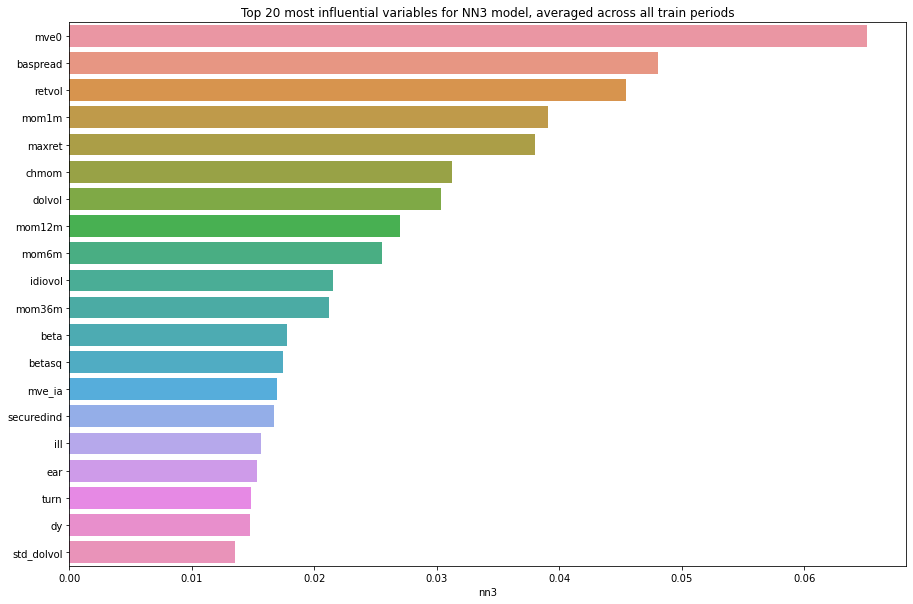

In [418]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [419]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,ridge,lasso,enet,pcr,extra,nn1,nn2,nn3
absacc,0.000334,0.000622,0.000000,0.000000,-0.002456,0.005258,0.006452,0.006821,0.006932
acc,0.001302,0.002116,0.000000,0.000000,-0.007864,0.004883,0.008022,0.007231,0.008036
aeavol,0.000984,0.007019,0.002913,0.003030,0.007646,0.004639,0.003378,0.006386,0.006726
age,0.000160,0.001337,0.000027,0.000045,-0.013675,0.012613,0.006088,0.005980,0.006826
agr,0.000195,0.003044,0.000000,0.000009,0.003117,0.009834,0.006807,0.004415,0.005269
baspread,0.008438,0.002834,0.000000,0.000000,-0.001840,0.026122,0.025246,0.044808,0.048097
beta,0.012467,0.002929,0.000000,0.000000,0.001281,0.021894,0.012936,0.015527,0.017802
betasq,0.010939,0.001710,0.000000,0.000000,-0.003600,0.022942,0.017933,0.015450,0.017404
bm,0.000831,0.017660,0.019649,0.020096,0.025056,0.011733,0.008053,0.011151,0.012707
bm_ia,0.002021,0.006742,0.005609,0.005660,0.016169,0.007191,0.005478,0.006868,0.006718


,lr,ridge,lasso,enet,pcr,extra,nn1,nn2,nn3,all_models
mve0,94.0,94.0,94.0,94.0,77.0,86.0,94.0,94.0,94.0,821.0
mom1m,84.0,93.0,91.0,92.0,94.0,93.0,89.0,91.0,91.0,818.0
retvol,93.0,90.0,87.0,87.0,87.0,89.0,91.0,92.0,92.0,808.0
chmom,88.0,92.0,93.0,93.0,93.0,87.0,81.0,88.0,89.0,804.0
mom6m,89.0,89.0,92.0,91.0,89.0,90.0,83.0,86.0,86.0,795.0
mom12m,77.0,87.0,83.0,83.0,92.0,94.0,87.0,87.0,87.0,777.0
dy,83.0,91.0,90.0,90.0,91.0,92.0,77.0,74.0,76.0,764.0
dolvol,87.0,82.0,80.0,80.0,58.0,77.0,93.0,89.0,88.0,734.0
mom36m,72.0,85.0,84.0,84.0,74.0,88.0,74.0,85.0,84.0,730.0
idiovol,61.0,78.0,81.0,81.0,83.0,91.0,80.0,82.0,85.0,722.0


## NN4

### REIT

In [ ]:
df_results = df_results[:17]

In [420]:
def model_configs():
    # define scope of configs
    n_penalty_type = [l1, l2]
    n_penalty_amount = np.logspace(-5, -3, 5)
    n_learning_rate = [0.001, 0.01]
    # create configs
    configs = []
    for i in n_penalty_type:
        for j in n_penalty_amount:
            for k in n_learning_rate:
                cfg = [i,j,k]
                configs.append(cfg)
    print('Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_penalty_type, n_penalty_amount, n_learning_rate = cfg
    
    # Instantiate a Sequential model
    model = Sequential()
    
    # Add an input layer
    model.add(Dense(32, activation = 'relu', 
                    input_dim = X_train.shape[1], 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an input layer #2
    model.add(Dense(16, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())

    # Add an input layer #3
    model.add(Dense(8, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())

    # Add an input layer #4
    model.add(Dense(4, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an output layer
    model.add(Dense(1, activation = None, 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Set learning rate
    opt = Adam(learning_rate = n_learning_rate)
    
    # Compile model
    model.compile(loss = 'mse',optimizer = opt)

    # Early stop
    early_stop = EarlyStopping(
        monitor = 'loss',
        min_delta = 0,
        patience = 5
    )    
    
    # Convert to np.array before calling model.fit()
    #  to avoid error message "tensorflow:Falling back from v2 loop because 
    #  of error: Failed to find data adapter that can handle input
    X_train = np.asarray(X_train)
    y_train = np.asarray(y_train)    
    
    # Fit model
    model.fit(X_train, y_train,
              epochs = 1000,
              batch_size = 2 ** 13,
              callbacks = [early_stop]
             )
    return model

In [421]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): 20


In [422]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'nn4'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 114us/sample - loss: 110.4857
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.9682
Epoch 3/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.5614
Epoch 4/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.2231
Epoch 5/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.9298
Epoch 6/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.6264
Epoch 7/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.3814
Epoch 8/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.1488
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.9135
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.7271
Epoch 11/1000
21360/21360 [==============================] - 0s 

21360/21360 [==============================] - 0s 3us/sample - loss: 106.2401
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.0960
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9590
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.8080
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7019
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.5284
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.4002
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2641
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.1176
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9522
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8172
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 86.0930
Epoch 203/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.0669
Epoch 204/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.0709
Epoch 205/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.9357
Epoch 206/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.0104
Epoch 207/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.7506
Epoch 208/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.8689
Epoch 209/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.7106
Epoch 210/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.7009
Epoch 211/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.5938
Epoch 212/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.4912
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 85.3352
Epoch 115/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.0615
Epoch 116/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.0877
Epoch 117/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.8951
Epoch 118/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.7186
Epoch 119/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.5482
Epoch 120/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.2616
Epoch 121/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.3212
Epoch 122/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.0458
Epoch 123/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.9307
Epoch 124/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.8178
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 99.6869
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.3174
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.1865
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.0433
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.8045
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.5951
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.4493
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.2094
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.0104
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.7846
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.6407
Epoch 65/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 98.3869
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.1705
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.8790
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.5835
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.3317
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.9963
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.7120
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.5574
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.1879
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.0131
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.6229
Epoch 64/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 71.6004
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3207
Epoch 233/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.0429
Epoch 234/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.1717
Epoch 235/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.8998
Epoch 236/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.1212
Epoch 237/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.8295
Epoch 238/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.7819
Epoch 239/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.8120
Epoch 240/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.4316
Epoch 241/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.5118
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 74.9067
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.7122
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0183
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.2531
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0192
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2993
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.7423
Epoch 69/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.1650
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.6313
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5188
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.0668
Epoch 73/1000

Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.6405
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.5013
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.0495
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.0194
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.2066
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.8346
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.8747
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.0230
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.9112
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.9300
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.17

Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.6175
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.4645
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.2963
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.1458
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.9692
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.8073
Epoch 17/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.6511
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5105
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.3483
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.1720
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - los

21360/21360 [==============================] - 0s 4us/sample - loss: 77.3824
Epoch 190/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.4912
Epoch 191/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.2950
Epoch 192/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.9974
Epoch 193/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.2135
Epoch 194/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.8733
Epoch 195/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.9172
Epoch 196/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.0539
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6480
Epoch 198/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.4370
Epoch 199/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6944
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 93.7631
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.3665
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.0865
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.8533
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.4483
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.2794
Epoch 79/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.8765
Epoch 80/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.7244
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.4021
Epoch 82/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.2389
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.9094
Epoch 84/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 103.9337
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.7430
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.4962
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.2743
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.0314
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.7686
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.4968
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.2502
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.9377
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.5976
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.3500
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 70.9582
Epoch 203/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.4093
Epoch 204/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3372
Epoch 205/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5268
Epoch 206/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.4096
Epoch 207/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5631
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.001] -20.593807239237893 11.264510362874537 31.881804247488297 8.621632345652738
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 106us/sample - loss: 110.2481
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.7460
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.3418
Epoch 4/1000
21360/21360

21360/21360 [==============================] - 0s 3us/sample - loss: 80.0495
Epoch 172/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.7558
Epoch 173/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.5109
Epoch 174/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.1768
Epoch 175/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.3467
Epoch 176/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.8965
Epoch 177/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.9266
Epoch 178/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6264
Epoch 179/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6158
Epoch 180/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6182
Epoch 181/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.1003
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 93.3925
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.1606
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.8767
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.8392
Epoch 89/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.5503
Epoch 90/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.3133
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.1437
Epoch 92/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.0313
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.7268
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6261
Epoch 95/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.4889
Epoch 96/1000

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 104us/sample - loss: 110.9220
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.4420
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.7202
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0768
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.5704
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.0675
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.4765
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.7891
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.1207
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.2899
Epoch 11/1000
21360/21360 [==============================] - 0s 

21360/21360 [==============================] - 0s 3us/sample - loss: 104.5334
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.3344
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.2326
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.9211
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.6821
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.9638
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.2933
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.2206
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.7299
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.5615
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.4160
Epoch 17/100

Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.8094
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5800
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.3994
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.2025
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0061
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.8061
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.6543
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.4892
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.3110
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.1493
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - los

21360/21360 [==============================] - 0s 3us/sample - loss: 74.6529
Epoch 190/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.3074
Epoch 191/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.4932
Epoch 192/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.3068
Epoch 193/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.5391
Epoch 194/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.0590
Epoch 195/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.8375
Epoch 196/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.8065
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7574
Epoch 198/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7562
Epoch 199/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.3824
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 76.8370
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.4925
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.5263
Epoch 133/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.5659
Epoch 134/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.8661
Epoch 135/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.9147
Epoch 136/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.5037
Epoch 137/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.5261
Epoch 138/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.9878
Epoch 139/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.8847
Epoch 140/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.8539
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 91.8065
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.9724
Epoch 87/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.3824
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.1793
Epoch 89/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.0922
Epoch 90/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.6279
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.4653
Epoch 92/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.2397
Epoch 93/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.1773
Epoch 94/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.8348
Epoch 95/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.7335
Epoch 96/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 106.8647
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.6777
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.4930
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.3020
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.1079
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9073
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6939
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.4874
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2892
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.0897
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8564
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 71.3373
Epoch 194/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.2542
Epoch 195/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.3094
Epoch 196/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.0419
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5297
Epoch 198/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.1387
Epoch 199/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 71.2530
Epoch 200/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 70.8434
Epoch 201/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.8537
Epoch 202/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.8292
Epoch 203/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.7396
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 82.3369
Epoch 123/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.3632
Epoch 124/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.0498
Epoch 125/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.7902
Epoch 126/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.8020
Epoch 127/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.5714
Epoch 128/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.3406
Epoch 129/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.0742
Epoch 130/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.9447
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.9458
Epoch 132/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6547
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 71.8576
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.7990
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.9602
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.5766
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.1913
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.2345
Epoch 50/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 67.9667
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.9772
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.3140
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.4586
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.7958
Epoch 55/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 71.7380
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.0746
Epoch 49/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.1123
Epoch 50/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.9965
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.0337
Epoch 52/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.9579
Epoch 53/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.5241
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.9308
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.2976
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.0030
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.7430
Epoch 58/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 95.0459
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.8228
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.5766
Epoch 84/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.4433
Epoch 85/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.1402
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.9670
Epoch 87/1000
21360/21360 [==============================] - 0s 6us/sample - loss: 93.8300
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.6357
Epoch 89/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 93.4187
Epoch 90/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.2679
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.2074
Epoch 92/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 68.2962
Epoch 260/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 67.9915
Epoch 261/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.0833
Epoch 262/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.8024
Epoch 263/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 67.9693
Epoch 264/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 67.6471
Epoch 265/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 67.1382
Epoch 266/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 67.5136
Epoch 267/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 66.9023
Epoch 268/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.1387
Epoch 269/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 66.7117
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 81.5362
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.7052
Epoch 132/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.9903
Epoch 133/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.6624
Epoch 134/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.8526
Epoch 135/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6932
Epoch 136/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.3227
Epoch 137/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.8672
Epoch 138/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.8111
Epoch 139/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.5845
Epoch 140/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.4748
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 92.5853
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.3593
Epoch 87/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.3121
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.0132
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.8062
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6112
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.2402
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.2135
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.9308
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.7672
Epoch 95/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.5378
Epoch 96/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 99.5030
Epoch 51/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.1723
Epoch 52/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.8355
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.5085
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.1806
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.9014
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.4340
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.2367
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.2065
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.5764
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.2496
Epoch 61/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 99.6369
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.2917
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.1708
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.7962
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.6416
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.4453
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.1684
Epoch 63/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.9163
Epoch 64/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.6691
Epoch 65/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4093
Epoch 66/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.3369
Epoch 67/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 65.7428
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.0576
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 64.8833
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 65.0268
Epoch 70/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.6615
Epoch 71/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.2376
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5687
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.5148
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.1342
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.8020
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.7559
Epoch 77/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 71.3786
Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.4786
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.2571
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.5373
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.9513
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.3341
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.5580
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.7932
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.6731
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.3685
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.1787
Epoch 82/1000

21360/21360 [==============================] - 2s 104us/sample - loss: 110.3821
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.9534
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.6749
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.4596
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.2693
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.0957
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.9235
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.8004
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.6346
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.4900
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.3562
Epoch 12

21360/21360 [==============================] - 0s 3us/sample - loss: 73.6457
Epoch 180/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.5296
Epoch 181/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.5030
Epoch 182/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.4792
Epoch 183/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1006
Epoch 184/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.9583
Epoch 185/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1665
Epoch 186/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.7376
Epoch 187/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.6968
Epoch 188/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.8903
Epoch 189/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.4296
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 89.5637
Epoch 114/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.4034
Epoch 115/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.2899
Epoch 116/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.0975
Epoch 117/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.8596
Epoch 118/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.5947
Epoch 119/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.3316
Epoch 120/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.1464
Epoch 121/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.1483
Epoch 122/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.9488
Epoch 123/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.5882
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 65.6529
Epoch 292/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5985
Epoch 293/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5051
Epoch 294/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.4346
Epoch 295/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.6297
Epoch 296/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.7743
Epoch 297/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.4152
Epoch 298/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.6701
Epoch 299/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.1888
Epoch 300/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.8519
Epoch 301/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.9943
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 74.4485
Epoch 155/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.4286
Epoch 156/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.0154
Epoch 157/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.0185
Epoch 158/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.8511
Epoch 159/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.4796
Epoch 160/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.4110
Epoch 161/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.3772
Epoch 162/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.7262
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.9489
Epoch 164/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.8460
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 94.1625
Epoch 101/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.0969
Epoch 102/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.8894
Epoch 103/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.7538
Epoch 104/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.6921
Epoch 105/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.4408
Epoch 106/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.1599
Epoch 107/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.0727
Epoch 108/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.8556
Epoch 109/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.6788
Epoch 110/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.6144
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 66.4096
Epoch 279/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.8773
Epoch 280/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.2962
Epoch 281/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.8269
Epoch 282/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.9219
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.001] -79.38678470208404 13.738680963264922 34.06674993806431 8.482232513061554
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 105us/sample - loss: 110.0162
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.6653
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.3779
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.1781
Epoch 5/1000
21360/21360 [==================

21360/21360 [==============================] - 0s 4us/sample - loss: 90.1969
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.8423
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.7615
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.4490
Epoch 88/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.1222
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.9589
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.8349
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.4531
Epoch 92/1000
21360/21360 [==============================] - 0s 6us/sample - loss: 88.0995
Epoch 93/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.4443
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.6507
Epoch 95/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 69.5163
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.1705
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.2581
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.8157
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.6329
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.6788
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.3517
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.5962
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.1710
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.8199
Epoch 64/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 66.7761
Epoch 65/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 92.3033
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.5751
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.8211
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.8242
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.6626
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.6855
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.9074
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.0121
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.7516
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.3081
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.5149
Epoch 33/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 96.3739
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.0824
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.7730
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.3662
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.9890
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.6438
Epoch 63/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.3757
Epoch 64/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.9198
Epoch 65/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.7632
Epoch 66/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.2985
Epoch 67/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.1150
Epoch 68/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 98.4364
Epoch 51/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.0599
Epoch 52/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.6667
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.1660
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.6959
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.2630
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.8469
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.5441
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.9433
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.5685
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.0068
Epoch 61/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 72.2434
Epoch 229/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.5737
Epoch 230/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.5754
Epoch 231/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.5666
Epoch 232/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.2847
Epoch 233/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.3380
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.001] -84.17397986945916 13.920792248894138 31.351699442488567 8.655114672296712
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 103us/sample - loss: 110.1384
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.5964
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.2434
Epoch 4/1000
21360/21360 [================

21360/21360 [==============================] - 0s 3us/sample - loss: 86.4018
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 86.1809
Epoch 85/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.9667
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.8454
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.1793
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.1204
Epoch 89/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.8060
Epoch 90/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.5292
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.2663
Epoch 92/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.8903
Epoch 93/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.5442
Epoch 94/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 92.1086
Epoch 82/1000
21360/21360 [==============================] - 0s 6us/sample - loss: 92.0762
Epoch 83/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.7532
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6130
Epoch 85/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.5731
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.2369
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.0354
Epoch 88/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.8163
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.7981
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.5825
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.3385
Epoch 92/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 72.4317
Epoch 260/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.0048
Epoch 261/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.1900
Epoch 262/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.9438
Epoch 263/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.8498
Epoch 264/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.0569
Epoch 265/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 71.9436
Epoch 266/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.2054
Epoch 267/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.7020
Epoch 268/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.0289
Epoch 269/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.7156
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 79.9364
Epoch 137/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.7460
Epoch 138/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.7542
Epoch 139/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.4232
Epoch 140/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.2475
Epoch 141/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.9770
Epoch 142/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.7998
Epoch 143/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.5527
Epoch 144/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.4871
Epoch 145/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.2080
Epoch 146/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.0350
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 85.8185
Epoch 24/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.9489
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.4511
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.3197
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 85.0693
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.5892
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.4309
Epoch 30/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.9062
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6258
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.5914
Epoch 33/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.0643
Epoch 34/1000

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 2s 103us/sample - loss: 110.4773
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.2455
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.2514
Epoch 4/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.6116
Epoch 5/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.9176
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9997
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.8806
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.8017
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.3136
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.7921
Epoch 11/1000
21360/21360 [==============================] - 0s 3

21360/21360 [==============================] - 0s 4us/sample - loss: 89.3288
Epoch 98/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.0637
Epoch 99/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.9842
Epoch 100/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.6127
Epoch 101/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3991
Epoch 102/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.2361
Epoch 103/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.0265
Epoch 104/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.7416
Epoch 105/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.6053
Epoch 106/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 87.0958
Epoch 107/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.9984
Epoch

21360/21360 [==============================] - 0s 3us/sample - loss: 107.8686
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5851
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.3276
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0685
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.7824
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.5386
Epoch 18/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.2707
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.0645
Epoch 20/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.8151
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.5595
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.3722
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 103.8840
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.6820
Epoch 29/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.4246
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.1251
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.8917
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.5942
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.2903
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.0294
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.7671
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.4421
Epoch 37/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.2189
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 98.1913
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.9896
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.6893
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4240
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.1776
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.9993
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.6075
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.3710
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.1420
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.9241
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.6072
Epoch 66/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 107.7460
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.4685
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.2225
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.0035
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.7960
Epoch 16/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.5620
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.3727
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.1952
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9781
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.8335
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.6281
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 76.7031
Epoch 190/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.7089
Epoch 191/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.4270
Epoch 192/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.3267
Epoch 193/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.3975
Epoch 194/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.2838
Epoch 195/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.2960
Epoch 196/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.2147
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.1353
Epoch 198/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.3866
Epoch 199/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.3309
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 82.0009
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.9323
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.7966
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.0752
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.9711
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.6313
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.5404
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.1749
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.8501
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.0333
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.4573
Epoch 35/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 78.5921
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.5990
Epoch 33/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.8534
Epoch 34/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.8934
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.6094
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.8636
Epoch 37/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.6061
Epoch 38/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.1679
Epoch 39/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.9329
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 75.4054
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.6959
Epoch 42/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 73.5809
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.8492
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 72.7993
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.3415
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.1846
Epoch 43/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 71.5227
Epoch 44/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.2741
Epoch 45/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.1686
Epoch 46/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.7876
Epoch 47/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.1334
Epoch 48/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.6386
Epoch 49/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 81.6066
Epoch 115/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.5031
Epoch 116/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.0742
Epoch 117/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.3058
Epoch 118/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.1692
Epoch 119/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.6444
Epoch 120/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.8539
Epoch 121/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.5127
Epoch 122/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.2922
Epoch 123/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.1495
Epoch 124/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.0555
Epo

Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.9766
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6776
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.4001
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.1484
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.8415
Epoch 88/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.6593
Epoch 89/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.3551
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.1023
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.0178
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.6050
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 89.4990

21360/21360 [==============================] - 0s 3us/sample - loss: 96.2157
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.8874
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.4438
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.9330
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.5961
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.2415
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.8817
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.3451
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.1319
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.7879
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.3850
Epoch 64/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 99.6970
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.4748
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.2999
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.1253
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.9602
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.7476
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.6380
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.4320
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.3430
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.1921
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.9404
Epoch 67/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 105.2915
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.1473
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.9902
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8444
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.6916
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.5815
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.4007
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.2781
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.1044
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.9785
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.7914
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 83.2555
Epoch 207/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.0539
Epoch 208/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.6169
Epoch 209/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.0378
Epoch 210/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.1974
Epoch 211/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.0249
Epoch 212/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.1665
Epoch 213/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.0572
Epoch 214/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.9515
Epoch 215/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.9473
Epoch 216/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.6273
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 84.4579
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 84.3160
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.6550
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.6226
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.6038
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.6398
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.3939
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.8809
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.4283
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.9414
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.1837
Epoch 38/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 105.9676
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2117
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.3710
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.4722
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.4307
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.2693
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.9658
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.5386
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.3246
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.0467
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.0003
Epoch 15/100

21360/21360 [==============================] - 0s 3us/sample - loss: 107.2173
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0668
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.9137
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.7460
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.5734
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.4417
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.2789
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.1281
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9685
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7910
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6503
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 74.2999
Epoch 197/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.3750
Epoch 198/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.1018
Epoch 199/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 74.1026
Epoch 200/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.9091
Epoch 201/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.5380
Epoch 202/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.7833
Epoch 203/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.5809
Epoch 204/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.1971
Epoch 205/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 73.0012
Epoch 206/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.5010
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 96.8252
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.7085
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.4632
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.3092
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.1767
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.8688
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.8353
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.5264
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.4909
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.1706
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.0457
Epoch 93/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 95.7847
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.4619
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 95.2005
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.8394
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.5597
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.1724
Epoch 64/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.9764
Epoch 65/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.6725
Epoch 66/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.2634
Epoch 67/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.0038
Epoch 68/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.7304
Epoch 69/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 106.8898
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.7553
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.6340
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.4924
Epoch 22/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.3446
Epoch 23/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.2018
Epoch 24/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.0831
Epoch 25/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9235
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7674
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6342
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.4842
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 103.5113
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.2937
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.1046
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.7937
Epoch 36/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.5793
Epoch 37/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.3361
Epoch 38/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 102.0128
Epoch 39/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.7612
Epoch 40/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.5472
Epoch 41/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.1702
Epoch 42/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.8787
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 70.1025
Epoch 211/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.9285
Epoch 212/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.0854
Epoch 213/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.3874
Epoch 214/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.6567
Epoch 215/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.0772
Epoch 216/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.0390
Epoch 217/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 70.0865
Epoch 218/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.5027
Epoch 219/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.4708
Epoch 220/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.9532
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 100.6607
Epoch 12/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 99.1055
Epoch 13/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 97.7936
Epoch 14/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 96.0901
Epoch 15/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 94.7048
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.9137
Epoch 17/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.9285
Epoch 18/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.0966
Epoch 19/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 90.7536
Epoch 20/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.9557
Epoch 21/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 88.2338
Epoch 22/100

21360/21360 [==============================] - 0s 3us/sample - loss: 63.2282
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.0149
Epoch 86/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.9384
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.6918
Epoch 88/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.5365
Epoch 89/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.9225
Epoch 90/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 63.3823
Epoch 91/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.2456
Epoch 92/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.7761
Epoch 93/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 62.0778
Epoch 94/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 61.8188
Epoch 95/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 77.7165
Epoch 160/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.7123
Epoch 161/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.4408
Epoch 162/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.3476
Epoch 163/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.2132
Epoch 164/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.0556
Epoch 165/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1760
Epoch 166/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 77.1200
Epoch 167/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.9471
Epoch 168/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.7608
Epoch 169/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 76.7309
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 79.7457
Epoch 120/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.3223
Epoch 121/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.1459
Epoch 122/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 79.1246
Epoch 123/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.9406
Epoch 124/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.8318
Epoch 125/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.7805
Epoch 126/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.7880
Epoch 127/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6514
Epoch 128/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.6218
Epoch 129/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 78.2414
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 83.0722
Epoch 126/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 83.1382
Epoch 127/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.7675
Epoch 128/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.3512
Epoch 129/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 82.1704
Epoch 130/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.7859
Epoch 131/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 81.3600
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.1590
Epoch 133/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.9497
Epoch 134/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.5018
Epoch 135/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 80.2519
Epo

Epoch 72/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.7986
Epoch 73/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.5282
Epoch 74/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.3211
Epoch 75/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 93.0981
Epoch 76/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.9557
Epoch 77/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.6051
Epoch 78/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.3754
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 92.1383
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.8397
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.6358
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 91.3988

21360/21360 [==============================] - 0s 3us/sample - loss: 106.0628
Epoch 26/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.9105
Epoch 27/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.7258
Epoch 28/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6645
Epoch 29/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.4327
Epoch 30/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.2589
Epoch 31/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.0659
Epoch 32/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.8752
Epoch 33/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.7085
Epoch 34/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.4689
Epoch 35/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.3002
Ep

21360/21360 [==============================] - 0s 3us/sample - loss: 69.3788
Epoch 54/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 69.5192
Epoch 55/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.4493
Epoch 56/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.9428
Epoch 57/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.3956
Epoch 58/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 68.1055
Epoch 59/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 67.0660
Epoch 60/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.5017
Epoch 61/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.3904
Epoch 62/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.7797
Epoch 63/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 66.6959
Epoch 64/1000

21360/21360 [==============================] - 0s 3us/sample - loss: 65.5412
Epoch 79/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.7765
Epoch 80/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.3738
Epoch 81/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.1587
Epoch 82/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 64.7914
Epoch 83/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.0240
Epoch 84/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.8931
Epoch 85/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.5765
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 65.7092
Epoch 87/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 65.4473
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01] -6.624411029727106 10.592004053860865 20.11728701167418 9

21360/21360 [==============================] - 2s 103us/sample - loss: 109.9445
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.0204
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.2369
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.5439
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 105.6945
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.7805
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 103.7648
Epoch 8/1000
21360/21360 [==============================] - 0s 10us/sample - loss: 102.7510
Epoch 9/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 101.3313
Epoch 10/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 100.2477
Epoch 11/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 98.2955
Epoch 12

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -1.64, 10.3, 6.26, 10.1
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -3.16, 10.4, 12.12, 9.8
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -4.45, 10.5, 11.34, 9.8
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -4.66, 10.5, 13.88, 9.7
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01], -5.56, 10.5, 14.17, 9.7
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01], -5.91, 10.6, 14.49, 9.7
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -6.02, 10.6, 15.28, 9.6
[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.01], -6.55, 10.6, 15.90, 9.6
CPU times: user 1h 15min 46s, sys: 32min 46s, total: 1h 48min 33s
Wall time: 24min 37s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -1.64, 10.3, 6.26, 10.1

[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -3.16, 10.4, 12.12, 9.8

[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -4.45, 10.5, 11.34, 9.8

[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -4.66, 10.5, 13.88, 9.7

[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01], -5.56, 10.5, 14.17, 9.7

[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01], -5.91, 10.6, 14.49, 9.7

[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -6.02, 10.6, 15.28, 9.6

[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.01], -6.55, 10.6, 15.90, 9.6

CPU times: user 1h 15min 46s, sys: 32min 46s, total: 1h 48min 33s

Wall time: 24min 37s

In [423]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Train on 31753 samples
Epoch 1/1000
31753/31753 [==============================] - 2s 71us/sample - loss: 108.2732
Epoch 2/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 107.3165
Epoch 3/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 106.9327
Epoch 4/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 106.5041
Epoch 5/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 105.9406
Epoch 6/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 105.3461
Epoch 7/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 104.5883
Epoch 8/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 103.7929
Epoch 9/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 102.7010
Epoch 10/1000
31753/31753 [==============================] - 0s 3us/sample - loss: 101.6683
Epoch 11/1000
31753/31753 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 33962 samples
Epoch 1/1000
33962/33962 [==============================] - 2s 66us/sample - loss: 104.9159
Epoch 2/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 103.7733
Epoch 3/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 103.2451
Epoch 4/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 102.6907
Epoch 5/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 101.8881
Epoch 6/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 101.1495
Epoch 7/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 100.3854
Epoch 8/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 99.4551
Epoch 9/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 98.7285
Epoch 10/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 97.6863
Epoch 11/1000
33962/33962 [==============================] - 0s 3us/

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 35928 samples
Epoch 1/1000
35928/35928 [==============================] - 2s 62us/sample - loss: 106.0884
Epoch 2/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 104.9005
Epoch 3/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 104.3129
Epoch 4/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 103.6194
Epoch 5/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 102.8078
Epoch 6/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 101.8956
Epoch 7/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 100.9753
Epoch 8/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 99.7796
Epoch 9/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 98.4563
Epoch 10/1000
35928/35928 [==============================] - 0s 3us/sample - loss: 96.9153
Epoch 11/1000
35928/35928 [==============================] - 0s 3us/

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 37784 samples
Epoch 1/1000
37784/37784 [==============================] - 2s 62us/sample - loss: 120.8003
Epoch 2/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 118.9291
Epoch 3/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 118.2626
Epoch 4/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 117.6477
Epoch 5/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 116.9773
Epoch 6/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 116.1955
Epoch 7/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 115.2377
Epoch 8/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 114.1031
Epoch 9/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 112.9022
Epoch 10/1000
37784/37784 [==============================] - 0s 3us/sample - loss: 111.7255
Epoch 11/1000
37784/37784 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 39556 samples
Epoch 1/1000
39556/39556 [==============================] - 2s 59us/sample - loss: 144.1980
Epoch 2/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 141.7680
Epoch 3/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 140.9156
Epoch 4/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 140.2433
Epoch 5/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 139.5388
Epoch 6/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 138.7271
Epoch 7/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 137.8787
Epoch 8/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 136.7835
Epoch 9/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 135.8486
Epoch 10/1000
39556/39556 [==============================] - 0s 3us/sample - loss: 134.3443
Epoch 11/1000
39556/39556 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 41396 samples
Epoch 1/1000
41396/41396 [==============================] - 2s 60us/sample - loss: 144.6695
Epoch 2/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 142.3371
Epoch 3/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 141.6791
Epoch 4/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 141.1529
Epoch 5/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 140.5169
Epoch 6/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 139.8646
Epoch 7/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 139.1222
Epoch 8/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 138.3915
Epoch 9/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 137.5818
Epoch 10/1000
41396/41396 [==============================] - 0s 3us/sample - loss: 136.5747
Epoch 11/1000
41396/41396 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 43327 samples
Epoch 1/1000
43327/43327 [==============================] - 2s 54us/sample - loss: 142.0960
Epoch 2/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 140.6962
Epoch 3/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 140.0759
Epoch 4/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 139.2790
Epoch 5/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 138.2960
Epoch 6/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 137.4417
Epoch 7/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 136.0073
Epoch 8/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 134.6255
Epoch 9/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 133.3066
Epoch 10/1000
43327/43327 [==============================] - 0s 3us/sample - loss: 131.4795
Epoch 11/1000
43327/43327 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 45304 samples
Epoch 1/1000
45304/45304 [==============================] - 2s 51us/sample - loss: 139.3865
Epoch 2/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 138.6295
Epoch 3/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 138.0592
Epoch 4/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 137.4203
Epoch 5/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 136.6428
Epoch 6/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 135.6073
Epoch 7/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 134.4613
Epoch 8/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 133.4129
Epoch 9/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 131.8886
Epoch 10/1000
45304/45304 [==============================] - 0s 3us/sample - loss: 130.5658
Epoch 11/1000
45304/45304 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 47453 samples
Epoch 1/1000
47453/47453 [==============================] - 2s 49us/sample - loss: 139.2798
Epoch 2/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 136.0069
Epoch 3/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 134.9889
Epoch 4/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 134.2148
Epoch 5/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 133.4251
Epoch 6/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 132.4942
Epoch 7/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 131.4977
Epoch 8/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 130.4523
Epoch 9/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 129.3110
Epoch 10/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 127.5844
Epoch 11/1000
47453/47453 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 49786 samples
Epoch 1/1000
49786/49786 [==============================] - 2s 46us/sample - loss: 133.8851
Epoch 2/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 131.9927
Epoch 3/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 131.2858
Epoch 4/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 130.6351
Epoch 5/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 130.0555
Epoch 6/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 129.4632
Epoch 7/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 128.7206
Epoch 8/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 127.8946
Epoch 9/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 127.1648
Epoch 10/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 126.2418
Epoch 11/1000
49786/49786 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 52259 samples
Epoch 1/1000
52259/52259 [==============================] - 2s 45us/sample - loss: 129.5243
Epoch 2/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 128.5542
Epoch 3/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 127.9939
Epoch 4/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 127.2911
Epoch 5/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 126.4490
Epoch 6/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 125.4096
Epoch 7/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 124.3562
Epoch 8/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 123.1296
Epoch 9/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 121.7214
Epoch 10/1000
52259/52259 [==============================] - 0s 3us/sample - loss: 120.6800
Epoch 11/1000
52259/52259 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 54667 samples
Epoch 1/1000
54667/54667 [==============================] - 2s 42us/sample - loss: 129.2421
Epoch 2/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 126.4199
Epoch 3/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 125.3926
Epoch 4/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 124.7342
Epoch 5/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 123.9989
Epoch 6/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 123.2254
Epoch 7/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 122.2694
Epoch 8/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 121.3242
Epoch 9/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 120.3621
Epoch 10/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 118.9505
Epoch 11/1000
54667/54667 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 57037 samples
Epoch 1/1000
57037/57037 [==============================] - 2s 40us/sample - loss: 125.4379
Epoch 2/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 122.6672
Epoch 3/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 121.7914
Epoch 4/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 120.9384
Epoch 5/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 120.1294
Epoch 6/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 119.1184
Epoch 7/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 118.1303
Epoch 8/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 116.9446
Epoch 9/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 115.8487
Epoch 10/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 115.2798
Epoch 11/1000
57037/57037 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 59411 samples
Epoch 1/1000
59411/59411 [==============================] - 2s 39us/sample - loss: 122.6660
Epoch 2/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 120.6443
Epoch 3/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 120.0786
Epoch 4/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 119.5383
Epoch 5/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 118.9958
Epoch 6/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 118.2458
Epoch 7/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 117.2220
Epoch 8/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 116.4200
Epoch 9/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 115.1451
Epoch 10/1000
59411/59411 [==============================] - 0s 3us/sample - loss: 113.9083
Epoch 11/1000
59411/59411 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 61718 samples
Epoch 1/1000
61718/61718 [==============================] - 2s 38us/sample - loss: 119.9180
Epoch 2/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 119.0375
Epoch 3/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 118.5197
Epoch 4/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 117.9315
Epoch 5/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 117.2238
Epoch 6/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 116.4935
Epoch 7/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 115.7213
Epoch 8/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 114.9880
Epoch 9/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 114.2455
Epoch 10/1000
61718/61718 [==============================] - 0s 3us/sample - loss: 113.2292
Epoch 11/1000
61718/61718 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -8.90.
RMSE for entire pooled test set, from 2006 to 2020, is 12.7.

On best performing config: [<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01]
CPU times: user 8min 44s, sys: 3min 25s, total: 12min 10s
Wall time: 3min 12s


R2 for entire pooled test set, from 2006 to 2020, is -8.90.

RMSE for entire pooled test set, from 2006 to 2020, is 12.7.

On best performing config: [<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01]

CPU times: user 8min 44s, sys: 3min 25s, total: 12min 10s

Wall time: 3min 12s

### Features of importance

In [424]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'nn4'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

2006 done
2007 done
2008 done
2009 done
2010 done
2011 done
2012 done
2013 done
2014 done
2015 done
2016 done
2017 done
2018 done
2019 done
2020 done
CPU times: user 1h 4min 8s, sys: 7min 23s, total: 1h 11min 31s
Wall time: 41min 23s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,nn4
absacc,3.652834,0.095062,0.393298,1.125604,0.240606,0.121749,0.222267,0.416936,0.290511,0.008796,0.046724,0.346559,1.375232,1.030676,1.342285,0.007222
acc,3.731040,0.140968,0.274168,1.563266,0.302595,0.117349,0.197686,0.141585,0.408760,0.094716,0.072049,0.380800,1.132157,0.952665,0.714685,0.006895
aeavol,2.525809,0.119736,0.262337,0.899777,0.196996,0.029911,0.139190,0.158317,0.702325,0.202052,0.173327,0.760870,1.314058,1.192708,0.884936,0.006449
age,2.608519,0.173679,0.419970,1.059772,-0.000457,0.048357,0.243350,0.609219,0.809678,0.305104,0.163299,0.936899,1.479527,0.716866,1.446888,0.007432
agr,3.133439,0.308663,0.647423,0.630485,0.004550,0.089936,0.107442,0.202204,0.547390,0.060898,0.090821,0.673982,0.968308,0.981364,0.870283,0.006283
baspread,10.574964,1.123559,0.665291,2.075549,0.533684,1.252862,1.949157,2.083208,3.753628,1.562535,1.018497,4.330425,10.413870,9.523930,6.717186,0.038830
beta,7.550272,0.059479,0.422439,2.194589,0.225958,0.322200,0.013737,0.468548,0.640616,0.749984,0.178143,1.068972,2.191177,2.251469,4.267049,0.015244
betasq,4.883144,0.718082,0.492257,5.007387,0.866127,0.239085,0.326845,0.842791,1.351628,0.839344,0.665663,1.303191,5.158109,2.878053,1.971395,0.018575
bm,5.746200,0.296716,0.353904,3.003571,0.153771,0.215115,0.370071,0.347198,0.965300,0.409787,0.185610,1.069988,2.562864,3.283378,2.434463,0.014431
bm_ia,2.396384,0.176718,0.286277,1.956809,0.234932,0.127035,0.256760,0.321604,0.782288,0.324661,0.071828,0.348672,1.492159,1.335596,0.693221,0.007287


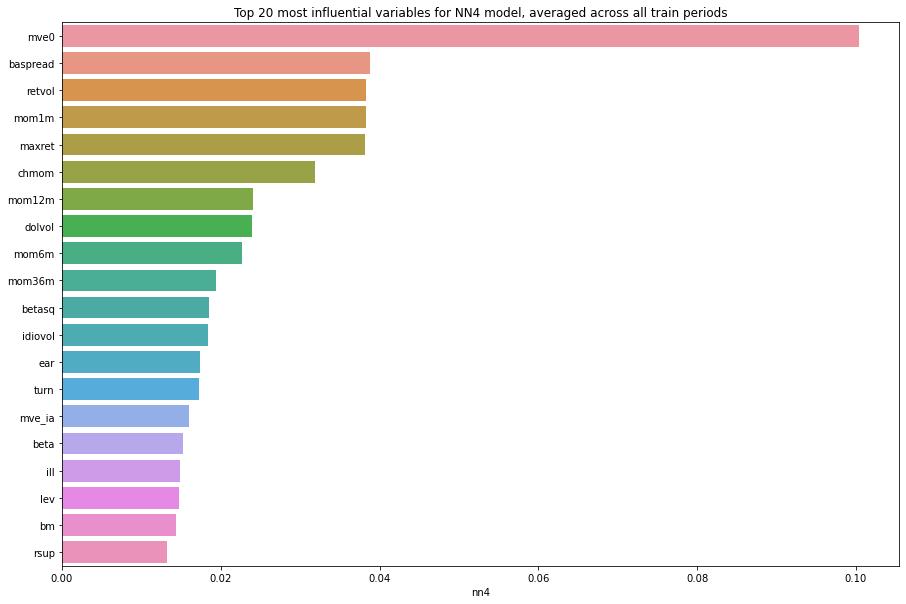

In [425]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [426]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,ridge,lasso,enet,pcr,extra,nn1,nn2,nn3,nn4
absacc,0.000334,0.000622,0.000000,0.000000,-0.002456,0.005258,0.006452,0.006821,0.006932,0.007222
acc,0.001302,0.002116,0.000000,0.000000,-0.007864,0.004883,0.008022,0.007231,0.008036,0.006895
aeavol,0.000984,0.007019,0.002913,0.003030,0.007646,0.004639,0.003378,0.006386,0.006726,0.006449
age,0.000160,0.001337,0.000027,0.000045,-0.013675,0.012613,0.006088,0.005980,0.006826,0.007432
agr,0.000195,0.003044,0.000000,0.000009,0.003117,0.009834,0.006807,0.004415,0.005269,0.006283
baspread,0.008438,0.002834,0.000000,0.000000,-0.001840,0.026122,0.025246,0.044808,0.048097,0.038830
beta,0.012467,0.002929,0.000000,0.000000,0.001281,0.021894,0.012936,0.015527,0.017802,0.015244
betasq,0.010939,0.001710,0.000000,0.000000,-0.003600,0.022942,0.017933,0.015450,0.017404,0.018575
bm,0.000831,0.017660,0.019649,0.020096,0.025056,0.011733,0.008053,0.011151,0.012707,0.014431
bm_ia,0.002021,0.006742,0.005609,0.005660,0.016169,0.007191,0.005478,0.006868,0.006718,0.007287


,lr,ridge,lasso,enet,pcr,extra,nn1,nn2,nn3,nn4,all_models
mve0,94.0,94.0,94.0,94.0,77.0,86.0,94.0,94.0,94.0,94.0,915.0
mom1m,84.0,93.0,91.0,92.0,94.0,93.0,89.0,91.0,91.0,91.0,909.0
retvol,93.0,90.0,87.0,87.0,87.0,89.0,91.0,92.0,92.0,92.0,900.0
chmom,88.0,92.0,93.0,93.0,93.0,87.0,81.0,88.0,89.0,89.0,893.0
mom6m,89.0,89.0,92.0,91.0,89.0,90.0,83.0,86.0,86.0,86.0,881.0
mom12m,77.0,87.0,83.0,83.0,92.0,94.0,87.0,87.0,87.0,88.0,865.0
dy,83.0,91.0,90.0,90.0,91.0,92.0,77.0,74.0,76.0,69.0,833.0
dolvol,87.0,82.0,80.0,80.0,58.0,77.0,93.0,89.0,88.0,87.0,821.0
mom36m,72.0,85.0,84.0,84.0,74.0,88.0,74.0,85.0,84.0,85.0,815.0
idiovol,61.0,78.0,81.0,81.0,83.0,91.0,80.0,82.0,85.0,83.0,805.0


## NN5

### REIT

In [ ]:
df_results = df_results[:18]

In [427]:
def model_configs():
    # define scope of configs
    n_penalty_type = [l1, l2]
    n_penalty_amount = np.logspace(-5, -3, 5)
    n_learning_rate = [0.001, 0.01]
    # create configs
    configs = []
    for i in n_penalty_type:
        for j in n_penalty_amount:
            for k in n_learning_rate:
                cfg = [i,j,k]
                configs.append(cfg)
    print('Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): %d' %len(configs))
    return configs

def model_fit(X_train, y_train, cfg):
    # unpack config
    n_penalty_type, n_penalty_amount, n_learning_rate = cfg
    
    # Instantiate a Sequential model
    model = Sequential()
    
    # Add an input layer
    model.add(Dense(32, activation = 'relu', 
                    input_dim = X_train.shape[1], 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())
    
    # Add an input layer #2
    model.add(Dense(16, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())

    # Add an input layer #3
    model.add(Dense(8, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())

    # Add an input layer #4
    model.add(Dense(4, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())

    # Add an input layer #5
    model.add(Dense(2, activation = 'relu', 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Add batch normalization for the outputs of the layer above
    model.add(BatchNormalization())    
    
    # Add an output layer
    model.add(Dense(1, activation = None, 
                    kernel_regularizer=n_penalty_type(n_penalty_amount))
             )
    
    # Set learning rate
    opt = Adam(learning_rate = n_learning_rate)
    
    # Compile model
    model.compile(loss = 'mse',optimizer = opt)

    early_stop = EarlyStopping(
        monitor = 'loss',
        min_delta = 0,
        patience = 5
    )
    
    # Convert to np.array before calling model.fit()
    #  to avoid error message "tensorflow:Falling back from v2 loop because 
    #  of error: Failed to find data adapter that can handle input
    X_train = np.asarray(X_train)
    y_train = np.asarray(y_train)        
    
    # Fit model
    model.fit(X_train, y_train,
              epochs = 1000,
              batch_size = 2 ** 13,
              callbacks = [early_stop]
             )
    return model

In [428]:
# Instantiate list of configurations
cfg_list = model_configs()

Total configs (n_penalty_type, n_penalty_amount, n_learning_rate): 20


In [429]:
%%time
# Reset train and validate sets
X_train, X_validate, y_train, y_validate = train_validate_split(X_reit, y_reit, 1990, 2005, 5)

# Create new row of test results
model_name = 'nn5'
df_results = pd.concat([
    df_results, 
    pd.DataFrame([{'Model Name' : model_name,}])], 
    axis = 0
)

# Run grid search of hyperparameters
scores = grid_search(X_train, X_validate, y_train, y_validate, cfg_list)
print ('Top 8 Configs')
print ('Config, R2_validate, RMSE_validate, R2_train, RMSE_train')
for cfg, r2_validate, rmse_validate, r2_train, rmse_train, in scores[:8]:
    print (f'{cfg}, {r2_validate:.2f}, {rmse_validate:.1f}, {r2_train:.2f}, {rmse_train:.1f}')

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 3s 135us/sample - loss: 110.1941
Epoch 2/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.6835
Epoch 3/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.3710
Epoch 4/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.0912
Epoch 5/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.8430
Epoch 6/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.6380
Epoch 7/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.4020
Epoch 8/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.1793
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.9864
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.7476
Epoch 11/1000
21360/21360 [==============================] - 0s 

21360/21360 [==============================] - 0s 4us/sample - loss: 110.2751
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.9612
Epoch 8/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.6822
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.3998
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.1747
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.8905
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.6481
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.4297
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.1774
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.9614
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.7114
Epoch

21360/21360 [==============================] - 0s 4us/sample - loss: 76.1176
Epoch 185/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.0503
Epoch 186/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.1688
Epoch 187/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.0275
Epoch 188/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.8166
Epoch 189/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.8477
Epoch 190/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.9773
Epoch 191/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.8739
Epoch 192/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.6260
Epoch 193/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.4407
Epoch 194/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.2628
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 91.0438
Epoch 137/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.3763
Epoch 138/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.1711
Epoch 139/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.0996
Epoch 140/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.0545
Epoch 141/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7915
Epoch 142/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7368
Epoch 143/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.5705
Epoch 144/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.3218
Epoch 145/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.4803
Epoch 146/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.1727
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 100.4025
Epoch 67/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.2160
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.0862
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.9842
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.7996
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.7333
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.5861
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.4976
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.3345
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.2141
Epoch 76/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.0752
Epoch 77/1

21360/21360 [==============================] - 0s 4us/sample - loss: 100.9404
Epoch 48/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.8213
Epoch 49/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.5808
Epoch 50/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.4528
Epoch 51/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.3633
Epoch 52/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.1210
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.9551
Epoch 54/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.8525
Epoch 55/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.6335
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.3806
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.2264
Epoch 5

21360/21360 [==============================] - 0s 4us/sample - loss: 103.7026
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.8504
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.2033
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.4264
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.6703
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.8691
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.2057
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.3643
Epoch 17/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.6709
Epoch 18/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.9026
Epoch 19/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.9886
Epoch 20

21360/21360 [==============================] - 0s 4us/sample - loss: 84.1080
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.9668
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.6891
Epoch 27/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.1140
Epoch 28/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.3181
Epoch 29/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.9868
Epoch 30/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.4874
Epoch 31/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.2772
Epoch 32/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.6682
Epoch 33/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.2544
Epoch 34/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.9064
Epoch 35/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 89.7582
Epoch 40/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0974
Epoch 41/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.8553
Epoch 42/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.4159
Epoch 43/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.9939
Epoch 44/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.3991
Epoch 45/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.9432
Epoch 46/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.7621
Epoch 47/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.2335
Epoch 48/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.8503
Epoch 49/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.3442
Epoch 50/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 87.8164
Epoch 146/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.8246
Epoch 147/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.6830
Epoch 148/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.5383
Epoch 149/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.4869
Epoch 150/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.1348
Epoch 151/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.9839
Epoch 152/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.1733
Epoch 153/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.9044
Epoch 154/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.6913
Epoch 155/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.9053
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 90.7566
Epoch 135/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.4884
Epoch 136/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.3256
Epoch 137/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.4067
Epoch 138/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.1462
Epoch 139/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7809
Epoch 140/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.6143
Epoch 141/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.5795
Epoch 142/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.2593
Epoch 143/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7035
Epoch 144/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0748
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 106.2013
Epoch 23/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.0720
Epoch 24/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.9100
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.7942
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.6459
Epoch 27/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.5494
Epoch 28/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.3730
Epoch 29/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.2216
Epoch 30/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.0706
Epoch 31/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.9371
Epoch 32/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.8166
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 84.3340
Epoch 201/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.9333
Epoch 202/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.1923
Epoch 203/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.9038
Epoch 204/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.4986
Epoch 205/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.4480
Epoch 206/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.7701
Epoch 207/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.1649
Epoch 208/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.1593
Epoch 209/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.0839
Epoch 210/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.1198
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 94.9643
Epoch 124/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.7577
Epoch 125/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.6979
Epoch 126/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.6130
Epoch 127/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.5527
Epoch 128/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.3640
Epoch 129/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.3519
Epoch 130/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.2319
Epoch 131/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.1234
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.2180
Epoch 133/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.0688
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 95.7172
Epoch 92/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.4733
Epoch 93/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.3842
Epoch 94/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.2931
Epoch 95/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.3002
Epoch 96/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.9998
Epoch 97/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.9333
Epoch 98/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.0208
Epoch 99/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.9746
Epoch 100/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.6400
Epoch 101/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.6262
Epoch 102/1

21360/21360 [==============================] - 0s 4us/sample - loss: 80.5070
Epoch 51/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.1916
Epoch 52/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.3082
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.0826
Epoch 54/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.3969
Epoch 55/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.0374
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.4033
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.6341
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.8196
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.1306
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.3620
Epoch 61/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 106.6377
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.2263
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.6798
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.1501
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.7218
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.0337
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.5952
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.8860
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.3613
Epoch 17/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.9453
Epoch 18/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.6039
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 103.3054
Epoch 31/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.0358
Epoch 32/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.7845
Epoch 33/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.5372
Epoch 34/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.3052
Epoch 35/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.0932
Epoch 36/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.8672
Epoch 37/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.5825
Epoch 38/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.2786
Epoch 39/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.9487
Epoch 40/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.7092
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 79.3212
Epoch 209/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.8160
Epoch 210/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.2170
Epoch 211/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.9053
Epoch 212/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.9505
Epoch 213/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.6990
Epoch 214/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.9772
Epoch 215/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.5783
Epoch 216/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.5466
Epoch 217/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.7350
Epoch 218/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.6115
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 89.1363
Epoch 164/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.9639
Epoch 165/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.7453
Epoch 166/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.7738
Epoch 167/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.4496
Epoch 168/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3283
Epoch 169/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3476
Epoch 170/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.0834
Epoch 171/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.1259
Epoch 172/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.7092
Epoch 173/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.7096
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 102.3233
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.2996
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.2232
Epoch 63/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.9157
Epoch 64/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.9130
Epoch 65/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.6747
Epoch 66/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.6365
Epoch 67/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.4890
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.3775
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.2934
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.1870
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 97.6035
Epoch 85/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.3938
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4145
Epoch 87/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.2414
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.1383
Epoch 89/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.0662
Epoch 90/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.9595
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.8635
Epoch 92/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.8802
Epoch 93/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.6996
Epoch 94/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.6222
Epoch 95/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 101.2412
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.0022
Epoch 54/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.9064
Epoch 55/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.7695
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.5467
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.3840
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.2341
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.0511
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.8359
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.7078
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.6547
Epoch

21360/21360 [==============================] - 0s 4us/sample - loss: 95.6339
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.1038
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.9820
Epoch 27/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.1781
Epoch 28/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.4340
Epoch 29/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.9377
Epoch 30/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.5809
Epoch 31/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.8064
Epoch 32/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.4047
Epoch 33/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.1282
Epoch 34/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.0507
Epoch 35/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 80.8286
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.9060
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.6407
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.9998
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.1953
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.3213
Epoch 76/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.3928
Epoch 77/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.7458
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01] -27.985254843543817 11.604589556396634 -0.8193099005914917 10.488896288736566
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 3s 125us/sample - loss: 110.0904
Epoch 2/1000
21360/21360 [==================

21360/21360 [==============================] - 0s 5us/sample - loss: 76.7843
[<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01] -0.3674595892188659 10.276524964691369 9.91107724937591 9.915020762137386

Ensemble results from Model [<function l1 at 0x7feecc18a5f0>, 0.0001, 0.01]: [-15.4561583   10.97909114   7.00109674  10.06949205]
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 3s 123us/sample - loss: 109.6671
Epoch 2/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.4556
Epoch 3/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.3224
Epoch 4/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.2149
Epoch 5/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.1194
Epoch 6/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.0297
Epoch 7/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.9446
Epoch 8

21360/21360 [==============================] - 0s 4us/sample - loss: 84.6957
Epoch 176/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.5231
Epoch 177/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.5577
Epoch 178/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.6713
Epoch 179/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.4702
Epoch 180/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.7206
Epoch 181/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.5927
Epoch 182/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.4824
Epoch 183/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.3920
Epoch 184/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.3932
Epoch 185/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.9856
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 91.4345
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.5497
Epoch 133/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.0876
Epoch 134/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.4472
Epoch 135/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.1016
Epoch 136/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.8490
Epoch 137/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.5667
Epoch 138/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.6436
Epoch 139/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.1323
Epoch 140/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.8816
Epoch 141/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.9109
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 97.2377
Epoch 80/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.1448
Epoch 81/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.8786
Epoch 82/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.7167
Epoch 83/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.4874
Epoch 84/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.4171
Epoch 85/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.0922
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.0638
Epoch 87/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.8106
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.6333
Epoch 89/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.3943
Epoch 90/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 75.2163
Epoch 258/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.1475
Epoch 259/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.9132
Epoch 260/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.9892
Epoch 261/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.6954
Epoch 262/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.9202
Epoch 263/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.2602
Epoch 264/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.0393
[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.001] -50.321948617391456 12.576535299897834 30.33191879107885 8.719164186796228
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 3s 123us/sample - loss: 110.3756
Epoch 2/1000
21360/2136

21360/21360 [==============================] - 0s 4us/sample - loss: 85.7016
Epoch 170/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.4743
Epoch 171/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.8318
Epoch 172/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.3956
Epoch 173/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.4383
Epoch 174/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.9668
Epoch 175/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.8489
Epoch 176/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.1238
Epoch 177/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.0626
Epoch 178/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.8579
Epoch 179/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.6462
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 87.9583
Epoch 134/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.9196
Epoch 135/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.9057
Epoch 136/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.2654
Epoch 137/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3891
Epoch 138/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.1787
Epoch 139/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.6531
Epoch 140/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.1517
[<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.001] -0.32532824572968355 10.274367844989026 7.668271952972727 10.037681539380177

Ensemble results from Model [<function l1 at 0x7feecc18a5f0>, 0.00031622776601683794, 0.001]: [-23.54083269  11.3761477   20.87036468   

21360/21360 [==============================] - 0s 4us/sample - loss: 75.4593
Epoch 67/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.5368
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.4746
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.6041
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.0522
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.5803
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.9157
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.4064
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.1374
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.5997
Epoch 76/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.5606
Epoch 77/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 91.6173
Epoch 41/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.0276
Epoch 42/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.7899
Epoch 43/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.4793
Epoch 44/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.3344
Epoch 45/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.8134
Epoch 46/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.8824
Epoch 47/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.4620
Epoch 48/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.2796
Epoch 49/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.1602
Epoch 50/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0352
Epoch 51/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 97.7375
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4956
Epoch 76/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.3631
Epoch 77/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.1904
Epoch 78/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.9453
Epoch 79/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.8959
Epoch 80/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.6805
Epoch 81/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.4214
Epoch 82/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.2460
Epoch 83/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.1541
Epoch 84/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.9301
Epoch 85/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 102.9737
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.9067
Epoch 54/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.7464
Epoch 55/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.6728
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.5945
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.4976
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.4161
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.3525
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.2690
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.1652
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.1177
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 107.2670
Epoch 36/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.1538
Epoch 37/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.0482
Epoch 38/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.9254
Epoch 39/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.8072
Epoch 40/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.7136
Epoch 41/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.5816
Epoch 42/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.4766
Epoch 43/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.3448
Epoch 44/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.2642
Epoch 45/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.1084
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 82.7688
Epoch 214/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.6864
Epoch 215/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.7265
Epoch 216/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.4945
Epoch 217/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.6947
Epoch 218/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.5089
Epoch 219/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.2527
Epoch 220/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.2504
Epoch 221/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.0031
Epoch 222/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.6811
Epoch 223/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.8283
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 105.0971
Epoch 49/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.9385
Epoch 50/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.8635
Epoch 51/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.6587
Epoch 52/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.5347
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.3657
Epoch 54/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.2021
Epoch 55/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.0718
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.9305
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7805
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7219
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 84.6192
Epoch 227/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.3478
Epoch 228/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.0536
Epoch 229/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 84.0088
Epoch 230/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.7195
Epoch 231/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.8914
Epoch 232/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.7136
Epoch 233/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.7792
Epoch 234/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.4224
Epoch 235/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.3935
Epoch 236/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 83.3397
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 86.5577
Epoch 127/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.6492
Epoch 128/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.2848
Epoch 129/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.4332
Epoch 130/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.9128
Epoch 131/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.8622
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.7774
Epoch 133/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.4246
Epoch 134/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.3774
Epoch 135/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.2488
Epoch 136/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.2355
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 106.4646
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.8280
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.0891
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.4038
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7567
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.9553
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.2576
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 101.5870
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.7131
Epoch 17/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.1654
Epoch 18/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.6206
Epoc

21360/21360 [==============================] - 0s 4us/sample - loss: 73.6843
Epoch 99/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.1008
Epoch 100/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.2692
Epoch 101/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.3379
Epoch 102/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.7430
Epoch 103/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.2820
Epoch 104/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.8068
Epoch 105/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.6744
Epoch 106/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.7140
Epoch 107/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.8271
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01] -7.993714210689573 10.659799956348296 17.34657086

21360/21360 [==============================] - 0s 4us/sample - loss: 77.0020
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.5500
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.7326
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.9319
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.3932
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.5375
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.6848
Epoch 76/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.2550
Epoch 77/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.4499
Epoch 78/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.3696
Epoch 79/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.3464
Epoch 80/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 90.2665
Epoch 129/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.8693
Epoch 130/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7719
Epoch 131/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7249
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.5018
Epoch 133/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.5225
Epoch 134/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.3924
Epoch 135/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.3729
Epoch 136/1000
21360/21360 [==============================] - 0s 6us/sample - loss: 89.1268
Epoch 137/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 89.2334
Epoch 138/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.1176
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 82.0216
Epoch 143/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.0852
Epoch 144/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 82.1702
Epoch 145/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.8362
Epoch 146/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.9089
Epoch 147/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.8948
Epoch 148/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.6627
Epoch 149/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.4346
Epoch 150/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.6615
Epoch 151/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.3031
Epoch 152/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.4376
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 92.1309
Epoch 125/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.9279
Epoch 126/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.7730
Epoch 127/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.6034
Epoch 128/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.5252
Epoch 129/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.4349
Epoch 130/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.2137
Epoch 131/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.1459
Epoch 132/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.9086
Epoch 133/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.9018
Epoch 134/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.7919
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 111.2137
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 110.6643
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 110.2258
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.7738
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.3297
Epoch 7/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.9720
Epoch 8/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.6245
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.3418
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.0788
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.7562
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.5660
Epoch 13/

21360/21360 [==============================] - 0s 4us/sample - loss: 89.4751
Epoch 181/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.2331
Epoch 182/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.2884
Epoch 183/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 89.3970
Epoch 184/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.3239
Epoch 185/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0259
Epoch 186/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.9377
Epoch 187/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0663
Epoch 188/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.7377
Epoch 189/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.8377
Epoch 190/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.5396
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 88.1846
Epoch 145/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3839
Epoch 146/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.0979
Epoch 147/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3931
Epoch 148/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.9853
Epoch 149/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.6794
Epoch 150/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.8025
Epoch 151/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.5022
Epoch 152/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.7541
Epoch 153/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.7312
Epoch 154/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.0179
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 99.9558
Epoch 13/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.9840
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.3349
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4945
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.0546
Epoch 17/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.1031
Epoch 18/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.4763
Epoch 19/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.0443
Epoch 20/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.2387
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.5562
Epoch 22/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.1190
Epoch 23/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 65.0240
Epoch 106/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 64.9856
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01] -11.218342746217624 10.817777020991121 30.327352916287275 8.719449898409223
Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 3s 122us/sample - loss: 112.2642
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.9271
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.0176
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 106.2007
Epoch 5/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.3083
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 104.4948
Epoch 7/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.6820
Epoch 8/1000
21360/21360 [====================

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 3s 122us/sample - loss: 111.0022
Epoch 2/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 110.4722
Epoch 3/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 110.0966
Epoch 4/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.7360
Epoch 5/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.4223
Epoch 6/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.1393
Epoch 7/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.9017
Epoch 8/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.6942
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.4888
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.3602
Epoch 11/1000
21360/21360 [==============================] - 0s 

21360/21360 [==============================] - 0s 4us/sample - loss: 96.7091
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.6142
Epoch 92/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.3529
Epoch 93/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.5437
Epoch 94/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.1161
Epoch 95/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.0314
Epoch 96/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.8892
Epoch 97/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.9508
Epoch 98/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.6353
Epoch 99/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.5963
Epoch 100/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.5523
Epoch 101/10

21360/21360 [==============================] - 0s 4us/sample - loss: 94.8099
Epoch 66/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.5820
Epoch 67/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.4638
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.2499
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.0895
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.7865
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.7676
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.3931
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.2634
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.9799
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.8802
Epoch 76/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 106.2760
Epoch 24/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.1248
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.9471
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.7520
Epoch 27/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.6248
Epoch 28/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.4511
Epoch 29/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.3159
Epoch 30/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.1539
Epoch 31/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.0186
Epoch 32/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.8353
Epoch 33/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.6684
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 81.2903
Epoch 202/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.3344
Epoch 203/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.9567
Epoch 204/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.9130
Epoch 205/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.3396
Epoch 206/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.4817
Epoch 207/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.5090
Epoch 208/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.9508
Epoch 209/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.9261
Epoch 210/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.7234
Epoch 211/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.2130
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 93.7495
Epoch 80/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.4252
Epoch 81/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.2042
Epoch 82/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.2586
Epoch 83/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.8667
Epoch 84/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.6517
Epoch 85/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.4130
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.3588
Epoch 87/1000
21360/21360 [==============================] - 0s 6us/sample - loss: 92.0341
Epoch 88/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.8010
Epoch 89/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.7248
Epoch 90/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 103.7881
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7258
Epoch 63/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.6271
Epoch 64/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.5980
Epoch 65/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.4542
Epoch 66/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.3249
Epoch 67/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.2367
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.1516
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.0881
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.9493
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.8602
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 95.8507
Epoch 151/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.7348
Epoch 152/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.7732
Epoch 153/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.6842
Epoch 154/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.4799
Epoch 155/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.5326
Epoch 156/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.4203
Epoch 157/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.4040
Epoch 158/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.4960
Epoch 159/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.2023
Epoch 160/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.1938
Epo

Train on 21360 samples
Epoch 1/1000
21360/21360 [==============================] - 3s 120us/sample - loss: 112.0887
Epoch 2/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.2017
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.0849
Epoch 4/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.8298
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.5510
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 107.1462
Epoch 7/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.6958
Epoch 8/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.1507
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.6779
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.0905
Epoch 11/1000
21360/21360 [==============================] - 0s 

21360/21360 [==============================] - 0s 4us/sample - loss: 100.5748
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.6999
Epoch 17/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.3486
Epoch 18/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.3132
Epoch 19/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4655
Epoch 20/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.9277
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.4252
Epoch 22/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.3146
Epoch 23/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.0666
Epoch 24/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.5077
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.2968
Epoch 26/100

21360/21360 [==============================] - 0s 4us/sample - loss: 104.4995
Epoch 35/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.2919
Epoch 36/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.1240
Epoch 37/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.8844
Epoch 38/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7283
Epoch 39/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.4871
Epoch 40/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.2909
Epoch 41/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.1477
Epoch 42/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.8747
Epoch 43/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.6463
Epoch 44/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 102.4533
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 81.0263
Epoch 213/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.0889
Epoch 214/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.0343
Epoch 215/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.8114
Epoch 216/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.9672
Epoch 217/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.0260
Epoch 218/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.9918
Epoch 219/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.9091
Epoch 220/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.6796
Epoch 221/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.7407
Epoch 222/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.6260
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 89.3406
Epoch 134/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0734
Epoch 135/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.9319
Epoch 136/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.1280
Epoch 137/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.2601
Epoch 138/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.7772
Epoch 139/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0812
Epoch 140/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.8884
Epoch 141/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.5697
Epoch 142/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.6250
Epoch 143/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.6045
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 91.8068
Epoch 114/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.6878
Epoch 115/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 91.7108
Epoch 116/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.3810
Epoch 117/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.4860
Epoch 118/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.3179
Epoch 119/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.3497
Epoch 120/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.1754
Epoch 121/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.1362
Epoch 122/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.0678
Epoch 123/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.9469
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 89.2678
Epoch 149/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.4824
Epoch 150/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.1506
Epoch 151/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.3500
Epoch 152/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.9073
Epoch 153/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0415
Epoch 154/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.6302
Epoch 155/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.5345
Epoch 156/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.6681
Epoch 157/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.5829
Epoch 158/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.4217
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 98.3458
Epoch 97/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.3429
Epoch 98/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.1885
Epoch 99/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.0451
Epoch 100/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.9947
Epoch 101/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.7878
Epoch 102/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.7604
Epoch 103/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.6195
Epoch 104/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4846
Epoch 105/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4778
Epoch 106/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.4797
Epoch 

21360/21360 [==============================] - 0s 4us/sample - loss: 94.5947
Epoch 19/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.8327
Epoch 20/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.7267
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.5121
Epoch 22/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.9238
Epoch 23/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.7071
Epoch 24/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 90.8548
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 91.7866
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.9500
Epoch 27/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.8040
Epoch 28/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.6047
Epoch 29/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 78.7224
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.5243
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.7297
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.9999
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.1135
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.8100
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.4628
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.9255
Epoch 63/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.4394
Epoch 64/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.3867
Epoch 65/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.2140
Epoch 66/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 104.4417
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.3780
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.3070
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.2574
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.1046
Epoch 76/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.0307
Epoch 77/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.9536
Epoch 78/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.9022
Epoch 79/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7889
Epoch 80/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7650
Epoch 81/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.6869
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 104.7909
Epoch 36/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.6547
Epoch 37/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.5320
Epoch 38/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.3874
Epoch 39/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.3062
Epoch 40/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.1608
Epoch 41/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.0373
Epoch 42/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.9421
Epoch 43/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.7864
Epoch 44/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.6618
Epoch 45/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.5378
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 89.1086
Epoch 214/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.1000
Epoch 215/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0134
Epoch 216/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.0655
Epoch 217/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.8219
Epoch 218/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.7977
Epoch 219/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.6281
Epoch 220/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.5160
Epoch 221/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3881
Epoch 222/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.2392
Epoch 223/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.1234
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 100.5209
Epoch 77/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.4269
Epoch 78/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.2125
Epoch 79/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.2809
Epoch 80/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.1317
Epoch 81/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.0597
Epoch 82/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.9527
Epoch 83/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.8903
Epoch 84/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.6970
Epoch 85/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.6741
Epoch 86/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.5494
Epoch 8

21360/21360 [==============================] - 0s 4us/sample - loss: 105.2355
Epoch 27/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.0609
Epoch 28/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.8441
Epoch 29/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.6859
Epoch 30/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.4850
Epoch 31/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.2384
Epoch 32/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 104.0403
Epoch 33/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.8337
Epoch 34/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.6194
Epoch 35/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.4166
Epoch 36/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 103.2005
Ep

21360/21360 [==============================] - 3s 119us/sample - loss: 109.9540
Epoch 2/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.5638
Epoch 3/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 109.2443
Epoch 4/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.9887
Epoch 5/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.7137
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.4690
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.2553
Epoch 8/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.0844
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.8937
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.7124
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.5458
Epoch 12

21360/21360 [==============================] - 0s 4us/sample - loss: 85.7491
Epoch 180/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.3871
Epoch 181/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.2064
Epoch 182/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.3724
Epoch 183/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.2867
Epoch 184/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.3090
Epoch 185/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.6236
Epoch 186/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.2592
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.001] -12.588933471303122 10.88422894220482 19.7114066295369 9.36019412165318

Ensemble results from Model [<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.001]: [-21.06884128  11.2668714   19.14848399   9.388

21360/21360 [==============================] - 0s 4us/sample - loss: 89.0500
Epoch 38/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.3611
Epoch 39/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.1093
Epoch 40/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.1856
Epoch 41/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.8195
Epoch 42/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.0734
Epoch 43/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.0482
Epoch 44/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 88.1762
Epoch 45/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 87.0301
Epoch 46/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.6489
Epoch 47/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 86.5901
Epoch 48/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 75.9009
Epoch 67/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.7920
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.4793
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.1900
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 75.1921
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.6421
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 74.0367
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.7966
Epoch 74/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 73.7056
Epoch 75/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.7122
Epoch 76/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 72.7176
Epoch 77/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 94.2669
Epoch 159/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.5409
Epoch 160/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.2686
Epoch 161/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.2581
Epoch 162/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 94.0380
Epoch 163/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.9326
Epoch 164/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.8769
Epoch 165/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.9011
Epoch 166/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.7849
Epoch 167/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.8539
Epoch 168/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.7527
Epo

21360/21360 [==============================] - 0s 3us/sample - loss: 109.2790
Epoch 3/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 109.0834
Epoch 4/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.9453
Epoch 5/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.8083
Epoch 6/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.6779
Epoch 7/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.5658
Epoch 8/1000
21360/21360 [==============================] - 0s 3us/sample - loss: 108.4370
Epoch 9/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.3329
Epoch 10/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.2308
Epoch 11/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 108.1099
Epoch 12/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 107.9918
Epoch 13/

21360/21360 [==============================] - 0s 4us/sample - loss: 89.9451
Epoch 181/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7211
Epoch 182/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.6903
Epoch 183/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.5824
Epoch 184/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.7087
Epoch 185/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.4555
Epoch 186/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.3364
Epoch 187/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.4345
Epoch 188/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.3277
Epoch 189/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.1605
Epoch 190/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 89.2593
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 93.2847
Epoch 91/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.1751
Epoch 92/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.2026
Epoch 93/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 93.0976
Epoch 94/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.7875
Epoch 95/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.7021
Epoch 96/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.4725
Epoch 97/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.3858
Epoch 98/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.3783
Epoch 99/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.1650
Epoch 100/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 92.2504
Epoch 101/10

21360/21360 [==============================] - 0s 4us/sample - loss: 99.5932
Epoch 64/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.4243
Epoch 65/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.3291
Epoch 66/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.1217
Epoch 67/1000
21360/21360 [==============================] - 0s 5us/sample - loss: 98.9486
Epoch 68/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.8897
Epoch 69/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.6372
Epoch 70/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.5163
Epoch 71/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.3131
Epoch 72/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.1167
Epoch 73/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.0430
Epoch 74/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 107.1156
Epoch 20/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.9880
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.8900
Epoch 22/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.7645
Epoch 23/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.6574
Epoch 24/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.5260
Epoch 25/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.4158
Epoch 26/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.3057
Epoch 27/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.1906
Epoch 28/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 106.0673
Epoch 29/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 105.9499
Ep

21360/21360 [==============================] - 0s 4us/sample - loss: 86.0952
Epoch 198/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.9525
Epoch 199/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.9372
Epoch 200/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.9083
Epoch 201/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.6155
Epoch 202/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.6497
Epoch 203/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.4612
Epoch 204/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.5282
Epoch 205/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.1188
Epoch 206/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.0775
Epoch 207/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 85.0162
Epo

21360/21360 [==============================] - 0s 4us/sample - loss: 81.3673
Epoch 53/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.6848
Epoch 54/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 80.1662
Epoch 55/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 81.0814
Epoch 56/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 79.3154
Epoch 57/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.9422
Epoch 58/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 78.2023
Epoch 59/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 77.8506
Epoch 60/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.9728
Epoch 61/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.1306
Epoch 62/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 76.8293
Epoch 63/1000

21360/21360 [==============================] - 0s 4us/sample - loss: 101.6586
Epoch 14/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 100.6374
Epoch 15/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.9180
Epoch 16/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 99.0820
Epoch 17/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.5770
Epoch 18/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.4991
Epoch 19/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 98.1416
Epoch 20/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.9160
Epoch 21/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 97.0668
Epoch 22/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 96.0817
Epoch 23/1000
21360/21360 [==============================] - 0s 4us/sample - loss: 95.4051
Epoch 24/10

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Top 8 Configs
Config, R2_validate, RMSE_validate, R2_train, RMSE_train
[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -1.15, 10.3, 4.49, 10.2
[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -2.37, 10.4, 12.02, 9.8
[<function l2 at 0x7feecc1a7f80>, 3.1622776601683795e-05, 0.01], -4.57, 10.5, 13.63, 9.7
[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -5.13, 10.5, 9.09, 10.0
[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -5.83, 10.5, 9.32, 9.9
[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -6.75, 10.6, 16.28, 9.5
[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01], -10.32, 10.8, 8.80, 10.0
[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.01], -11.33, 10.8, 9.99, 9.9
CPU times: user 1h 23min 45s, sys: 38min 19s, total: 2h 2min 4s
Wall time: 28min 28s


Top 8 Configs

Config, R2_validate, RMSE_validate, R2_train, RMSE_train

[<function l2 at 0x7feecc1a7f80>, 0.001, 0.01], -1.15, 10.3, 4.49, 10.2

[<function l1 at 0x7feecc18a5f0>, 3.1622776601683795e-05, 0.01], -2.37, 10.4, 12.02, 9.8

[<function l2 at 0x7feecc1a7f80>, 3.1622776601683795e-05, 0.01], -4.57, 10.5, 13.63, 9.7

[<function l2 at 0x7feecc1a7f80>, 0.0001, 0.01], -5.13, 10.5, 9.09, 10.0

[<function l2 at 0x7feecc1a7f80>, 0.00031622776601683794, 0.01], -5.83, 10.5, 9.32, 9.9

[<function l2 at 0x7feecc1a7f80>, 1e-05, 0.01], -6.75, 10.6, 16.28, 9.5

[<function l1 at 0x7feecc18a5f0>, 0.001, 0.01], -10.32, 10.8, 8.80, 10.0

[<function l1 at 0x7feecc18a5f0>, 1e-05, 0.01], -11.33, 10.8, 9.99, 9.9

CPU times: user 1h 23min 45s, sys: 38min 19s, total: 2h 2min 4s

Wall time: 28min 28s

In [430]:
%%time
# Chosen configuration for model
selected_cfg = scores[0][0]

# Out-of-sample testing
score = walk_forward(
    selected_cfg, 
    X_reit, y_reit, 
    start_year = 1990, 
    end_year = 2020, 
    years_to_test = 15, 
    refit_frequency = 1)

print(f'On best performing config: {scores[0][0]}')

# Save df_results to .csv 
df_results.to_csv('../data/df_results.csv', index = False)

Train on 31753 samples
Epoch 1/1000
31753/31753 [==============================] - 3s 92us/sample - loss: 108.2979
Epoch 2/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 106.9318
Epoch 3/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 106.2962
Epoch 4/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 105.5820
Epoch 5/1000
31753/31753 [==============================] - 0s 6us/sample - loss: 104.6856
Epoch 6/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 103.9210
Epoch 7/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 103.0914
Epoch 8/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 101.9880
Epoch 9/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 101.5200
Epoch 10/1000
31753/31753 [==============================] - 0s 4us/sample - loss: 100.0225
Epoch 11/1000
31753/31753 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 33962 samples
Epoch 1/1000
33962/33962 [==============================] - 3s 77us/sample - loss: 107.0066
Epoch 2/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 104.8209
Epoch 3/1000
33962/33962 [==============================] - 0s 3us/sample - loss: 103.5657
Epoch 4/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 102.8006
Epoch 5/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 102.2600
Epoch 6/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 101.7260
Epoch 7/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 101.3642
Epoch 8/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 100.9828
Epoch 9/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 100.7281
Epoch 10/1000
33962/33962 [==============================] - 0s 4us/sample - loss: 100.1059
Epoch 11/1000
33962/33962 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 35928 samples
Epoch 1/1000
35928/35928 [==============================] - 3s 78us/sample - loss: 105.8709
Epoch 2/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 105.5863
Epoch 3/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 105.2372
Epoch 4/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 104.8445
Epoch 5/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 104.2624
Epoch 6/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 103.5791
Epoch 7/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 102.7009
Epoch 8/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 101.8869
Epoch 9/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 100.9417
Epoch 10/1000
35928/35928 [==============================] - 0s 4us/sample - loss: 99.9344
Epoch 11/1000
35928/35928 [==============================] - 0s 4u

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 37784 samples
Epoch 1/1000
37784/37784 [==============================] - 3s 77us/sample - loss: 120.4519
Epoch 2/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 119.0529
Epoch 3/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 118.4545
Epoch 4/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 117.8817
Epoch 5/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 117.1169
Epoch 6/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 116.3646
Epoch 7/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 115.4823
Epoch 8/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 114.5441
Epoch 9/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 113.5970
Epoch 10/1000
37784/37784 [==============================] - 0s 4us/sample - loss: 112.4708
Epoch 11/1000
37784/37784 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 39556 samples
Epoch 1/1000
39556/39556 [==============================] - 3s 73us/sample - loss: 143.0023
Epoch 2/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 142.2803
Epoch 3/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 141.7573
Epoch 4/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 141.0432
Epoch 5/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 140.2639
Epoch 6/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 139.2967
Epoch 7/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 138.1465
Epoch 8/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 137.0570
Epoch 9/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 135.7674
Epoch 10/1000
39556/39556 [==============================] - 0s 4us/sample - loss: 134.1164
Epoch 11/1000
39556/39556 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 41396 samples
Epoch 1/1000
41396/41396 [==============================] - 3s 68us/sample - loss: 145.5623
Epoch 2/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 143.4079
Epoch 3/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 142.7554
Epoch 4/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 142.5198
Epoch 5/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 142.2790
Epoch 6/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 142.1251
Epoch 7/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 142.0041
Epoch 8/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 141.7360
Epoch 9/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 141.5028
Epoch 10/1000
41396/41396 [==============================] - 0s 4us/sample - loss: 141.2762
Epoch 11/1000
41396/41396 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 43327 samples
Epoch 1/1000
43327/43327 [==============================] - 3s 66us/sample - loss: 141.7790
Epoch 2/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 141.3802
Epoch 3/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 140.9924
Epoch 4/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 140.5158
Epoch 5/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 139.6778
Epoch 6/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 138.9300
Epoch 7/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 138.1763
Epoch 8/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 137.7736
Epoch 9/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 137.1156
Epoch 10/1000
43327/43327 [==============================] - 0s 4us/sample - loss: 136.0875
Epoch 11/1000
43327/43327 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 45304 samples
Epoch 1/1000
45304/45304 [==============================] - 3s 65us/sample - loss: 140.4102
Epoch 2/1000
45304/45304 [==============================] - 0s 4us/sample - loss: 138.6505
Epoch 3/1000
45304/45304 [==============================] - 0s 4us/sample - loss: 137.9307
Epoch 4/1000
45304/45304 [==============================] - 0s 5us/sample - loss: 137.4229
Epoch 5/1000
45304/45304 [==============================] - 0s 5us/sample - loss: 136.8328
Epoch 6/1000
45304/45304 [==============================] - 0s 5us/sample - loss: 136.2945
Epoch 7/1000
45304/45304 [==============================] - 0s 5us/sample - loss: 135.6242
Epoch 8/1000
45304/45304 [==============================] - 0s 4us/sample - loss: 134.9126
Epoch 9/1000
45304/45304 [==============================] - 0s 4us/sample - loss: 134.1812
Epoch 10/1000
45304/45304 [==============================] - 0s 4us/sample - loss: 133.4076
Epoch 11/1000
45304/45304 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 47453 samples
Epoch 1/1000
47453/47453 [==============================] - 3s 62us/sample - loss: 137.2388
Epoch 2/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 136.2921
Epoch 3/1000
47453/47453 [==============================] - 0s 3us/sample - loss: 135.7759
Epoch 4/1000
47453/47453 [==============================] - 0s 4us/sample - loss: 135.2523
Epoch 5/1000
47453/47453 [==============================] - 0s 4us/sample - loss: 134.6237
Epoch 6/1000
47453/47453 [==============================] - 0s 6us/sample - loss: 134.0346
Epoch 7/1000
47453/47453 [==============================] - 0s 4us/sample - loss: 133.3973
Epoch 8/1000
47453/47453 [==============================] - 0s 4us/sample - loss: 132.7986
Epoch 9/1000
47453/47453 [==============================] - 0s 4us/sample - loss: 132.1155
Epoch 10/1000
47453/47453 [==============================] - 0s 5us/sample - loss: 131.4467
Epoch 11/1000
47453/47453 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 49786 samples
Epoch 1/1000
49786/49786 [==============================] - 3s 54us/sample - loss: 133.6230
Epoch 2/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 132.3933
Epoch 3/1000
49786/49786 [==============================] - 0s 3us/sample - loss: 131.9164
Epoch 4/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 131.5119
Epoch 5/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 130.8118
Epoch 6/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 130.1946
Epoch 7/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 129.6105
Epoch 8/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 128.8444
Epoch 9/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 127.9322
Epoch 10/1000
49786/49786 [==============================] - 0s 4us/sample - loss: 127.0290
Epoch 11/1000
49786/49786 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 52259 samples
Epoch 1/1000
52259/52259 [==============================] - 3s 54us/sample - loss: 129.8459
Epoch 2/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 128.5334
Epoch 3/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 128.0564
Epoch 4/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 127.5561
Epoch 5/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 126.8790
Epoch 6/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 126.0850
Epoch 7/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 125.5386
Epoch 8/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 124.8781
Epoch 9/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 123.9314
Epoch 10/1000
52259/52259 [==============================] - 0s 4us/sample - loss: 123.4052
Epoch 11/1000
52259/52259 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 54667 samples
Epoch 1/1000
54667/54667 [==============================] - 3s 49us/sample - loss: 127.7694
Epoch 2/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 126.6994
Epoch 3/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 126.1421
Epoch 4/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 125.5921
Epoch 5/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 124.8650
Epoch 6/1000
54667/54667 [==============================] - 0s 3us/sample - loss: 124.1869
Epoch 7/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 123.4205
Epoch 8/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 122.5932
Epoch 9/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 121.8946
Epoch 10/1000
54667/54667 [==============================] - 0s 4us/sample - loss: 121.4496
Epoch 11/1000
54667/54667 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 57037 samples
Epoch 1/1000
57037/57037 [==============================] - 3s 47us/sample - loss: 125.1921
Epoch 2/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 123.6370
Epoch 3/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 123.0740
Epoch 4/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 122.6972
Epoch 5/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 122.2671
Epoch 6/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 121.6548
Epoch 7/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 121.1525
Epoch 8/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 120.7459
Epoch 9/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 120.1757
Epoch 10/1000
57037/57037 [==============================] - 0s 3us/sample - loss: 119.6902
Epoch 11/1000
57037/57037 [==============================] - 0s 3

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 59411 samples
Epoch 1/1000
59411/59411 [==============================] - 3s 47us/sample - loss: 121.7781
Epoch 2/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 121.3603
Epoch 3/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 120.9810
Epoch 4/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 120.3867
Epoch 5/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 119.6006
Epoch 6/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 118.6914
Epoch 7/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 117.6873
Epoch 8/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 116.5897
Epoch 9/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 115.6144
Epoch 10/1000
59411/59411 [==============================] - 0s 4us/sample - loss: 115.2255
Epoch 11/1000
59411/59411 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


Train on 61718 samples
Epoch 1/1000
61718/61718 [==============================] - 3s 47us/sample - loss: 119.8364
Epoch 2/1000
61718/61718 [==============================] - 0s 4us/sample - loss: 119.3268
Epoch 3/1000
61718/61718 [==============================] - 0s 5us/sample - loss: 118.9563
Epoch 4/1000
61718/61718 [==============================] - 0s 5us/sample - loss: 118.4432
Epoch 5/1000
61718/61718 [==============================] - 0s 5us/sample - loss: 117.8026
Epoch 6/1000
61718/61718 [==============================] - 0s 4us/sample - loss: 117.1389
Epoch 7/1000
61718/61718 [==============================] - 0s 4us/sample - loss: 116.6478
Epoch 8/1000
61718/61718 [==============================] - 0s 4us/sample - loss: 116.3281
Epoch 9/1000
61718/61718 [==============================] - 0s 4us/sample - loss: 116.2236
Epoch 10/1000
61718/61718 [==============================] - 0s 4us/sample - loss: 115.8683
Epoch 11/1000
61718/61718 [==============================] - 0s 4

,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN


,Model Name,Selected Config,Train (1990-2000),Validate (2001-2005),Test (2006-2020),Test (2006),Test (2007),Test (2008),Test (2009),Test (2010),Test (2011),Test (2012),Test (2013),Test (2014),Test (2015),Test (2016),Test (2017),Test (2018),Test (2019),Test (2020),Remarks
0,lr,N.A.,1.99 (10.3),0.69 (10.2),-0.03 (12.1),4.17 (7.4),-3.50 (11.5),-0.55 (19.9),-0.02 (25.2),1.79 (12.4),-2.03 (10.2),3.18 (9.3),1.38 (9.4),1.59 (7.0),-2.95 (7.6),2.22 (9.0),-1.00 (7.1),-5.43 (8.2),3.70 (8.2),-0.21 (18.4),NaN
1,fama-french,"bm, mve0",0.36 (10.4),1.52 (10.2),0.17 (12.1),3.84 (7.5),-4.46 (11.5),-1.84 (20.0),0.64 (25.1),2.03 (12.3),-0.68 (10.1),3.28 (9.3),1.25 (9.4),3.36 (6.9),-1.87 (7.5),2.06 (9.0),1.06 (7.0),-2.57 (8.1),3.50 (8.2),-0.05 (18.4),NaN
2,carhart,"bm, mve0, mom12m",0.52 (10.4),1.68 (10.2),0.16 (12.1),4.37 (7.4),-3.46 (11.5),-1.33 (19.9),0.15 (25.2),2.04 (12.3),-0.71 (10.1),2.65 (9.3),1.65 (9.4),3.06 (6.9),-1.88 (7.5),1.71 (9.0),0.85 (7.1),-2.06 (8.1),3.34 (8.2),-0.13 (18.4),NaN
3,huber,"[3.0, 0.1]",1.58 (10.4),0.91 (10.2),-0.07 (12.1),3.50 (7.5),-2.04 (11.4),-0.24 (19.8),-0.24 (25.2),0.25 (12.5),-0.65 (10.1),1.10 (9.4),0.70 (9.4),2.17 (7.0),-2.61 (7.6),1.41 (9.0),-0.62 (7.1),-2.98 (8.2),2.99 (8.2),-0.31 (18.4),NaN
4,ridge,[19920.457084538...,1.19 (10.4),1.82 (10.2),0.18 (12.1),4.43 (7.4),-3.65 (11.5),-1.12 (19.9),0.16 (25.2),1.98 (12.3),-1.29 (10.1),3.80 (9.3),1.91 (9.3),2.74 (6.9),-1.82 (7.5),2.31 (9.0),0.49 (7.1),-4.39 (8.2),4.05 (8.2),-0.13 (18.4),NaN
5,lasso,[0.0719685673001...,1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.42 (9.3),1.89 (9.3),3.51 (6.9),-1.64 (7.5),1.70 (9.0),0.50 (7.1),-4.16 (8.2),4.21 (8.2),-0.07 (18.4),NaN
6,enet,"[0.9, 0.07880462...",1.28 (10.4),1.93 (10.2),0.23 (12.1),4.37 (7.4),-3.54 (11.5),-1.09 (19.9),0.26 (25.2),2.08 (12.3),-1.03 (10.1),3.43 (9.3),1.90 (9.3),3.52 (6.9),-1.63 (7.5),1.71 (9.0),0.52 (7.1),-4.17 (8.2),4.20 (8.2),-0.07 (18.4),NaN
7,pcr,25,0.92 (10.4),1.85 (10.2),0.08 (12.1),3.74 (7.5),-3.98 (11.5),-1.22 (19.9),0.20 (25.2),2.05 (12.3),-1.10 (10.1),3.43 (9.3),1.63 (9.4),2.83 (6.9),-1.99 (7.5),1.85 (9.0),-0.09 (7.1),-4.05 (8.2),4.02 (8.2),-0.18 (18.4),NaN
8,pls,1,1.03 (10.4),1.71 (10.2),-0.06 (12.1),4.19 (7.4),-4.17 (11.5),-1.10 (19.9),-0.15 (25.2),1.75 (12.4),-1.84 (10.2),3.68 (9.3),1.99 (9.3),2.32 (7.0),-2.06 (7.6),2.14 (9.0),0.18 (7.1),-4.79 (8.2),3.94 (8.2),-0.42 (18.5),NaN
0,rf,"[300, 0.2, 10, 70]",13.97 (9.7),2.31 (10.1),-0.75 (12.2),4.65 (7.4),-11.55 (11.9),0.56 (19.8),0.03 (25.2),3.62 (12.2),-2.18 (10.2),1.80 (9.4),1.17 (9.4),2.26 (7.0),-2.85 (7.6),0.57 (9.1),-0.40 (7.1),-1.76 (8.1),-8.94 (8.7),-1.38 (18.5),NaN



R2 for entire pooled test set, from 2006 to 2020, is -18.05.
RMSE for entire pooled test set, from 2006 to 2020, is 13.2.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 0.001, 0.01]
CPU times: user 11min 5s, sys: 4min 19s, total: 15min 24s
Wall time: 4min 14s


R2 for entire pooled test set, from 2006 to 2020, is -18.05.

RMSE for entire pooled test set, from 2006 to 2020, is 13.2.

On best performing config: [<function l2 at 0x7feecc1a7f80>, 0.001, 0.01]

CPU times: user 11min 5s, sys: 4min 19s, total: 15min 24s

Wall time: 4min 14s

### Features of importance

In [431]:
%%time
# Calculate "importance" by setting features to zero, one at a time
model_name = 'nn5'

df_impt = create_r2decrease(model_name, X_reit, y_reit, 
                            start_year = 1990, end_year = 2020, 
                            years_to_test = 15,
                            refit_frequency = 1)

df_impt

2006 done
2007 done
2008 done
2009 done
2010 done
2011 done
2012 done
2013 done
2014 done
2015 done
2016 done
2017 done
2018 done
2019 done
2020 done
CPU times: user 1h 9min 44s, sys: 7min 58s, total: 1h 17min 42s
Wall time: 46min 23s


,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,nn5
absacc,1.755253,0.101209,0.773868,0.854889,0.820726,0.051997,0.130669,0.228206,4.334900,0.399161,0.128527,2.848138,0.140295,0.144161,1.242106,0.008806
acc,2.134834,0.111631,0.327753,1.068131,1.149705,0.093390,0.313463,0.193632,5.385338,0.369063,0.332528,2.293641,0.632698,0.217172,0.729177,0.009688
aeavol,2.507624,0.030439,0.485666,0.816997,1.072803,0.088311,0.203184,0.159891,3.023340,0.078161,0.220168,1.876065,0.448827,0.178008,0.793801,0.007562
age,1.978493,0.136233,0.514550,1.195381,0.827460,0.069654,0.135804,0.166301,3.221277,0.176841,0.093560,1.576357,0.562971,0.066302,0.578119,0.007131
agr,1.851263,0.130814,-0.006134,0.739297,0.992535,-0.064350,0.153241,0.058930,3.874245,0.174390,0.311562,1.052126,0.101897,0.032014,1.512216,0.006887
baspread,7.723375,0.902499,4.030493,3.228282,7.983643,1.377273,2.346872,0.912035,7.090183,1.316514,0.878626,6.810637,2.835136,1.455300,5.078412,0.034058
beta,3.811217,0.234023,0.665854,1.071648,3.030159,0.615494,0.302825,-0.083574,6.715286,0.779193,0.143609,5.719209,0.633788,0.251767,0.344252,0.015294
betasq,4.712871,0.129550,0.947317,1.061895,1.875086,0.636505,0.412483,0.230751,5.125293,0.867654,1.106962,4.824252,0.519789,0.280717,1.490637,0.015285
bm,4.020493,0.174233,1.687654,1.406796,1.174020,0.356084,0.166419,0.141241,5.271640,0.353372,1.306782,5.592424,0.588057,0.282221,1.786834,0.015340
bm_ia,4.151048,0.197064,0.493510,1.270959,1.310163,0.430544,0.212968,0.156864,3.966627,0.300026,0.253358,3.111424,0.535265,0.145100,0.966769,0.011045


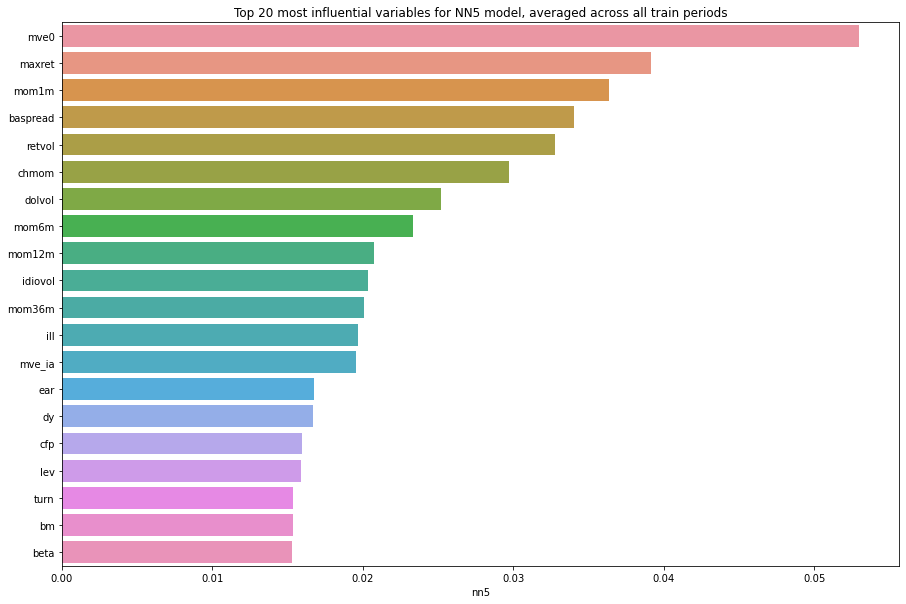

In [432]:
# Plot features of importance
# Plot graph
df_top20 = df_impt.sort_values(by=[model_name], ascending = False).head(20)
plt.figure(figsize=(15,10))
plt.title(f'Top 20 most influential variables for {model_name.upper()} model, averaged across all train periods')
sns.barplot(data = df_top20, x = model_name, y = df_top20.index);


In [433]:
# Merge with df_coef
df_r2decrease = pd.merge(
    left = df_r2decrease,
    right = df_impt[model_name],
    how = 'left',
    left_index = True,
    right_index = True    
)
df_featurerank = df_r2decrease.rank() 
df_featurerank['all_models'] = df_featurerank.sum(axis=1)

# Display tables
display(df_r2decrease)
display(df_featurerank.sort_values('all_models', ascending = False))

# Save dfs to .csv 
df_r2decrease.to_csv('../data/df_r2decrease.csv', index = False)
df_featurerank.to_csv('../data/df_featurerank.csv', index = False)

,lr,ridge,lasso,enet,pcr,extra,nn1,nn2,nn3,nn4,nn5
absacc,0.000334,0.000622,0.000000,0.000000,-0.002456,0.005258,0.006452,0.006821,0.006932,0.007222,0.008806
acc,0.001302,0.002116,0.000000,0.000000,-0.007864,0.004883,0.008022,0.007231,0.008036,0.006895,0.009688
aeavol,0.000984,0.007019,0.002913,0.003030,0.007646,0.004639,0.003378,0.006386,0.006726,0.006449,0.007562
age,0.000160,0.001337,0.000027,0.000045,-0.013675,0.012613,0.006088,0.005980,0.006826,0.007432,0.007131
agr,0.000195,0.003044,0.000000,0.000009,0.003117,0.009834,0.006807,0.004415,0.005269,0.006283,0.006887
baspread,0.008438,0.002834,0.000000,0.000000,-0.001840,0.026122,0.025246,0.044808,0.048097,0.038830,0.034058
beta,0.012467,0.002929,0.000000,0.000000,0.001281,0.021894,0.012936,0.015527,0.017802,0.015244,0.015294
betasq,0.010939,0.001710,0.000000,0.000000,-0.003600,0.022942,0.017933,0.015450,0.017404,0.018575,0.015285
bm,0.000831,0.017660,0.019649,0.020096,0.025056,0.011733,0.008053,0.011151,0.012707,0.014431,0.015340
bm_ia,0.002021,0.006742,0.005609,0.005660,0.016169,0.007191,0.005478,0.006868,0.006718,0.007287,0.011045


,lr,ridge,lasso,enet,pcr,extra,nn1,nn2,nn3,nn4,nn5,all_models
mve0,94.0,94.0,94.0,94.0,77.0,86.0,94.0,94.0,94.0,94.0,94.0,1009.0
mom1m,84.0,93.0,91.0,92.0,94.0,93.0,89.0,91.0,91.0,91.0,92.0,1001.0
retvol,93.0,90.0,87.0,87.0,87.0,89.0,91.0,92.0,92.0,92.0,90.0,990.0
chmom,88.0,92.0,93.0,93.0,93.0,87.0,81.0,88.0,89.0,89.0,89.0,982.0
mom6m,89.0,89.0,92.0,91.0,89.0,90.0,83.0,86.0,86.0,86.0,87.0,968.0
mom12m,77.0,87.0,83.0,83.0,92.0,94.0,87.0,87.0,87.0,88.0,86.0,951.0
dy,83.0,91.0,90.0,90.0,91.0,92.0,77.0,74.0,76.0,69.0,80.0,913.0
dolvol,87.0,82.0,80.0,80.0,58.0,77.0,93.0,89.0,88.0,87.0,88.0,909.0
mom36m,72.0,85.0,84.0,84.0,74.0,88.0,74.0,85.0,84.0,85.0,84.0,899.0
idiovol,61.0,78.0,81.0,81.0,83.0,91.0,80.0,82.0,85.0,83.0,85.0,890.0


## LSTM

### Pad dataset

In [499]:
df_lstm = df_lstm['1990':'2020']
df_lstm

,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,permno,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990-01-31,3.9755,-0.301557,0.031368,-0.335058,-0.671830,0.507010,1.007749,-1.320972,-0.942515,0.061454,0.102232,-0.089156,0.035383,-0.254751,-0.174164,-0.297058,-0.061984,-0.250966,0.088537,-0.087407,0.143006,-0.202614,0.061778,-0.027393,0.0,-0.176686,-0.117039,0.0,0.0,-1.172060,-0.006802,-0.015319,-0.330245,-0.027162,-0.662322,-0.134515,-0.117733,0.062881,-0.253186,-0.689191,0.197593,-0.267533,-0.093312,-0.414484,-0.400149,-1.045337,-0.793340,-1.917570,-0.231151,0.089969,-0.783718,-0.303565,-0.276971,0.923812,-0.396322,-0.098817,-0.108227,-0.103300,-0.044400,-0.629303,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.179411,10952,1.432487,0.864059,-0.175286,0.0,-0.101535,-0.101535,0.040685,-0.021964,-0.301137,-0.256245,-0.492956,-0.220016,0.191844,-0.011605,-0.100538,-0.324173,0.450735,1.0,-0.294308,0.0,-0.383119,1.349592,-0.677722,-0.091013,-0.09863,-1.458862,-0.158626,-1.407386,2.122662
1990-01-31,-1.0623,-0.287684,0.016430,0.144402,-0.830479,-2.960917,-0.127500,-0.339187,-0.491444,-0.158987,0.091290,0.358478,-0.206377,0.156295,-0.382437,-0.493337,-0.060734,5.330539,0.088537,-0.087407,-0.552160,-0.034121,0.061778,-0.027393,0.0,-0.059751,-0.117039,0.0,0.0,0.776842,-0.999527,0.787345,3.482637,-0.245666,-0.409618,-0.134515,-0.117733,0.062881,-0.253186,-0.667271,-0.346051,-0.267533,-0.093312,-0.364973,0.164761,-0.463282,0.426023,-0.402618,0.206621,-0.064699,-0.783718,-0.179389,-0.180902,0.923812,-0.573742,-0.098817,-0.108227,-0.103300,-0.044400,0.793625,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.010095,10978,-0.384113,-0.018001,-0.058364,0.0,-0.101535,-0.101535,0.040685,-0.480541,-0.142251,-0.256245,-0.360121,-0.346160,0.186784,-0.246412,-0.100538,-0.299925,0.450735,0.0,0.835083,0.0,-0.429937,-0.118902,0.013197,-0.091013,-0.09863,-0.012776,-0.158626,1.787231,-0.456109
1990-01-31,-6.6924,-0.204958,0.019443,-0.449575,-0.989128,0.180809,-0.105442,1.241601,1.173683,-0.777008,0.060614,-0.582760,-0.295234,0.397110,0.186015,0.042378,-0.060734,-0.250966,0.088537,-0.087407,1.686838,0.085294,0.321828,-0.027393,0.0,-0.231128,-0.117039,0.0,0.0,-1.264997,-0.962475,0.031734,-0.278018,0.033120,-0.122299,-0.134515,-0.117733,0.062881,-0.253186,2.276356,0.994859,-0.267533,-0.093312,0.021437,-0.214547,0.284130,1.088219,1.244685,0.068070,1.667229,-0.783718,-0.296720,-0.273770,1.717965,-0.075388,-0.098817,-0.108227,-0.103300,-0.044400,0.166963,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.207302,11297,-0.467082,-0.018001,-0.229722,0.0,-0.101535,-0.101535,0.040685,0.213381,-0.339811,-0.256245,0.609187,0.607930,0.220025,-0.066149,-0.100538,-0.324173,0.450735,0.0,-0.196122,0.0,-0.194435,0.288859,-0.574499,-0.091013,-0.09863,-1.635549,-0.099694,-1.296984,1.836132
1990-01-31,5.6800,-0.492511,0.236992,-0.543881,-0.671830,-0.323205,0.554322,-0.464834,-0.574102,-0.624901,-9.836660,1.254404,-0.288977,0.131057,0.007921,0.902629,-0.053769,-0.250966,0.050963,-0.087407,1.143863,1.470326,0.061778,-0.029000,0.0,-0.198241,8.971925,0.0,0.0,-0.294996,-0.120919,0.899518,-0.367578,0.281434,0.148308,-0.546273,-0.117733,-4.043093,-0.253186,-0.075412,0.290795,-0.002320,-0.093182,0.218357,-0.127916,1.204531,-0.007111,2.269849,0.068070,0.232338,-0.783718,-0.291227,-0.559097,-0.664496,0.461590,-0.098817,-0.153662,-0.10330

In [507]:
# Find total number of unique date+permno combinations
#  permno.nunique will be the batch_size (1st dimension of LSTM input shape)
#  date.nunique will be the time steps (2nd dimension of LSTM input shape)
#  the 3rd dimension will be the 94 features for each permno
df_lstm.permno.nunique() * df_lstm.index.nunique()

170748

In [524]:
df_new = []
for date in df_lstm.index.unique():
    for permno in df_lstm.permno.unique():
        row = [date, permno]
        df_new.append(row)
df_new

[[Timestamp('1990-01-31 00:00:00'), 10952],
 [Timestamp('1990-01-31 00:00:00'), 10978],
 [Timestamp('1990-01-31 00:00:00'), 11297],
 [Timestamp('1990-01-31 00:00:00'), 11318],
 [Timestamp('1990-01-31 00:00:00'), 11967],
 [Timestamp('1990-01-31 00:00:00'), 12033],
 [Timestamp('1990-01-31 00:00:00'), 12072],
 [Timestamp('1990-01-31 00:00:00'), 12275],
 [Timestamp('1990-01-31 00:00:00'), 22091],
 [Timestamp('1990-01-31 00:00:00'), 27511],
 [Timestamp('1990-01-31 00:00:00'), 31974],
 [Timestamp('1990-01-31 00:00:00'), 35553],
 [Timestamp('1990-01-31 00:00:00'), 35561],
 [Timestamp('1990-01-31 00:00:00'), 39917],
 [Timestamp('1990-01-31 00:00:00'), 40468],
 [Timestamp('1990-01-31 00:00:00'), 42140],
 [Timestamp('1990-01-31 00:00:00'), 46703],
 [Timestamp('1990-01-31 00:00:00'), 49322],
 [Timestamp('1990-01-31 00:00:00'), 49330],
 [Timestamp('1990-01-31 00:00:00'), 49744],
 [Timestamp('1990-01-31 00:00:00'), 50585],
 [Timestamp('1990-01-31 00:00:00'), 51246],
 [Timestamp('1990-01-31 00:00:00

In [525]:
# Create empty dataframe consisting of all time steps and all premno's
df_new = pd.DataFrame(
    df_new, 
    columns = ['DATE','permno']
).sort_values(['permno','DATE']).set_index('DATE')

df_new

,permno
DATE,
1990-01-31,10952
1990-02-28,10952
1990-03-31,10952
1990-04-30,10952
1990-05-31,10952
...,...
2020-08-31,93419
2020-09-30,93419
2020-10-31,93419


In [527]:
# Create padded dataset with null values for RET and 94 features 
#. if a stock does not exist during a certain time step

df_padded = pd.merge(
    left = df_new,
    right = df_lstm,
    how = 'left',
    on = ['permno', 'DATE']
)

df_padded

,permno,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990-01-31,10952,3.9755,-0.301557,0.031368,-0.335058,-0.671830,0.507010,1.007749,-1.320972,-0.942515,0.061454,0.102232,-0.089156,0.035383,-0.254751,-0.174164,-0.297058,-0.061984,-0.250966,0.088537,-0.087407,0.143006,-0.202614,0.061778,-0.027393,0.0,-0.176686,-0.117039,0.0,0.0,-1.172060,-0.006802,-0.015319,-0.330245,-0.027162,-0.662322,-0.134515,-0.117733,0.062881,-0.253186,-0.689191,0.197593,-0.267533,-0.093312,-0.414484,-0.400149,-1.045337,-0.793340,-1.917570,-0.231151,0.089969,-0.783718,-0.303565,-0.276971,0.923812,-0.396322,-0.098817,-0.108227,-0.103300,-0.044400,-0.629303,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.179411,1.432487,0.864059,-0.175286,0.0,-0.101535,-0.101535,0.040685,-0.021964,-0.301137,-0.256245,-0.492956,-0.220016,0.191844,-0.011605,-0.100538,-0.324173,0.450735,1.0,-0.294308,0.0,-0.383119,1.349592,-0.677722,-0.091013,-0.098630,-1.458862,-0.158626,-1.407386,2.122662
1990-02-28,10952,24.1836,-0.316375,0.000074,-0.302849,-0.665073,0.522328,1.002638,-1.242038,-0.975015,0.068370,0.110045,-0.164748,0.030742,-0.266188,-0.168306,-0.324917,-0.035153,-0.259450,0.077659,-0.069944,0.527391,-0.229444,-0.098238,0.104338,0.0,-0.175902,-0.110858,0.0,0.0,-1.845571,0.003796,0.692031,-0.312690,-0.030550,-0.698382,-0.143621,-0.128941,-0.002951,-0.220187,-0.509067,0.043584,-0.249157,-0.105967,-0.414670,-0.402819,0.138153,-1.612110,0.700400,-0.088078,-1.005423,-0.881030,-0.295225,-0.252481,2.577282,-0.397677,-0.098064,-0.105264,-0.102328,0.022939,-0.642503,-0.101068,-0.028981,0.141197,-0.082510,-0.067436,0.187082,1.641773,0.881404,-0.174571,0.0,-0.101015,-0.101015,0.031858,0.031332,0.388613,-0.279373,-0.184390,-0.219158,0.105285,-0.009554,-0.099946,-0.322462,0.474397,1.0,-0.309139,0.0,-0.377902,0.545279,-0.110745,-0.136528,-0.135702,-1.305149,-0.126401,-1.012324,0.472272
1990-03-31,10952,30.9076,-0.316375,0.000074,-0.298747,-0.665073,0.523759,1.585827,-1.316568,-0.937060,0.068370,0.110083,-0.182377,0.030742,-0.266188,-0.168306,-0.324917,-0.034746,-0.259450,0.077254,-0.069944,1.704126,-0.229444,-0.008622,0.109651,0.0,-0.175900,-0.110858,0.0,0.0,-0.766846,0.003796,0.686427,-0.312690,-0.030550,-0.698382,-0.143621,-0.128941,-0.002951,-0.220187,-0.468488,0.263649,-0.054298,-0.105461,-0.414670,-0.402819,0.199743,-1.588771,2.194856,-0.286679,-0.590133,-0.783336,-0.285402,-0.252481,2.216891,-0.397677,-0.098064,-0.105264,-0.102328,0.022939,-0.642503,-0.101068,-0.028981,0.141197,-0.082510,-0.067436,0.187082,0.595955,0.881404,-0.174570,0.0,-0.101015,-0.101015,0.031858,-0.348088,0.389960,-0.282126,-0.192253,-0.219158,0.125962,-0.009554,-0.099946,-0.321788,0.474397,1.0,-0.309139,0.0,-0.377902,-0.579542,-0.734020,-0.137540,-0.137309,-1.305149,-0.126401,-1.079249,2.382314
1990-04-30,10952,-13.7398,-0.300846,0.030275,1.499399,-0.664818,0.486830,1.601957,-1.211392,-0.916426,0.055823,0.108077,-0.287342,0.044652,-0.193935,-0.176786,-0.354381,-0.046018,-0.236374,0.081307,-0.069944,1.031779,-0.253160,0.041794,-0.066215,0.0,-0.178163,-0.110858,0.0,0.0,-2.027175,-0.022819,-0.440026,-0.290054,-0.031359,-0.688372,-0.143621,-0.130278,0.000500,-0.202171,-0.393515,-0.129181,-0.009115,-0.111098,-0.417027,-0.394043,0.112798,-0.059439,3.296351,-0.606809,0.022849,-0.776004,-0.295209,-0.251402,-0.656892,-0.396447,-0

In [533]:
df_padded.fillna(0, inplace = True)
df_padded.isnull().sum()

permno             0
RET                0
absacc             0
acc                0
aeavol             0
age                0
agr                0
baspread           0
beta               0
betasq             0
bm                 0
bm_ia              0
cash               0
cashdebt           0
cashpr             0
cfp                0
cfp_ia             0
chatoia            0
chcsho             0
chempia            0
chinv              0
chmom              0
chpmia             0
chtx               0
cinvest            0
convind            0
currat             0
depr               0
divi               0
divo               0
dolvol             0
dy                 0
ear                0
egr                0
ep                 0
gma                0
grcapx             0
grltnoa            0
herf               0
hire               0
idiovol            0
ill                0
indmom             0
invest             0
lev                0
lgr                0
maxret             0
mom12m       

In [774]:
df_padded.permno.unique()

array([10952, 10978, 11297, 11318, 11967, 12033, 12072, 12093, 12275,
       12323, 12329, 12513, 12566, 12668, 12681, 12828, 12893, 12965,
       13003, 13134, 13332, 13358, 13401, 13439, 13500, 13614, 13700,
       13723, 13736, 13752, 13756, 13775, 13787, 13803, 13809, 13843,
       13886, 13887, 13907, 14034, 14037, 14039, 14071, 14181, 14183,
       14184, 14196, 14220, 14252, 14268, 14279, 14334, 14489, 14500,
       14559, 14566, 14575, 14638, 14651, 14686, 14974, 15044, 15048,
       15052, 15142, 15159, 15194, 15196, 15216, 15231, 15259, 15279,
       15338, 15343, 15455, 15586, 15598, 15708, 15711, 15719, 16042,
       16136, 16266, 16332, 16346, 16515, 16577, 16581, 16585, 16691,
       16764, 16768, 16770, 16813, 17287, 17307, 17789, 17860, 17919,
       17952, 18259, 18715, 19033, 19037, 22091, 27511, 31974, 35553,
       35561, 39917, 40468, 42140, 46703, 49322, 49330, 49744, 50585,
       51246, 52214, 52361, 53058, 53372, 54324, 55029, 55634, 56610,
       56856, 59300,

In [794]:
test = df_padded.sort_index()['1990':'2000']

In [798]:
test = test.loc[test['permno'] == 10952]
test

,permno,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990-01-31,10952,3.9755,-0.301557,0.031368,-0.335058,-0.671830,0.507010,1.007749,-1.320972,-0.942515,0.061454,0.102232,-0.089156,0.035383,-0.254751,-0.174164,-0.297058,-0.061984,-0.250966,0.088537,-0.087407,0.143006,-0.202614,0.061778,-0.027393,0.0,-0.176686,-0.117039,0.0,0.0,-1.172060,-0.006802,-0.015319,-0.330245,-0.027162,-0.662322,-0.134515,-0.117733,0.062881,-0.253186,-0.689191,0.197593,-0.267533,-0.093312,-0.414484,-0.400149,-1.045337,-0.793340,-1.917570,-0.231151,0.089969,-0.783718,-0.303565,-0.276971,0.923812,-0.396322,-0.098817,-0.108227,-0.103300,-0.044400,-0.629303,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.179411,1.432487,0.864059,-0.175286,0.0,-0.101535,-0.101535,0.040685,-0.021964,-0.301137,-0.256245,-0.492956,-0.220016,0.191844,-0.011605,-0.100538,-0.324173,0.450735,1.0,-0.294308,0.0,-0.383119,1.349592,-0.677722,-0.091013,-0.098630,-1.458862,-0.158626,-1.407386,2.122662
1990-02-28,10952,24.1836,-0.316375,0.000074,-0.302849,-0.665073,0.522328,1.002638,-1.242038,-0.975015,0.068370,0.110045,-0.164748,0.030742,-0.266188,-0.168306,-0.324917,-0.035153,-0.259450,0.077659,-0.069944,0.527391,-0.229444,-0.098238,0.104338,0.0,-0.175902,-0.110858,0.0,0.0,-1.845571,0.003796,0.692031,-0.312690,-0.030550,-0.698382,-0.143621,-0.128941,-0.002951,-0.220187,-0.509067,0.043584,-0.249157,-0.105967,-0.414670,-0.402819,0.138153,-1.612110,0.700400,-0.088078,-1.005423,-0.881030,-0.295225,-0.252481,2.577282,-0.397677,-0.098064,-0.105264,-0.102328,0.022939,-0.642503,-0.101068,-0.028981,0.141197,-0.082510,-0.067436,0.187082,1.641773,0.881404,-0.174571,0.0,-0.101015,-0.101015,0.031858,0.031332,0.388613,-0.279373,-0.184390,-0.219158,0.105285,-0.009554,-0.099946,-0.322462,0.474397,1.0,-0.309139,0.0,-0.377902,0.545279,-0.110745,-0.136528,-0.135702,-1.305149,-0.126401,-1.012324,0.472272
1990-03-31,10952,30.9076,-0.316375,0.000074,-0.298747,-0.665073,0.523759,1.585827,-1.316568,-0.937060,0.068370,0.110083,-0.182377,0.030742,-0.266188,-0.168306,-0.324917,-0.034746,-0.259450,0.077254,-0.069944,1.704126,-0.229444,-0.008622,0.109651,0.0,-0.175900,-0.110858,0.0,0.0,-0.766846,0.003796,0.686427,-0.312690,-0.030550,-0.698382,-0.143621,-0.128941,-0.002951,-0.220187,-0.468488,0.263649,-0.054298,-0.105461,-0.414670,-0.402819,0.199743,-1.588771,2.194856,-0.286679,-0.590133,-0.783336,-0.285402,-0.252481,2.216891,-0.397677,-0.098064,-0.105264,-0.102328,0.022939,-0.642503,-0.101068,-0.028981,0.141197,-0.082510,-0.067436,0.187082,0.595955,0.881404,-0.174570,0.0,-0.101015,-0.101015,0.031858,-0.348088,0.389960,-0.282126,-0.192253,-0.219158,0.125962,-0.009554,-0.099946,-0.321788,0.474397,1.0,-0.309139,0.0,-0.377902,-0.579542,-0.734020,-0.137540,-0.137309,-1.305149,-0.126401,-1.079249,2.382314
1990-04-30,10952,-13.7398,-0.300846,0.030275,1.499399,-0.664818,0.486830,1.601957,-1.211392,-0.916426,0.055823,0.108077,-0.287342,0.044652,-0.193935,-0.176786,-0.354381,-0.046018,-0.236374,0.081307,-0.069944,1.031779,-0.253160,0.041794,-0.066215,0.0,-0.178163,-0.110858,0.0,0.0,-2.027175,-0.022819,-0.440026,-0.290054,-0.031359,-0.688372,-0.143621,-0.130278,0.000500,-0.202171,-0.393515,-0.129181,-0.009115,-0.111098,-0.417027,-0.394043,0.112798,-0.059439,3.296351,-0.606809,0.022849,-0.776004,-0.295209,-0.251402,-0.656892,-0.396447,-0

In [817]:
test.head(20)

,permno,RET,absacc,acc,aeavol,age,agr,baspread,beta,betasq,bm,bm_ia,cash,cashdebt,cashpr,cfp,cfp_ia,chatoia,chcsho,chempia,chinv,chmom,chpmia,chtx,cinvest,convind,currat,depr,divi,divo,dolvol,dy,ear,egr,ep,gma,grcapx,grltnoa,herf,hire,idiovol,ill,indmom,invest,lev,lgr,maxret,mom12m,mom1m,mom36m,mom6m,ms,mve0,mve_ia,nincr,operprof,orgcap,pchcapx_ia,pchcurrat,pchdepr,pchgm_pchsale,pchquick,pchsale_pchinvt,pchsale_pchrect,pchsale_pchxsga,pchsaleinv,pctacc,pricedelay,ps,quick,rd,rd_mve,rd_sale,realestate,retvol,roaq,roavol,roeq,roic,rsup,salecash,saleinv,salerec,secured,securedind,sgr,sin,sp,std_dolvol,std_turn,stdacc,stdcf,tang,tb,turn,zerotrade
DATE,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990-01-31,10952,3.9755,-0.301557,0.031368,-0.335058,-0.671830,0.507010,1.007749,-1.320972,-0.942515,0.061454,0.102232,-0.089156,0.035383,-0.254751,-0.174164,-0.297058,-0.061984,-0.250966,0.088537,-0.087407,0.143006,-0.202614,0.061778,-0.027393,0.0,-0.176686,-0.117039,0.0,0.0,-1.172060,-0.006802,-0.015319,-0.330245,-0.027162,-0.662322,-0.134515,-0.117733,0.062881,-0.253186,-0.689191,0.197593,-0.267533,-0.093312,-0.414484,-0.400149,-1.045337,-0.793340,-1.917570,-0.231151,0.089969,-0.783718,-0.303565,-0.276971,0.923812,-0.396322,-0.098817,-0.108227,-0.103300,-0.044400,-0.629303,-0.102765,-0.031597,0.119559,-0.084602,-0.071624,0.179411,1.432487,0.864059,-0.175286,0.0,-0.101535,-0.101535,0.040685,-0.021964,-0.301137,-0.256245,-0.492956,-0.220016,0.191844,-0.011605,-0.100538,-0.324173,0.450735,1.0,-0.294308,0.0,-0.383119,1.349592,-0.677722,-0.091013,-0.098630,-1.458862,-0.158626,-1.407386,2.122662
1990-02-28,10952,24.1836,-0.316375,0.000074,-0.302849,-0.665073,0.522328,1.002638,-1.242038,-0.975015,0.068370,0.110045,-0.164748,0.030742,-0.266188,-0.168306,-0.324917,-0.035153,-0.259450,0.077659,-0.069944,0.527391,-0.229444,-0.098238,0.104338,0.0,-0.175902,-0.110858,0.0,0.0,-1.845571,0.003796,0.692031,-0.312690,-0.030550,-0.698382,-0.143621,-0.128941,-0.002951,-0.220187,-0.509067,0.043584,-0.249157,-0.105967,-0.414670,-0.402819,0.138153,-1.612110,0.700400,-0.088078,-1.005423,-0.881030,-0.295225,-0.252481,2.577282,-0.397677,-0.098064,-0.105264,-0.102328,0.022939,-0.642503,-0.101068,-0.028981,0.141197,-0.082510,-0.067436,0.187082,1.641773,0.881404,-0.174571,0.0,-0.101015,-0.101015,0.031858,0.031332,0.388613,-0.279373,-0.184390,-0.219158,0.105285,-0.009554,-0.099946,-0.322462,0.474397,1.0,-0.309139,0.0,-0.377902,0.545279,-0.110745,-0.136528,-0.135702,-1.305149,-0.126401,-1.012324,0.472272
1990-03-31,10952,30.9076,-0.316375,0.000074,-0.298747,-0.665073,0.523759,1.585827,-1.316568,-0.937060,0.068370,0.110083,-0.182377,0.030742,-0.266188,-0.168306,-0.324917,-0.034746,-0.259450,0.077254,-0.069944,1.704126,-0.229444,-0.008622,0.109651,0.0,-0.175900,-0.110858,0.0,0.0,-0.766846,0.003796,0.686427,-0.312690,-0.030550,-0.698382,-0.143621,-0.128941,-0.002951,-0.220187,-0.468488,0.263649,-0.054298,-0.105461,-0.414670,-0.402819,0.199743,-1.588771,2.194856,-0.286679,-0.590133,-0.783336,-0.285402,-0.252481,2.216891,-0.397677,-0.098064,-0.105264,-0.102328,0.022939,-0.642503,-0.101068,-0.028981,0.141197,-0.082510,-0.067436,0.187082,0.595955,0.881404,-0.174570,0.0,-0.101015,-0.101015,0.031858,-0.348088,0.389960,-0.282126,-0.192253,-0.219158,0.125962,-0.009554,-0.099946,-0.321788,0.474397,1.0,-0.309139,0.0,-0.377902,-0.579542,-0.734020,-0.137540,-0.137309,-1.305149,-0.126401,-1.079249,2.382314
1990-04-30,10952,-13.7398,-0.300846,0.030275,1.499399,-0.664818,0.486830,1.601957,-1.211392,-0.916426,0.055823,0.108077,-0.287342,0.044652,-0.193935,-0.176786,-0.354381,-0.046018,-0.236374,0.081307,-0.069944,1.031779,-0.253160,0.041794,-0.066215,0.0,-0.178163,-0.110858,0.0,0.0,-2.027175,-0.022819,-0.440026,-0.290054,-0.031359,-0.688372,-0.143621,-0.130278,0.000500,-0.202171,-0.393515,-0.129181,-0.009115,-0.111098,-0.417027,-0.394043,0.112798,-0.059439,3.296351,-0.606809,0.022849,-0.776004,-0.295209,-0.251402,-0.656892,-0.396447,-0

In [806]:
generator = TimeseriesGenerator(test.drop(columns=['permno','RET']), test['RET'], length=12, batch_size=999) 

In [809]:
generator[0][0].shape

(120, 12, 94)

In [819]:
generator[0][0][0]

array([[-3.01557065e-01,  3.13684525e-02, -3.35058005e-01, ...,
        -1.58626181e-01, -1.40738580e+00,  2.12266178e+00],
       [-3.16375296e-01,  7.38989138e-05, -3.02848848e-01, ...,
        -1.26400569e-01, -1.01232425e+00,  4.72271686e-01],
       [-3.16375296e-01,  7.38989138e-05, -2.98746842e-01, ...,
        -1.26400569e-01, -1.07924944e+00,  2.38231433e+00],
       ...,
       [-3.67540630e-01,  1.84037247e-01, -9.43100657e-01, ...,
        -1.37504385e-01, -8.12299724e-01,  1.67866153e+00],
       [-3.80319745e-01,  1.61782621e-01, -7.97607840e-01, ...,
        -1.24184525e-01, -7.69792499e-01,  1.25687123e+00],
       [-3.85828585e-01,  1.67637174e-01, -7.97650327e-01, ...,
        -1.21134570e-01, -6.53564162e-01,  1.45270339e+00]])

In [818]:
generator[0][1][0]

18.9244

In [534]:
# Check total number of time steps again: should be 31 (years) X 12 (months)
df_padded.index.nunique()

372

In [535]:
# Check total number of batches again: should be total # of REITs in the universe
df_padded.permno.nunique()

459

In [597]:
# Check current shape
df_padded.shape[1]

96

In [612]:
y_padded = df_padded['RET']
X_padded = df_padded.drop(columns=['RET','permno'])

In [613]:
# n_timesteps = df_padded.index.nunique() #how many timesteps to look in the past in order to forecast the next sample
n_timesteps = 12
n_features= X_padded.shape[1] # how many predictors/features we have to predict y
b_size = df_padded.permno.nunique() # Number of REITs in each batch

generator = TimeseriesGenerator(X_padded, y_padded, length=n_timesteps, batch_size=b_size)


In [693]:
X_lstm, y_lstm = generator[0]

In [691]:
X_padded.shape, y_padded.shape

((170748, 94), (170748,))

In [694]:
X_lstm.shape, y_lstm.shape

((459, 12, 94), (459,))

In [700]:
# Sample size
X_lstm.shape[0], len(generator), X_lstm.shape[0] * len(generator)

(459, 372, 170748)

In [614]:
len(generator[0]) # first tuple is X, second is y

2

In [682]:
generator[0][1].shape

(459,)

In [702]:
len(generator)

372

In [618]:
# number of samples
print('Samples: %d' % len(generator))
# print each sample
for i in range(len(generator)):
    x, y = generator[i]
    print('%s => %s' % (x, y))

Samples: 372
[[[-3.01557065e-01  3.13684525e-02 -3.35058005e-01 ... -1.58626181e-01
   -1.40738580e+00  2.12266178e+00]
  [-3.16375296e-01  7.38989138e-05 -3.02848848e-01 ... -1.26400569e-01
   -1.01232425e+00  4.72271686e-01]
  [-3.16375296e-01  7.38989138e-05 -2.98746842e-01 ... -1.26400569e-01
   -1.07924944e+00  2.38231433e+00]
  ...
  [-3.67540630e-01  1.84037247e-01 -9.43100657e-01 ... -1.37504385e-01
   -8.12299724e-01  1.67866153e+00]
  [-3.80319745e-01  1.61782621e-01 -7.97607840e-01 ... -1.24184525e-01
   -7.69792499e-01  1.25687123e+00]
  [-3.85828585e-01  1.67637174e-01 -7.97650327e-01 ... -1.21134570e-01
   -6.53564162e-01  1.45270339e+00]]

 [[-3.16375296e-01  7.38989138e-05 -3.02848848e-01 ... -1.26400569e-01
   -1.01232425e+00  4.72271686e-01]
  [-3.16375296e-01  7.38989138e-05 -2.98746842e-01 ... -1.26400569e-01
   -1.07924944e+00  2.38231433e+00]
  [-3.00846011e-01  3.02748807e-02  1.49939879e+00 ... -1.05687320e-01
   -7.37503180e-01  1.12482084e+00]
  ...
  [-3.8031

[[[-1.11537663  0.82008805 -0.14160389 ... -0.07892552 -0.73137476
    1.34753154]
  [-1.11558662  0.81949666 -0.24895481 ... -0.08084571 -0.50617849
    1.01397807]
  [-1.11194017  0.80726273 -0.22976753 ... -0.08496057 -0.74445897
    0.52245518]
  ...
  [-0.8918318   0.74168397 -0.05414871 ...  0.01484274 -1.02934515
    1.54589024]
  [-0.21017611  0.0909502   1.28720197 ...  0.0176108  -0.53848643
    0.92703251]
  [-0.20694154  0.0871037   1.31113123 ... -0.03950367 -0.29493364
    0.2143686 ]]

 [[-1.11558662  0.81949666 -0.24895481 ... -0.08084571 -0.50617849
    1.01397807]
  [-1.11194017  0.80726273 -0.22976753 ... -0.08496057 -0.74445897
    0.52245518]
  [-0.93726965  0.71406422 -0.25122273 ... -0.00300036 -0.39185856
    0.98618862]
  ...
  [-0.21017611  0.0909502   1.28720197 ...  0.0176108  -0.53848643
    0.92703251]
  [-0.20694154  0.0871037   1.31113123 ... -0.03950367 -0.29493364
    0.2143686 ]
  [-0.21026864  0.08552105  1.39506211 ... -0.04772741  0.16306695
   -0.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[-0.26565179 -0.20819944 -0.17611268 ...  1.34706062 -0.90617681
   -0.1581139 ]
  [-0.26119166 -0.2111729   0.02476233 ...  1.35635335 -0.93655115
   -0.16686473]
  [-0.26119166 -0.2111729   0.02057703 ...  1.35635335 -0.71188712
   -0.15762209]
  ...
  [-0.4277109   0.0983397  -0.72091282 ... -0.25535056 -0.9542557
   -0.14712833]
  [-0.42600961  0.09405006 -0.25715789 ... -0.24697588 -1.1622523
   -0.13076426]
  [-0.42628286  0.09458173 -0.26043534 ... -0.23627819 -0.85460804
   -0.16829702]]

 [[-0.26119166 -0.2111729   0.02476233 ...  1.35635335 -0.93655115
   -0.16686473]
  [-0.26119166 -0.2111729   0.02057703 ...  1.35635335 -0.71188712
   -0.15762209]
  [-0.42334302  0.07897897 -0.00273839 ... -0.2428927  -0.85257726
   -0.15816879]
  ...
  [-0.42600961  0.09405006 -0.25715789 ... -0.24697588 -1.1622523
   -0.13076426]
  [-0.42628286  0.09458173 -0.26043534 ... -0.23627819 -0.85460804
   -0.16829702]
  [-0.43710476  0.09590342 -0.33510419 ... -0.23862256 -0.44852601
   -0.147

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [-0.13810192 -0.10752005 -0.20919266 ... -0.23824731 -0.17695674
   -0.1776158 ]
  [-0.13773876 -0.10723939 -0.20940105 ... -0.23759772 -0.22169519
   -0.17604995]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [-0.13810192 -0.10752005 -0.20919266 ... -0.23824731 -0.17695674
   -0.1776158 ]
  [-0.13773876 -0.10723939 -0.20940105 ... -0.23759772 -0.22169519
   -0.17604995]
  [-0.16425768 -0.12797628 -0.20789727 ... -0.23902248  0.69227225
   -0.16768875]]

 [[ 0.          0.          0.         ...  

[[[-0.73216531  0.30462204 -0.15855459 ... -0.15696523 -0.20114603
   -0.11388623]
  [-0.73216531  0.30462204 -0.23857871 ... -0.15696523  0.0041475
   -0.11569659]
  [-0.7270099   0.29898674 -0.2313064  ... -0.15834202  0.06044337
   -0.12964752]
  ...
  [-0.53715825  0.04884939 -0.41614829 ... -0.31156565 -0.28800457
   -0.1083118 ]
  [-0.53715825  0.04884939 -0.52796257 ... -0.31156565 -0.35378304
   -0.11498372]
  [-0.53715825  0.04884939 -0.53465054 ... -0.31156565 -0.33735418
   -0.13280564]]

 [[-0.73216531  0.30462204 -0.23857871 ... -0.15696523  0.0041475
   -0.11569659]
  [-0.7270099   0.29898674 -0.2313064  ... -0.15834202  0.06044337
   -0.12964752]
  [-0.72691844  0.29810373 -0.23274592 ... -0.15869529  0.02042251
   -0.10517217]
  ...
  [-0.53715825  0.04884939 -0.52796257 ... -0.31156565 -0.35378304
   -0.11498372]
  [-0.53715825  0.04884939 -0.53465054 ... -0.31156565 -0.33735418
   -0.13280564]
  [-0.53103454  0.06069848 -0.54399371 ... -0.32565981 -0.13169996
   -0.10

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[-0.14605836 -0.12033104 -0.18685575 ... -0.15502182 -0.51911177
   -0.10695923]
  [-0.14939104 -0.13694572 -0.13891323 ... -0.15400376 -0.38588243
   -0.12163798]
  [-0.14636967 -0.12201729 -0.13442714 ... -0.15441383 -0.1737028
   -0.11220045]
  ...
  [-0.21994276 -0.11812071 -0.15950628 ... -0.32246902 -0.17349375
   -0.11539196]
  [-0.21994276 -0.11812071 -0.16438963 ... -0.32246902 -0.28471158
   -0.11426241]
  [-0.21994276 -0.11812071 -0.1719534  ... -0.32471604 -0.43804897
   -0.11452051]]

 [[-0.14939104 -0.13694572 -0.13891323 ... -0.15400376 -0.38588243
   -0.12163798]
  [-0.14636967 -0.12201729 -0.13442714 ... -0.15441383 -0.1737028
   -0.11220045]
  [-0.2235953  -0.12636703 -0.12902677 ... -0.31156565  0.33571422
   -0.10831182]
  ...
  [-0.21994276 -0.11812071 -0.16438963 ... -0.32246902 -0.28471158
   -0.11426241]
  [-0.21994276 -0.11812071 -0.1719534  ... -0.32471604 -0.43804897
   -0.11452051]
  [-0.21669923 -0.11811125 -0.15800539 ... -0.31449917 -0.6649494
   -0.102

[[[-6.01779261e-01  4.64120977e-01 -1.99221203e-01 ...  4.13489883e-01
   -3.51865056e-01  6.44694444e-02]
  [-5.21861088e-01  3.87875398e-01  2.28609460e-02 ...  9.50397810e-02
   -3.53976098e-01  1.18880710e-01]
  [-5.21181188e-01  3.89240746e-01  6.89115994e-01 ...  1.04336175e-01
   -8.43285010e-01 -5.02395912e-03]
  ...
  [-5.00328810e-01  3.19193928e-01  7.26091543e-02 ...  2.14915933e-01
   -8.07346511e-01  2.23890533e-01]
  [-5.03795501e-01  3.23867938e-01  4.62614981e-01 ...  2.18738981e-01
   -8.09084845e-01  3.85949735e-01]
  [-5.16439077e-01  3.33364672e-01 -7.56297075e-01 ...  2.30301341e-01
   -5.09521921e-01  6.95375998e-01]]

 [[-5.21861088e-01  3.87875398e-01  2.28609460e-02 ...  9.50397810e-02
   -3.53976098e-01  1.18880710e-01]
  [-5.21181188e-01  3.89240746e-01  6.89115994e-01 ...  1.04336175e-01
   -8.43285010e-01 -5.02395912e-03]
  [-5.21181188e-01  3.89240746e-01  7.11866769e-01 ...  1.04336175e-01
   -7.87475778e-01  2.31057775e-01]
  ...
  [-5.03795501e-01  3.2

[[[ 7.81970064e-01 -8.55240425e-01 -4.28888035e-01 ...  1.97346910e+00
   -6.84886912e-02 -2.91789608e-01]
  [ 7.83020605e-01 -8.56504971e-01 -2.52938330e-01 ...  1.98035404e+00
   -1.64537228e-01 -2.85661309e-01]
  [ 7.83020605e-01 -8.56504971e-01 -2.59756532e-01 ...  1.98035404e+00
   -9.29816428e-02 -3.12104225e-01]
  ...
  [-5.07146765e-01  1.65096141e-01 -1.08865511e-02 ...  1.45901607e-02
   -6.77058149e-02 -3.39063781e-01]
  [-5.12635377e-01  1.68794316e-01 -2.09515328e-01 ... -8.67860814e-03
    1.04836050e-01 -3.41020166e-01]
  [-5.12635377e-01  1.68794316e-01 -1.87828983e-01 ... -8.67860814e-03
    2.08507737e-01 -3.58228805e-01]]

 [[ 7.83020605e-01 -8.56504971e-01 -2.52938330e-01 ...  1.98035404e+00
   -1.64537228e-01 -2.85661309e-01]
  [ 7.83020605e-01 -8.56504971e-01 -2.59756532e-01 ...  1.98035404e+00
   -9.29816428e-02 -3.12104225e-01]
  [ 7.27230564e-01 -8.08088049e-01 -8.26285656e-02 ...  1.97971162e+00
    1.24737016e-01 -2.82234364e-01]
  ...
  [-5.12635377e-01  1.6

[[[ 0.53452447 -1.02485167 -0.12422865 ... -0.27736918 -0.60101548
   -0.26651133]
  [ 0.53755016 -1.01620321  0.06142381 ... -0.27646841 -0.73253364
   -0.22686731]
  [ 0.55060361 -1.01895311  0.04864843 ... -0.27557636 -0.56516113
   -0.2907619 ]
  ...
  [ 1.24350297 -1.45281465 -0.37974169 ... -0.16728364 -0.40919137
   -0.22329736]
  [ 1.44803571 -1.56540535 -0.15798892 ... -0.1805361  -0.30805412
   -0.2349941 ]
  [ 1.44911866 -1.56621066 -0.14060399 ... -0.18017948 -0.63583271
   -0.22775822]]

 [[ 0.53755016 -1.01620321  0.06142381 ... -0.27646841 -0.73253364
   -0.22686731]
  [ 0.55060361 -1.01895311  0.04864843 ... -0.27557636 -0.56516113
   -0.2907619 ]
  [ 0.5586956  -1.02630559 -0.02783939 ... -0.28185558 -0.44496982
   -0.26267575]
  ...
  [ 1.44803571 -1.56540535 -0.15798892 ... -0.1805361  -0.30805412
   -0.2349941 ]
  [ 1.44911866 -1.56621066 -0.14060399 ... -0.18017948 -0.63583271
   -0.22775822]
  [ 1.4619908  -1.58231361  0.14108167 ... -0.17915479 -0.47174781
   -0.

[[[-0.56929798  0.868422   -0.96419173 ... -0.23012716 -1.16202829
    3.73909762]
  [-0.56926393  0.85986976 -1.10840528 ... -0.22950788 -1.1626317
    3.23924101]
  [-0.56926393  0.85986976 -1.0826325  ... -0.23747994 -1.2384427
    3.34799332]
  ...
  [-0.18210444  0.08412271 -0.63928346 ...  1.10491554 -1.24543025
    5.88207654]
  [-0.1830657   0.08489801  0.33436549 ...  1.20734832 -1.10753922
    5.59049655]
  [-0.18115213  0.08335366  0.31535912 ...  1.21768589 -1.37632864
    5.72121145]]

 [[-0.56926393  0.85986976 -1.10840528 ... -0.22950788 -1.1626317
    3.23924101]
  [-0.56926393  0.85986976 -1.0826325  ... -0.23747994 -1.2384427
    3.34799332]
  [-0.20691092  0.12410666 -1.14517256 ...  1.01296509 -1.32768366
    3.71328121]
  ...
  [-0.1830657   0.08489801  0.33436549 ...  1.20734832 -1.10753922
    5.59049655]
  [-0.18115213  0.08335366  0.31535912 ...  1.21768589 -1.37632864
    5.72121145]
  [-0.18924671  0.09073586  0.24244965 ...  0.91497526 -1.37019556
    6.3897

[[[-0.74119241  0.38365617 -0.15778703 ...  0.03076959  0.70723044
   -0.16768874]
  [-0.7509825   0.38838886 -1.38380903 ...  0.03982514  0.20165909
   -0.16724843]
  [-0.75064891  0.39008093 -1.20867046 ...  0.03982514 -0.09988065
   -0.16840653]
  ...
  [-0.77103843  0.40775123 -0.82936663 ...  0.05133124 -0.74519611
   -0.19502075]
  [-0.76492247  0.40287624 -0.90982806 ...  0.05243649  0.60315989
   -0.19055244]
  [-0.76707623  0.40339466 -0.81401515 ...  0.05485614  0.59478062
   -0.18127641]]

 [[-0.7509825   0.38838886 -1.38380903 ...  0.03982514  0.20165909
   -0.16724843]
  [-0.75064891  0.39008093 -1.20867046 ...  0.03982514 -0.09988065
   -0.16840653]
  [-0.7509825   0.38696744 -1.13194997 ...  0.03982514  0.06310251
   -0.16377773]
  ...
  [-0.76492247  0.40287624 -0.90982806 ...  0.05243649  0.60315989
   -0.19055244]
  [-0.76707623  0.40339466 -0.81401515 ...  0.05485614  0.59478062
   -0.18127641]
  [-0.96083733  0.40606991 -0.8156243  ... -0.20882801  1.54369678
   -0.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[-0.32240673  0.20546483  0.19624059 ...  1.59457859 -0.11480634
   -0.42529122]
  [-0.31770093  0.14784764 -0.27695359 ...  1.62511902  0.04530931
   -0.44754471]
  [-0.31565886  0.14868183 -0.27734175 ...  1.64998966 -0.03347253
   -0.48776862]
  ...
  [-0.13602517 -0.08037905 -0.6041651  ...  2.61701054 -0.19583374
   -0.47005399]
  [-0.13289793 -0.0822574  -0.0652052  ...  2.42218334 -0.36409564
   -0.48311754]
  [-0.13233235 -0.08237142 -0.06789198 ...  2.42873631 -0.53865432
   -0.47262623]]

 [[-0.31770093  0.14784764 -0.27695359 ...  1.62511902  0.04530931
   -0.44754471]
  [-0.31565886  0.14868183 -0.27734175 ...  1.64998966 -0.03347253
   -0.48776862]
  [-0.31975115  0.14840958 -0.30459738 ...  1.69034687  0.11500935
   -0.44402865]
  ...
  [-0.13289793 -0.0822574  -0.0652052  ...  2.42218334 -0.36409564
   -0.48311754]
  [-0.13233235 -0.08237142 -0.06789198 ...  2.42873631 -0.53865432
   -0.47262623]
  [-0.13543876 -0.08472395 -0.13157943 ...  2.41737806 -0.48190979
   -0.

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[-0.63307248  0.37486102  0.13908502 ... -0.14202619  1.63743454
   -0.61221877]
  [-0.64403127  0.38036105 -0.33561801 ... -0.14554345  1.91200321
   -0.59658973]
  [-0.62761078  0.42113088 -0.41023789 ... -0.14279766  1.88998854
   -0.62882815]
  ...
  [-0.63438622  0.49611045 -0.3464401  ...  0.02277752  1.34424011
   -0.50599946]
  [-0.62480103  0.48520449  1.41300319 ...  0.03679949  1.443177
   -0.57043077]
  [-0.62480103  0.48520449  1.43975201 ...  0.03679949  1.70262941
   -0.56742298]]

 [[-0.64403127  0.38036105 -0.33561801 ... -0.14554345  1.91200321
   -0.59658973]
  [-0.62761078  0.42113088 -0.41023789 ... -0.14279766  1.88998854
   -0.62882815]
  [-0.66026561  0.44506203 -0.39088119 ...  0.07153981  2.43721361
   -0.6396022 ]
  ...
  [-0.62480103  0.48520449  1.41300319 ...  0.03679949  1.443177
   -0.57043077]
  [-0.62480103  0.48520449  1.43975201 ...  0.03679949  1.70262941
   -0.56742298]
  [-0.61134832  0.47354872  0.09729868 ...  0.03935403  1.9255347
   -0.62236

[[[ 0.1557866  -0.28504101  0.05866277 ... -0.00275896  0.92356617
   -0.38826929]
  [ 0.17921488 -0.30557554 -0.28144644 ...  0.00347113  1.34521891
   -0.41911543]
  [ 0.18313473 -0.30949541  0.49980079 ... -0.00374458  0.27991474
   -0.13367163]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.17921488 -0.30557554 -0.28144644 ...  0.00347113  1.34521891
   -0.41911543]
  [ 0.18313473 -0.30949541  0.49980079 ... -0.00374458  0.27991474
   -0.13367163]
  [ 0.17883293 -0.30691479  0.54102538 ... -0.00635227  0.28646346
   -0.39785833]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.18313473 -0.30949541  0.499800

[[[ 0.07330233 -0.1926891   0.36170409 ... -1.41735308  0.69283585
   -0.29566964]
  [ 0.07917222 -0.19916541  0.16327941 ... -1.41735308  0.67139546
   -0.30699431]
  [ 0.07563209 -0.19569473  0.16195472 ... -1.41442012  0.92681067
   -0.31189844]
  ...
  [-0.25237241  0.15072275 -0.62272954 ... -0.02125059  0.43114976
   -0.23588651]
  [-0.25165256  0.15017666 -0.53065644 ... -0.01987023  0.27832631
   -0.25207596]
  [-0.25165256  0.15017666 -0.52540929 ... -0.01987023  0.22529733
   -0.24741031]]

 [[ 0.07917222 -0.19916541  0.16327941 ... -1.41735308  0.67139546
   -0.30699431]
  [ 0.07563209 -0.19569473  0.16195472 ... -1.41442012  0.92681067
   -0.31189844]
  [ 0.0679821  -0.18940322 -0.09081379 ... -1.40180987  1.3394925
   -0.29940631]
  ...
  [-0.25165256  0.15017666 -0.53065644 ... -0.01987023  0.27832631
   -0.25207596]
  [-0.25165256  0.15017666 -0.52540929 ... -0.01987023  0.22529733
   -0.24741031]
  [-0.25395158  0.15171546 -0.18734775 ... -0.01163812  0.23121452
   -0.2

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[-3.80849402e-01 -7.39864503e-02 -5.99898029e-01 ... -3.11565647e-01
    6.93660288e-02 -1.08311801e-01]
  [-3.80849402e-01 -7.39864503e-02 -6.72234007e-01 ... -3.11565647e-01
   -4.94324297e-01 -1.14983715e-01]
  [-3.80849402e-01 -7.39864503e-02 -6.55157057e-01 ... -3.11565647e-01
   -5.74762996e-01 -1.32805626e-01]
  ...
  [-3.74819373e-01 -6.29474609e-02 -2.16024580e-01 ... -3.14499173e-01
   -8.07143099e-01 -1.02868896e-01]
  [-3.77833670e-01 -5.65211962e-02 -3.92604814e-01 ... -3.04481075e-01
   -8.09636032e-01 -1.02868894e-01]
  [-3.77833670e-01 -5.65211962e-02 -3.39241644e-01 ... -3.04481075e-01
   -7.48029776e-01 -1.02868897e-01]]

 [[-3.80849402e-01 -7.39864503e-02 -6.72234007e-01 ... -3.11565647e-01
   -4.94324297e-01 -1.14983715e-01]
  [-3.80849402e-01 -7.39864503e-02 -6.55157057e-01 ... -3.11565647e-01
   -5.74762996e-01 -1.32805626e-01]
  [-3.74356936e-01 -6.33097727e-02 -6.63867726e-01 ... -3.25659807e-01
   -6.03216016e-01 -1.02504631e-01]
  ...
  [-3.77833670e-01 -5.6

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.   

[[[ 0.37745148 -0.59622516  1.21558661 ...  0.02982926 -0.00142327
   -0.11388623]
  [ 0.37745148 -0.59622516  0.267166   ...  0.02982926  0.20895799
   -0.11569659]
  [ 0.3827985  -0.602505    0.27504165 ...  0.02803266  0.4847093
   -0.12964752]
  ...
  [-0.35066284 -0.09770866  1.05879822 ... -0.24361253  0.10592721
   -0.10831181]
  [-0.35066284 -0.09770866  0.38461545 ... -0.24361253  0.01822683
   -0.11498373]
  [-0.35066284 -0.09770866  0.22760425 ... -0.24361253  0.10570547
   -0.13280564]]

 [[ 0.37745148 -0.59622516  0.267166   ...  0.02982926  0.20895799
   -0.11569659]
  [ 0.3827985  -0.602505    0.27504165 ...  0.02803266  0.4847093
   -0.12964752]
  [ 0.38032569 -0.60108138  0.29193097 ...  0.02721355  0.54013941
   -0.10517218]
  ...
  [-0.35066284 -0.09770866  0.38461545 ... -0.24361253  0.01822683
   -0.11498373]
  [-0.35066284 -0.09770866  0.22760425 ... -0.24361253  0.10570547
   -0.13280564]
  [-0.34409916 -0.0872584   0.21426025 ... -0.25306814  0.15788599
   -0.10

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [-0.25579404  0.15646684 -0.1940537  ... -0.16189336  1.15105437
   -0.49859839]
  [-0.2434215   0.16672289 -0.21048624 ... -0.08982081  0.91717625
   -0.466046  ]
  [-0.23839037  0.16337627 -0.19673865 ... -0.08841427  1.39658257
   -0.47634683]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [-0.2434215   0.16672289 -0.21048624 ... -0.08982081  0.91717625
   -0.466046  ]
  [-0.23839037  0.16337627 -0.19673865 ... -0.08841427  1.39658257
   -0.47634683]
  [-0.23501646  0.14564307 -0.18194989 ... -0.07947166  0.78402284
   -0.42529123]]

 [[ 0.          0.          0.      

[[[-0.6969573   0.33064226 -0.28648009 ... -0.36055981  0.05224533
   -0.21595398]
  [-0.69931613  0.32471251 -0.50516916 ... -0.33527214  0.1072056
   -0.18491622]
  [-0.69897751  0.32189438 -0.36781667 ... -0.32839817  0.41292536
   -0.21285614]
  ...
  [-0.69339401  0.30927767  0.1031727  ... -0.32122781 -0.13595167
   -0.2557144 ]
  [-0.69416137  0.27834847  0.06282168 ... -0.32735198 -0.06485582
   -0.22165571]
  [-0.69020084  0.27153824  0.04560449 ... -0.32110302 -0.13110007
   -0.23167463]]

 [[-0.69931613  0.32471251 -0.50516916 ... -0.33527214  0.1072056
   -0.18491622]
  [-0.69897751  0.32189438 -0.36781667 ... -0.32839817  0.41292536
   -0.21285614]
  [-0.69387979  0.31608984 -0.61053225 ... -0.32269699  0.63157561
   -0.23386216]
  ...
  [-0.69416137  0.27834847  0.06282168 ... -0.32735198 -0.06485582
   -0.22165571]
  [-0.69020084  0.27153824  0.04560449 ... -0.32110302 -0.13110007
   -0.23167463]
  [-0.77858611  0.52773918 -0.17504494 ... -0.12702876 -0.17287957
   -0.24

[[[-0.10544112 -0.18140997 -0.21541537 ... -0.21190586 -1.2740597
   -0.11503941]
  [-0.10544112 -0.18140997 -0.55794785 ... -0.21190586 -0.64770034
   -0.14168392]
  [-0.10443919 -0.18142496 -0.54349591 ... -0.21078512 -0.71307462
   -0.13243563]
  ...
  [ 0.01030835 -0.29815842 -0.65907563 ... -0.15696523 -0.54104025
   -0.11388617]
  [ 0.01030835 -0.29815842 -0.98465612 ... -0.15696523 -0.95188555
   -0.11569654]
  [ 0.01559197 -0.304225   -0.97827385 ... -0.15834202 -0.96176231
   -0.12964748]]

 [[-0.10544112 -0.18140997 -0.55794785 ... -0.21190586 -0.64770034
   -0.14168392]
  [-0.10443919 -0.18142496 -0.54349591 ... -0.21078512 -0.71307462
   -0.13243563]
  [-0.10391276 -0.18014868 -0.66390591 ... -0.21022763 -0.88361245
   -0.12266231]
  ...
  [ 0.01030835 -0.29815842 -0.98465612 ... -0.15696523 -0.95188555
   -0.11569654]
  [ 0.01559197 -0.304225   -0.97827385 ... -0.15834202 -0.96176231
   -0.12964748]
  [ 0.01396761 -0.30356458 -1.00675218 ... -0.15869529 -0.99453275
   -0.1

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[ 2.40905715e+00 -2.04871884e+00 -2.11381776e-02 ... -4.54758075e-04
    1.82566943e+00 -3.33403599e-01]
  [ 2.41484024e+00 -2.09108059e+00 -1.11241210e+00 ... -5.60496247e-03
    1.79311326e+00 -3.47222496e-01]
  [ 2.43721496e+00 -2.10829021e+00 -1.02086042e+00 ... -3.11131243e-03
   -4.47157400e-01 -3.43184108e-01]
  ...
  [ 2.66934599e+00 -2.28408420e+00 -5.25975212e-01 ... -5.46654325e-02
   -2.93572541e-01 -2.72511177e-01]
  [ 2.68943377e+00 -2.28863119e+00 -1.08473188e-01 ... -5.45330327e-02
   -2.62445621e-01 -2.94765446e-01]
  [ 2.70164178e+00 -2.30118648e+00 -1.06260667e-01 ... -4.32740093e-02
   -2.95063163e-01 -2.93817392e-01]]

 [[ 2.41484024e+00 -2.09108059e+00 -1.11241210e+00 ... -5.60496247e-03
    1.79311326e+00 -3.47222496e-01]
  [ 2.43721496e+00 -2.10829021e+00 -1.02086042e+00 ... -3.11131243e-03
   -4.47157400e-01 -3.43184108e-01]
  [ 2.42894666e+00 -2.10109267e+00 -5.79530099e-01 ... -1.89892912e-02
   -7.28174802e-01 -2.98448961e-01]
  ...
  [ 2.68943377e+00 -2.2

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[-0.24419703 -0.10677613 -0.42267191 ... -0.27736918 -0.10217535
   -0.26651136]
  [-0.24338078 -0.1098055  -0.40949663 ... -0.27646841 -0.1726536
   -0.22686735]
  [-0.24393317 -0.10983612 -0.41964121 ... -0.27557636 -0.16162151
   -0.2907619 ]
  ...
  [-0.36457235  0.02151615  0.28688171 ... -0.16728364  0.17706521
   -0.22329738]
  [-0.36266264  0.05897733  0.75258053 ... -0.1805361  -0.04942208
   -0.23499411]
  [-0.36110035  0.05825367  0.81335632 ... -0.18017948  0.0207728
   -0.22775823]]

 [[-0.24338078 -0.1098055  -0.40949663 ... -0.27646841 -0.1726536
   -0.22686735]
  [-0.24393317 -0.10983612 -0.41964121 ... -0.27557636 -0.16162151
   -0.2907619 ]
  [-0.24298633 -0.1109155   0.22597549 ... -0.28185558 -0.19937657
   -0.26267575]
  ...
  [-0.36266264  0.05897733  0.75258053 ... -0.1805361  -0.04942208
   -0.23499411]
  [-0.36110035  0.05825367  0.81335632 ... -0.18017948  0.0207728
   -0.22775823]
  [-0.35815314  0.05581482  0.36239423 ... -0.17915479 -0.15207136
   -0.2135

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[-0.36870378  0.1127118  -0.17688797 ... -0.01763917  0.21240822
   -0.29924556]
  [-0.36254378  0.1068228  -0.45262063 ... -0.02397664  0.63628531
   -0.29372848]
  [-0.36764922  0.11023578 -0.45763234 ... -0.05428998  0.35465838
   -0.29503828]
  ...
  [-0.39882661  0.13413047 -0.34804772 ...  0.03472309  0.46840378
   -0.29178962]
  [-0.3995003   0.13386819 -0.35263491 ...  0.03844404  0.39148358
   -0.28566131]
  [-0.3995003   0.13386819 -0.35723038 ...  0.03844404  0.23485304
   -0.31210423]]

 [[-0.36254378  0.1068228  -0.45262063 ... -0.02397664  0.63628531
   -0.29372848]
  [-0.36764922  0.11023578 -0.45763234 ... -0.05428998  0.35465838
   -0.29503828]
  [-0.36396587  0.1080922  -0.46934364 ... -0.05466543  0.34609985
   -0.27251118]
  ...
  [-0.3995003   0.13386819 -0.35263491 ...  0.03844404  0.39148358
   -0.28566131]
  [-0.3995003   0.13386819 -0.35723038 ...  0.03844404  0.23485304
   -0.31210423]
  [-0.40429483  0.14890457 -0.17023305 ...  0.03503403 -0.00780414
   -0.

[[[-0.12888867 -0.29862037 -0.06894472 ... -0.13236924  0.47744503
   -0.29368069]
  [-0.12397787 -0.30511378 -0.18723876 ... -0.12799085  1.13036198
   -0.29367572]
  [-0.12397787 -0.30537391 -0.21083663 ... -0.12799085  0.42575047
   -0.29508224]
  ...
  [ 0.14474243 -0.56531723  0.08001407 ... -0.27736918 -0.03859732
   -0.26651135]
  [ 0.1466622  -0.562514    0.38370304 ... -0.27646841 -0.19716577
   -0.22686734]
  [ 0.15290537 -0.56390279  0.36912725 ... -0.27557636 -0.12789648
   -0.2907619 ]]

 [[-0.12397787 -0.30511378 -0.18723876 ... -0.12799085  1.13036198
   -0.29367572]
  [-0.12397787 -0.30537391 -0.21083663 ... -0.12799085  0.42575047
   -0.29508224]
  [ 0.09467407 -0.54440902 -0.22027124 ... -0.28884711  0.11378368
   -0.29849809]
  ...
  [ 0.1466622  -0.562514    0.38370304 ... -0.27646841 -0.19716577
   -0.22686734]
  [ 0.15290537 -0.56390279  0.36912725 ... -0.27557636 -0.12789648
   -0.2907619 ]
  [ 0.15742092 -0.56811532 -0.11564417 ... -0.28185558  0.05727557
   -0.

[[[ 0.33486641 -0.4696869  -0.18845942 ... -0.21258589  0.19152798
   -0.28275437]
  [ 0.3597443  -0.46628217 -1.40503493 ... -0.2508081   0.20121396
   -0.27000047]
  [ 0.3597443  -0.46628217 -1.06871755 ... -0.2508081  -0.05908185
   -0.27031174]
  ...
  [ 0.35868273 -0.46912555 -0.28071547 ... -0.23012716  0.82616275
   -0.29940631]
  [ 0.35919993 -0.46228937 -0.17656937 ... -0.22950788  0.84339422
   -0.31602351]
  [ 0.35919993 -0.46228937 -0.17028893 ... -0.23747994  0.77336372
   -0.30207457]]

 [[ 0.3597443  -0.46628217 -1.40503493 ... -0.2508081   0.20121396
   -0.27000047]
  [ 0.3597443  -0.46628217 -1.06871755 ... -0.2508081  -0.05908185
   -0.27031174]
  [ 0.36124126 -0.47167425 -0.86350887 ... -0.25465808 -0.05916675
   -0.29133355]
  ...
  [ 0.35919993 -0.46228937 -0.17656937 ... -0.22950788  0.84339422
   -0.31602351]
  [ 0.35919993 -0.46228937 -0.17028893 ... -0.23747994  0.77336372
   -0.30207457]
  [-0.23439784  0.15033389 -0.14520421 ... -0.23150862  0.68692618
   -0.

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[-4.51748478e-01  1.20799000e-01 -3.02505902e-01 ... -4.39951538e-02
   -8.84303320e-01  1.67931050e+00]
  [-4.52600282e-01  1.21503230e-01 -1.95012744e-01 ... -5.38069752e-02
   -1.17660039e+00  1.77450445e+00]
  [-4.60555377e-01  1.27418023e-01  6.93786496e+00 ... -3.61613313e-02
   -1.07423315e+00  3.36164960e+00]
  ...
  [-5.12131314e-01  1.51504005e-01 -8.42357734e-01 ... -5.34288440e-02
   -7.83534032e-01  1.65550484e-01]
  [-5.08915129e-01  1.47920482e-01  9.29945860e-01 ... -6.80771547e-02
   -8.46035671e-01 -3.49191742e-01]
  [-5.09450698e-01  1.50019011e-01  9.72067476e-01 ... -6.75016437e-02
   -8.66309038e-01  6.34050097e-01]]

 [[-4.52600282e-01  1.21503230e-01 -1.95012744e-01 ... -5.38069752e-02
   -1.17660039e+00  1.77450445e+00]
  [-4.60555377e-01  1.27418023e-01  6.93786496e+00 ... -3.61613313e-02
   -1.07423315e+00  3.36164960e+00]
  [-5.31058708e-01  1.67823596e-01  7.13117433e+00 ... -3.63619368e-02
   -1.05321998e+00  1.06050786e+00]
  ...
  [-5.08915129e-01  1.4

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [  0.  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[-0.95735113  0.59509265  0.08696615 ...  1.09418512  1.22879206
   -0.21357494]
  [-0.95889866  0.60454934  0.19510789 ...  1.09807239  1.55658535
   -0.21685395]
  [-0.96073146  0.62969223  0.18533807 ...  1.1019465   1.27993413
   -0.23565682]
  ...
  [-0.68074906  0.30343263  0.79277788 ...  0.39586111  1.102648
   -0.23386217]
  [-0.6829244   0.31261029  0.3563534  ...  0.39859926  1.77213172
   -0.23822319]
  [-0.68404664  0.30418525  0.3316278  ...  0.39867041  1.76038795
   -0.21973474]]

 [[-0.95889866  0.60454934  0.19510789 ...  1.09807239  1.55658535
   -0.21685395]
  [-0.96073146  0.62969223  0.18533807 ...  1.1019465   1.27993413
   -0.23565682]
  [-0.95363511  0.63569724  0.08796838 ...  1.10136002  1.62695754
   -0.23151226]
  ...
  [-0.6829244   0.31261029  0.3563534  ...  0.39859926  1.77213172
   -0.23822319]
  [-0.68404664  0.30418525  0.3316278  ...  0.39867041  1.76038795
   -0.21973474]
  [-0.68049089  0.30127951  0.30820822 ...  0.40970709  1.80808726
   -0.22

[[[-5.61327160e-01  4.40572979e-01 -1.45153081e-01 ... -4.63097465e-02
    8.65085861e-01 -1.94942051e-01]
  [-5.61134507e-01  4.40563620e-01 -7.62141720e-02 ...  1.82172673e-02
    9.99563997e-01 -2.11323675e-01]
  [-5.68473533e-01  4.49957763e-01 -5.91352183e-02 ...  4.76512584e-02
    1.09749103e+00 -2.24859523e-01]
  ...
  [-7.87769011e-01  5.92993263e-01  2.01890865e-01 ... -4.14380235e-01
    4.98336073e-01 -2.35076307e-01]
  [-7.88700944e-01  5.92244139e-01  6.46005189e-01 ... -4.12746738e-01
    4.89253236e-01 -2.12323801e-01]
  [-7.89635398e-01  5.93254395e-01  6.34946191e-01 ... -4.11302338e-01
    3.99512585e-01 -2.14081032e-01]]

 [[-5.61134507e-01  4.40563620e-01 -7.62141720e-02 ...  1.82172673e-02
    9.99563997e-01 -2.11323675e-01]
  [-5.68473533e-01  4.49957763e-01 -5.91352183e-02 ...  4.76512584e-02
    1.09749103e+00 -2.24859523e-01]
  [-7.76436117e-01  5.77795930e-01 -8.23292246e-02 ... -4.45779294e-01
    1.16830037e+00 -2.09580226e-01]
  ...
  [-7.88700944e-01  5.9

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[-0.2728174  -0.02403566 -0.17089245 ... -0.13956082 -0.53736005
    0.43128283]
  [-0.27612203 -0.02778248  1.46063096 ... -0.13907001 -0.35864327
    1.42532393]
  [-0.26740449 -0.02918858  1.26217722 ... -0.12772051 -0.71803792
   -0.29350926]
  ...
  [-0.24490383 -0.11355966  0.42258728 ... -0.13910822 -0.64513048
    1.49476492]
  [-0.24857857 -0.11300866 -1.17017801 ... -0.13910822 -0.68033647
    2.17796213]
  [-0.24579585 -0.12032802 -1.16467258 ... -0.13987896 -0.73022693
    1.62327951]]

 [[-0.27612203 -0.02778248  1.46063096 ... -0.13907001 -0.35864327
    1.42532393]
  [-0.26740449 -0.02918858  1.26217722 ... -0.12772051 -0.71803792
   -0.29350926]
  [-0.25721294 -0.08480296  1.25695964 ... -0.12012192 -0.65597695
    0.83478772]
  ...
  [-0.24857857 -0.11300866 -1.17017801 ... -0.13910822 -0.68033647
    2.17796213]
  [-0.24579585 -0.12032802 -1.16467258 ... -0.13987896 -0.73022693
    1.62327951]
  [-0.25256529 -0.11706995 -1.15022632 ... -0.13236924  0.18948374
    0.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[ 0.56943339 -0.81061171  0.09813825 ...  2.03193251 -0.24862559
   -0.11539196]
  [ 0.56943339 -0.81061171 -0.67112922 ...  2.03193251 -0.45004441
   -0.11426241]
  [ 0.56943339 -0.81061171 -0.68144004 ...  2.0576385  -0.47131282
   -0.11452052]
  ...
  [ 0.8458834  -1.00350569  0.03029209 ...  0.39900626  3.71177141
   -0.11215155]
  [ 0.8458834  -1.00350569  0.19169599 ...  0.39900626  0.44474976
   -0.11699213]
  [ 0.8656181  -1.01688911  0.18211815 ...  0.39937652  2.26576825
   -0.10341758]]

 [[ 0.56943339 -0.81061171 -0.67112922 ...  2.03193251 -0.45004441
   -0.11426241]
  [ 0.56943339 -0.81061171 -0.68144004 ...  2.0576385  -0.47131282
   -0.11452052]
  [ 0.56700958 -0.80835916  0.71099656 ...  2.04879481 -0.39333886
   -0.10286891]
  ...
  [ 0.8458834  -1.00350569  0.19169599 ...  0.39900626  0.44474976
   -0.11699213]
  [ 0.8656181  -1.01688911  0.18211815 ...  0.39937652  2.26576825
   -0.10341758]
  [ 0.          0.          0.         ...  0.          0.
    0.        

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[-0.29175058  1.06312435  1.47265574 ... -0.13073577 -0.43423337
   -0.24519102]
  [-0.29266541  1.05558792 -0.57387887 ... -0.13113442 -0.19111391
   -0.25871993]
  [-0.28655408  1.07950432 -0.57711554 ... -0.12646188 -0.05347274
   -0.24156167]
  ...
  [-0.49097827  0.19099868 -0.37608116 ...  0.08153819 -0.40401813
   -0.24606175]
  [-0.4914206   0.1890974  -0.19317852 ...  0.08703618 -0.39419783
   -0.24570632]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[-0.29266541  1.05558792 -0.57387887 ... -0.13113442 -0.19111391
   -0.25871993]
  [-0.28655408  1.07950432 -0.57711554 ... -0.12646188 -0.05347274
   -0.24156167]
  [-0.29271535  1.16302491 -0.57252768 ... -0.11203782  0.3618709
   -0.21571676]
  ...
  [-0.4914206   0.1890974  -0.19317852 ...  0.08703618 -0.39419783
   -0.24570632]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[-0.2865540

[[[-0.63916493  0.19351985  0.36968184 ... -0.08721392 -0.05513073
   -0.10695924]
  [-0.64385441  0.19677862  0.2683748  ... -0.08621241  0.01517557
   -0.12163799]
  [-0.63927544  0.19035827  0.29079307 ... -0.08679415 -0.02730321
   -0.11220045]
  ...
  [-0.13588171 -0.25190502 -0.14869697 ... -0.17448387  0.06043716
   -0.11539196]
  [-0.13588171 -0.25190502 -0.2216008  ... -0.17448387 -0.05727901
   -0.11426242]
  [-0.13588171 -0.25190502 -0.22947471 ... -0.17497391 -0.15723477
   -0.11452053]]

 [[-0.64385441  0.19677862  0.2683748  ... -0.08621241  0.01517557
   -0.12163799]
  [-0.63927544  0.19035827  0.29079307 ... -0.08679415 -0.02730321
   -0.11220045]
  [-0.14611412 -0.25845398  0.31712269 ... -0.17172054 -0.01052721
   -0.10831181]
  ...
  [-0.13588171 -0.25190502 -0.2216008  ... -0.17448387 -0.05727901
   -0.11426242]
  [-0.13588171 -0.25190502 -0.22947471 ... -0.17497391 -0.15723477
   -0.11452053]
  [-0.13879134 -0.24975214  0.2691274  ... -0.16595509 -0.26012816
   -0.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[-0.20875935 -0.08870813 -0.99000644 ... -0.31359362  0.50819118
   -0.22506121]
  [-0.21025715 -0.08978806  0.62977414 ... -0.30894939  0.39971534
   -0.25228512]
  [-0.20966943 -0.08954573  0.62610482 ... -0.30804361  0.82542439
   -0.24183267]
  ...
  [-0.18729483 -0.05851912 -0.31092828 ...  2.17204755 -0.58656136
   -0.24519101]
  [-0.18716314 -0.05853926 -0.55260421 ...  2.15685444  0.00661214
   -0.25871993]
  [-0.18333185 -0.04866106 -0.55594149 ...  2.15654824 -0.0174467
   -0.24156167]]

 [[-0.21025715 -0.08978806  0.62977414 ... -0.30894939  0.39971534
   -0.25228512]
  [-0.20966943 -0.08954573  0.62610482 ... -0.30804361  0.82542439
   -0.24183267]
  [-0.20978543 -0.08709354  0.58859696 ... -0.32122781  0.80634849
   -0.25571441]
  ...
  [-0.18716314 -0.05853926 -0.55260421 ...  2.15685444  0.00661214
   -0.25871993]
  [-0.18333185 -0.04866106 -0.55594149 ...  2.15654824 -0.0174467
   -0.24156167]
  [-0.17104441 -0.03266751 -0.55163005 ...  2.16461895  0.00267594
   -0.21

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]] => [ 0.000

[[[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  ...
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.          0.          0.         ...  0.          0.
    0.        ]]

 [[ 0.          0.          0.         ...  0.          0.
    0.        ]
  [ 0.   

[[[-0.23019427  0.13419588 -0.62795097 ... -0.44312544  2.16774964
   -0.20958023]
  [-0.22972444  0.13265035 -0.0453997  ... -0.41566574  2.45955073
   -0.21680444]
  [-0.22972444  0.13412836 -0.16512359 ... -0.4154151   2.33706688
   -0.2431004 ]
  ...
  [-0.23499157  0.13767183 -0.58704971 ... -0.42950244  4.28646281
   -0.21930431]
  [-0.23391457  0.13779683 -0.93515038 ... -0.4371372   4.11999046
   -0.22667797]
  [-0.2232064   0.11920117 -0.88632406 ... -0.44661346  2.60185638
   -0.20350706]]

 [[-0.22972444  0.13265035 -0.0453997  ... -0.41566574  2.45955073
   -0.21680444]
  [-0.22972444  0.13412836 -0.16512359 ... -0.4154151   2.33706688
   -0.2431004 ]
  [-0.22894322  0.13459495 -0.5584661  ... -0.41365642  2.96971371
   -0.23179319]
  ...
  [-0.23391457  0.13779683 -0.93515038 ... -0.4371372   4.11999046
   -0.22667797]
  [-0.2232064   0.11920117 -0.88632406 ... -0.44661346  2.60185638
   -0.20350706]
  [-0.40082506  1.31309798 -0.86596515 ... -0.08554637  2.97506853
   -0.

[[[-0.96253339  0.33233632  0.51662771 ... -0.18191779  0.5686641
   -0.16180625]
  [-0.95949757  0.33087876 -0.6653688  ... -0.18191779  0.47237588
   -0.19331307]
  [-0.96199153  0.33408198 -0.66445084 ... -0.18051785  0.43811624
   -0.19144559]
  ...
  [-0.24493452 -0.06512026 -0.41456573 ... -0.17498095  1.46392264
   -0.15816885]
  [-0.24757802 -0.06266528 -0.87567921 ... -0.17461293  1.70111729
   -0.16771588]
  [-0.25213935 -0.06055777 -0.55551659 ... -0.17589867  1.73459287
   -0.15222337]]

 [[-0.95949757  0.33087876 -0.6653688  ... -0.18191779  0.47237588
   -0.19331307]
  [-0.96199153  0.33408198 -0.66445084 ... -0.18051785  0.43811624
   -0.19144559]
  [-0.96250347  0.33400804 -0.66558234 ... -0.18171495  0.48275985
   -0.11934412]
  ...
  [-0.24757802 -0.06266528 -0.87567921 ... -0.17461293  1.70111729
   -0.16771588]
  [-0.25213935 -0.06055777 -0.55551659 ... -0.17589867  1.73459287
   -0.15222337]
  [-0.25193873 -0.0597879  -0.53221819 ... -0.17509216  0.60550527
   -0.1

In [740]:
in_seq1 = np.array([10, 20, 30, 40, 50, 60, 70, 80, 90])
in_seq2 = np.array([15, 25, 35, 45, 55, 65, 75, 85, 95])
in_seq3 = np.linspace(1,9,9)
in_seq4 = np.linspace(1,18,9)
in_seq5 = np.linspace(1,27,9)

In [741]:
# reshape series
in_seq1 = in_seq1.reshape((len(in_seq1), 1))
in_seq2 = in_seq2.reshape((len(in_seq2), 1))
in_seq3 = in_seq3.reshape((len(in_seq3), 1))
in_seq4 = in_seq4.reshape((len(in_seq4), 1))
in_seq5 = in_seq5.reshape((len(in_seq5), 1))

In [742]:
# horizontally stack columns
dataset = np.hstack((in_seq1, in_seq2, in_seq3, in_seq4, in_seq5))
dataset = pd.DataFrame(dataset, columns = ['a','b','c','d','e'])

In [748]:
dataset

,a,b,c,d,e
0,10.0,15.0,1.0,1.000,1.00
1,20.0,25.0,2.0,3.125,4.25
2,30.0,35.0,3.0,5.250,7.50
3,40.0,45.0,4.0,7.375,10.75
4,50.0,55.0,5.0,9.500,14.00
5,60.0,65.0,6.0,11.625,17.25
6,70.0,75.0,7.0,13.750,20.50
7,80.0,85.0,8.0,15.875,23.75
8,90.0,95.0,9.0,18.000,27.00


In [766]:
generator = TimeseriesGenerator(dataset, dataset['a'], length=3, batch_size=100, stride = 1)

In [767]:
generator[0][0]

array([[[10.   , 15.   ,  1.   ,  1.   ,  1.   ],
        [20.   , 25.   ,  2.   ,  3.125,  4.25 ],
        [30.   , 35.   ,  3.   ,  5.25 ,  7.5  ]],

       [[20.   , 25.   ,  2.   ,  3.125,  4.25 ],
        [30.   , 35.   ,  3.   ,  5.25 ,  7.5  ],
        [40.   , 45.   ,  4.   ,  7.375, 10.75 ]],

       [[30.   , 35.   ,  3.   ,  5.25 ,  7.5  ],
        [40.   , 45.   ,  4.   ,  7.375, 10.75 ],
        [50.   , 55.   ,  5.   ,  9.5  , 14.   ]],

       [[40.   , 45.   ,  4.   ,  7.375, 10.75 ],
        [50.   , 55.   ,  5.   ,  9.5  , 14.   ],
        [60.   , 65.   ,  6.   , 11.625, 17.25 ]],

       [[50.   , 55.   ,  5.   ,  9.5  , 14.   ],
        [60.   , 65.   ,  6.   , 11.625, 17.25 ],
        [70.   , 75.   ,  7.   , 13.75 , 20.5  ]],

       [[60.   , 65.   ,  6.   , 11.625, 17.25 ],
        [70.   , 75.   ,  7.   , 13.75 , 20.5  ],
        [80.   , 85.   ,  8.   , 15.875, 23.75 ]]])

In [768]:
generator[0][1]

array([40., 50., 60., 70., 80., 90.])

In [771]:
np.asarray(dataset)

array([[10.   , 15.   ,  1.   ,  1.   ,  1.   ],
       [20.   , 25.   ,  2.   ,  3.125,  4.25 ],
       [30.   , 35.   ,  3.   ,  5.25 ,  7.5  ],
       [40.   , 45.   ,  4.   ,  7.375, 10.75 ],
       [50.   , 55.   ,  5.   ,  9.5  , 14.   ],
       [60.   , 65.   ,  6.   , 11.625, 17.25 ],
       [70.   , 75.   ,  7.   , 13.75 , 20.5  ],
       [80.   , 85.   ,  8.   , 15.875, 23.75 ],
       [90.   , 95.   ,  9.   , 18.   , 27.   ]])

In [772]:
np.array(dataset)

array([[10.   , 15.   ,  1.   ,  1.   ,  1.   ],
       [20.   , 25.   ,  2.   ,  3.125,  4.25 ],
       [30.   , 35.   ,  3.   ,  5.25 ,  7.5  ],
       [40.   , 45.   ,  4.   ,  7.375, 10.75 ],
       [50.   , 55.   ,  5.   ,  9.5  , 14.   ],
       [60.   , 65.   ,  6.   , 11.625, 17.25 ],
       [70.   , 75.   ,  7.   , 13.75 , 20.5  ],
       [80.   , 85.   ,  8.   , 15.875, 23.75 ],
       [90.   , 95.   ,  9.   , 18.   , 27.   ]])

## Model set up
### Create y and X

In [439]:
y_reit = df_reit['RET']
y_gkx = df_gkx['RET']

In [440]:
X_reit = df_reit.drop(columns = 'RET')
X_gkx = df_gkx.drop(columns = 'RET')

## MaxMinScale from -1 to 1 instead of StandardScale